In [1]:
#fig3_4_distalAPA_relation_RNA 20 reads
readThreshold=5
setwd( paste0("/data/jinwf/wangjl/apa/191111Figure/f3/distalAPA_RNA_",(readThreshold)) );
getwd()

library(ggplot2)
library(Cairo)
library(pheatmap)


printP=function(...){
  print(paste(...))
}
printP0=function(...){
  print(paste0(...))
}


#1. tools
pP=function(...){  print(paste(...)) }
pP0=function(...){  print(paste0(...)) }
ph=function(...){  print(head(...)) }
pd=function(...){  print(dim(...)) }
pl=function(...){  print(length(...)) }
debug=function(...){
    pd(...)
    ph(...)
}

#2. tools
getDF_fromNamesXX=function(namedXX){
  rs=data.frame(
    name=names(namedXX),
    value=as.numeric(namedXX)
  )
  row.names(rs)=rs$name
  rs=rs[order(-rs$value),]
  print(dim(rs))
  print(head(rs))
  return(rs)
}

[1] "/data/jinwf/wangjl/apa/191111Figure/f3/distalAPA_RNA_5"

# load apa info, apaM

In [2]:
apaSiteFile="/data/jinwf/wangjl/apa/190705PAS/bed/pasPostions_Location_transcriptName-noChrM_noInnerPrime_PY-filterCountCell-motif-Header.bed"
apaMatrixFile="/data/jinwf/wangjl/apa/190705PAS/bed/apa_Matrix_afterFilterByCounts_cell_20222.csv"
#
apaSite=read.table(apaSiteFile, header = T,row.names = 1, stringsAsFactors = F)
row.names(apaSite)=apaSite$PASid
dim(apaSite) #20222 12
apaSite[1:4,]
#                          PASid   chr     pos strand count region transcript                down20   gene
# chr10:320403:-   chr10:320403:- chr10  320403      - 10945   UTR3  DIP2C-201 TGAAAATAGCAGTTTCTTAAT  DIP2
#
apaM=read.csv(apaMatrixFile, header = T,row.names = 1, stringsAsFactors = F)
dim(apaM) #20222 225
head(apaM[, 1:5])
#                c01ROW07 c01ROW12 c01ROW24 c01ROW31 c01ROW35
#chr10:320403:-         0        0       30      159       10
#chr10:855485:-         0        0        0        0       82

[1] 20222    12

,PASid,chr,pos,strand,count,region,transcript,down20,gene,up60,motif,distance
,<chr>,<chr>,<int>,<chr>,<int>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<int>
chr10:320403:-,chr10:320403:-,chr10,320403,-,10945,UTR3,DIP2C-201,TGAAAATAGCAGTTTCTTAAT,DIP2C,TCTGTGATAACGCCTGTTTTATATTCAAATGAACAAATAAAAGCTTTTATTTTTGTTGCTC,AATAAA,26
chr10:855485:-,chr10:855485:-,chr10,855485,-,3583,PA,LARP4B-201,TCAATTTTTCTTTTGATTTTT,LARP4B,GTGTAAAACTGTCTAATTTGAAAAAAAATGTAGGTTATGAAAATAAAGATTTAGGCACTGT,AATAAA,20
chr10:1085971:-,chr10:1085971:-,chr10,1085971,-,10905,UTR3,IDI1-201,AAAGTTAAATGTTTGTTAAAT,IDI1,ACAGATTTATTATTCTTAAATGCTGTATGATAATGAAGAAAAATAAAAATTTATTTCTTGC,AATAAA,20
chr10:1087286:-,chr10:1087286:-,chr10,1087286,-,947,exon,IDI1-205,AAAGGAAGAACTAAAAGAACT,IDI1,TGAGGAAGAATGTAACTTTGAATCCAGATCCCAATGAGATTAAAAGCTATTGTTATGTGTC,ATTAAA,23


[1] 20222   225

,c01ROW07,c01ROW12,c01ROW24,c01ROW31,c01ROW35
,<int>,<int>,<int>,<int>,<int>
chr10:320403:-,0,0,30,159,10
chr10:855485:-,0,0,0,0,82
chr10:1085971:-,2,68,101,33,0
chr10:1087286:-,0,0,0,0,0
chr10:2153297:-,0,0,0,0,0
chr10:2276972:-,0,0,0,11,0


## load DPAU matrix

In [566]:
DPAU=read.table("/home/wangjl/data/apa/191111Figure/f3/distalAPA_RNA_5/step5_apa_DPAU.txt")
pd(DPAU) #2082  225
ph(DPAU[,1:5])

[1] 2082  225
          c01ROW07 c01ROW12 c01ROW24 c01ROW31 c01ROW35
AARD            NA       NA       NA       NA       NA
AARS      46.71053        0       NA       50      100
AASDHPPT        NA       NA      100      100       NA
AATF     100.00000      100       NA      100      100
ABCB7      0.00000      100       NA      100      100
ABCC5           NA       NA       NA       NA      100


# BC cycle related genes at APA level

In [3]:
timeDPAU.BC=read.table( "deltaDPAU_BC/timeDPAU.BC.mean.sd.n.txt")
dim(timeDPAU.BC)
head(timeDPAU.BC)

[1] 430  16

,G1S_mean,G1S_sd,G1S_n,S_mean,S_sd,S_n,G2M_mean,G2M_sd,G2M_n,M_mean,M_sd,M_n,MG1_mean,MG1_sd,MG1_n,gene
,<dbl>,<dbl>,<int>,<dbl>,<dbl>,<int>,<dbl>,<dbl>,<int>,<dbl>,<dbl>,<int>,<dbl>,<dbl>,<int>,<fct>
AP4M1,57.48370,43.73407,17,0.000000,0.000000,5,32.05128,49.71318,6,13.68524,34.95409,8,43.91947,46.02883,20,AP4M1
ATF2,10.40000,31.50732,10,97.619048,4.761905,4,75.00000,50.00000,4,52.82475,48.06162,9,74.56710,43.02394,7,ATF2
CBX1,55.03622,48.56089,16,3.000262,9.112149,10,29.85209,39.86614,6,20.82105,38.48845,10,29.42648,38.90153,19,CBX1
ERP44,0.00000,0.00000,10,56.400602,49.357628,8,20.00000,44.72136,5,24.65659,45.66104,8,21.11111,40.31332,18,ERP44
MIGA1,30.34979,45.79401,12,93.207547,15.188386,5,56.70996,53.05813,7,57.14286,53.45225,7,66.13806,47.58921,8,MIGA1
MRTO4,100.00000,0.00000,6,20.000000,44.721360,5,100.00000,0.00000,2,38.46154,NA,1,88.63563,31.35120,10,MRTO4


In [4]:
#get mean, and heatmap
tmp.BC=timeDPAU.BC[, seq(1,15,3)]
dim(tmp.BC)
tail( head(tmp.BC, n=100) )

#detect NA
table(apply(tmp.BC, 1, function(x){ sum(is.na(x)) }))
# 0   1   2   3 
#393  31   2   4 

# how to deal with NA?
#tmp[is.na(tmp)] <- (-10)
tmp2.BC=tmp.BC[!complete.cases(tmp.BC),]
head(tmp2.BC)

# remove na rows
tmp.BC=tmp.BC[complete.cases(tmp.BC),]

#timeDPAU.BC.mean=tmp
#
table(apply(tmp.BC, 1, function(x){ sum(is.na(x)) }))
#head(tmp)

[1] 430   5

,G1S_mean,S_mean,G2M_mean,M_mean,MG1_mean
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
PAK1,63.06486,22.29915,54.38678,39.93933,64.19388
PGAM5,85.03551,40.00000,100.00000,50.00000,86.15257
PHLDA1,52.53099,100.00000,91.42857,43.90592,46.02930
PNPO,37.50000,100.00000,60.00000,50.00000,40.90395
POLR3E,44.88950,100.00000,25.00000,46.25468,56.49351
PTPN11,43.87755,100.00000,66.66667,0.00000,29.19255



  0   1   2   3 
393  31   2   4 

,G1S_mean,S_mean,G2M_mean,M_mean,MG1_mean
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
ATG10,100.00000,50,NA,71.42857,66.66667
DNAAF5,50.00000,100,100.00000,NA,100.00000
EPPK1,70.40816,0,NA,33.33333,21.42857
GLCE,72.72727,0,16.66667,NA,34.02458
IMMP2L,66.66667,0,50.00000,NA,100.00000
LRP5,62.50000,0,NA,40.00000,51.74419



  0 
393 

In [5]:
# remove surfix _mean
colnames(tmp.BC)=gsub('_mean','',colnames(tmp.BC))
head(tmp.BC)
#pheatmap( as.matrix( tmp ) )

,G1S,S,G2M,M,MG1
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
AP4M1,57.48370,0.000000,32.05128,13.68524,43.91947
ATF2,10.40000,97.619048,75.00000,52.82475,74.56710
CBX1,55.03622,3.000262,29.85209,20.82105,29.42648
ERP44,0.00000,56.400602,20.00000,24.65659,21.11111
MIGA1,30.34979,93.207547,56.70996,57.14286,66.13806
MRTO4,100.00000,20.000000,100.00000,38.46154,88.63563


## gene correlation using DPAU

null device 
          1

null device 
          1

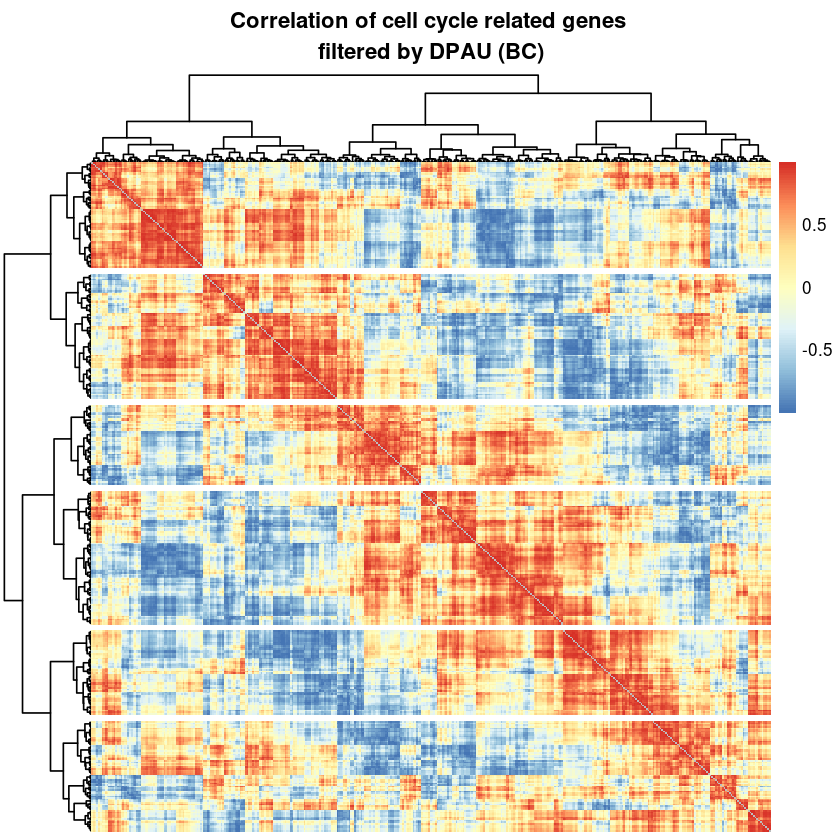

In [7]:
clusterNum=6 ##----------todo: set parameters

#
dev.off()
CairoPDF('deltaDPAU_BC/7_6_3_heatmap_BC_cycle.pdf', width=6, height=6)

## using correlation
d2.BC0=cor(t(as.matrix( tmp.BC ) ), use = 'pairwise.complete.obs', 
       #method="spearman"
        method="pearson"
      )
d2.BC=d2.BC0
diag(d2.BC)=NA;
p2cor.BC=pheatmap( d2.BC, clustering_method = 'ward.D2', na_col = 'grey',
         #scale='row',
         show_rownames=F,show_colnames=F,

         cutree_rows = clusterNum, #对row聚类时，设置加几个白横分割线
         #treeheight_row = 100,
        
                  #cutree_cols = clusterNum,
                  #treeheight_col = 100,

         main="Correlation of cell cycle related genes \nfiltered by DPAU (BC)",
         border=FALSE)
dev.off()

## determine the best cluster number

In [8]:
head(d2.BC0)

,AP4M1,ATF2,CBX1,ERP44,MIGA1,MRTO4,NSD2,NUMB,PELO,RAP2C,⋯,ZNF544,AL390719.1,DNAJB4,NPRL3,SPOPL,TRPM2,WASHC4,WDR48,CKAP2L,SLC29A1
AP4M1,1.0000000,-0.7040931,0.9441014,-0.9039008,-0.8108668,0.9138182,-0.4357362,0.7631090,0.6904867,0.8160312,⋯,0.5662825,0.4992391,0.03059112,-0.5956220,0.3946329,-0.4549581,0.19300846,-0.6571801,0.35774471,0.021350447
ATF2,-0.7040931,1.0000000,-0.8793084,0.8585936,0.9326218,-0.4880115,0.7501782,-0.7096161,-0.6976779,-0.9169769,⋯,-0.8866490,-0.8218053,0.62601227,0.4670061,-0.5716508,0.4822175,-0.31404317,0.9506013,-0.09827648,0.084928567
CBX1,0.9441014,-0.8793084,1.0000000,-0.9659150,-0.9478798,0.8392212,-0.5306118,0.8307398,0.7579856,0.8831396,⋯,0.7326773,0.7440103,-0.24030577,-0.6711856,0.4800641,-0.6053846,0.28732880,-0.8149943,0.20057023,-0.079758492
ERP44,-0.9039008,0.8585936,-0.9659150,1.0000000,0.9710199,-0.8305105,0.6145473,-0.9404107,-0.9009402,-0.9051241,⋯,-0.6011063,-0.7581391,0.14631422,0.5392320,-0.2593402,0.5196175,-0.04567790,0.7197546,-0.36854645,-0.144849351
MIGA1,-0.8108668,0.9326218,-0.9478798,0.9710199,1.0000000,-0.7206251,0.6298596,-0.9040251,-0.8617350,-0.8910142,⋯,-0.7076237,-0.8790575,0.35159967,0.5791202,-0.3473348,0.6053827,-0.15603773,0.8053444,-0.20123566,-0.021545123
MRTO4,0.9138182,-0.4880115,0.8392212,-0.8305105,-0.7206251,1.0000000,-0.1333638,0.7940740,0.6776649,0.5812930,⋯,0.2933922,0.4999110,0.28854453,-0.6984301,0.1366138,-0.5963204,0.09033114,-0.3853272,0.27926072,0.008850166


In [9]:
table(is.na(d2.BC0))


 FALSE 
154449 

In [12]:
library(NbClust)
nc=NbClust( dist(d2.BC0), distance="correlation", min.nc=2, max.nc=15, method="ward.D2"
          # ,index = "" 
          )
table(nb$Best.n[1,])
#
barplot(table(nb$Best.n[1,]), xlab="Number of Clusters", ylab="Number of Criteria",
       main="Number of clusters Chosen by 26 Criteria")

ERROR: Error in NbClust(dist(d2.BC0), distance = "correlation", min.nc = 2, max.nc = 15, : invalid distance


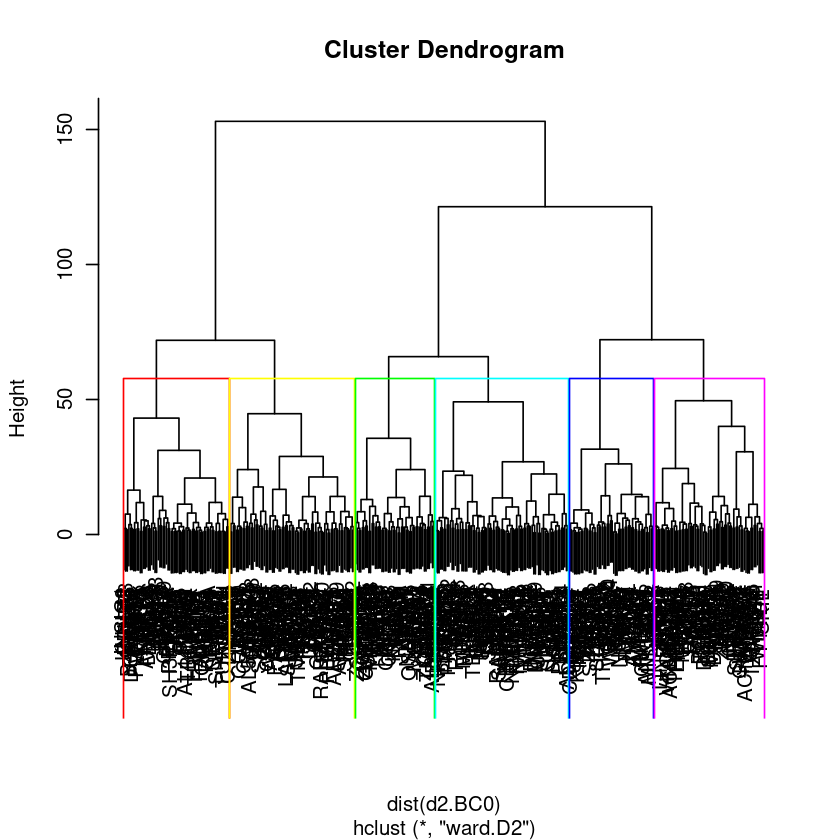

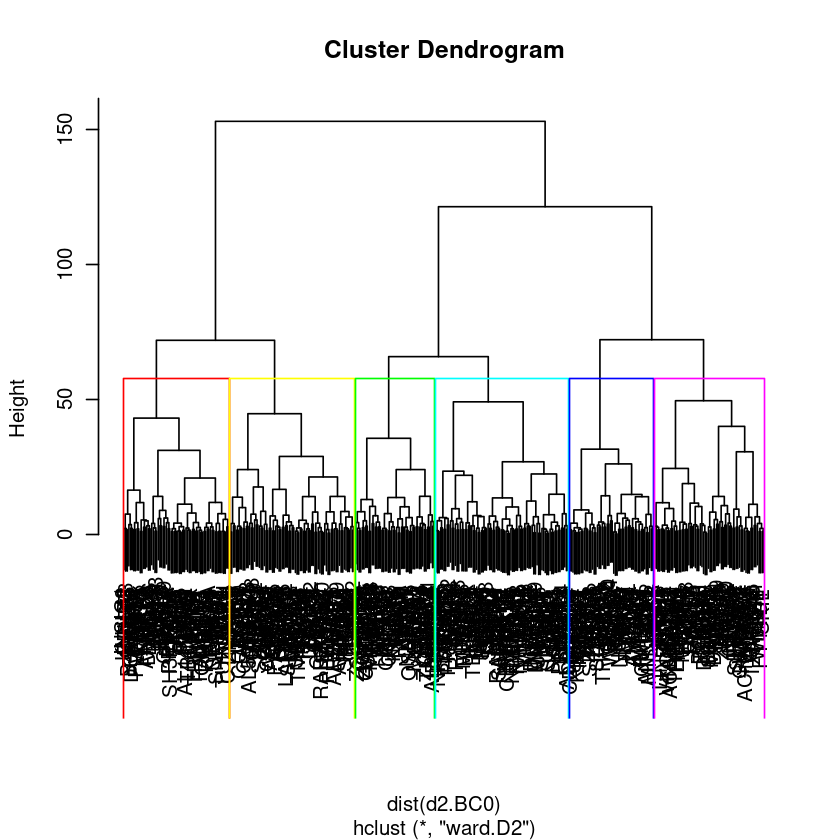

In [13]:
clust_ward <- hclust( dist(d2.BC0) , method = 'ward.D2')
plot(clust_ward)
boxN=clusterNum;
rect.hclust(clust_ward, k = boxN, border = rainbow(boxN))

clust_ward2 <- hclust( dist(d2.BC0) , method = 'ward.D2')
plot(clust_ward2)
rect.hclust(clust_ward2, k = boxN, border = rainbow(boxN))

corrplot 0.84 loaded



[1] 393 393

png 
  2

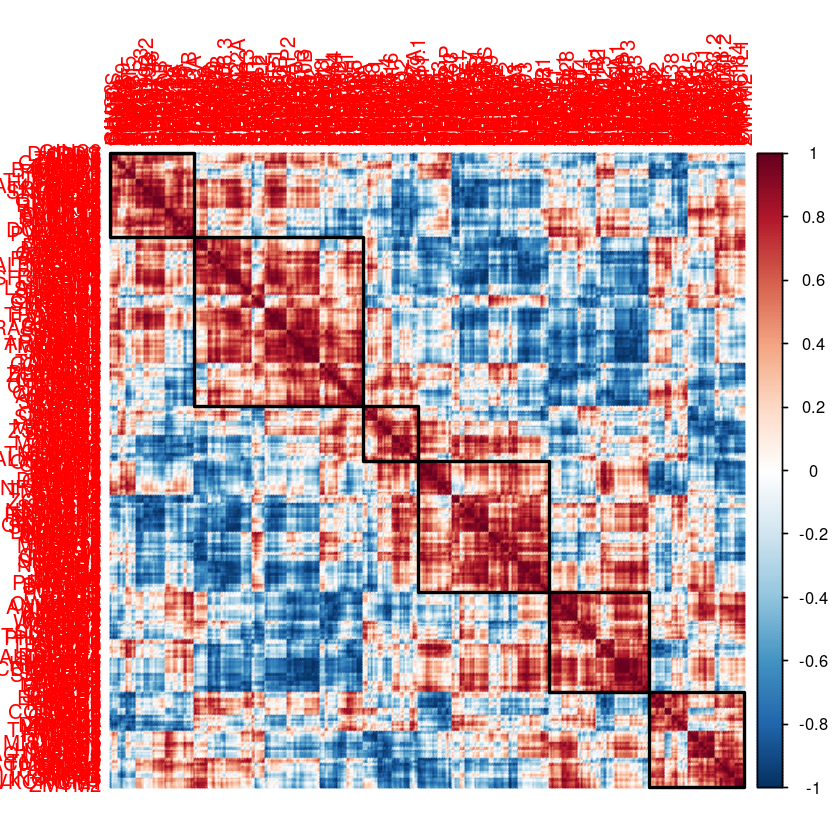

In [14]:
# correlation plot

CairoPDF('1.1_gene_correlation_test.pdf', width=8, height=8 )
library("corrplot")
matrix.cor=d2.BC0
dim(matrix.cor) #393 393
#corrplot(matrix.cor, method = 'color',
#         order = "hclust",addrect  = 5, hclust.method="ward.D2")

col2 <- c("#67001F", "#B2182B", "#D6604D", "#F4A582",
                           "#FDDBC7", "#FFFFFF", "#D1E5F0", "#92C5DE",
                           "#4393C3", "#2166AC", "#053061")
corrplot(matrix.cor, method = 'color',
         col=colorRampPalette( rev(col2) )(200), 
         order = "hclust",addrect  = 6, hclust.method="ward.D2")

dev.off()

Welcome! Want to learn more? See two factoextra-related books at https://goo.gl/ve3WBa



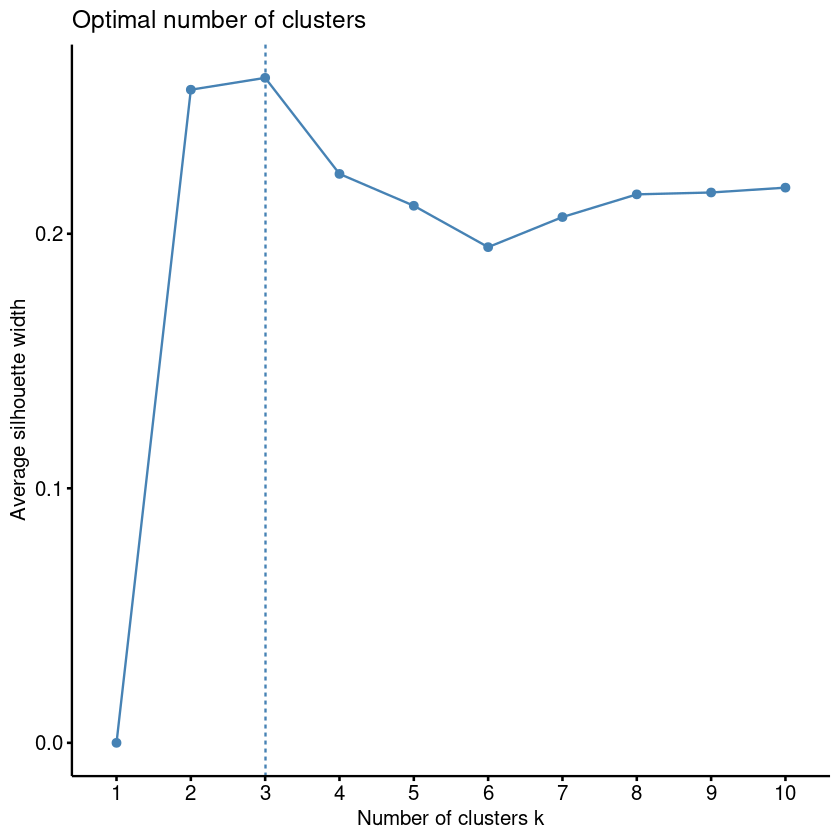

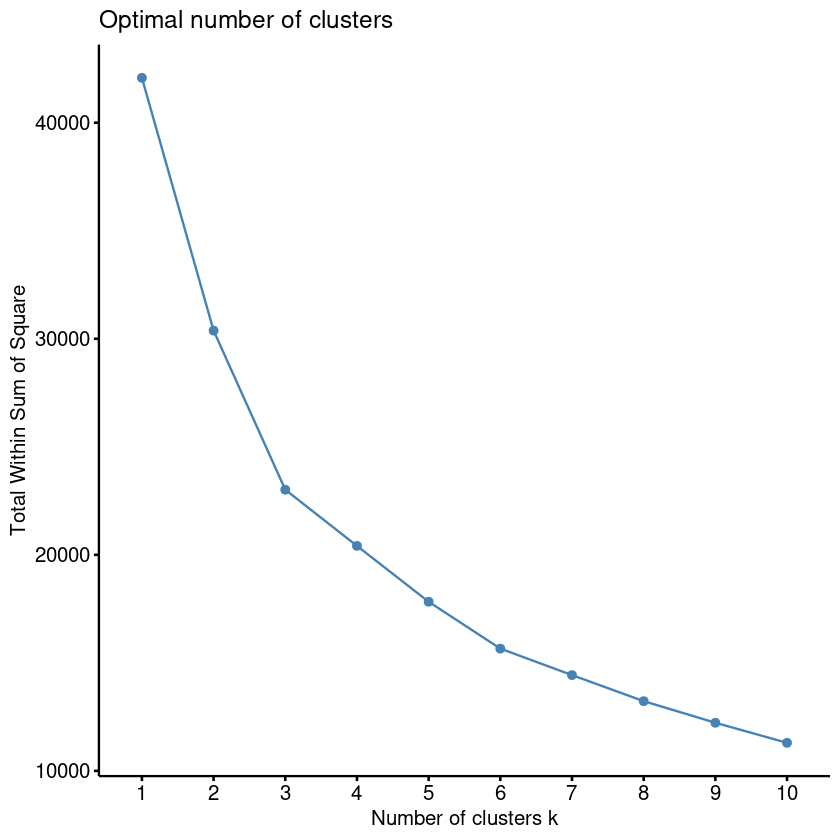

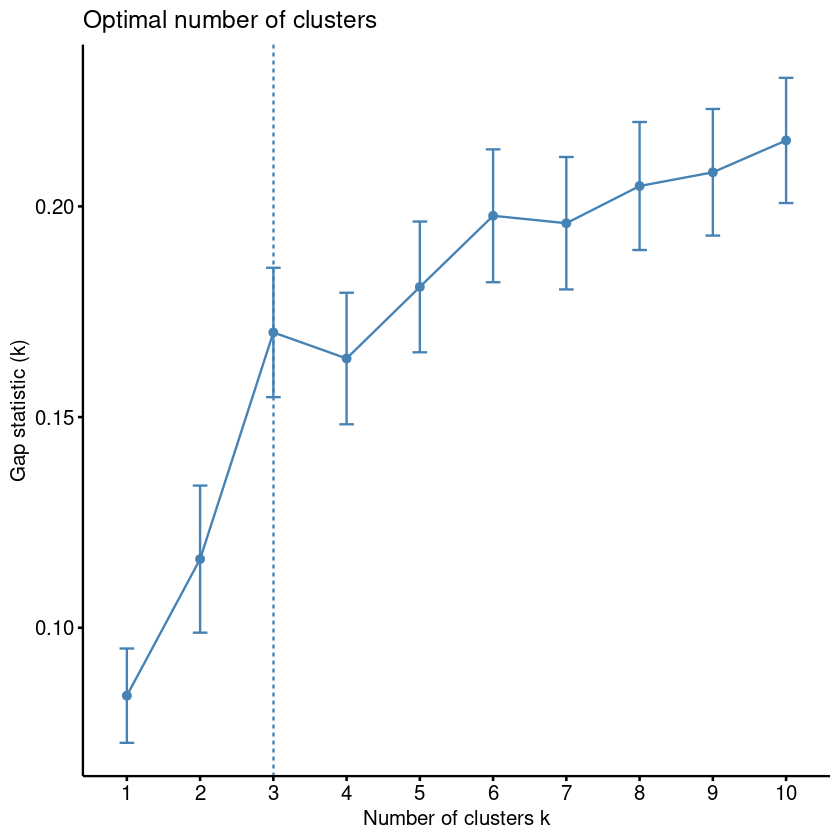

In [15]:
library("factoextra")
#fviz_nbclust(  t(tmp.BC), FUNcluster=kmeans, method="gap_stat", k.max = 4)

fviz_nbclust( d2.BC0, FUNcluster=hcut, method="silhouette") #cluster genes 2
fviz_nbclust(  d2.BC0, FUNcluster=hcut, method="wss") #
fviz_nbclust(  d2.BC0, FUNcluster=hcut, method="gap_stat") #5 time-consuming

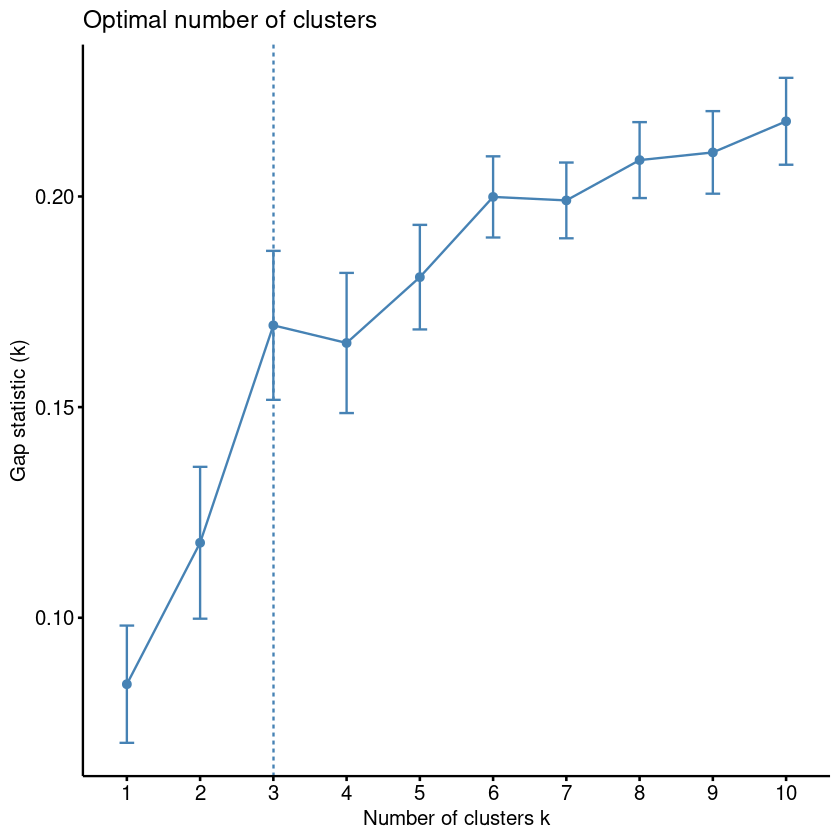

In [578]:
library(cluster)
# Gap statistic for hierarchical clustering
gap_stat <- clusGap( d2.BC0, FUN = hcut, K.max = 25, B = 10)
fviz_gap_stat(gap_stat)


In [16]:
#p=p1.DPAU
getNewOrder=function(pheatmapRS, df, output="deltaDPAU_BC"){
    # get gene order after cluster
    row_cluster = cutree(pheatmapRS$tree_row,k=clusterNum) 
    # reorder data frame, add Cluster column
    newOrder = df[pheatmapRS$tree_row$order,]
    newOrder[,ncol(newOrder)+1]= row_cluster[match(rownames(newOrder),names(row_cluster))]
    colnames(newOrder)[ncol(newOrder)]="Cluster"
    #order by cluster
    newOrder=newOrder[order(newOrder$Cluster),]
    #head(newOrder)

    # how many clusters?
    print(unique(newOrder$Cluster))
    # how many genes each cluster?
    print(table(newOrder$Cluster))
    #1   2   3   4   5 
    #131  52  68  65  77 
    #
    # write df to file
    newOrder$Cluster = paste0("Cluster",newOrder$Cluster)
    write.table(newOrder, paste0(output,"/7_6_3_DPAU_cycleRelatedGenes.pheatmap.cluster.txt"),
                sep="\t",quote = F,row.names = T,col.names = T)
    return(newOrder)
}

newOrder.BC=getNewOrder(p2cor.BC, tmp.BC, output="deltaDPAU_BC" ) #15:49-
head(newOrder.BC)

[1] 1 2 3 4 5 6

 1  2  3  4  5  6 
49 52 68 82 65 77 


,G1S,S,G2M,M,MG1,Cluster
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<chr>
EPHB2,42.85714,1.666667,1.851852,16.66667,16.66667,Cluster1
RAP2C,94.01709,38.845733,55.500000,72.72727,73.68263,Cluster1
ZSCAN16,47.73991,0.000000,11.875000,31.28149,37.36299,Cluster1
ICE1,77.54986,34.391534,40.816327,64.72460,66.71917,Cluster1
CHMP2B,41.55844,0.000000,0.000000,48.82812,14.46541,Cluster1
IGF2BP2,92.70833,36.553319,52.857143,100.00000,60.00000,Cluster1


In [28]:
# plot heatmap for newOrdered data with Cluster number
plotHM=function(newOrder, output, keyword){
    # anno for rows
    annotation_row=data.frame(
        gene=rownames(newOrder),
        Cluster=newOrder$Cluster, 
        row.names=1
    )
    #head(annotation_row)

    # define color list
    col=RColorBrewer::brewer.pal(n = 8,name = "Set2")
    #
    num=length(unique(newOrder$Cluster))
    Cluster=col[1:num]
    names(Cluster)=paste0('Cluster',1:num)
    #
    ann_colors = list( Cluster = Cluster )
    #print(head(ann_colors))
    #
    gaps_row =(table(newOrder$Cluster))
    gaps_row=cumsum(gaps_row)
    #
    ######################
    ## plot gene's DPAU across cycles
    ######################
    fileName=paste0(output,'/7_6_3_heatmap_',keyword,'_cycle_DPAU_2.pdf')
    CairoPDF(fileName, width=4, height=8)
    p1.DPAU=pheatmap( newOrder[,1:5], clustering_method = 'ward.D2',
                     clustering_distance_rows = "correlation",
                     annotation_row =annotation_row,
                     annotation_colors = ann_colors,
                     #
                     gaps_row=gaps_row,
             #scale='row',
             show_rownames=F, #show_colnames=F,
             cluster_rows=F, cluster_cols=F,
             cutree_rows = 6, 

                     treeheight_row = 100,

             main=paste0(" DPAU of cell cycle related genes \nfiltered by ", output),
             angle_col=90,
             border=FALSE)
    dev.off()
    #
    printP('heatmap end: ',fileName)
}
dev.off()
plotHM(newOrder.BC,output="deltaDPAU_BC",keyword="BC")

null device 
          1

[1] "heatmap end:  deltaDPAU_BC/7_6_3_heatmap_BC_cycle_DPAU_2.pdf"


In [18]:
# add gene number after cluster number
addGeneNumber2Cluster=function(newOrder){
    #print(head(newOrder))
    mapCN=sapply(split(newOrder, newOrder$Cluster), nrow)
    #print( mapCN )

    for(C in names(mapCN)){
        N=unname(mapCN[C])
        C2=sub('Cluster', 'Cluster ', C)
        #print(C)
        #print(N)
        newOrder[which(newOrder$Cluster==C), ]$Cluster=paste0(C2, " (",N, " genes)" )
    }
    newOrder
}
# test
head( addGeneNumber2Cluster(newOrder.BC) )

,G1S,S,G2M,M,MG1,Cluster
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<chr>
EPHB2,42.85714,1.666667,1.851852,16.66667,16.66667,Cluster 1 (49 genes)
RAP2C,94.01709,38.845733,55.500000,72.72727,73.68263,Cluster 1 (49 genes)
ZSCAN16,47.73991,0.000000,11.875000,31.28149,37.36299,Cluster 1 (49 genes)
ICE1,77.54986,34.391534,40.816327,64.72460,66.71917,Cluster 1 (49 genes)
CHMP2B,41.55844,0.000000,0.000000,48.82812,14.46541,Cluster 1 (49 genes)
IGF2BP2,92.70833,36.553319,52.857143,100.00000,60.00000,Cluster 1 (49 genes)


In [19]:
# plot genes by cluster
plotLineByCluster=function(newOrder, output="deltaDPAU_BC"){
    #add gene column
    newOrder$gene = rownames(newOrder)
    
    # add gene numbers per Cluster
    newOrder=addGeneNumber2Cluster(newOrder)

    #change factor to number
    cycleName=colnames(newOrder.BC)
    colnames(newOrder.BC)=c(1:5,"Cluster")

    
    #wide to long
    library(reshape2)    
    data_new = melt(newOrder)

    dev.off()
    CairoPDF( paste0(output,'/Black7_6_3_clusterLinesByCycle_',output,'.pdf'), width=3, height=8)
    # line plot for each cluster
    
    
    p=ggplot(data_new,aes( as.numeric( variable ), value, group=gene)) + geom_line(color="gray90",size=0.4) + 
      geom_hline(yintercept =50,linetype=2, size=0.1) +
      geom_vline(xintercept =c(2,3,4),linetype=2, size=0.01, color="#999999") +
    stat_summary(aes(group=1, color=Cluster),fun.y=mean, geom="line", size=0.8, color="#F81082" )+
      #stat_summary(aes(group=1, color=Cluster),fun.y=mean, geom="line", size=0.8, #color="#c51b7d"
      #            ) + scale_color_manual('Gene cluster',values = col)+
      facet_wrap(Cluster~., ncol=1) +
      labs(x="Cell cycle", y='Mean DPAU', title=output)+
      theme_bw() + 
      theme(panel.grid.major = element_blank(), panel.grid.minor = element_blank(),
            axis.text = element_text(size=8, face = "bold"),
            axis.text.x=element_text(angle=60, hjust=1), #x标签旋转60度
            legend.position = 'none', 
            strip.text = element_text(size = 8, face = "bold"))+
    scale_x_discrete(expand = c(0,0), limits=1:5, labels = cycleName)
    print(p)
    dev.off()
    
    
    ## output gene list for each cluster
    #head(newOrder)
    num=length(unique(newOrder$Cluster))
    for(i in 1:num){
        CName=unique(newOrder$Cluster)[i]
        gene.tmp=rownames( newOrder[which(newOrder$Cluster==CName ),] )
        printP(i, length(gene.tmp))
        writeLines(gene.tmp, paste0(output,"/7_6_3_cycleCluster",i,'_',output,".txt") )
    }
}
## 
plotLineByCluster(newOrder.BC, output="deltaDPAU_BC")

Using Cluster, gene as id variables



[1] "1 49"
[1] "2 52"
[1] "3 68"
[1] "4 82"
[1] "5 65"
[1] "6 77"


In [ ]:
## end of BC

# HeLa cycle related genes at APA level

In [20]:
timeDPAU.HeLa=read.table( "deltaDPAU_HeLa/timeDPAU.HeLa.mean.sd.n.txt")
dim(timeDPAU.HeLa)
head(timeDPAU.HeLa)

[1] 418  16

,G1S_mean,G1S_sd,G1S_n,S_mean,S_sd,S_n,G2M_mean,G2M_sd,G2M_n,M_mean,M_sd,M_n,MG1_mean,MG1_sd,MG1_n,gene
,<dbl>,<dbl>,<int>,<dbl>,<dbl>,<int>,<dbl>,<dbl>,<int>,<dbl>,<dbl>,<int>,<dbl>,<dbl>,<int>,<fct>
ABHD13,66.66667,57.73503,3,2.222222,NA,1,NA,NA,0,NA,NA,0,98.07692,2.719641,2,ABHD13
AC069288.1,0.00000,NA,1,65.476190,47.20054,4,41.66667,58.92557,2,66.66667,57.73503,3,53.30893,44.943549,5,AC069288.1
ACOT8,0.00000,NA,1,100.000000,0.00000,4,100.00000,NA,1,96.17486,5.40956,2,NA,NA,0,ACOT8
AMFR,69.04762,53.61110,3,0.000000,NA,1,84.61538,21.75713,2,91.17647,12.47835,2,100.00000,NA,1,AMFR
ATF5,0.00000,0.00000,2,100.000000,0.00000,2,100.00000,NA,1,NA,NA,0,0.00000,NA,1,ATF5
ATF6,0.00000,NA,1,59.883721,49.05360,4,100.00000,0.00000,4,NA,NA,0,NA,NA,0,ATF6


In [21]:
#get mean, and heatmap
tmp.HeLa=timeDPAU.HeLa[, seq(1,15,3)]
dim(tmp.HeLa)
tail( head(tmp.HeLa, n=100) )

#detect NA
table(apply(tmp.HeLa, 1, function(x){ sum(is.na(x)) }))
# 0   1   2   3 
#393  31   2   4 

# how to deal with NA?
#tmp[is.na(tmp)] <- (-10)
tmp2.HeLa=tmp.HeLa[!complete.cases(tmp.HeLa),]
head(tmp2.HeLa)

# remove na rows
tmp.HeLa=tmp.HeLa[complete.cases(tmp.HeLa),]

#timeDPAU.HeLa.mean=tmp
table(apply(tmp.HeLa, 1, function(x){ sum(is.na(x)) }))
#head(tmp.HeLa)

[1] 418   5

,G1S_mean,S_mean,G2M_mean,M_mean,MG1_mean
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
RAB11FIP4,0.00000,100.000000,NA,NA,NA
RAB12,0.00000,100.000000,100.00000,50.00000,NA
RABL3,100.00000,16.532258,0.00000,NA,NA
RBM26,33.33333,100.000000,NA,0.00000,0.00000
RBMS1,93.33333,4.166667,68.18182,42.94737,100.00000
RNF25,0.00000,98.734177,33.33333,32.09877,33.33333



  0   1   2   3 
269 110  34   5 

,G1S_mean,S_mean,G2M_mean,M_mean,MG1_mean
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
ABHD13,66.66667,2.222222,NA,NA,98.076923
ACOT8,0.00000,100.000000,100,96.17486,NA
ATF5,0.00000,100.000000,100,NA,0.000000
ATF6,0.00000,59.883721,100,NA,NA
ATP13A5,0.00000,61.538462,NA,NA,4.545455
BET1L,3.12500,66.666667,75,NA,0.000000



  0 
269 

## gene correlation using DPAU

In [22]:
# remove surfix _mean
colnames(tmp.HeLa)=gsub('_mean','',colnames(tmp.HeLa))
head(tmp.HeLa)
#pheatmap( as.matrix( tmp ) )

,G1S,S,G2M,M,MG1
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
AC069288.1,0.000000,65.47619,41.666667,66.66667,53.30893
AMFR,69.047619,0.00000,84.615385,91.17647,100.00000
AVL9,100.000000,0.00000,100.000000,100.00000,40.00000
BFAR,1.754386,75.00000,16.666667,0.00000,0.00000
BRWD3,0.000000,75.00000,100.000000,100.00000,100.00000
C8orf76,33.333333,100.00000,2.083333,0.00000,50.00000


null device 
          1

null device 
          1

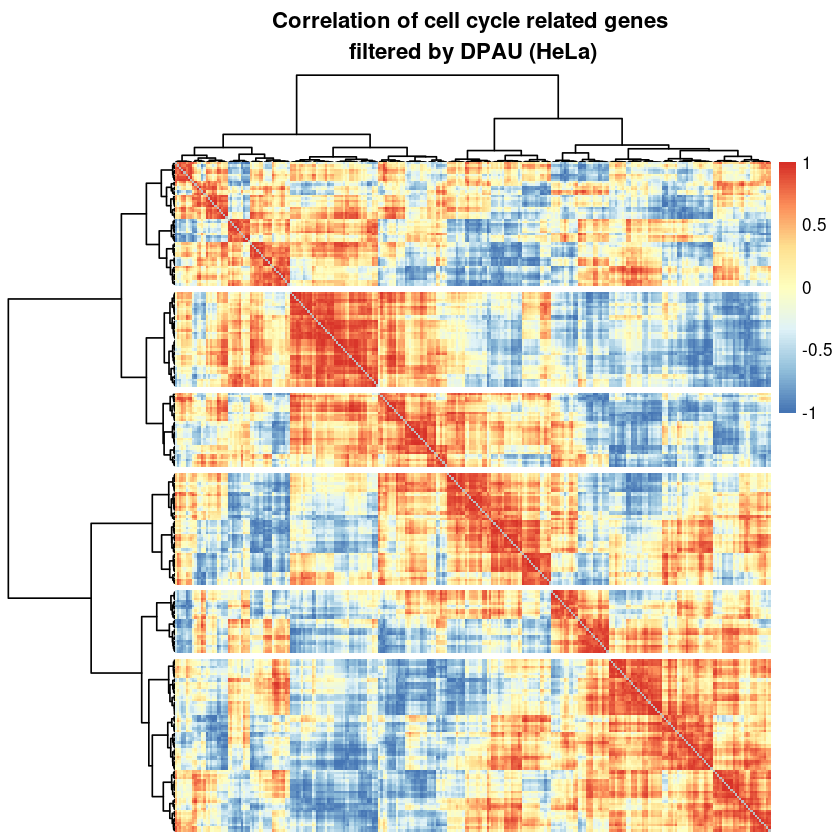

In [23]:
clusterNum=6 ##----------todo: set parameters

#
dev.off()
CairoPDF('deltaDPAU_HeLa/7_6_3_heatmap_HeLa_cycle.pdf', width=6, height=6)

## using correlation
d2.HeLa=cor(t(as.matrix( tmp.HeLa ) ), use = 'pairwise.complete.obs', 
       #method="spearman"
        method="pearson"
      )
diag(d2.HeLa)=NA;
p2cor.HeLa=pheatmap( d2.HeLa, clustering_method = 'ward.D', na_col = 'grey',
         #scale='row',
         show_rownames=F,show_colnames=F,

         cutree_rows = clusterNum, 
         treeheight_row = 100,

         main="Correlation of cell cycle related genes \nfiltered by DPAU (HeLa)",
         border=FALSE)
dev.off()

AC069288.1       AMFR       AVL9       BFAR      BRWD3    C8orf76 
         1          2          2          3          4          3


 1  2  3  4  5  6 
45 26 23 86 48 41 

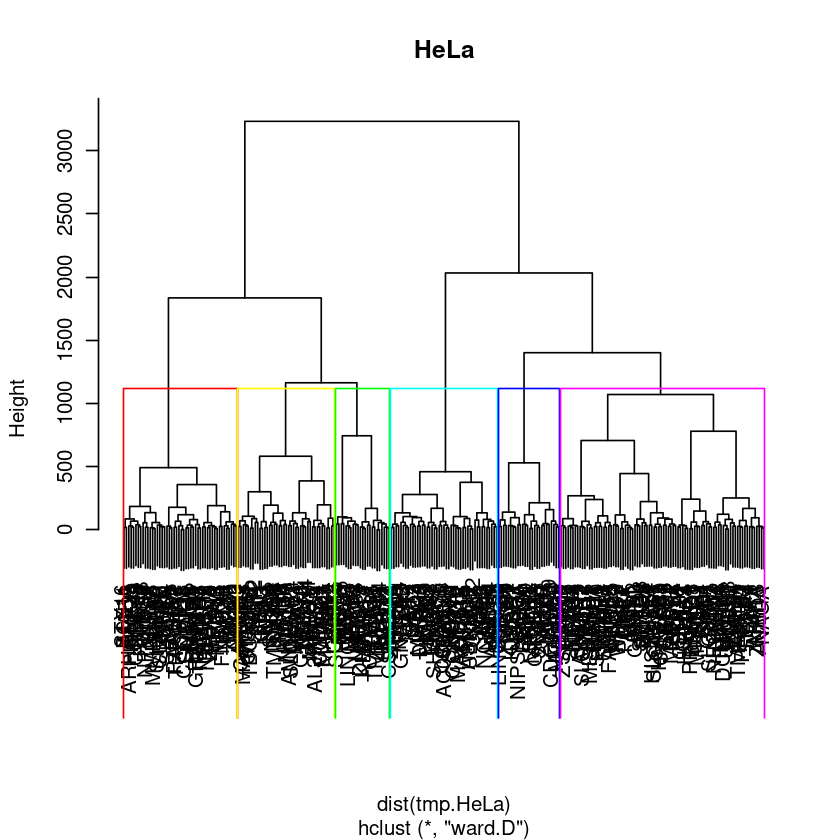

In [24]:
clust_ward.HeLa <- hclust( dist(tmp.HeLa) , method = 'ward.D')
plot(clust_ward.HeLa, main="HeLa")
boxN=6;rect.hclust(clust_ward.HeLa, k = boxN, border = rainbow(boxN))

#get cluster number for each item
head(cutree(clust_ward.HeLa, k=boxN))
table(cutree(clust_ward.HeLa, k=boxN))

In [25]:
# in order to resemble heatmap of BC, we change the cluster number of BC and HeLa

#p=p1.DPAU
getNewOrder.HeLa=function(pheatmapRS, df, output="deltaDPAU_BC"){
    # get gene order after cluster
    row_cluster = cutree(pheatmapRS$tree_row,k=clusterNum) 
    # reorder data frame, add Cluster column
    newOrder = df[pheatmapRS$tree_row$order,]
    newOrder[,ncol(newOrder)+1]= row_cluster[match(rownames(newOrder),names(row_cluster))]
    colnames(newOrder)[ncol(newOrder)]="Cluster"
    
    ################
    # rename Cluster 1 to 0, rename 2 to 1, 0 to 2
    newOrder[which(newOrder$Cluster==1),'Cluster']=0
    newOrder[which(newOrder$Cluster==2),'Cluster']=1
    newOrder[which(newOrder$Cluster==0),'Cluster']=2
    ################
    
    #order by cluster
    newOrder=newOrder[order(newOrder$Cluster),]
    #head(newOrder)

    # how many clusters?
    print(unique(newOrder$Cluster))
    # how many genes each cluster?
    print(table(newOrder$Cluster))
    #1   2   3   4   5 
    #131  52  68  65  77 
    #
    # write df to file
    newOrder$Cluster = paste0("Cluster",newOrder$Cluster)
    write.table(newOrder, paste0(output,"/7_6_3_DPAU_cycleRelatedGenes.pheatmap.cluster.txt"),
                sep="\t",quote = F,row.names = T,col.names = T)
    return(newOrder)
}

#newOrder.BC=getNewOrder(p2cor.BC, tmp.BC, output="deltaDPAU_BC" )
#head(newOrder.BC)

newOrder.HeLa=getNewOrder.HeLa(p2cor.HeLa, tmp.HeLa, output="deltaDPAU_HeLa" )
head(newOrder.HeLa)

[1] 1 2 3 4 5 6

 1  2  3  4  5  6 
26 47 52 73 40 31 


,G1S,S,G2M,M,MG1,Cluster
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<chr>
IAH1,77.77778,0,0.00000,99.29972,69.64286,Cluster1
IQSEC1,100.00000,0,0.00000,100.00000,71.42857,Cluster1
UFSP2,97.29730,0,0.00000,100.00000,93.33333,Cluster1
ZNF330,98.71795,0,0.00000,74.29379,73.05912,Cluster1
SLC4A7,100.00000,0,50.00000,100.00000,100.00000,Cluster1
ZNF507,66.66667,0,42.30769,100.00000,100.00000,Cluster1


In [29]:
dev.off()
plotHM(newOrder.HeLa,output="deltaDPAU_HeLa",keyword = "HeLa")

null device 
          1

[1] "heatmap end:  deltaDPAU_HeLa/7_6_3_heatmap_HeLa_cycle_DPAU_2.pdf"


In [30]:
plotLineByCluster(newOrder.HeLa, output="deltaDPAU_HeLa")

Using Cluster, gene as id variables



[1] "1 26"
[1] "2 47"
[1] "3 52"
[1] "4 73"
[1] "5 40"
[1] "6 31"


# BC & HeLa, overlap of cycle related genes at APA level

In [31]:
dim(newOrder.BC)
head(newOrder.BC)

[1] 393   6

,G1S,S,G2M,M,MG1,Cluster
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<chr>
EPHB2,42.85714,1.666667,1.851852,16.66667,16.66667,Cluster1
RAP2C,94.01709,38.845733,55.500000,72.72727,73.68263,Cluster1
ZSCAN16,47.73991,0.000000,11.875000,31.28149,37.36299,Cluster1
ICE1,77.54986,34.391534,40.816327,64.72460,66.71917,Cluster1
CHMP2B,41.55844,0.000000,0.000000,48.82812,14.46541,Cluster1
IGF2BP2,92.70833,36.553319,52.857143,100.00000,60.00000,Cluster1


In [32]:
dim(newOrder.HeLa)
head(newOrder.HeLa)

[1] 269   6

,G1S,S,G2M,M,MG1,Cluster
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<chr>
IAH1,77.77778,0,0.00000,99.29972,69.64286,Cluster1
IQSEC1,100.00000,0,0.00000,100.00000,71.42857,Cluster1
UFSP2,97.29730,0,0.00000,100.00000,93.33333,Cluster1
ZNF330,98.71795,0,0.00000,74.29379,73.05912,Cluster1
SLC4A7,100.00000,0,50.00000,100.00000,100.00000,Cluster1
ZNF507,66.66667,0,42.30769,100.00000,100.00000,Cluster1


In [33]:
# union
cycleGenes.union=union( rownames(newOrder.BC), rownames(newOrder.HeLa))
length(cycleGenes.union)
head(cycleGenes.union) # 568
writeLines(cycleGenes.union, 'BC_HeLa_CycleRelatedGene_union_568.txt')

[1] 568

[1] "EPHB2"   "RAP2C"   "ZSCAN16" "ICE1"    "CHMP2B"  "IGF2BP2"

In [34]:
# intersect
length(rownames(newOrder.BC)) #393
length(rownames(newOrder.HeLa)) #269
#
cycleGenes.intersect=intersect( rownames(newOrder.BC), rownames(newOrder.HeLa))
length(cycleGenes.intersect)
head(cycleGenes.intersect) # only overlap 94?!
writeLines(cycleGenes.intersect, 'BC_HeLa_CycleRelatedGene_intersect_94.txt')

[1] 393

[1] 269

[1] 94

[1] "ZSCAN16" "JARID2"  "APPL1"   "FAR1"    "CCDC43"  "GCSH"

Loading required package: grid

Loading required package: futile.logger



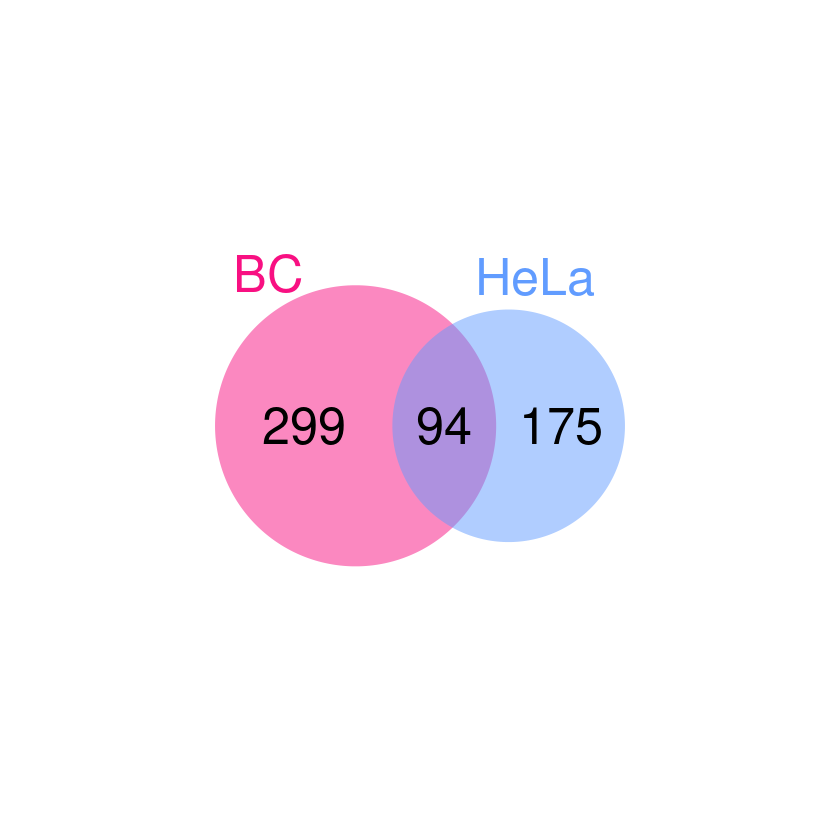

In [35]:
library (VennDiagram)
#grid.newpage()
venn.plot <- draw.pairwise.venn(393, 269, 94, c("BC", "HeLa"), 
                                fill = c('#F81082', '#619CFF'),
                                col = "transparent",
                                cex = 2.5,cat.cex=2.5,alpha = 0.50,
                                main="Cycle related genes at APA level",
                                
                                cat.pos = c(-30, 10), #angle of text, dgree=0 means top of cycle
                                cat.dist = 0.05,   #distance of text to border, can be negative
                                
                                cat.col = c('#F81082', '#619CFF'),
                                margin=0.3,
                                scaled = T);

## what about each cyle

In [37]:
# how about each cluster's intersect? 
# (after exchange cluster 1 and 2 tag of HeLa)
(function(){
    total=0
    for(i in 1:6){
        g1=rownames(newOrder.BC[which(newOrder.BC$Cluster== paste0('Cluster',i) ),])
        gn=c()
        for(j in 1:6){
            g2=rownames(newOrder.HeLa[which(newOrder.HeLa$Cluster== paste0('Cluster',j) ),])
            gc=intersect(g1,g2)
            gn=c(gn, length(gc))
        }
        printP0('>>>>BC_cluster',i, ' with HeLa cluster1-6: ', sum(gn), ' genes')
        print(gn)
        total=total+sum(gn)
    }
    printP0('Total=',total)
})()

[1] ">>>>BC_cluster1 with HeLa cluster1-6: 10 genes"
[1] 1 0 4 3 2 0
[1] ">>>>BC_cluster2 with HeLa cluster1-6: 17 genes"
[1] 1 3 6 4 1 2
[1] ">>>>BC_cluster3 with HeLa cluster1-6: 20 genes"
[1] 3 4 3 6 2 2
[1] ">>>>BC_cluster4 with HeLa cluster1-6: 20 genes"
[1] 1 5 0 9 3 2
[1] ">>>>BC_cluster5 with HeLa cluster1-6: 14 genes"
[1] 1 4 2 4 2 1
[1] ">>>>BC_cluster6 with HeLa cluster1-6: 13 genes"
[1] 1 2 3 2 3 2
[1] "Total=94"


## how to deal with NA values?

In [ ]:
# now discard any gene with NA in 5 cycle time points.

# RNA expression level of these genes

## load cellInfo, rnaM

In [38]:
# cell info
cellFile="/home/wangjl/data/apa/190530Mix/cellInfo.V4.txt"
cellInfo=read.csv(cellFile, row.names = 1, stringsAsFactors = F)
dim(cellInfo) #225 6
head(cellInfo)

[1] 225   6

,geneNumber,countsPerCell,countsPerGene,cellType,cellCycle,cellType2
,<int>,<int>,<dbl>,<chr>,<chr>,<chr>
c01ROW24,5693,1950601,342.6315,HeLa_sync,G2M,HeLa_syncMix
c01ROW35,6768,3048970,450.4979,HeLa_sync,M,HeLa_syncMix
c01ROW31,6542,2783703,425.5125,HeLa_sync,S,HeLa_syncMix
c05ROW02,6012,1263249,210.1213,HeLa_sync,S,HeLa_syncMix
c05ROW14,5853,1313664,224.4428,HeLa_sync,S,HeLa_syncMix
c05ROW19,4372,493417,112.8584,HeLa_sync,S,HeLa_syncMix


In [77]:
cid.BC=rownames(cellInfo[which( substr(cellInfo$cellType,1,2)=="BC" ),]); ph(cid.BC); length(cid.BC);
cid.HeLa=rownames(cellInfo[which( substr(cellInfo$cellType,1,2)=="He" ),]); ph(cid.HeLa); length(cid.HeLa);

[1] "c12ROW02" "c12ROW03" "c12ROW04" "c12ROW05" "c12ROW06" "c12ROW07"


[1] 169

[1] "c01ROW24" "c01ROW35" "c01ROW31" "c05ROW02" "c05ROW14" "c05ROW19"


[1] 56

In [39]:
table(cellInfo$cellType)


       BC_0        BC_1 HeLa_normal   HeLa_sync 
         87          82          29          27 

In [40]:
# RNA expression level
rnaFile="/home/wangjl/data/apa/190530Mix/BC_HeLa.225cells.count.V3.csv"
rnaM=read.csv(rnaFile, row.names = 1, stringsAsFactors = F)
dim(rnaM) #18679 225
rnaM[1:5,1:5]

[1] 18679   225

,c01ROW24,c01ROW35,c01ROW31,c05ROW02,c05ROW14
,<int>,<int>,<int>,<int>,<int>
A1BG-AS1,0,0,0,0,0
A2M,0,0,0,0,0
A2M-AS1,0,0,0,0,0
A2ML1,0,0,0,0,0
A2MP1,0,0,0,0,0


In [41]:
# RNA normalization
getNormalizedCts <- function ( cts ) {
    #cts <- read.table ( ctsPath , header = T , as.is = T )
    apply ( cts , 2 , function ( x ) { log2 ( ( 10^6 ) * x / sum ( x ) + 1 ) })
}
rnaM.cpm=apply(rnaM, 2, function(x){
    1e6*x/sum(x)
})
# rnaM.log2cpm= apply(rnaM.cpm, 2, function(x){
#     log2(x+1)
# }) #

#
rnaM.log2cpm=getNormalizedCts(rnaM)
#
dim(rnaM.log2cpm) #18679 225
rnaM.log2cpm[1:5,1:8]

[1] 18679   225

,c01ROW24,c01ROW35,c01ROW31,c05ROW02,c05ROW14,c05ROW19,c05ROW31,c05ROW33
A1BG-AS1,0,0,0,0,0,0.000000,0,0
A2M,0,0,0,0,0,0.000000,0,0
A2M-AS1,0,0,0,0,0,0.000000,0,0
A2ML1,0,0,0,0,0,0.000000,0,0
A2MP1,0,0,0,0,0,8.318268,0,0


In [185]:
# normalization each gene to [0,1]
rnaM.log2cpm.to1=as.data.frame(t( apply(rnaM.log2cpm,1,function(x){ (x-min(x))/(max(x)-min(x))})) )
rnaM.log2cpm.to1[1:5,1:8]

,c01ROW24,c01ROW35,c01ROW31,c05ROW02,c05ROW14,c05ROW19,c05ROW31,c05ROW33
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
A1BG-AS1,0,0,0,0,0,0,0,0
A2M,0,0,0,0,0,0,0,0
A2M-AS1,0,0,0,0,0,0,0,0
A2ML1,0,0,0,0,0,0,0,0
A2MP1,0,0,0,0,0,1,0,0


[1] 18679   225

## RNA expresssion of BC and HeLa

In [555]:
# gegt log2 cpm of each gene in a subset
getlog2CPM=function(keyword="BC"){
    # cell subset
    cid=rownames( cellInfo[which( substr(cellInfo$cellType,1,2)==keyword ),] )
    print( length(cid) ) #169
    
    # RNA matrix subset
    rnaM.sub=rnaM.cpm[, cid]
    #pd(rnaM.sub) #18679   169
    #ph(rnaM.sub[,1:4])
    # add cpm of a gene
    g.cpm=getDF_fromNamesXX( apply(rnaM.sub,1,sum) )
    colnames(g.cpm)=c('gene', 'cpm')
    g.cpm$logCPM=log2(1+ g.cpm$cpm)
    return(g.cpm)
}

log2CPM.BC=getlog2CPM('BC') #169

[1] 169
[1] 18679     2
           name   value
MT-ATP6 MT-ATP6 7536759
MT-ND4   MT-ND4 7356263
MT-RNR2 MT-RNR2 4994112
MT-CO2   MT-CO2 4164762
MT-CYB   MT-CYB 3699379
MT-CO3   MT-CO3 3654738


In [43]:
log2CPM.HeLa=getlog2CPM('He') #56

[1] 56
[1] 18679     2
           name   value
MT-ATP6 MT-ATP6 2199957
MT-ND4   MT-ND4 2102535
MT-RNR2 MT-RNR2 1367763
MT-CYB   MT-CYB 1138438
MT-CO2   MT-CO2 1119547
MT-CO3   MT-CO3 1019448


## RNA expression at each phase, BC

In [44]:
(function(){
    ph(cellInfo)
    ph(rnaM.cpm[1:10,1:4])
})()

         geneNumber countsPerCell countsPerGene  cellType cellCycle
c01ROW24       5693       1950601      342.6315 HeLa_sync       G2M
c01ROW35       6768       3048970      450.4979 HeLa_sync         M
c01ROW31       6542       2783703      425.5125 HeLa_sync         S
c05ROW02       6012       1263249      210.1213 HeLa_sync         S
c05ROW14       5853       1313664      224.4428 HeLa_sync         S
c05ROW19       4372        493417      112.8584 HeLa_sync         S
            cellType2
c01ROW24 HeLa_syncMix
c01ROW35 HeLa_syncMix
c01ROW31 HeLa_syncMix
c05ROW02 HeLa_syncMix
c05ROW14 HeLa_syncMix
c05ROW19 HeLa_syncMix
         c01ROW24 c01ROW35 c01ROW31 c05ROW02
A1BG-AS1        0        0        0        0
A2M             0        0        0        0
A2M-AS1         0        0        0        0
A2ML1           0        0        0        0
A2MP1           0        0        0        0
A4GALT          0        0        0        0


In [45]:
table( substr(cellInfo$cellType,1,2), cellInfo$cellCycle)

    
     G1S G2M  M MG1  S
  BC  49  24 32  41 23
  He  14  10 10   9 13

In [46]:
# time consuming 10s;
getGeneExpEachPhase=function(keyword){
    #keyword="BC"
    cid=rownames( cellInfo[which( substr(cellInfo$cellType,1,2)==keyword ),] )
    print( length(cid) ) #169
    
    # RNA matrix subset
    rnaM.sub=rnaM.cpm[, cid]
    # cell info sub
    cellInfo.sub=cellInfo[cid,]
    
    # cid in each phase
    phaseCellList=lapply(split(cellInfo.sub, cellInfo.sub$cellCycle), rownames);
    print(sapply(phaseCellList, length))
    #phaseCellList
    
    #mean exp in each phase
    exp.phase=as.data.frame( sapply( phaseCellList, function(cid.phase){
        apply(rnaM.sub,1, function(expRow){
            mean(expRow[cid.phase])
        })
    } ) )
    # order phase
    exp.phase=exp.phase[,c('G1S', 'S', 'G2M', 'M', "MG1")]
    exp.phase=log2(1+exp.phase)
    
    #filter out all 0 rows
    keep=apply(exp.phase,1,sum)>0
    exp.phase[keep,]
}
exp.phase.BC=getGeneExpEachPhase('BC')
dim(exp.phase.BC)
head(exp.phase.BC)

#save to file
write.csv(exp.phase.BC,paste ( "deltaDPAU_BC/C4_3_RNAexpression_CellCycle.csv" , sep = "" ) )

[1] 169
G1S G2M   M MG1   S 
 49  24  32  41  23 


[1] 18276     5

,G1S,S,G2M,M,MG1
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
A1BG-AS1,3.23352601,0.73421150,2.74618342,3.95572973,1.97142222
A2M,0.02081696,1.45747386,0.05344868,0.39367722,0.07267556
A2M-AS1,0.02123238,0.00000000,0.00000000,0.00000000,0.00000000
A2ML1,0.32947398,0.00000000,0.00000000,0.00000000,0.04438481
A2MP1,0.00000000,0.00000000,0.00000000,0.00000000,0.01263214
A4GALT,0.00000000,0.02581513,0.32019311,0.05938426,0.01338089


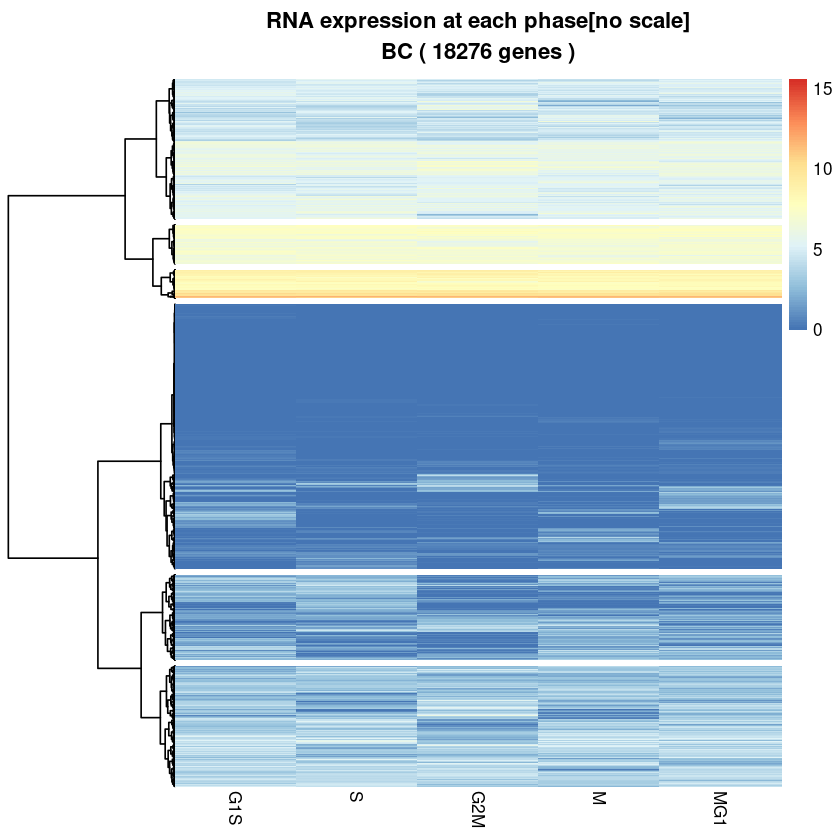

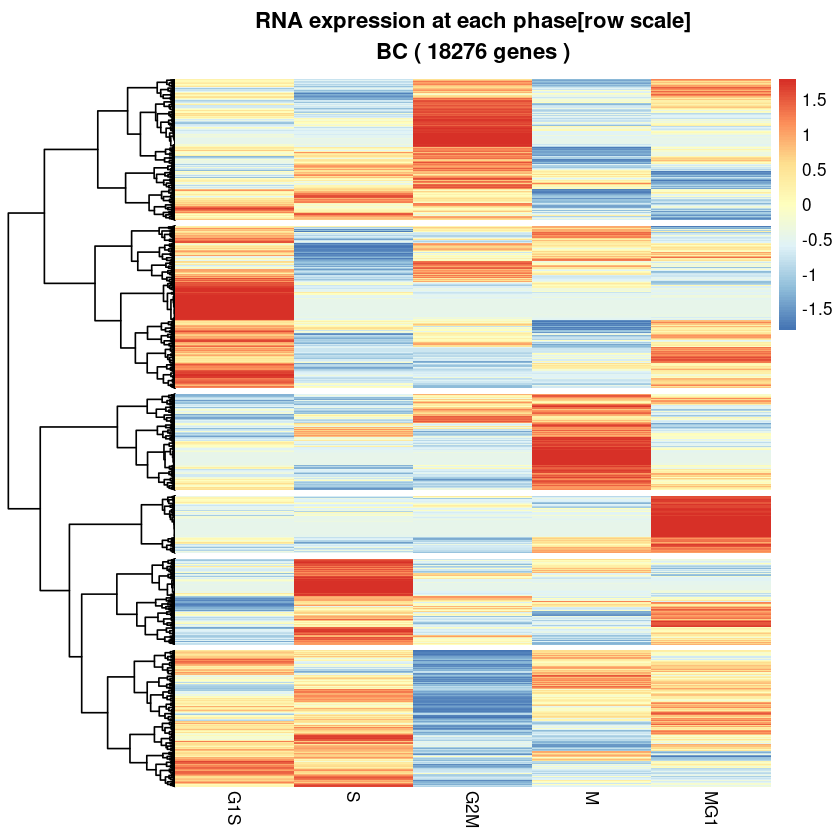

In [47]:
# RNA expression level at each cell phase: consume 30s
plotHM_RNA=function(exp.phase, keyword){
    library(pheatmap)
    pheatmap(exp.phase, #scale='row', 
             border_color = "NA", cluster_cols=F,
             show_rownames =F,
             cutree_rows=6,
             treeheight_row=100,
            main=paste0("RNA expression at each phase[no scale]\n",keyword, " ( ",nrow(exp.phase), " genes )"),
             clustering_method = "ward.D2")
    pheatmap(exp.phase, scale='row', 
             border_color = "NA", cluster_cols=F,
             show_rownames =F,
             cutree_rows=6,
             treeheight_row=100,
            main=paste0("RNA expression at each phase[row scale]\n",keyword, " ( ",nrow(exp.phase), " genes )"),
             clustering_method = "ward.D2")
}
##
plotHM_RNA(exp.phase.BC, keyword="BC")

[1] 18276     5
                G1S          S        G2M          M        MG1
A1BG-AS1 3.23352601 0.73421150 2.74618342 3.95572973 1.97142222
A2M      0.02081696 1.45747386 0.05344868 0.39367722 0.07267556
A2M-AS1  0.02123238 0.00000000 0.00000000 0.00000000 0.00000000
A2ML1    0.32947398 0.00000000 0.00000000 0.00000000 0.04438481
A2MP1    0.00000000 0.00000000 0.00000000 0.00000000 0.01263214
A4GALT   0.00000000 0.02581513 0.32019311 0.05938426 0.01338089
[1] 393   6
             G1S         S       G2M         M      MG1  Cluster
EPHB2   42.85714  1.666667  1.851852  16.66667 16.66667 Cluster1
RAP2C   94.01709 38.845733 55.500000  72.72727 73.68263 Cluster1
ZSCAN16 47.73991  0.000000 11.875000  31.28149 37.36299 Cluster1
ICE1    77.54986 34.391534 40.816327  64.72460 66.71917 Cluster1
CHMP2B  41.55844  0.000000  0.000000  48.82812 14.46541 Cluster1
IGF2BP2 92.70833 36.553319 52.857143 100.00000 60.00000 Cluster1
[1] 387


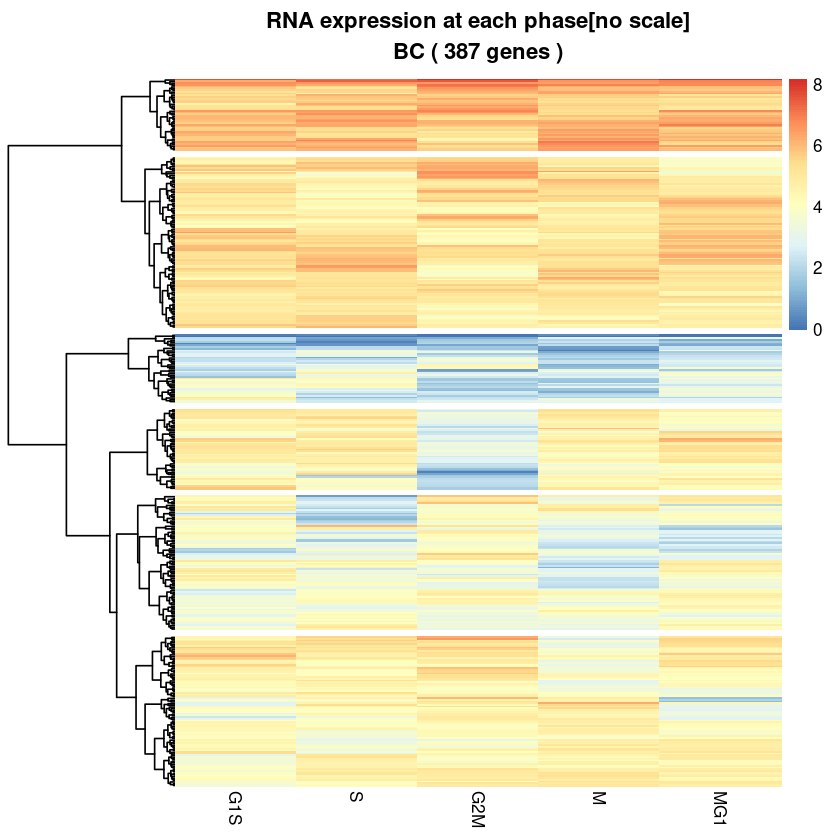

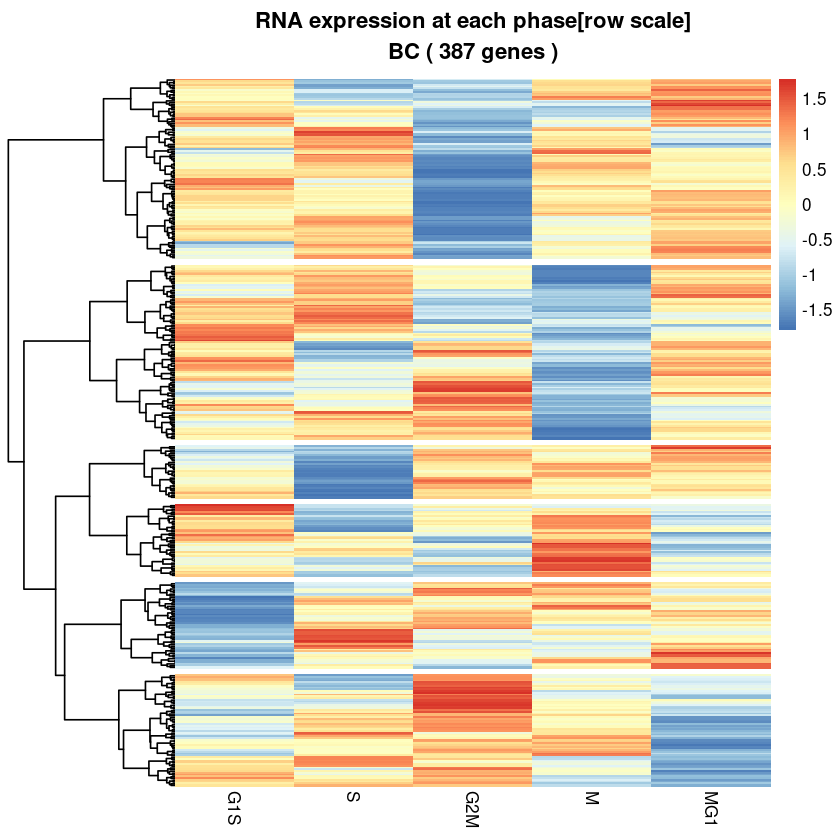

In [48]:
## RNA expression level of genes correlated with cell cycle at apa level
plotHM_RNA.2=function(exp.phase, newOrder, keyword="BC"){
    #exp.phase=exp.phase.BC
    #newOrder=newOrder.BC
    #
    debug(exp.phase) #18276     5
    debug(newOrder) #393   6
    g.inter=intersect( rownames(exp.phase), rownames(newOrder))
    pl(g.inter) #387
    #ph(g.inter) #"AARD"   "ABCC5"  "ADM"    "AGA"    "AGPAT3" "AGPS"
    
    #setdiff(rownames(newOrder), rownames(exp.phase))
    # 'AL390719.1''MIR4435''AC126283.2''AC025031.2''AL591806.3''AL441992.2'
    
    plotHM_RNA(exp.phase[g.inter,], keyword)
    
}
plotHM_RNA.2(exp.phase.BC, newOrder.BC, "BC")

In [ ]:
## lineplot of BC RNA

## RNA expression at each phase, HeLa

In [49]:
exp.phase.HeLa=getGeneExpEachPhase('He')
dim(exp.phase.HeLa)
head(exp.phase.HeLa)

#save to file
write.csv(exp.phase.HeLa,paste ( "deltaDPAU_HeLa/C4_3_RNAexpression_CellCycle.csv" , sep = "" ) )

[1] 56
G1S G2M   M MG1   S 
 14  10  10   9  13 


[1] 16938     5

,G1S,S,G2M,M,MG1
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
A1BG-AS1,0.1980867,0.1627744,0.000000,0.000000,0.3599587
A2M,0.0000000,0.0000000,0.254130,0.000000,1.9538753
A2M-AS1,0.0000000,0.8552942,0.000000,0.000000,0.0000000
A2MP1,0.0000000,4.6710724,0.000000,0.000000,0.0000000
A4GALT,0.4491235,1.6974073,2.308196,1.109803,0.8504435
AAAS,5.2618282,5.3214938,3.419979,4.243965,5.8050026


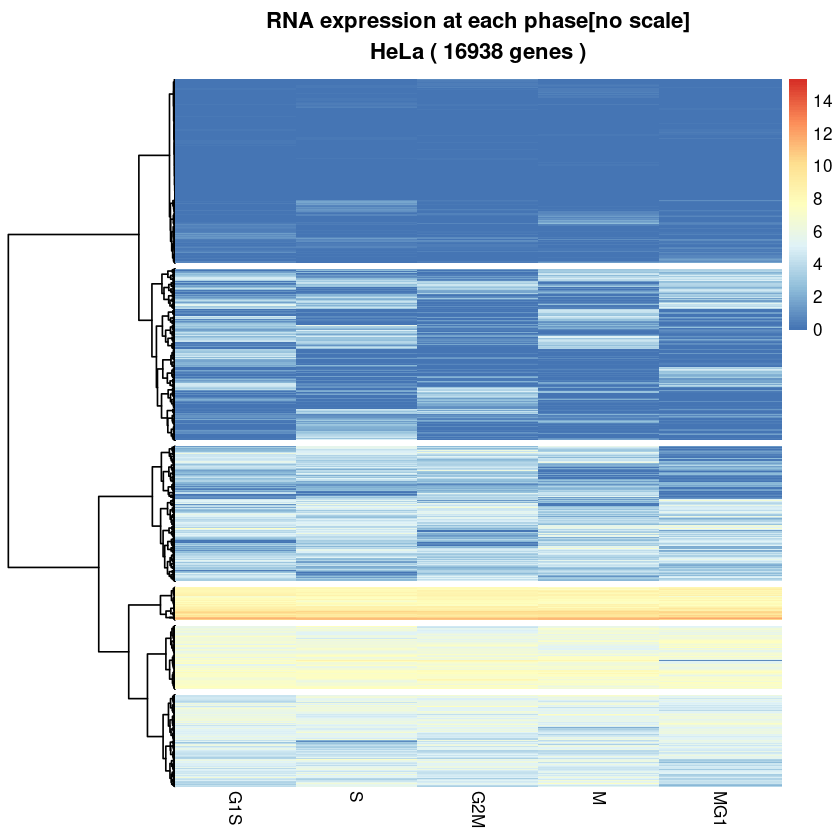

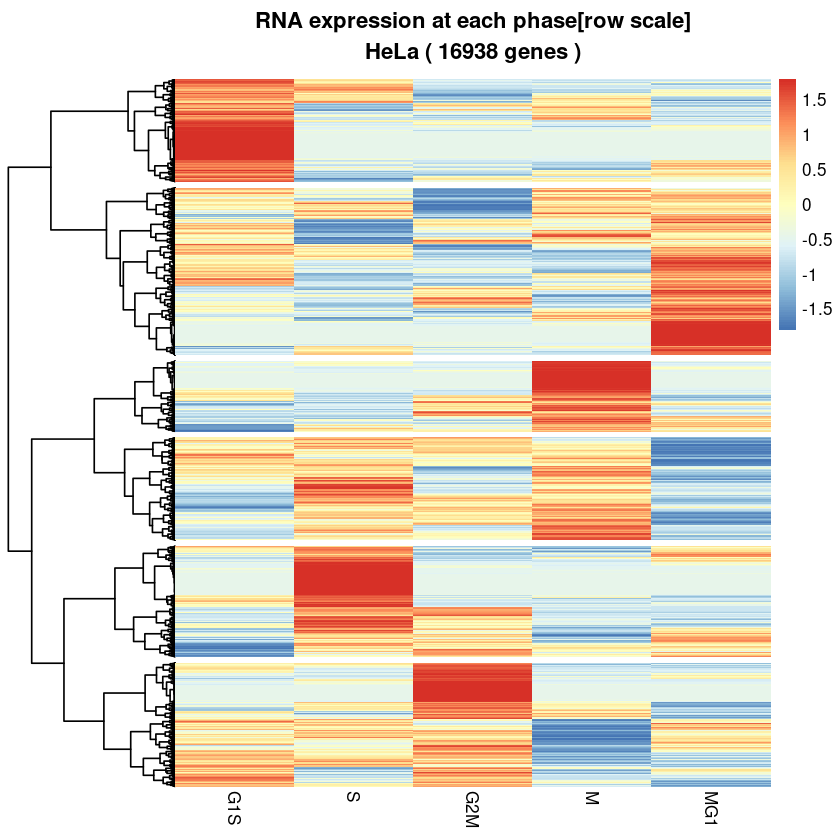

In [50]:
plotHM_RNA(exp.phase.HeLa, keyword="HeLa") #consuming 30s

[1] 16938     5
               G1S         S      G2M        M       MG1
A1BG-AS1 0.1980867 0.1627744 0.000000 0.000000 0.3599587
A2M      0.0000000 0.0000000 0.254130 0.000000 1.9538753
A2M-AS1  0.0000000 0.8552942 0.000000 0.000000 0.0000000
A2MP1    0.0000000 4.6710724 0.000000 0.000000 0.0000000
A4GALT   0.4491235 1.6974073 2.308196 1.109803 0.8504435
AAAS     5.2618282 5.3214938 3.419979 4.243965 5.8050026
[1] 269   6
             G1S S      G2M         M       MG1  Cluster
IAH1    77.77778 0  0.00000  99.29972  69.64286 Cluster1
IQSEC1 100.00000 0  0.00000 100.00000  71.42857 Cluster1
UFSP2   97.29730 0  0.00000 100.00000  93.33333 Cluster1
ZNF330  98.71795 0  0.00000  74.29379  73.05912 Cluster1
SLC4A7 100.00000 0 50.00000 100.00000 100.00000 Cluster1
ZNF507  66.66667 0 42.30769 100.00000 100.00000 Cluster1
[1] 265


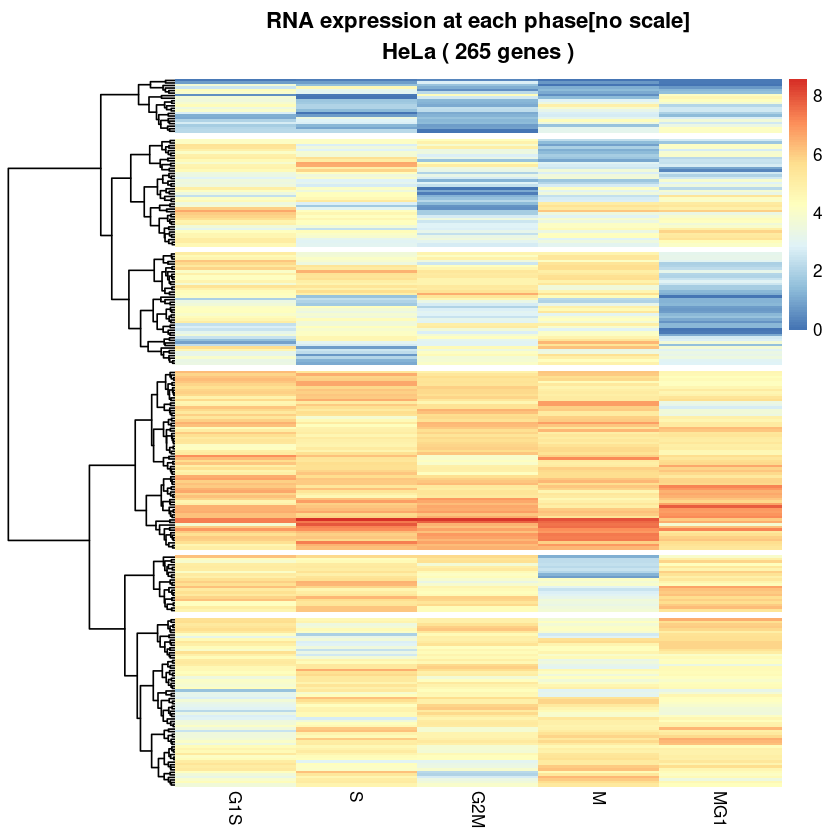

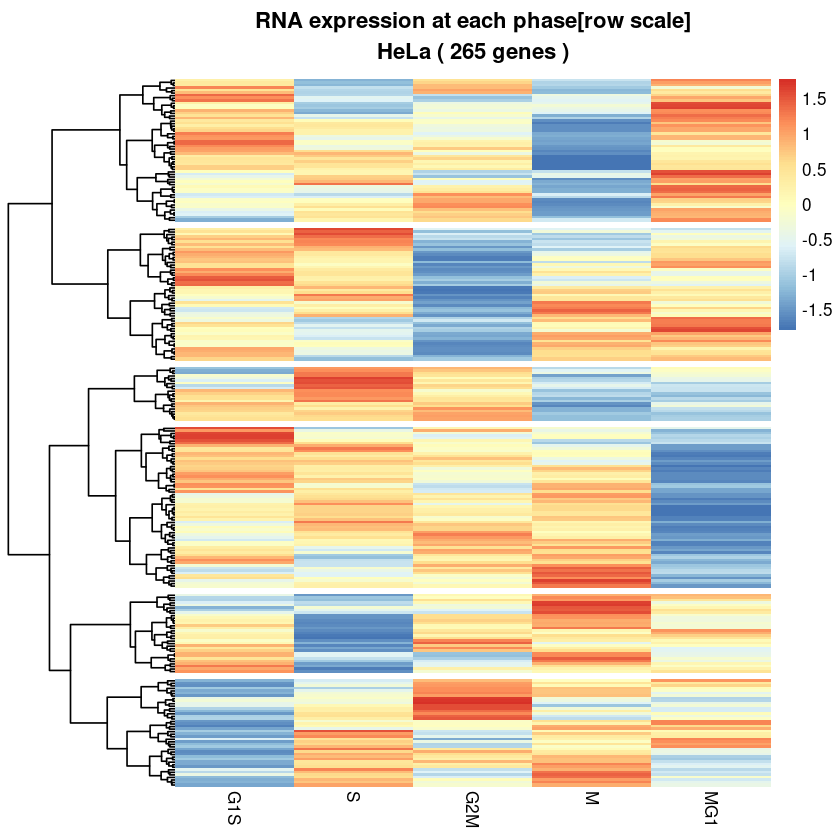

In [52]:
#
plotHM_RNA.2(exp.phase.HeLa, newOrder.HeLa, "HeLa")

            G1S        S      G2M  M      MG1
NUDT19 66.90766 96.70053 85.18519 40 88.88889
            G1S   S G2M        M      MG1
NUDT19 83.33333 100 100 33.33333 10.25641


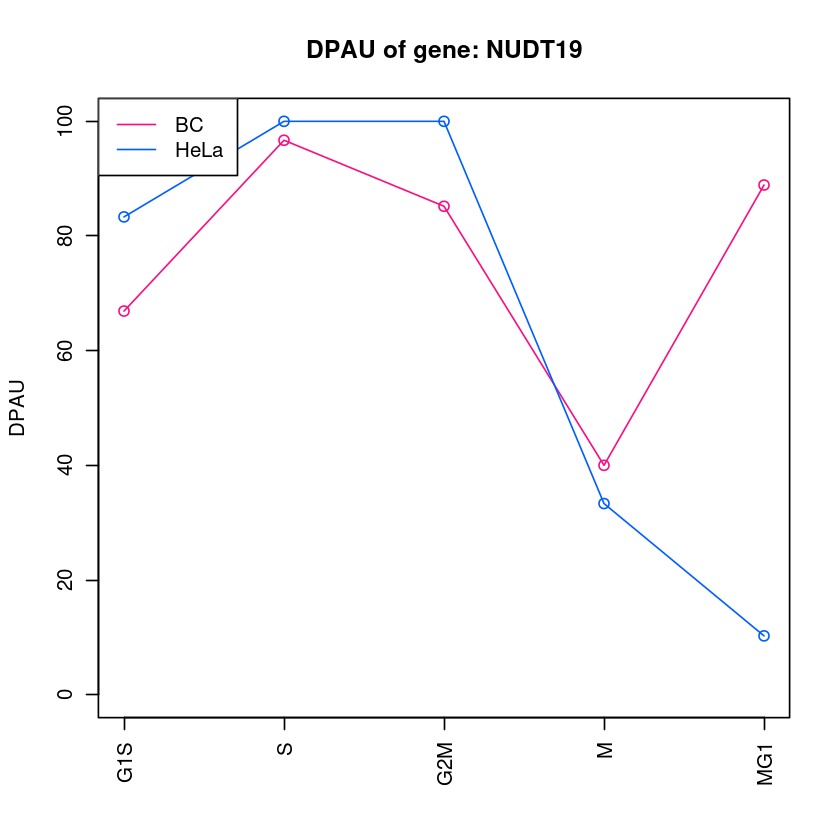

In [55]:
(function(){
    #newOrder=newOrder.BC
    #newOrder=newOrder.HeLa
    f1=function(gene,pos="bottomleft"){
        #
        colors=c('#F81082', '#005FFF')
        #
        a1=newOrder.BC[gene,1:5]; print(a1);
        plot(  as.numeric(a1), type="o" , main=paste('DPAU of gene:',gene),
             xaxt="n",
             col=colors[1], ylim=c(0,100), xlab="", ylab="DPAU")
        #
        axis(1,at=1:5,labels=colnames(newOrder.BC)[1:5],col.axis="black",las=2)
        #
        a2=newOrder.HeLa[gene,1:5]; print(a2);
        lines(  as.numeric(a2), type="o", col=colors[2])
        legend(pos, col=colors,lty=1, legend=c('BC',"HeLa"))
    }
    
    #f1('NUDT19',newOrder.BC, 'BC')
    #f1('NUDT19', newOrder.HeLa, 'HeLa')
    gene='NUDT19'
    #gene="SRSF8"
    #gene="TIMM22"
    f1(gene,pos="topleft")
})()

# RNA and DPAU correlation

[1] 18276     5
                G1S          S        G2M          M        MG1
A1BG-AS1 3.23352601 0.73421150 2.74618342 3.95572973 1.97142222
A2M      0.02081696 1.45747386 0.05344868 0.39367722 0.07267556
A2M-AS1  0.02123238 0.00000000 0.00000000 0.00000000 0.00000000
A2ML1    0.32947398 0.00000000 0.00000000 0.00000000 0.04438481
A2MP1    0.00000000 0.00000000 0.00000000 0.00000000 0.01263214
A4GALT   0.00000000 0.02581513 0.32019311 0.05938426 0.01338089
[1] 393   6
             G1S         S       G2M         M      MG1  Cluster
EPHB2   42.85714  1.666667  1.851852  16.66667 16.66667 Cluster1
RAP2C   94.01709 38.845733 55.500000  72.72727 73.68263 Cluster1
ZSCAN16 47.73991  0.000000 11.875000  31.28149 37.36299 Cluster1
ICE1    77.54986 34.391534 40.816327  64.72460 66.71917 Cluster1
CHMP2B  41.55844  0.000000  0.000000  48.82812 14.46541 Cluster1
IGF2BP2 92.70833 36.553319 52.857143 100.00000 60.00000 Cluster1
[1] 387


Warning message in cor.test.default(as.numeric(exp.phase[gene, ]), as.numeric(newOrder[gene, :
“Cannot compute exact p-value with ties”
Warning message in cor.test.default(as.numeric(exp.phase[gene, ]), as.numeric(newOrder[gene, :
“Cannot compute exact p-value with ties”
Warning message in cor.test.default(as.numeric(exp.phase[gene, ]), as.numeric(newOrder[gene, :
“Cannot compute exact p-value with ties”
Warning message in cor.test.default(as.numeric(exp.phase[gene, ]), as.numeric(newOrder[gene, :
“Cannot compute exact p-value with ties”
Warning message in cor.test.default(as.numeric(exp.phase[gene, ]), as.numeric(newOrder[gene, :
“Cannot compute exact p-value with ties”
Warning message in cor.test.default(as.numeric(exp.phase[gene, ]), as.numeric(newOrder[gene, :
“Cannot compute exact p-value with ties”
Warning message in cor.test.default(as.numeric(exp.phase[gene, ]), as.numeric(newOrder[gene, :
“Cannot compute exact p-value with ties”
Warning message in cor.test.default(as.numeric(e

Warning message in cor.test.default(as.numeric(exp.phase[gene, ]), as.numeric(newOrder[gene, :
“Cannot compute exact p-value with ties”
Warning message in cor.test.default(as.numeric(exp.phase[gene, ]), as.numeric(newOrder[gene, :
“Cannot compute exact p-value with ties”
Warning message in cor.test.default(as.numeric(exp.phase[gene, ]), as.numeric(newOrder[gene, :
“Cannot compute exact p-value with ties”
Warning message in cor.test.default(as.numeric(exp.phase[gene, ]), as.numeric(newOrder[gene, :
“Cannot compute exact p-value with ties”
Warning message in cor.test.default(as.numeric(exp.phase[gene, ]), as.numeric(newOrder[gene, :
“Cannot compute exact p-value with ties”
Warning message in cor.test.default(as.numeric(exp.phase[gene, ]), as.numeric(newOrder[gene, :
“Cannot compute exact p-value with ties”
Warning message in cor.test.default(as.numeric(exp.phase[gene, ]), as.numeric(newOrder[gene, :
“Cannot compute exact p-value with ties”
Warning message in cor.test.default(as.numeric(e

,gene,cor,p,p.adj
,<fct>,<dbl>,<dbl>,<dbl>
CEP295,CEP295,1.0000000,0.01666667,0.7166667
GEMIN5,GEMIN5,1.0000000,0.01666667,0.7166667
PRDM1,PRDM1,1.0000000,0.01666667,0.7166667
RRAS2,RRAS2,1.0000000,0.01666667,0.7166667
CHMP2B,CHMP2B,0.9746794,0.00481823,0.4661638
SUPT4H1,SUPT4H1,0.9746794,0.00481823,0.4661638


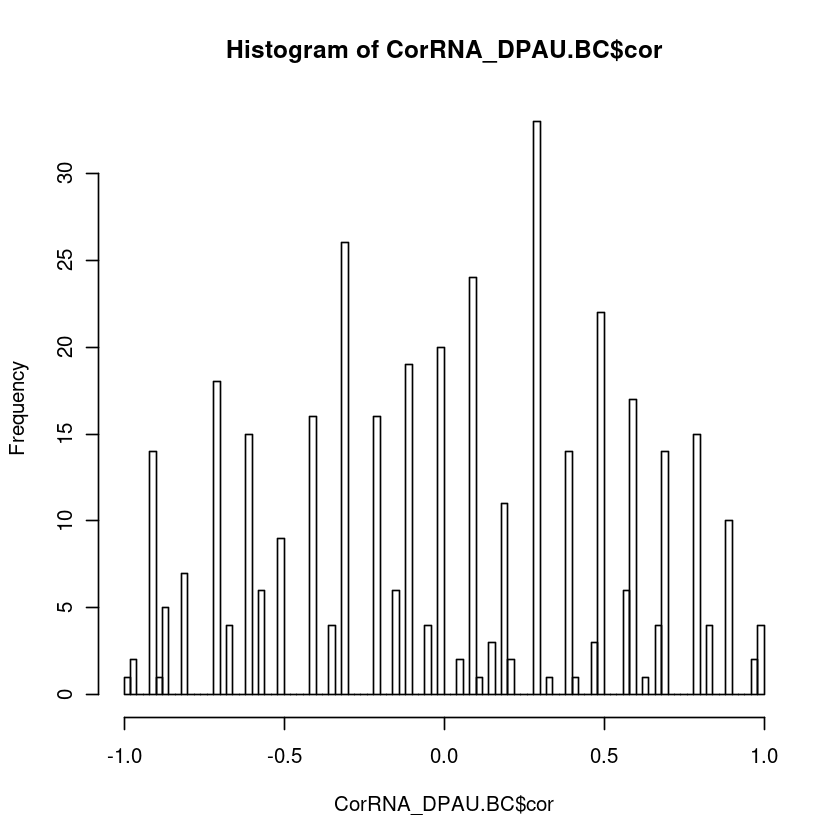

In [56]:
## RNA expression level of genes correlated with cell cycle at apa level
getCorRNA_DPAU=function(exp.phase, newOrder, keyword="BC", output="deltaDPAU_BC/"){
    #exp.phase=exp.phase.BC
    #newOrder=newOrder.BC
    #
    debug(exp.phase) #18276     5
    debug(newOrder) #393   6
    g.inter=intersect( rownames(exp.phase), rownames(newOrder))
    pl(g.inter) #387
    #ph(g.inter) #"AARD"   "ABCC5"  "ADM"    "AGA"    "AGPAT3" "AGPS"
    
    #setdiff(rownames(newOrder), rownames(exp.phase))
    # 'AL390719.1''MIR4435''AC126283.2''AC025031.2''AL591806.3''AL441992.2'
    
    tmp_df=NULL;
    for(gene in g.inter){
        #print(gene)
        ct=cor.test( as.numeric( exp.phase[gene,]),  as.numeric( newOrder[gene, 1:5]), method='spearman' )
        tmp_df=rbind(tmp_df, data.frame(
            gene=gene,
            cor=as.numeric(ct$estimate),
            p=ct$p.value
        ))
    }
    row.names(tmp_df)=tmp_df$gene
    tmp_df=tmp_df[order(-tmp_df$cor),]
    tmp_df$p.adj=p.adjust(tmp_df$p, method = 'fdr')
    
    # write to file
    write.csv(tmp_df, paste ( output , "C5_geneRNA_DPAU_correlation.csv" , sep = "" ) )
    
    return(tmp_df)
}
CorRNA_DPAU.BC=getCorRNA_DPAU(exp.phase.BC, newOrder.BC, "BC",output="deltaDPAU_BC/")
head(CorRNA_DPAU.BC)
hist(CorRNA_DPAU.BC$cor, n=100)

[1] 16938     5
               G1S         S      G2M        M       MG1
A1BG-AS1 0.1980867 0.1627744 0.000000 0.000000 0.3599587
A2M      0.0000000 0.0000000 0.254130 0.000000 1.9538753
A2M-AS1  0.0000000 0.8552942 0.000000 0.000000 0.0000000
A2MP1    0.0000000 4.6710724 0.000000 0.000000 0.0000000
A4GALT   0.4491235 1.6974073 2.308196 1.109803 0.8504435
AAAS     5.2618282 5.3214938 3.419979 4.243965 5.8050026
[1] 269   6
             G1S S      G2M         M       MG1  Cluster
IAH1    77.77778 0  0.00000  99.29972  69.64286 Cluster1
IQSEC1 100.00000 0  0.00000 100.00000  71.42857 Cluster1
UFSP2   97.29730 0  0.00000 100.00000  93.33333 Cluster1
ZNF330  98.71795 0  0.00000  74.29379  73.05912 Cluster1
SLC4A7 100.00000 0 50.00000 100.00000 100.00000 Cluster1
ZNF507  66.66667 0 42.30769 100.00000 100.00000 Cluster1
[1] 265


Warning message in cor.test.default(as.numeric(exp.phase[gene, ]), as.numeric(newOrder[gene, :
“Cannot compute exact p-value with ties”
Warning message in cor.test.default(as.numeric(exp.phase[gene, ]), as.numeric(newOrder[gene, :
“Cannot compute exact p-value with ties”
Warning message in cor.test.default(as.numeric(exp.phase[gene, ]), as.numeric(newOrder[gene, :
“Cannot compute exact p-value with ties”
Warning message in cor.test.default(as.numeric(exp.phase[gene, ]), as.numeric(newOrder[gene, :
“Cannot compute exact p-value with ties”
Warning message in cor.test.default(as.numeric(exp.phase[gene, ]), as.numeric(newOrder[gene, :
“Cannot compute exact p-value with ties”
Warning message in cor.test.default(as.numeric(exp.phase[gene, ]), as.numeric(newOrder[gene, :
“Cannot compute exact p-value with ties”
Warning message in cor.test.default(as.numeric(exp.phase[gene, ]), as.numeric(newOrder[gene, :
“Cannot compute exact p-value with ties”
Warning message in cor.test.default(as.numeric(e

Warning message in cor.test.default(as.numeric(exp.phase[gene, ]), as.numeric(newOrder[gene, :
“Cannot compute exact p-value with ties”
Warning message in cor.test.default(as.numeric(exp.phase[gene, ]), as.numeric(newOrder[gene, :
“Cannot compute exact p-value with ties”
Warning message in cor.test.default(as.numeric(exp.phase[gene, ]), as.numeric(newOrder[gene, :
“Cannot compute exact p-value with ties”
Warning message in cor.test.default(as.numeric(exp.phase[gene, ]), as.numeric(newOrder[gene, :
“Cannot compute exact p-value with ties”
Warning message in cor.test.default(as.numeric(exp.phase[gene, ]), as.numeric(newOrder[gene, :
“Cannot compute exact p-value with ties”
Warning message in cor.test.default(as.numeric(exp.phase[gene, ]), as.numeric(newOrder[gene, :
“Cannot compute exact p-value with ties”
Warning message in cor.test.default(as.numeric(exp.phase[gene, ]), as.numeric(newOrder[gene, :
“Cannot compute exact p-value with ties”
Warning message in cor.test.default(as.numeric(e

Warning message in cor.test.default(as.numeric(exp.phase[gene, ]), as.numeric(newOrder[gene, :
“Cannot compute exact p-value with ties”
Warning message in cor.test.default(as.numeric(exp.phase[gene, ]), as.numeric(newOrder[gene, :
“Cannot compute exact p-value with ties”
Warning message in cor.test.default(as.numeric(exp.phase[gene, ]), as.numeric(newOrder[gene, :
“Cannot compute exact p-value with ties”
Warning message in cor.test.default(as.numeric(exp.phase[gene, ]), as.numeric(newOrder[gene, :
“Cannot compute exact p-value with ties”
Warning message in cor.test.default(as.numeric(exp.phase[gene, ]), as.numeric(newOrder[gene, :
“Cannot compute exact p-value with ties”
Warning message in cor.test.default(as.numeric(exp.phase[gene, ]), as.numeric(newOrder[gene, :
“Cannot compute exact p-value with ties”
Warning message in cor.test.default(as.numeric(exp.phase[gene, ]), as.numeric(newOrder[gene, :
“Cannot compute exact p-value with ties”
Warning message in cor.test.default(as.numeric(e

,gene,cor,p,p.adj
,<fct>,<dbl>,<dbl>,<dbl>
LTN1,LTN1,1.0000000,0.01666667,0.4015152
GCSH,GCSH,0.9746794,0.00481823,0.2128052
SRSF8,SRSF8,0.9746794,0.00481823,0.2128052
IQSEC1,IQSEC1,0.9486833,0.01384683,0.4015152
NSL1,NSL1,0.9000000,0.08333333,0.5868889
PHF23,PHF23,0.9000000,0.08333333,0.5868889


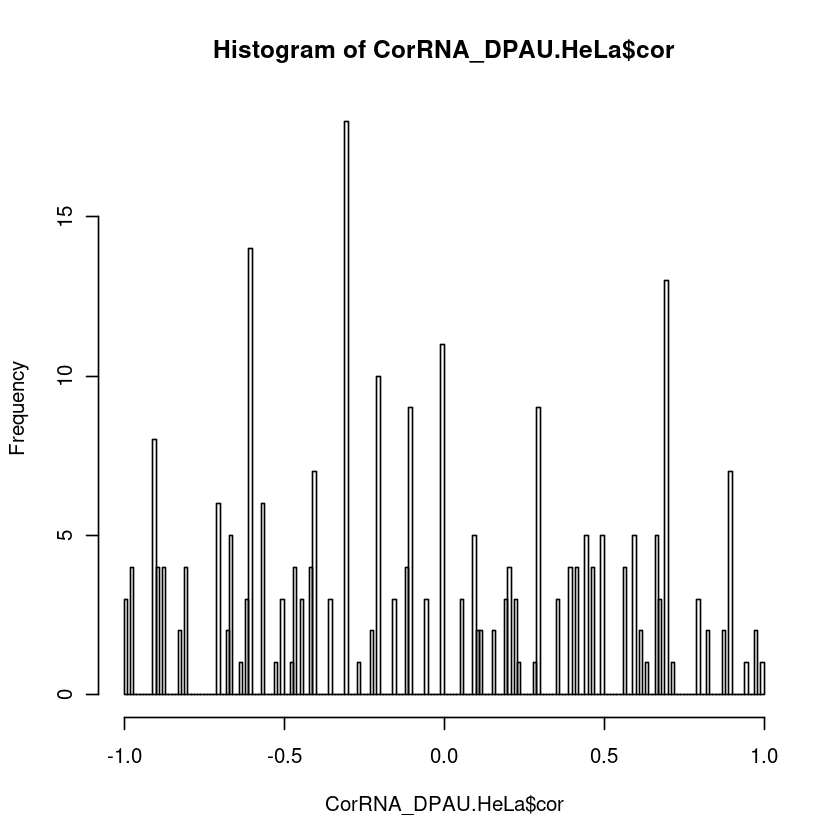

In [57]:
# what about HeLa
# RNA expression level of genes correlated with cell cycle at apa level
CorRNA_DPAU.HeLa=getCorRNA_DPAU(exp.phase.HeLa, newOrder.HeLa, "HeLa")
head(CorRNA_DPAU.HeLa)
hist(CorRNA_DPAU.HeLa$cor, n=200)

[1] 265
         G1S        S      G2M        M      MG1
LTN1 5.63577 4.619042 4.919666 3.703912 6.537835
          G1S  S      G2M M MG1  Cluster
LTN1 86.55556 50 66.66667 0 100 Cluster4
     gene cor          p     p.adj
LTN1 LTN1   1 0.01666667 0.4015152


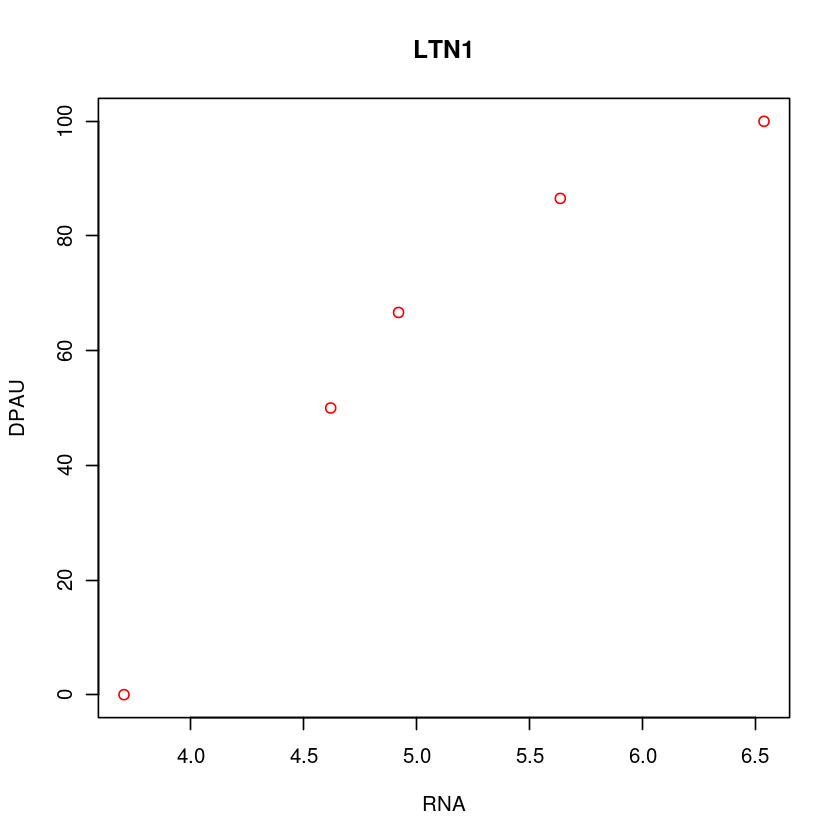

In [59]:
##  check
(function(){
    rna=exp.phase.HeLa
    dpau=newOrder.HeLa
    
    n=nrow(CorRNA_DPAU.HeLa)
    i=1
    gene=rownames(CorRNA_DPAU.HeLa)[i]
    #
    print(n)
    ph(rna[gene,])
    ph(dpau[gene,])
    ph(CorRNA_DPAU.HeLa[gene,])

    plot(as.numeric(rna[gene,]), as.numeric(dpau[gene,1:5]), xlab='RNA', ylab='DPAU', main=gene, type='p', col=rainbow(n)[i])
    
    #cor.test( as.numeric(rna[gene,]), as.numeric(dpau[gene,1:5]), method='spearman' )
    
})()

# Plot coverage track of genes in each cycle

## gene samples at each cluster, BC

             G1S         S       G2M         M      MG1  Cluster
EPHB2   42.85714  1.666667  1.851852  16.66667 16.66667 Cluster1
RAP2C   94.01709 38.845733 55.500000  72.72727 73.68263 Cluster1
ZSCAN16 47.73991  0.000000 11.875000  31.28149 37.36299 Cluster1
ICE1    77.54986 34.391534 40.816327  64.72460 66.71917 Cluster1
CHMP2B  41.55844  0.000000  0.000000  48.82812 14.46541 Cluster1
IGF2BP2 92.70833 36.553319 52.857143 100.00000 60.00000 Cluster1
[1] 5 6
    Cluster1 Cluster2 Cluster3 Cluster4 Cluster5 Cluster6
G1S 62.85729 52.76374 36.34435 48.66904 53.84034 57.83271
S   13.87984 80.18387 75.05716 30.51944 71.32106 50.33235
G2M 55.36104 87.96763 57.31408 78.98140 18.89957 17.62670
M   61.65515 30.16861 64.74714 39.87616 36.73340 71.41620
MG1 53.28356 48.04229 43.43741 61.62955 71.42295 46.09559
[1] "G1S" "S"   "G2M" "M"   "MG1"


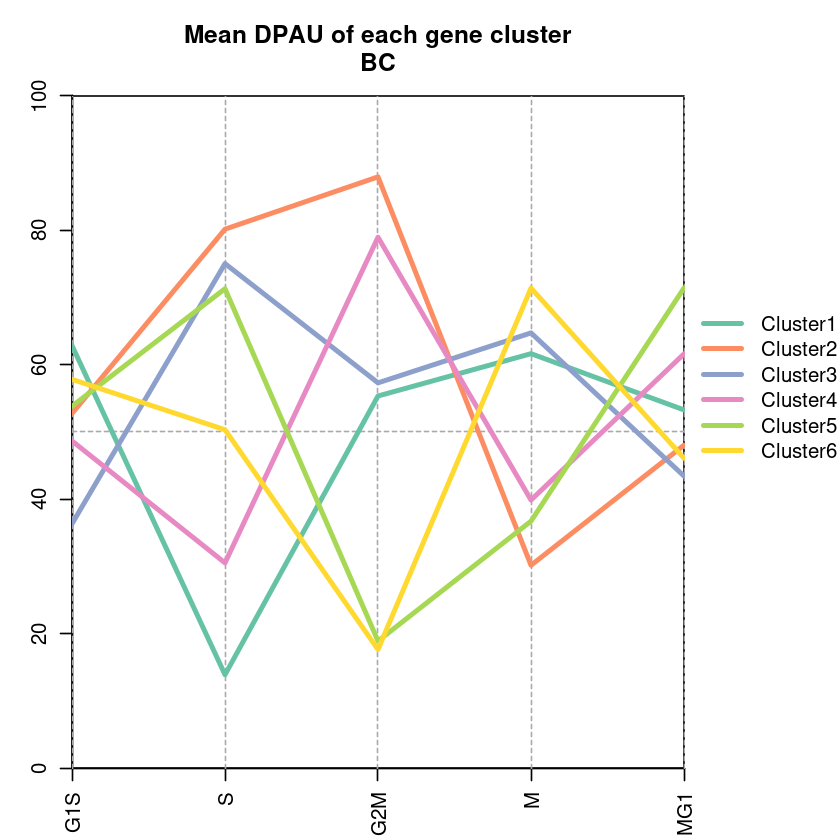

In [60]:
#functions for BC, HeLa, both

#step1: asign mean DPAU for each Cluster
assignClusterMean=function(keyword, output){
    #output="deltaDPAU_BC/"
    newOrder=read.table( paste0(output,"/7_6_3_DPAU_cycleRelatedGenes.pheatmap.cluster.txt") )
    ph(newOrder)
    clusterMean=sapply( split(newOrder[,1:5], newOrder$Cluster), function(x){
        apply(x,2,mean)
    })
    clusterMean=as.data.frame(clusterMean)
    pd(clusterMean)
    ph(clusterMean)
    
    #2. plot
    col=RColorBrewer::brewer.pal(n = 8,name = "Set2")
    par(mar=c(3,3,4,6.5))
    plot(NULL, xlim=c(1,5), ylim=c(0,100), ylab="Mean DPAU", xlab="", #"Cell Cycle", 
         xaxt="n", # no x axis
         xaxs="i",yaxs="i", #eliminate empty space on the edge
         main=paste0("Mean DPAU of each gene cluster\n", keyword ) )
    CycleNames=colnames(newOrder)[1:5];
    print(CycleNames)
    axis(1, at=c(1:5), labels=CycleNames , #col.axis="red", srt=45,
        las=2)
    # dashed line
    abline( h=50, v=1:5, col="#AAAAAA", lwd=1, lty=2 ) #背景灰线
    # main lines
    for(i in 1:6){
        lines(1:5, clusterMean[,i], col=col[i], lwd=3)
    }
    legend(x=5,y=70,,col=col, lwd=3, xpd=T, bty="n",legend=paste0('Cluster',1:6))
    return( clusterMean )
}
clusterMean.BC=assignClusterMean('BC', output='deltaDPAU_BC/')

In [61]:
#step2: corelation with cluster mean, and order these genes
assignRefCors=function(tmp, clusterMean, keyword, output){
    #tmp=tmp.BC
    #clusterMean=clusterMean.BC
    #pd(clusterMean)#5 6
    #ph(clusterMean)
    #
    #pd(tmp)#393 6
    #ph(tmp)
    #
    rs=t( apply(tmp, 1, function(sampleDPAU){
        apply(clusterMean, 2, function(refDPAU){
            cor(sampleDPAU, refDPAU)
        })
    }) )
    #
    rs=as.data.frame(rs)
    pd(rs)
    write.csv(rs, paste0 ( output ,'C_3_3_geneCorWithCluster_',keyword, ".csv" ) )
    return(rs)
}
#
geneCorWithCluster.BC=assignRefCors(tmp.BC, clusterMean.BC, "BC", output='deltaDPAU_BC/')
head(geneCorWithCluster.BC) #[1] 393   6

[1] 393   6


,Cluster1,Cluster2,Cluster3,Cluster4,Cluster5,Cluster6
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
AP4M1,0.6977660,-0.1946719,-0.9897691,0.53815479,-0.03914638,-0.14714081
ATF2,-0.7283257,0.5025404,0.7123486,-0.00407865,0.18266962,-0.40470991
CBX1,0.7748065,-0.2519963,-0.9224909,0.41901099,-0.21062349,-0.01228034
ERP44,-0.9114998,0.3774205,0.8849780,-0.49281260,0.35250966,-0.01208652
MIGA1,-0.8797659,0.3741805,0.7853471,-0.35584566,0.42095214,-0.10896861
MRTO4,0.6714735,0.0921965,-0.8554194,0.82283587,-0.31162313,-0.50501243


In [62]:
# step3 order by cluster
head(geneCorWithCluster.BC[order(-geneCorWithCluster.BC$Cluster1),], n=10)

,Cluster1,Cluster2,Cluster3,Cluster4,Cluster5,Cluster6
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
PELO,0.9990030,-0.5359754,-0.6795855,0.5271863,-0.5366251,0.06395992
SCO1,0.9941495,-0.5400879,-0.6681686,0.5496270,-0.5292077,0.04618414
NUMB,0.9756349,-0.3565543,-0.7267418,0.6347651,-0.5937212,-0.10047392
ZNF468,0.9714162,-0.6730767,-0.5807790,0.2937461,-0.5045090,0.29731699
RRAGA,0.9364346,-0.4634817,-0.8045668,0.6531991,-0.3513971,-0.07717044
MND1,0.9312123,-0.3970453,-0.8330168,0.4667185,-0.4219295,0.04388929
MOSPD2,0.9296934,-0.5663442,-0.3746893,0.4125859,-0.6863896,0.14060030
APPL1,0.9194586,-0.2059698,-0.5604092,0.7456250,-0.7568401,-0.27106085
FAR1,0.9003191,-0.1332421,-0.6583296,0.7276887,-0.7066852,-0.28800201


### draw track of BC's Cluster related genes

In [63]:
(function(){
    ph(apaSite)
    print('===================')
    ph(apaM[,1:4])
})()

                          PASid   chr     pos strand count     region
chr10:320403:-   chr10:320403:- chr10  320403      - 10945       UTR3
chr10:855485:-   chr10:855485:- chr10  855485      -  3583         PA
chr10:1085971:- chr10:1085971:- chr10 1085971      - 10905       UTR3
chr10:1087286:- chr10:1087286:- chr10 1087286      -   947       exon
chr10:2153297:- chr10:2153297:- chr10 2153297      -   178 intergenic
chr10:2276972:- chr10:2276972:- chr10 2276972      -   169 intergenic
                transcript                down20   gene
chr10:320403:-   DIP2C-201 TGAAAATAGCAGTTTCTTAAT  DIP2C
chr10:855485:-  LARP4B-201 TCAATTTTTCTTTTGATTTTT LARP4B
chr10:1085971:-   IDI1-201 AAAGTTAAATGTTTGTTAAAT   IDI1
chr10:1087286:-   IDI1-205 AAAGGAAGAACTAAAAGAACT   IDI1
chr10:2153297:-          . ACCTGAAAAAAAACACTAATA      .
chr10:2276972:-          . ACAAAAAAATCTAATAGATCT      .
                                                                         up60
chr10:320403:-  TCTGTGATAACGCCTGTTTTATAT

In [64]:
# select gene cor>0.9, order by RNA expression
getCidOfGeneHCcluster=function(clusterNumber,geneCorWithCluster,log2CPM, keyword="BC"){
    i=clusterNumber
    #keyword="BC"
    #cluster=i
    #geneCorWithCluster=geneCorWithCluster.BC
    #log2CPM=log2CPM.BC
    #
    
    #1 genes cor with Cluster >0.9
    geneCorWithCluster=geneCorWithCluster[which(geneCorWithCluster[,i]>0.9),]
    #pd(geneCorWithCluster)
    #print(geneCorWithCluster)
    g.names=rownames(geneCorWithCluster)
    #
    #2. order by RNA expresion
    log2CPM=log2CPM[g.names,]
    log2CPM$cor=geneCorWithCluster[g.names,i]#add cor culumn
    log2CPM=log2CPM[order(-log2CPM$logCPM),]
    pP0('highly correlated with cluster',i, ", high RNA expression genes in ", keyword,': ')
    pd(log2CPM)
    ph(log2CPM)
    
    
    
    
    
    #3. list 20 most cell id order by apa reads, for each gene.
    g.names2=rownames(log2CPM)
    cid=rownames( cellInfo[which( substr(cellInfo$cellType,1,2)==keyword ),] )
    df=as.data.frame(t(rnaM.log2cpm[g.names, cid]))
    pP0("Gene expression of these genes in all cell subset ", keyword,': ')
    pd(df)
    #ph(df[,1:4])
    #
    cell.list=list()
    #w=1
    for(gene in g.names2){
        #print(gene)
        #w=w+1;if(w>3){break;}
        named_apaRead=apply(apaM[ rownames( apaSite[which(apaSite$gene==gene),]), cid],2,sum )
        apa_df=data.frame(
            gene=gene,
            cid=names(named_apaRead),
            apaRead=unname(named_apaRead)
        )
        rownames(apa_df)=apa_df$cid
        apa_df=apa_df[order(-apa_df$apaRead),]
        #ph(apa_df)
        
        #
        df=apa_df
        #df=df[order(-df[,gene]),]
        #ph(df[1:20, ],n=20)
        cid.cycle=rownames(df)[1:20]
        names(cid.cycle)=cellInfo[cid.cycle,'cellCycle']
        cell.list[[gene]]=cid.cycle
    }
    cell.list
}

cell.list.BC=getCidOfGeneHCcluster(1,geneCorWithCluster.BC,log2CPM.BC, keyword="BC")
cell.list.BC

[1] "highly correlated with cluster1, high RNA expression genes in BC: "
[1] 9 4
         gene       cpm   logCPM       cor
APPL1   APPL1 12299.653 13.58645 0.9194586
PELO     PELO  6281.543 12.61713 0.9990030
SCO1     SCO1  5697.362 12.47633 0.9941495
RRAGA   RRAGA  4537.566 12.14802 0.9364346
NUMB     NUMB  4518.426 12.14192 0.9756349
MOSPD2 MOSPD2  3777.826 11.88372 0.9296934
[1] "Gene expression of these genes in all cell subset BC: "
[1] 169   9


$APPL1
       MG1        G1S        G1S          M        MG1          M        G1S 
"c13ROW30" "c14ROW05" "c15ROW38" "c16ROW08" "c15ROW34" "c14ROW37" "c15ROW26" 
       G1S          S          M        G1S        G1S          S        G2M 
"c15ROW13" "c19ROW10" "c14ROW19" "c15ROW05" "c15ROW17" "c16ROW07" "c12ROW07" 
       G1S        MG1        MG1          M        MG1          M 
"c15ROW37" "c13ROW36" "c19ROW39" "c19ROW25" "c19ROW18" "c16ROW25" 

$PELO
         S        G2M        MG1        MG1        MG1        MG1        G2M 
"c13ROW03" "c13ROW08" "c14ROW22" "c16ROW34" "c16ROW27" "c13ROW30" "c19ROW22" 
       MG1        G2M        MG1        MG1        MG1        G2M        G1S 
"c16ROW12" "c13ROW02" "c12ROW39" "c15ROW34" "c13ROW29" "c13ROW16" "c14ROW05" 
       G1S        G1S        G2M        MG1        MG1        MG1 
"c14ROW30" "c15ROW39" "c12ROW30" "c12ROW34" "c15ROW12" "c19ROW20" 

$SCO1
       MG1        G2M        MG1        G1S        G1S        G1S        MG1 
"c13ROW30" "c19ROW13" "c13ROW09" "c16ROW24" "c15ROW13" "c13ROW27" "c13ROW29" 
       MG1        G1S          M        MG1        G1S        G2M        G1S 
"c15ROW31" "c14ROW30" "c15ROW19" "c16ROW34" "c15ROW05" "c19ROW22" "c15ROW38" 
       G1S        G2M          M        MG1          M          M 
"c19ROW12" "c12ROW30" "c14ROW38" "c15ROW12" "c19ROW23" "c16ROW09" 

$RRAGA
         M        MG1          M        MG1          M          S        MG1 
"c16ROW02" "c15ROW34" "c12ROW05" "c16ROW37" "c16ROW25" "c12ROW24" "c16ROW12" 
       MG1        G2M        MG1        G2M          S        G1S        G1S 
"c16ROW27" "c19ROW22" "c19ROW18" "c13ROW02" "c12ROW33" "c15ROW26" "c15ROW38" 
       G1S        MG1        MG1        G1S        MG1        MG1 
"c16ROW05" "c16ROW14" "c16ROW03" "c19ROW27" "c14ROW24" "c12ROW39" 

$NUMB
       G1S        MG1        G1S          S        G1S        G1S        G1S 
"c16ROW31" "c16ROW12" "c12ROW11" "c16ROW07" "c15ROW13" "c15ROW14" "c16ROW20" 
       G1S          S        MG1          M        MG1        MG1        G1S 
"c15ROW29" "c12ROW02" "c16ROW34" "c16ROW08" "c15ROW12" "c12ROW39" "c13ROW06" 
       MG1        MG1        MG1        MG1        MG1        MG1 
"c16ROW03" "c14ROW28" "c13ROW29" "c14ROW16" "c16ROW37" "c19ROW18" 

$MOSPD2
       G1S        G2M        MG1        MG1          S        MG1        G1S 
"c15ROW13" "c16ROW21" "c14ROW28" "c15ROW35" "c14ROW08" "c13ROW26" "c14ROW15" 
       MG1          M        MG1        G1S        MG1        G2M        MG1 
"c12ROW34" "c16ROW08" "c14ROW29" "c15ROW14" "c14ROW22" "c14ROW10" "c15ROW12" 
         M          S        G2M        G2M          M        G1S 
"c14ROW26" "c12ROW02" "c19ROW14" "c19ROW19" "c15ROW19" "c15ROW38" 

$FAR1
       MG1        MG1        G2M        MG1        MG1          S        MG1 
"c13ROW29" "c12ROW39" "c12ROW30" "c15ROW12" "c13ROW26" "c16ROW07" "c15ROW18" 
         S        MG1        G1S        MG1        G1S        MG1          S 
"c19ROW30" "c12ROW08" "c12ROW27" "c12ROW03" "c14ROW09" "c16ROW37" "c14ROW08" 
       G1S        G2M        G2M        MG1          M        G1S 
"c14ROW15" "c12ROW07" "c14ROW34" "c16ROW11" "c12ROW20" "c13ROW07" 

$ZNF468
       G1S        G1S          M          M        MG1        MG1        G2M 
"c15ROW05" "c14ROW15" "c13ROW32" "c12ROW12" "c13ROW09" "c12ROW34" "c14ROW39" 
       G1S        MG1        MG1        G1S          M          M        MG1 
"c14ROW07" "c16ROW12" "c14ROW28" "c12ROW31" "c14ROW37" "c12ROW29" "c19ROW35" 
         M          M        G2M          M        MG1        MG1 
"c15ROW06" "c14ROW12" "c12ROW07" "c12ROW15" "c16ROW27" "c16ROW37" 

$MND1
       G2M        G2M          M          M          M        G1S        G1S 
"c13ROW02" "c13ROW08" "c16ROW08" "c16ROW25" "c12ROW05" "c15ROW29" "c13ROW31" 
       MG1          M          M          M        G2M          M          S 
"c13ROW36" "c12ROW12" "c14ROW12" "c14ROW38" "c19ROW13" "c14ROW37" "c15ROW08" 
         S        G1S        G2M          M        G

In [65]:
# step4: repeat and get gene's bam subset, cell by cell

# get a list of bams of these cells, within the given gene
# using bedtools
getSubBamFiles=function(cellIds, gene){
    #gene=names(cellIds)[1]
    #for(gene in names(cellIds) ){
        print(gene)
        for(cid in unname(cellIds[[gene]]) ){
            cid2=sub("ROW","_ROW", cid)
            #printP(" >>>", cid2)

            # sub bam
            cmd=paste0("bedtools intersect -a /home/wangjl/data/apa/190705PAS/hg19/CutA_",cid2,
                       "_Aligned.sortedByCoord.out.bam -b /home/wangjl/data/apa/191111Figure/f3/apaTracks2/",gene,
                       ".bed >/home/wangjl/data/apa/191111Figure/f3/apaTracks2/",cid,"_",gene,".bam")
            #print(cmd)
            rs=system(cmd, intern =T );#print(rs)

            # index
            cmd2=paste0("samtools index /home/wangjl/data/apa/191111Figure/f3/apaTracks2/",cid,"_",gene,".bam")
            rs=system(cmd2, intern =T );#print(rs)
        }
    #}
}
gene='APPL1'
printP("You shold make a bed file of the gene under the dir first:", gene)
getSubBamFiles(cell.list.BC, gene)


#step5 scp: server dir to local
print(paste0("goto /home/wangjl/data/igv/ and run shell: "))
print(paste0('mkdir /home/wangjl/data/igv/',gene, "; scp wangjl@x.biomooc.com:/home/wangjl/data/apa/191111Figure/f3/apaTracks2/*",gene,"* /home/wangjl/data/igv/",gene,'/') )

print("step6: goto station to copy files from server, then use IGV to show") #30s

[1] "You shold make a bed file of the gene under the dir first: APPL1"
[1] "APPL1"
[1] "goto /home/wangjl/data/igv/ and run shell: "
[1] "mkdir /home/wangjl/data/igv/APPL1; scp wangjl@x.biomooc.com:/home/wangjl/data/apa/191111Figure/f3/apaTracks2/*APPL1* /home/wangjl/data/igv/APPL1/"
[1] "step6: goto station to copy files from server, then use IGV to show"


In [69]:
# set color
(function(){
    genes=names(cell.list.BC)
    namedxx=cell.list.BC[[genes[4]]]
    df=data.frame(
        phase=names(namedxx),
        cid=unname(namedxx)
    )
    df$phase=factor(df$phase, levels = c('G1S', 'S', 'G2M', 'M', 'MG1'))
    df=df[order(df$phase),]
    df$cid=as.character(df$cid)
    #
    print( split(df$cid, df$phase) )
    
    df
})()

$G1S
[1] "c15ROW26" "c15ROW38" "c16ROW05" "c19ROW27"

$S
[1] "c12ROW24" "c12ROW33"

$G2M
[1] "c19ROW22" "c13ROW02"

$M
[1] "c16ROW02" "c12ROW05" "c16ROW25"

$MG1
[1] "c15ROW34" "c16ROW37" "c16ROW12" "c16ROW27" "c19ROW18" "c16ROW14" "c16ROW03"
[8] "c14ROW24" "c12ROW39"



,phase,cid
,<fct>,<chr>
13,G1S,c15ROW26
14,G1S,c15ROW38
15,G1S,c16ROW05
18,G1S,c19ROW27
6,S,c12ROW24
12,S,c12ROW33
9,G2M,c19ROW22
11,G2M,c13ROW02
1,M,c16ROW02


## gene samples at each cluster, HeLa

             G1S S      G2M         M       MG1  Cluster
IAH1    77.77778 0  0.00000  99.29972  69.64286 Cluster1
IQSEC1 100.00000 0  0.00000 100.00000  71.42857 Cluster1
UFSP2   97.29730 0  0.00000 100.00000  93.33333 Cluster1
ZNF330  98.71795 0  0.00000  74.29379  73.05912 Cluster1
SLC4A7 100.00000 0 50.00000 100.00000 100.00000 Cluster1
ZNF507  66.66667 0 42.30769 100.00000 100.00000 Cluster1
[1] 5 6
     Cluster1 Cluster2 Cluster3 Cluster4  Cluster5 Cluster6
G1S 78.062841 37.89264 65.79726 32.19343 59.387318 47.77182
S    7.571889 75.45081 51.41271 46.13232 76.118347 43.16101
G2M 50.231954 19.67665 58.57831 63.97711 77.942868 14.26777
M   58.007222 81.56282 26.76687 20.54030 92.050770 84.51319
MG1 85.349002 84.10930 19.89167 88.20135  6.876596 13.81911
[1] "G1S" "S"   "G2M" "M"   "MG1"
[1] 269   6


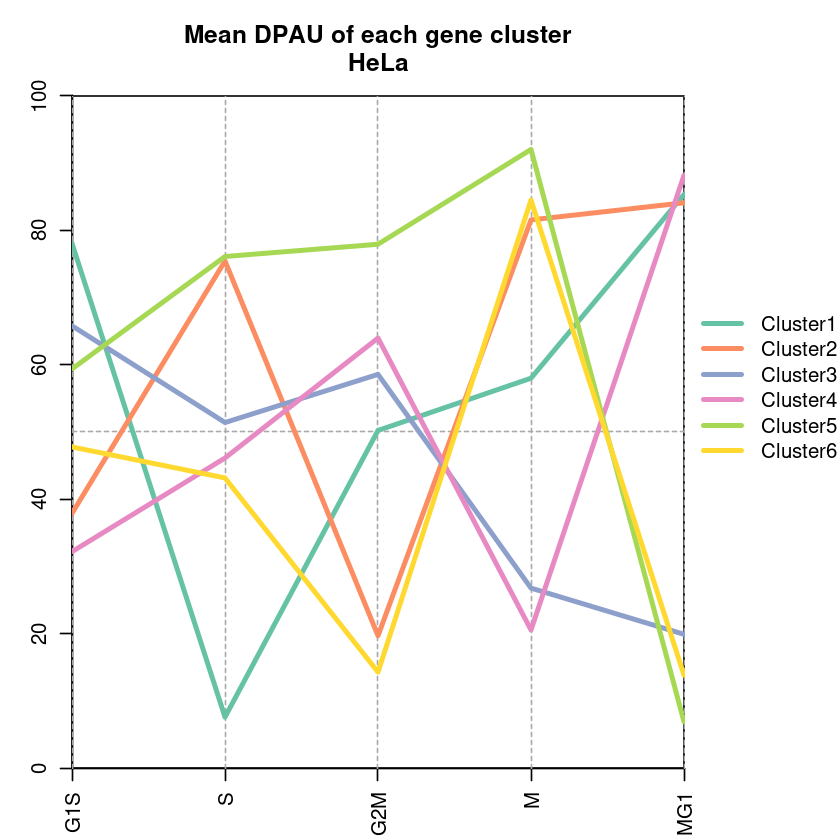

In [70]:
#for HeLa
#step1: asign mean DPAU for each Cluster
clusterMean.HeLa=assignClusterMean('HeLa', output='deltaDPAU_HeLa/')

#step2: corelation with cluster mean, and order these genes
geneCorWithCluster.HeLa=assignRefCors(tmp.HeLa, clusterMean.HeLa, "HeLa", output='deltaDPAU_HeLa/')

In [71]:
# step3 order by cluster
head(geneCorWithCluster.HeLa[order(-geneCorWithCluster.HeLa$Cluster1),], n=10)

,Cluster1,Cluster2,Cluster3,Cluster4,Cluster5,Cluster6
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
MITD1,0.9506733,0.12052547,-0.54482160,0.35386703,-0.6248075,-0.15225781
RBMS1,0.9447744,-0.29050602,-0.07677069,0.42061977,-0.6651546,-0.42379206
SLC4A7,0.9349933,0.08281248,-0.38804398,-0.05875183,-0.3602751,0.20650290
MFSD11,0.9271771,-0.40258704,-0.01199543,0.36596456,-0.5500262,-0.40280347
NSL1,0.9179943,-0.43798139,0.10967699,0.12359518,-0.4065722,-0.20361971
DESI2,0.8939362,0.34457098,-0.53826536,0.29072572,-0.7599500,-0.06732845
NSUN2,0.8700946,-0.54660882,0.17754249,0.11130793,-0.3120478,-0.22627583
AMFR,0.8570951,-0.10059032,-0.43668667,0.23647027,-0.3315856,-0.09477932
GCSH,0.8563957,0.19235618,-0.25908922,0.17348144,-0.7197488,-0.06104763


# cell order with cyclin protein RNA level

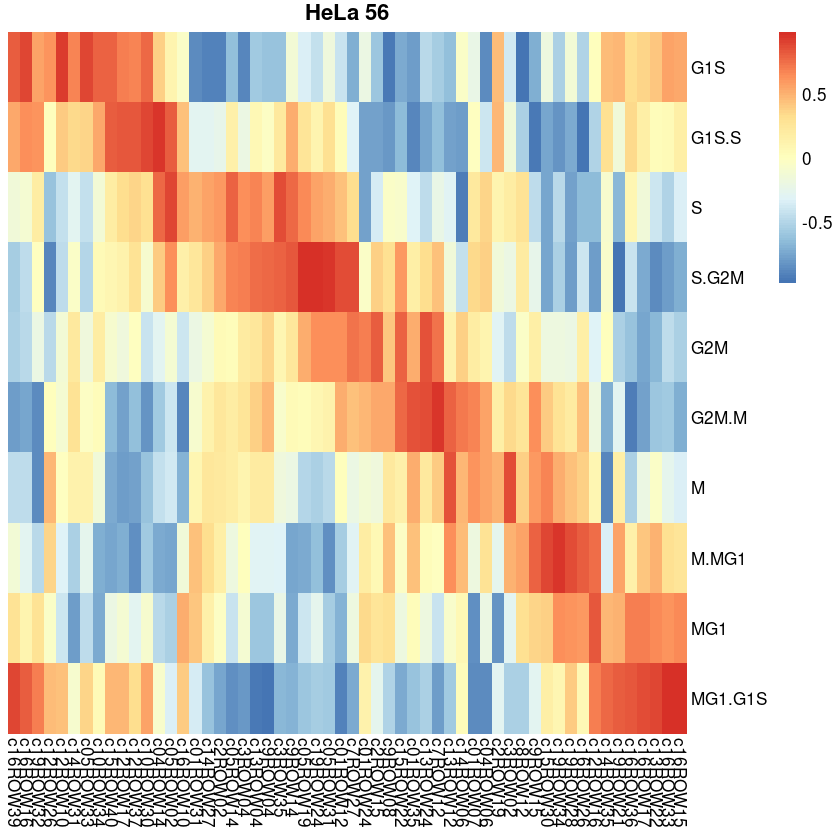

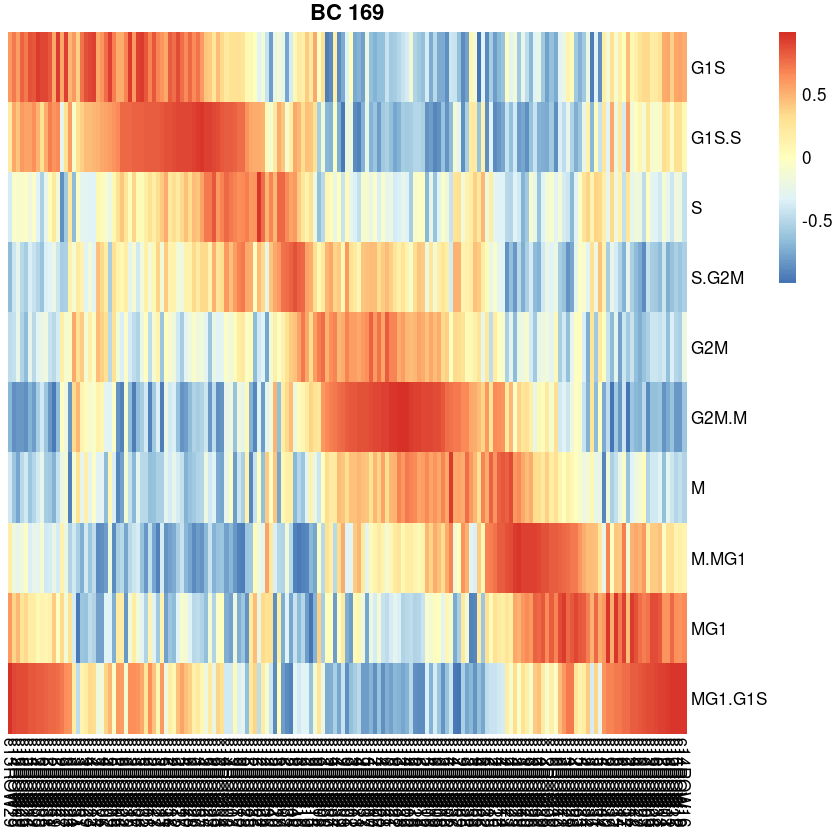

In [503]:
library(pheatmap)
getCellOrder=function(cellType, keyword){
    #cellType for figure
    # keyword for filename
    df0=read.table(paste0('/home/wangjl/data/apa/190530Mix/cell_cycle/result/',keyword,'_PhaseRefCor.txt') )
  df=df0[, 1:10]
  head(df)
  #library(pheatmap)
  pheatmap(t(df)[], border_color = NA,
           cluster_rows = FALSE,
           cluster_cols = FALSE,
           main=paste(cellType, nrow(df)) )
    return(df0)
}
cellOrder.HeLa=getCellOrder('HeLa','HeLa2')
cellOrder.BC=getCellOrder('BC','BC')

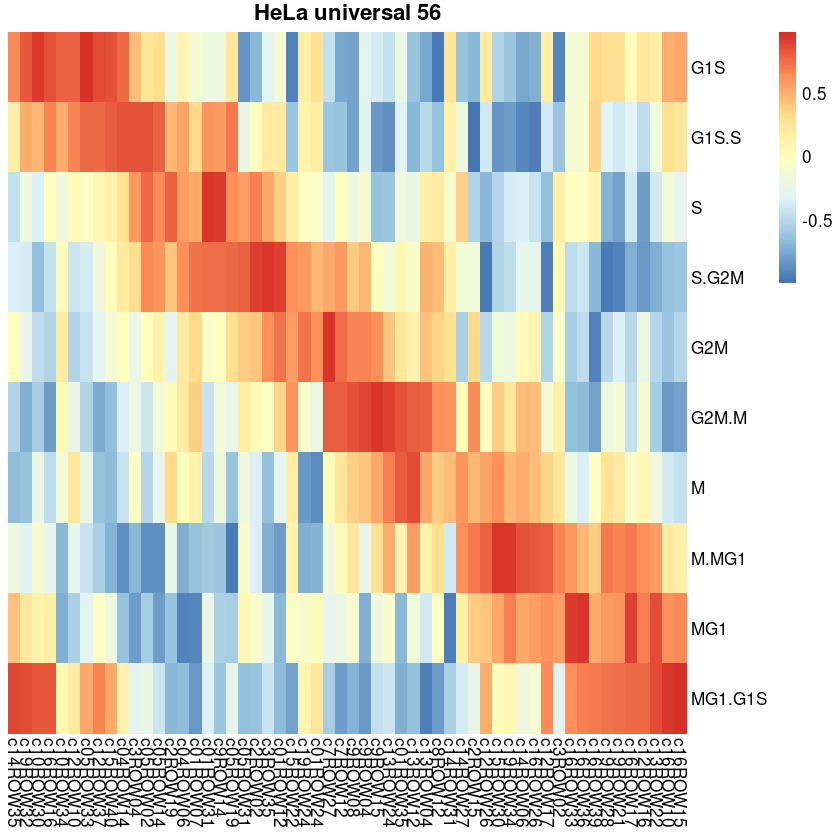

In [504]:
cellOrder.HeLa.Uni=getCellOrder('HeLa universal','HeLa')

In [104]:
head(cellOrder.BC)

,G1S,G1S.S,S,S.G2M,G2M,G2M.M,M,M.MG1,MG1,MG1.G1S,all,assignedPhase
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<lgl>,<fct>
c15ROW29,0.6180495,0.2024841,-0.37005812,-0.6773303,-0.4594987,-0.6960846,-0.3930274,0.17269505,0.6045348,0.9982358,NA,G1S
c14ROW15,0.7372519,0.5545460,-0.05807456,-0.3940921,-0.4245877,-0.8549221,-0.6224737,-0.20787159,0.3678841,0.9023398,NA,G1S
c15ROW09,0.5942709,0.4328328,-0.06416124,-0.2538919,-0.2467916,-0.8308756,-0.7708191,-0.23132826,0.4875010,0.8832631,NA,G1S
c16ROW29,0.8067125,0.6069823,-0.06331399,-0.4966145,-0.5449121,-0.8306793,-0.4724581,-0.16206349,0.2739717,0.8823749,NA,G1S
c15ROW26,0.7259125,0.5769423,-0.01930546,-0.5618677,-0.6688392,-0.8640789,-0.3894371,-0.03083737,0.3516692,0.8798418,NA,G1S
c15ROW14,0.8595116,0.5574812,-0.17673929,-0.3498237,-0.2517055,-0.7099997,-0.6178629,-0.35196451,0.1867962,0.8543067,NA,G1S


In [197]:
(function(){
    dt=rnaM.log2cpm;
    print( dt[1:10,1:5] )
    print(1==11)
    rnaM.log2cpm.to1[1:10,1:5]
})()

         c01ROW24 c01ROW35 c01ROW31 c05ROW02 c05ROW14
A1BG-AS1 0.000000 0.000000 0.000000        0 0.000000
A2M      0.000000 0.000000 0.000000        0 0.000000
A2M-AS1  0.000000 0.000000 0.000000        0 0.000000
A2ML1    0.000000 0.000000 0.000000        0 0.000000
A2MP1    0.000000 0.000000 0.000000        0 0.000000
A4GALT   0.000000 0.000000 0.000000        0 0.000000
AAAS     6.079935 0.000000 6.221933        0 2.476998
AACS     0.000000 1.400482 0.000000        0 0.000000
AADACL3  0.000000 0.000000 0.000000        0 0.000000
AADAT    0.000000 0.000000 0.000000        0 0.000000
[1] FALSE


,c01ROW24,c01ROW35,c01ROW31,c05ROW02,c05ROW14
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
A1BG-AS1,0.0000000,0.0000000,0.000000,0,0.0000000
A2M,0.0000000,0.0000000,0.000000,0,0.0000000
A2M-AS1,0.0000000,0.0000000,0.000000,0,0.0000000
A2ML1,0.0000000,0.0000000,0.000000,0,0.0000000
A2MP1,0.0000000,0.0000000,0.000000,0,0.0000000
A4GALT,0.0000000,0.0000000,0.000000,0,0.0000000
AAAS,0.6926207,0.0000000,0.708797,0,0.2821774
AACS,0.0000000,0.1612575,0.000000,0,0.0000000
AADACL3,0.0000000,0.0000000,0.000000,0,0.0000000


[1] 56


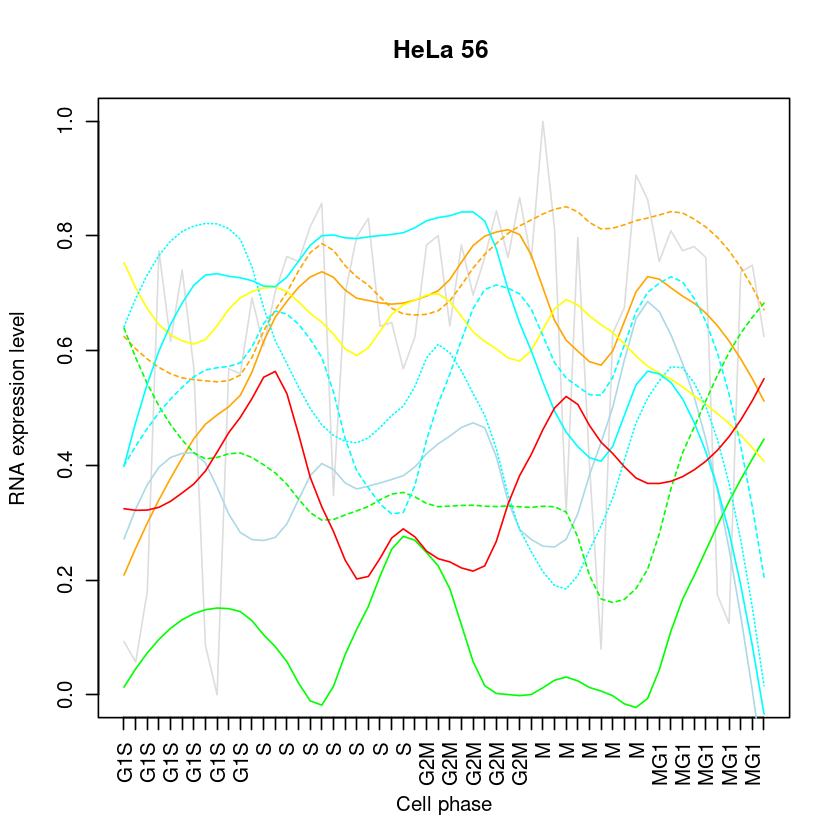

In [1205]:
#
show_cc_RNA=function(cellOrder, keyword){
    cid.order=rownames(cellOrder)
    cycleNames=as.character(cellOrder$assignedPhase)
    pl(cid.order)
    #
    dt0=rnaM.log2cpm[, cid.order];
    dt0.1=as.data.frame(t( apply(dt0,1,function(x){ (x-min(x)) / (max(x)-min(x)) }) ) )
    #
    getRNA=function(gene, to1=T){
        dt2=dt0;
        if(to1){ dt2=dt0.1;}
        #
        as.numeric(dt2[gene, ])
    }
    #
    dt=getRNA('CCNB1')
    title=""
    #title="(normalization each gene to [0,1])"
    plot( dt, type="l", xaxt="n", col='#dddddd', ylim=c(0,1),
         xlab='Cell phase', ylab="RNA expression level", main=paste(keyword, nrow(cellOrder), title) )
    axis(1,at=(1:length(cycleNames)),labels=cycleNames,col.axis="black",las=2)
    
    #
    addLines=function(y, color,...){
        model2=loess(y ~ seq(1, length(y)), span=0.4)
        y2=predict( model2 )
        lines(y2, type="l", col=color,...)
    }
    addLines(getRNA('CCNB1'), 'orange') #B in M
    addLines(getRNA('CCNB2'), 'orange', lty=2) #B in M
    #
    addLines(getRNA('CCNA2'), 'lightblue') #A in G2
    #
    addLines(getRNA('CCNE1'), 'green')
    addLines(getRNA('CCNE2'), 'green', lty=2)
    #
    addLines(getRNA('CCND3'), 'yellow')
    
    ############
    addLines(getRNA('CDK1'), 'cyan')
    addLines(getRNA('CDC20'), 'cyan', lty=2)
    addLines(getRNA('CDC6'), 'cyan', lty=3) #G1S to S
    
    addLines(getRNA('EIF2A'), 'red')
    #,cyan
    
}
show_cc_RNA(cellOrder.HeLa, 'HeLa')

[1] 169


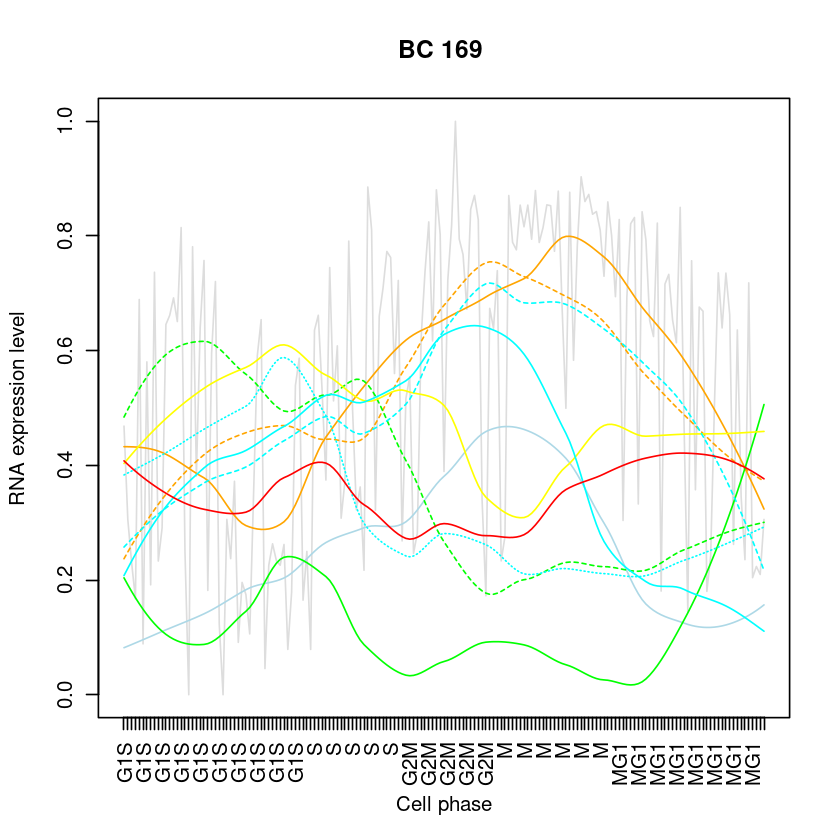

In [1206]:
show_cc_RNA(cellOrder.BC, 'BC')

## RNA by phase, BC

[1] 169
[1] 0


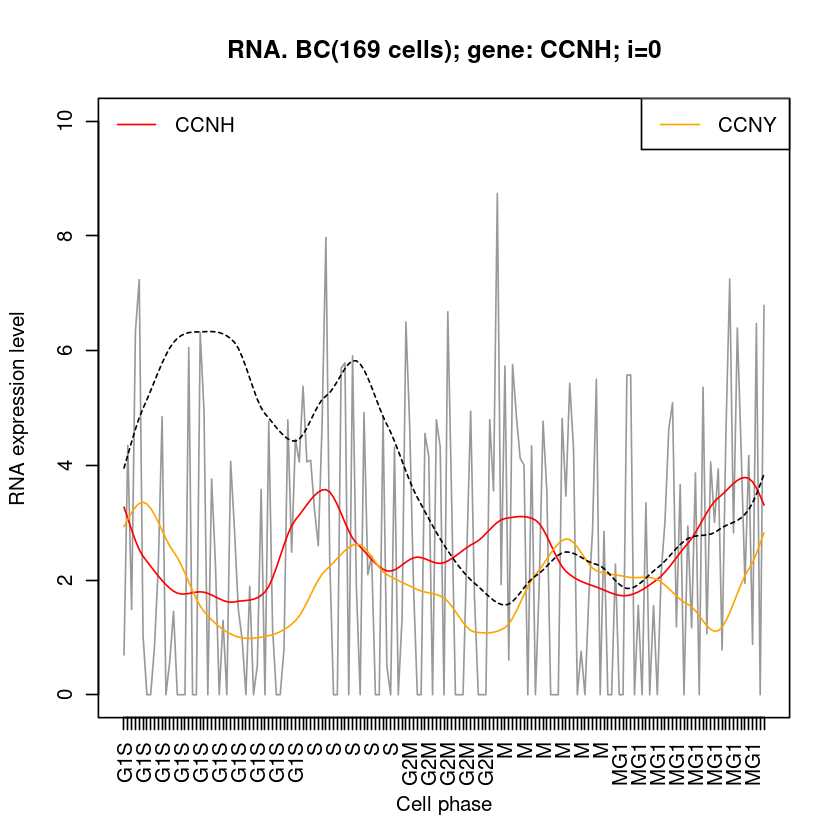

In [1579]:
show_cc_RNA2=function(cellOrder, keyword, gene, color1='red', index=0, to1=F, ylim=c(-2,-1),...){
    cid.order=rownames(cellOrder)
    cycleNames=as.character(cellOrder$assignedPhase)
    pl(cid.order)
    #
    dt0=rnaM.log2cpm[, cid.order];
    dt0.1=as.data.frame(t( apply(dt0,1,function(x){ (x-min(x)) / (max(x)-min(x)) }) ) )
    #
    getRNA=function(gene){
        dt2=dt0;
        if(to1){ dt2=dt0.1;}
        #
        as.numeric(dt2[gene, ])
    }
    #
    dt=getRNA(gene)
    #title="(normalization each gene to [0,1])"
    minY=min(dt)
    print(minY)
    maxY=max(dt)
    #
    if(ylim[1]>=0) minY=ylim[1];
    if(ylim[2]>0) maxY=ylim[2];
    if( is.na(ylim[3]) ){
        if(maxY<10)maxY=10;
    }
    plot( dt, type="l", xaxt="n", col='#999999', ylim=c(minY,maxY),
         xlab='Cell phase', ylab="RNA expression level", 
         main=paste0('RNA. ',keyword,'(', nrow(cellOrder),' cells); gene: ', gene,"; i=",index),... )
    axis(1,at=(1:length(cycleNames)),labels=cycleNames,col.axis="black",las=2)
    legend('topleft', lty=1, col='red', legend=gene, bty='n')
    
    # 
    addLines=function(y0, color,...){
        n=length(y0);
        #y=y0;
        y=c(y0,y0,y0)
        model2=loess(y ~ seq(1, 3*n), span=0.1) ########## critical parameter!!! as the array lenthenes, the span decreases.
        y2=predict( model2 )
        lines(y2[(n+1): (2*n)], type="l", col=color,...)
        #lines(y2, type="l", col=color,...)
    }
    addLines(dt, color1) #B in M
    return(function(geneName, color,...){
        addLines(getRNA(geneName), color,...)
    })
}
### test: to determin the optimal span
fn8.addLines=show_cc_RNA2(cellOrder.BC, "BC", gene='CCNH', 'red', to1=F, ylim=c(0,5)) #constant in cell cycle??!!
fn8.addLines('CCNY', 'orange')
legend('topright', lty=1, col='orange', legend="CCNY")

fn8.addLines('CCNE2', 'black', lty=2)

[1] 169
[1] 9.687824


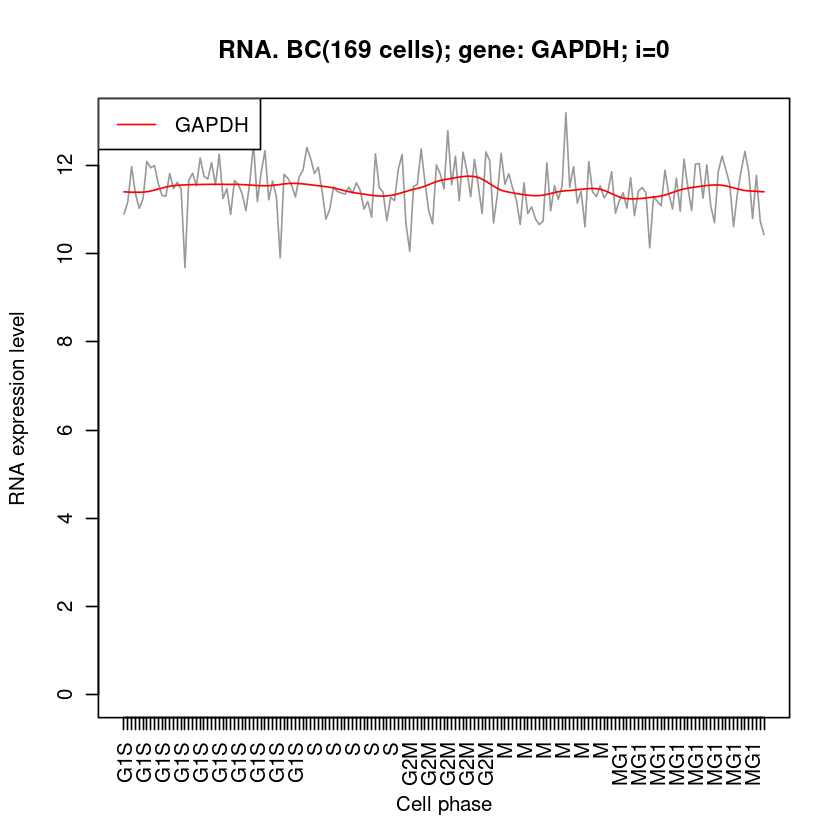

In [1216]:
fn8.addLines=show_cc_RNA2(cellOrder.BC, 'BC', gene='GAPDH', ylim=c(0,13, 1)) 

[1] 169
[1] 0


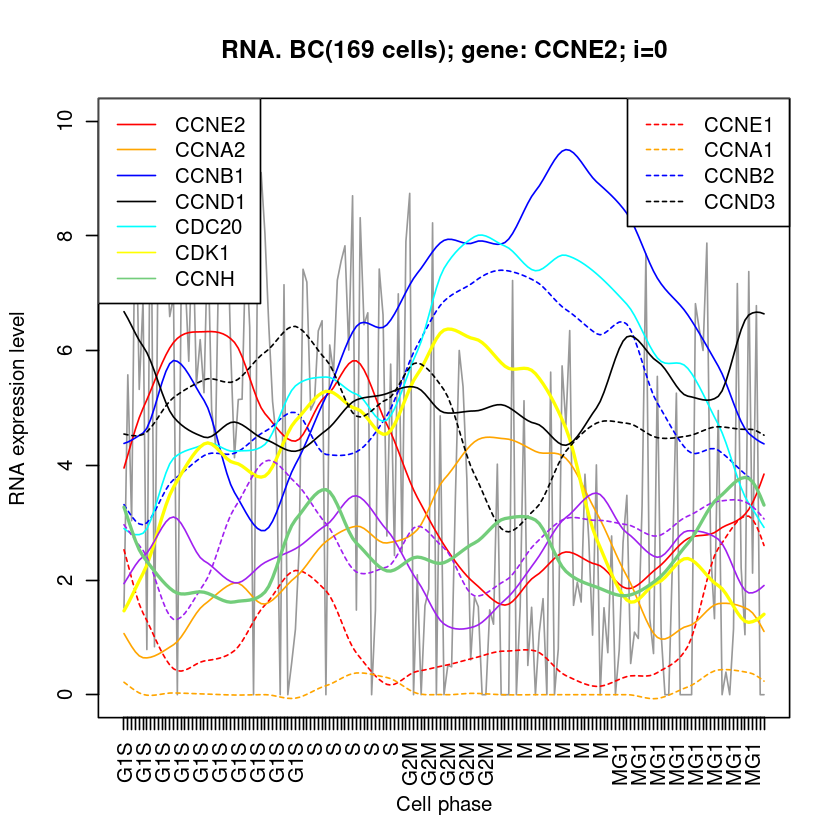

In [1217]:
drawCyclin=function(cellOrder,keyword){
    fn8.addLines=show_cc_RNA2(cellOrder, keyword, gene='CCNE2', 'red', to1=F)
    fn8.addLines('CCNE1','red', lty=2)
    #
    fn8.addLines('CCNA2','orange')
    fn8.addLines('CCNA1','orange',lty=2)
    #
    fn8.addLines('CCNB1','blue')
    fn8.addLines('CCNB2','blue', lty=2)

    # 
    fn8.addLines('CDC20','cyan') # before chr separation
    fn8.addLines('CDK1','yellow', lwd=2) # M phase
    #
    fn8.addLines('CCND1','black')
    fn8.addLines('CCND3','black', lty=2)
    #
    fn8.addLines('CSTF2','purple', lwd=1) #CSTF-64
    fn8.addLines('SRSF1','purple', lwd=1,lty=2) #late G1, splicing factor
    fn8.addLines('CCNH','#73CD7B', lwd=2,) # 
    
    legend('topleft', lty=1, 
           col=c('red','orange','blue', 'black', 'cyan', 'yellow', '#73CD7B'), 
           legend=c('CCNE2','CCNA2', 'CCNB1', 'CCND1', 'CDC20', 'CDK1', 'CCNH' ) )
    legend('topright', lty=2, col=c('red','orange','blue', 'black'), legend=c('CCNE1','CCNA1', 'CCNB2', 'CCND3' ) )
}
drawCyclin(cellOrder.BC,'BC')

[1] 169
[1] 0


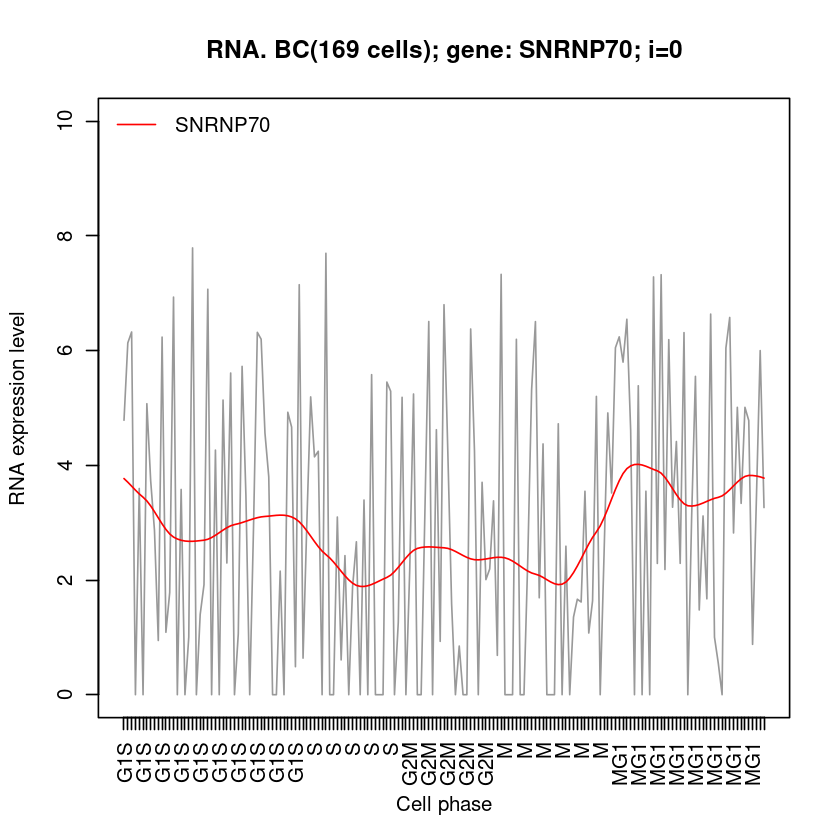

In [2022]:
fn8.addLines=show_cc_RNA2(cellOrder.BC, 'BC', gene='SNRNP70', 'red') #SRSF11 

In [2019]:
rownames(rnaM)[ grep('NOVA', rownames(rnaM)) ]

[1] "NOVA1"

[1] 56
[1] 0


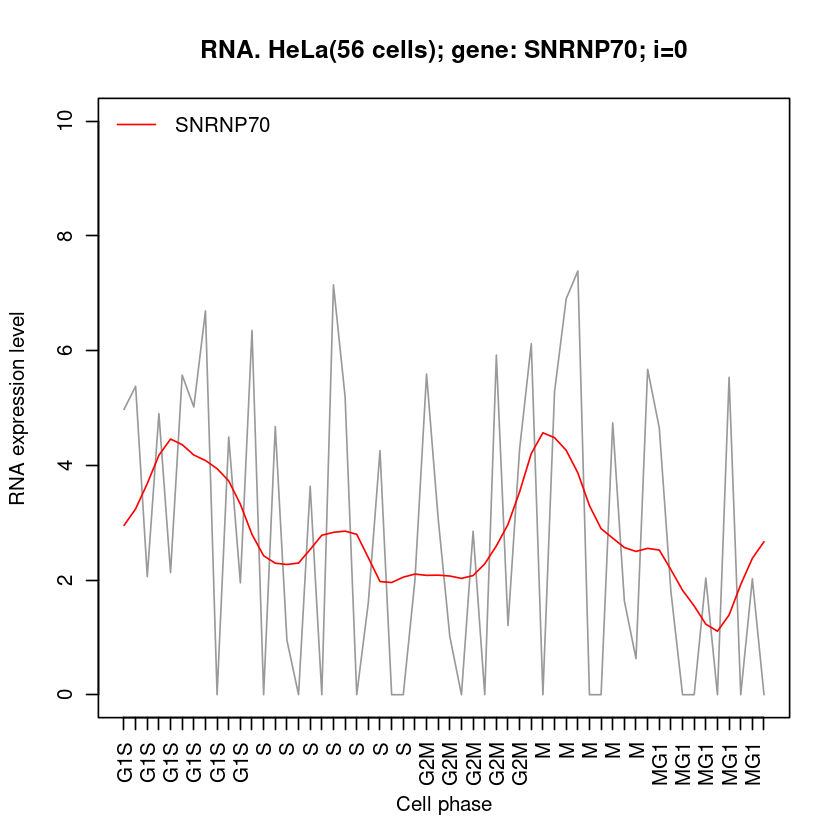

In [2023]:
fn8.addLines=show_cc_RNA2(cellOrder.HeLa, 'HeLa', gene='SNRNP70', 'red')

[1] 225  18


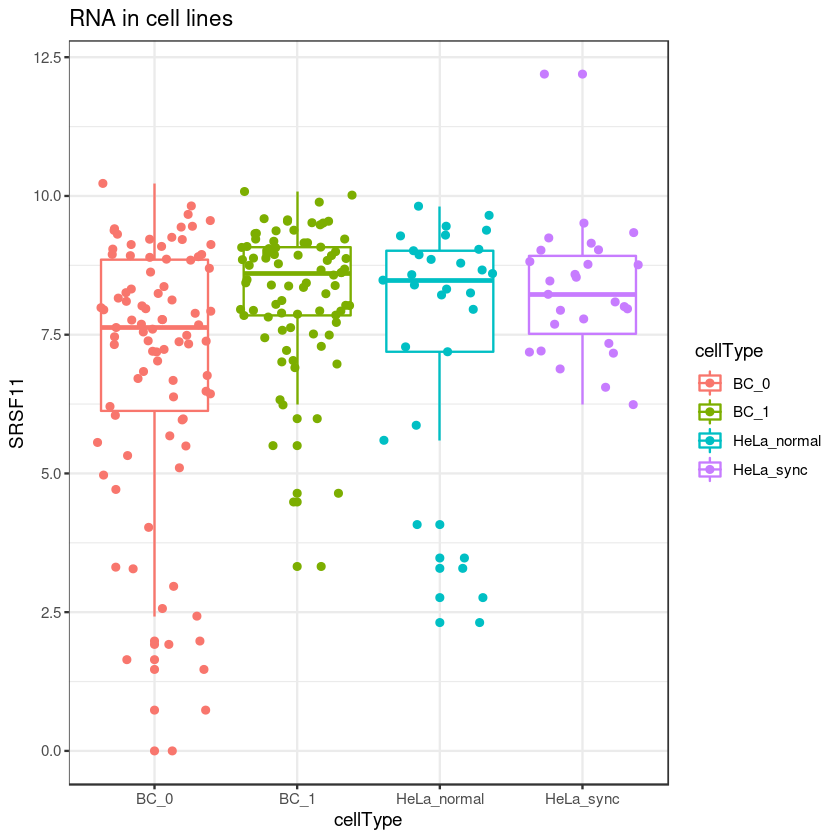

In [2006]:
## RBP
(function(){
    df=as.data.frame( t(rnaM.log2cpm[c('CCND1', 'GAPDH', 'CCND2','CCNE1', 'CCNE2','CCNB1', 'CCNB2','CDC6', 
                                       'NUDT21','EGFR','HNRNPH1','HNRNPH2', 'CPEB2','MBNL1', 'FUS', 'PTGS2',
                                      'SRSF11', ''),] ) )
    df2=cellInfo[rownames(df), ]
    #
    df$cellType=df2$cellType
    pd(df) #2 56
    #ph(df)
    ggplot(df, aes(cellType, SRSF11, color=cellType))+
        geom_boxplot()+
        geom_jitter(height =0)+theme_bw()+labs(title='RNA in cell lines')
})()

## RNA by phase, HeLa, (determine the reasonable HeLa phase)

### 2-step method

[1] 56
[1] 0


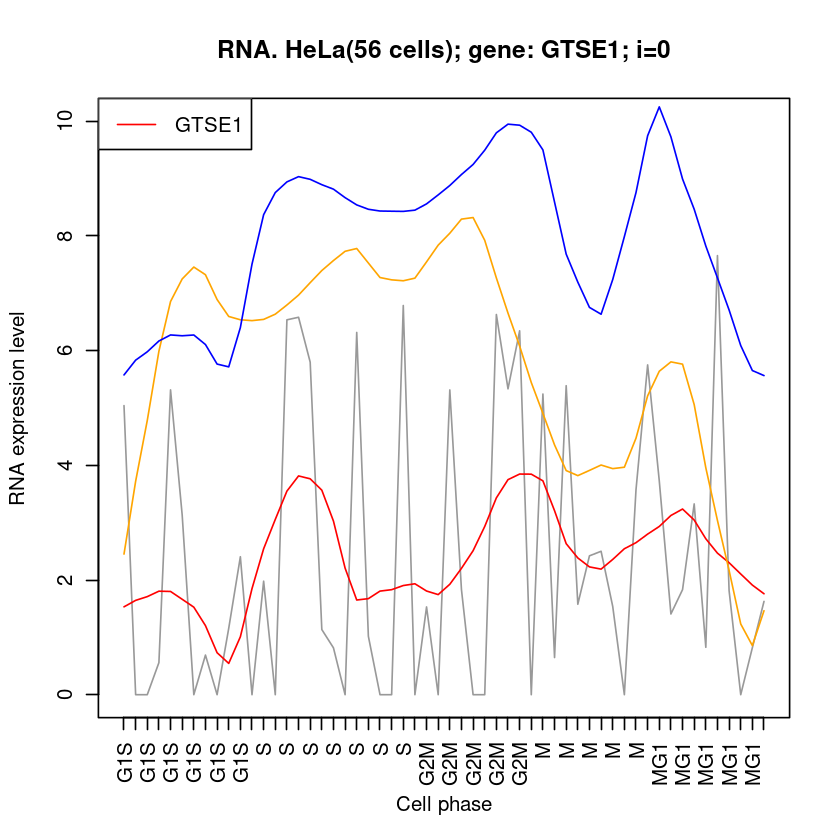

In [1218]:
#GTSE1
fn8.addLines=show_cc_RNA2(cellOrder.HeLa, "HeLa", gene='GTSE1', 'red', to1=F)
fn8.addLines('CDK1','orange')
fn8.addLines('CCNB1','blue')

[1] 56
[1] 0


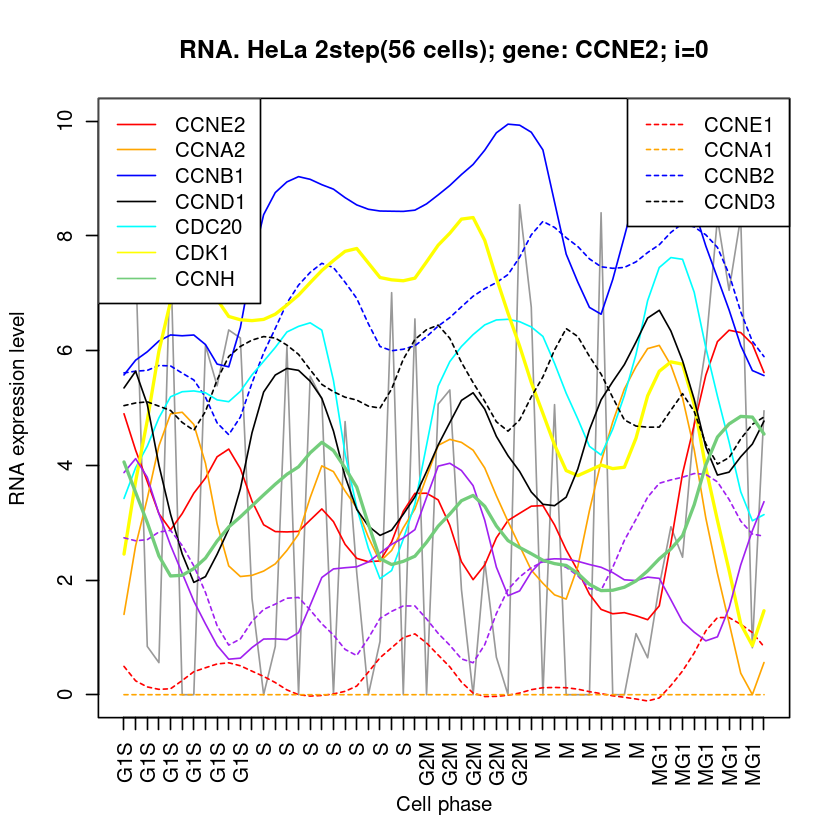

In [1219]:
## two-step method:
drawCyclin(cellOrder.HeLa,'HeLa 2step')

###  1-step method

[1] 56
[1] 0


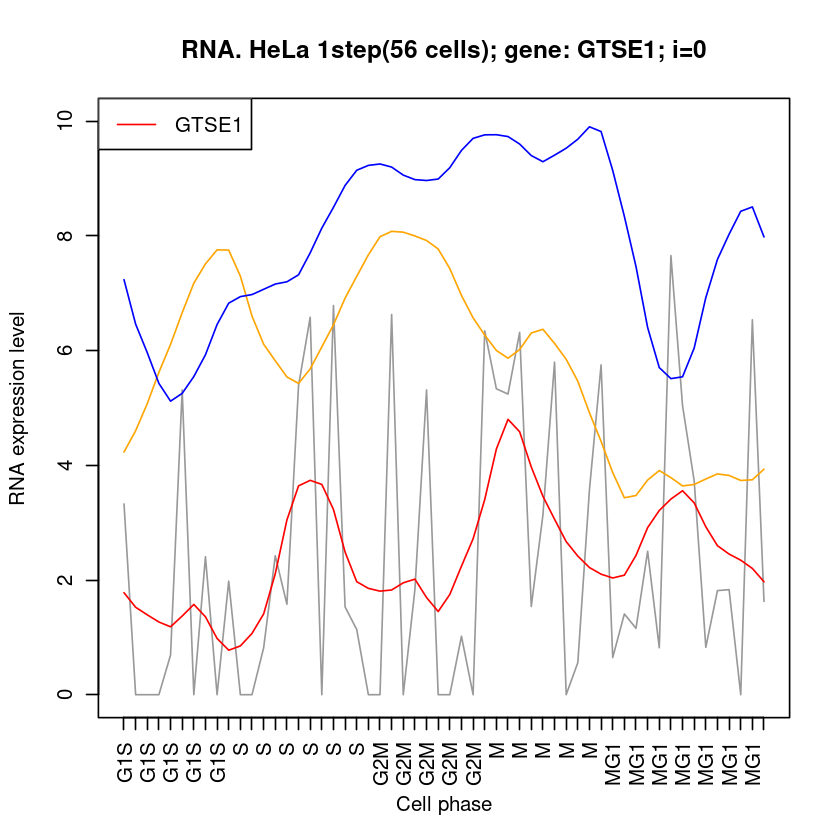

In [1220]:
#GTSE1
fn8.addLines=show_cc_RNA2(cellOrder.HeLa.Uni, "HeLa 1step", gene='GTSE1', 'red', to1=F)
fn8.addLines('CDK1','orange')
fn8.addLines('CCNB1','blue')

[1] 56
[1] 0


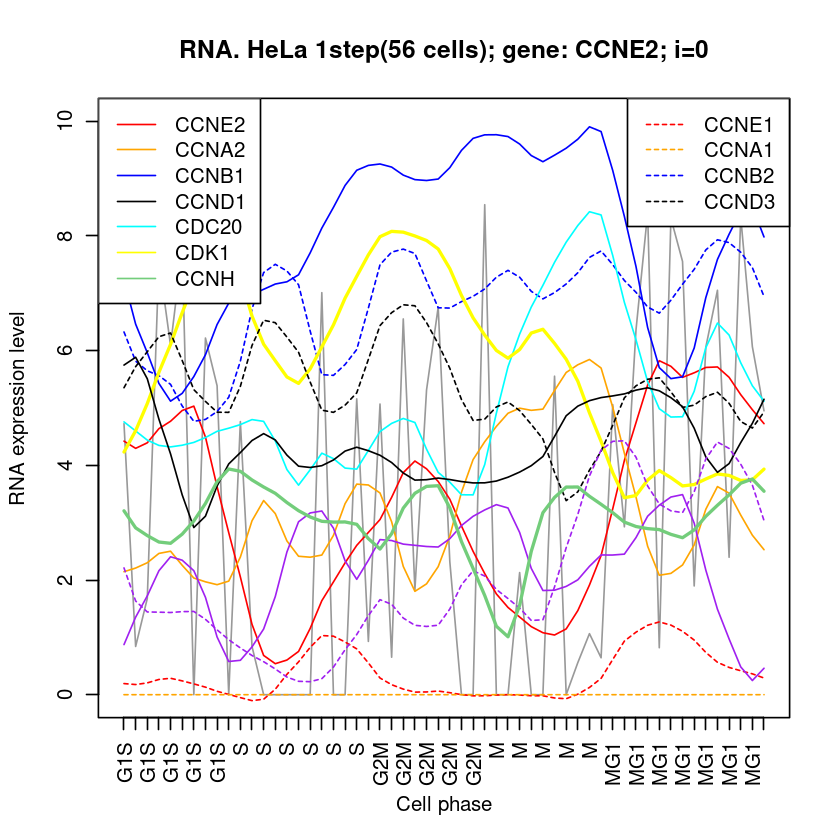

In [1221]:
# one-step method:
drawCyclin(cellOrder.HeLa.Uni,'HeLa 1step')


       BC_0        BC_1 HeLa_normal   HeLa_sync 
         87          82          29          27 

[1] 29
[1] 29
[1] 0


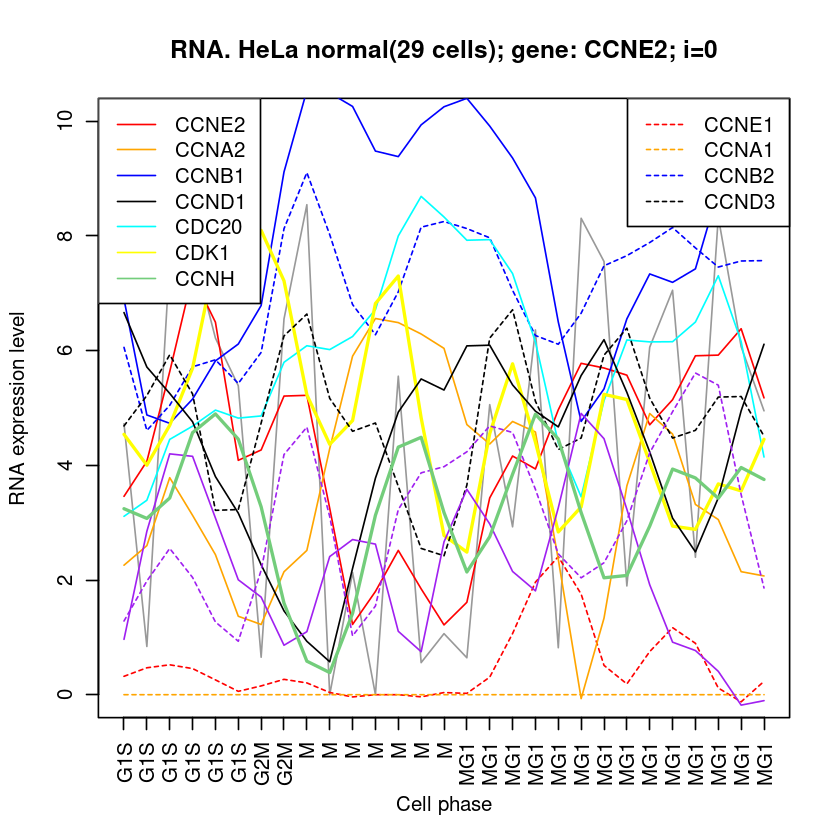

In [1222]:
## for normal HeLa
table(cellInfo$cellType)
#BC_0        BC_1 HeLa_normal   HeLa_sync 
# 87          82          29          27
(function(){
    cellOrder=cellOrder.HeLa.Uni
    #
    cid0=rownames(cellInfo[which(cellInfo$cellType=="HeLa_normal"),]) #29
    #ph(cid)
    cid2=rownames(cellOrder) #56
    #ph(cid2)
    cid3=intersect(cid2, cid0)
    pl(cid3)
    
    #fn8.addLines=show_cc_RNA2(cellOrder.HeLa[cid3,], 'HeLa', gene='CCNE2', 'red', to1=F)
    drawCyclin(cellOrder[cid3,],'HeLa normal')
})()


       BC_0        BC_1 HeLa_normal   HeLa_sync 
         87          82          29          27 

[1] 27
[1] 27
[1] 0


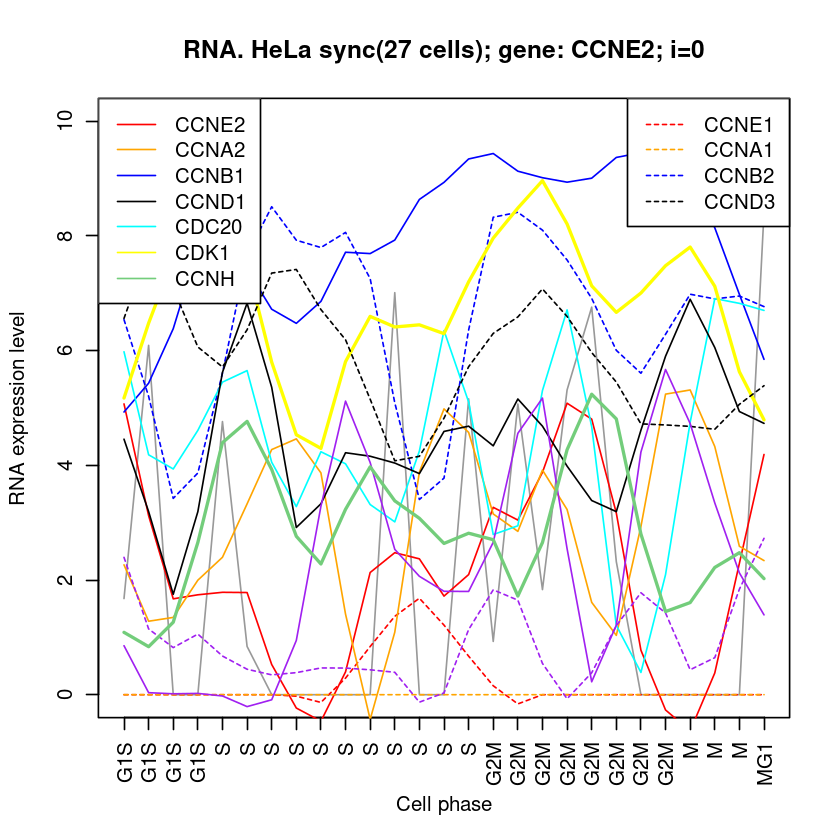

In [1223]:
## for sync HeLa
table(cellInfo$cellType)
#BC_0        BC_1 HeLa_normal   HeLa_sync 
# 87          82          29          27
(function(){
    cellOrder=cellOrder.HeLa.Uni
    #
    cid0=rownames(cellInfo[which(cellInfo$cellType=="HeLa_sync"),]) #29
    #ph(cid)
    cid2=rownames(cellOrder) #56
    #ph(cid2)
    cid3=intersect(cid2, cid0)
    pl(cid3)
    
    #cellOrder.HeLa.normal=cellOrder.HeLa[,]
    #dim(cellOrder.HeLa.normal)
    
    #fn8.addLines=show_cc_RNA2(cellOrder.HeLa[cid3,], 'HeLa', gene='CCNE2', 'red', to1=F)
    drawCyclin(cellOrder[cid3,],'HeLa sync')
})()

###  3-step method


       BC_0        BC_1 HeLa_normal   HeLa_sync 
         87          82          29          27 

[1] 29
[1] 29
[1] 0


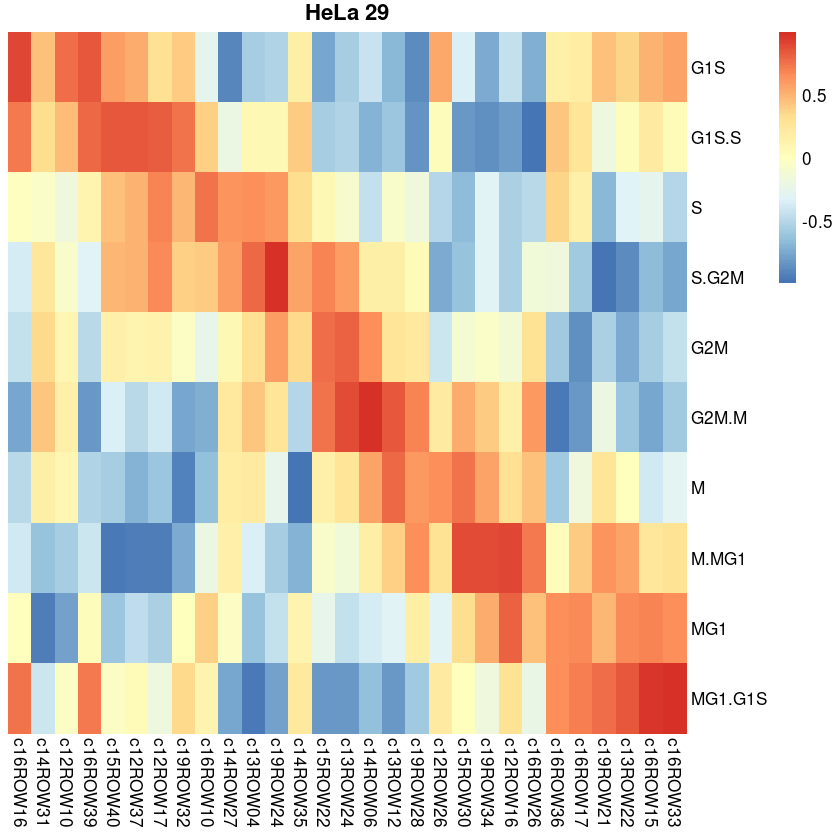

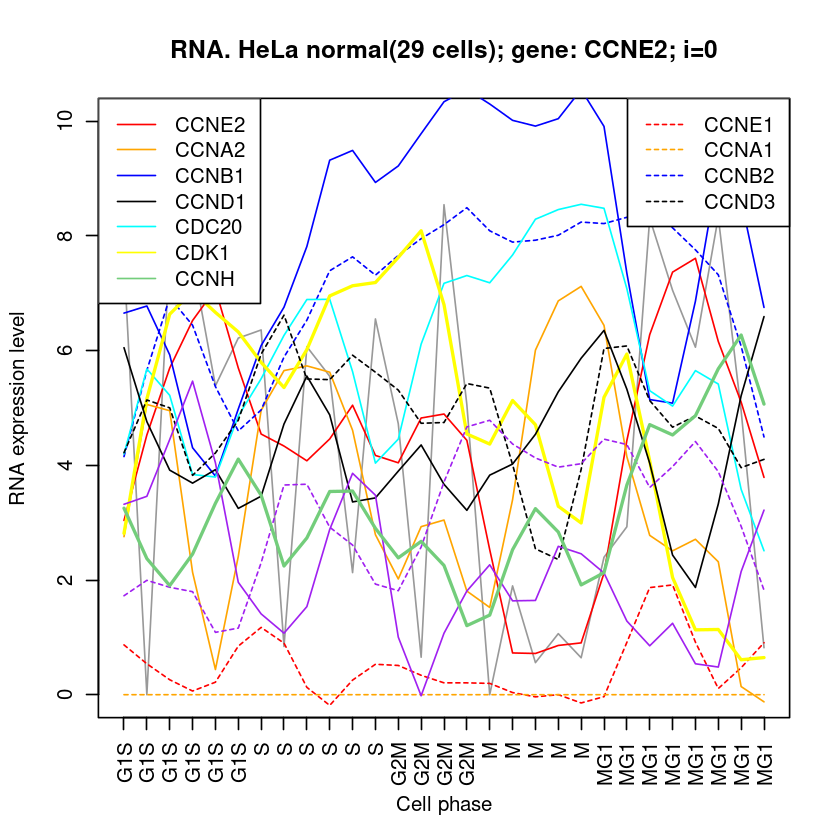

In [1224]:
## for normal HeLa
table(cellInfo$cellType)
#BC_0        BC_1 HeLa_normal   HeLa_sync 
# 87          82          29          27
(function(){
    cellOrder= cellOrder.HeLa=getCellOrder('HeLa','HeLaNormal') #HeLaNormal
    #cellOrder.HeLa.Uni
    #
    cid0=rownames(cellInfo[which(cellInfo$cellType=="HeLa_normal"),]) #29
    #ph(cid)
    cid2=rownames(cellOrder) #56
    #ph(cid2)
    cid3=intersect(cid2, cid0)
    pl(cid3)
    
    #cellOrder.HeLa.normal=cellOrder.HeLa[,]
    #dim(cellOrder.HeLa.normal)
    
    #fn8.addLines=show_cc_RNA2(cellOrder.HeLa[cid3,], 'HeLa', gene='CCNE2', 'red', to1=F)
    drawCyclin(cellOrder[cid3,],'HeLa normal')
})()

## RNA in each phase, BC

In [712]:
rownames(rnaM)[grep('CDC14', rownames(rnaM))]

[1] "CCDC14"        "CCDC142"       "CCDC144A"      "CCDC144B"     
 [5] "CCDC144CP"     "CCDC144NL"     "CCDC144NL-AS1" "CCDC146"      
 [9] "CCDC148"       "CCDC149"       "CDC14A"        "CDC14B"       
[13] "CDC14C"

[1] 169
[1] 9.687824


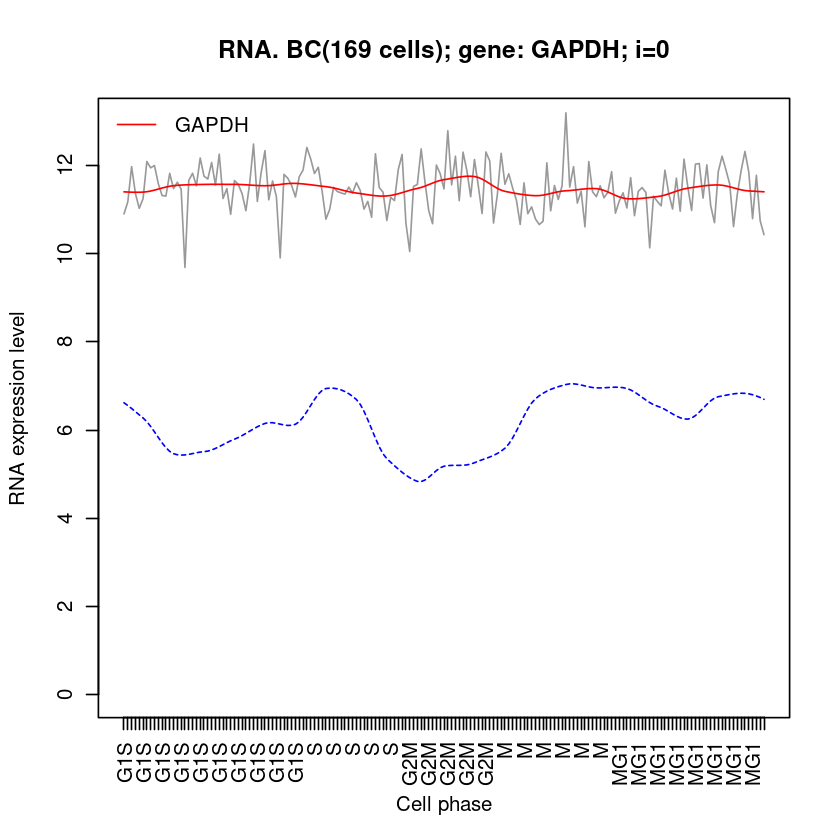

In [1984]:
fn8.addLines=show_cc_RNA2(cellOrder.BC, 'BC', gene='GAPDH', ylim=c(0,13, 1)) 
#fn8.addLines("HNRNPH1", 'blue', lty=2)

In [1584]:
#similar to GAPDH
getCoTranscriptedGenes=function(targetGene, dt,method='spearman'){
    #targetGene="GAPDH"
    #dt=rnaM.log2cpm[, cid.BC]
    #
    # remove all 0 rows
    keep=apply(dt, 1, sum)>0
    dt=dt[keep,]
    
    # order by RNA expression
    targetGene.exp=dt[targetGene,]
    dt.cor=as.data.frame( apply(dt, 1, function(x){
        cor(x, targetGene.exp, method=method)
    }) )
    colnames(dt.cor)='cor'
    dt.cor$gene=rownames(dt.cor)
    #order by cor
    dt.cor=dt.cor[order(-abs(dt.cor$cor)),]
    #
    dt.cor
}
###
head(getCoTranscriptedGenes('GAPDH', rnaM.cpm[, cid.BC]))

,cor,gene
,<dbl>,<chr>
GAPDH,1.0000000,GAPDH
RPS2,0.4172816,RPS2
MALAT1,-0.3962931,MALAT1
RPS14,0.3924320,RPS14
RPS12,0.3884317,RPS12
RPL18AP3,0.3833176,RPL18AP3


                cor     gene
GAPDH     1.0000000    GAPDH
RPS2      0.4172816     RPS2
MALAT1   -0.3962931   MALAT1
RPS14     0.3924320    RPS14
RPS12     0.3884317    RPS12
RPL18AP3  0.3833176 RPL18AP3
RPLP0P2   0.3798692  RPLP0P2
RPL13     0.3782979    RPL13
RPLP0P6   0.3704714  RPLP0P6
RPSA      0.3667495     RPSA
[1] 169
[1] 9.687824


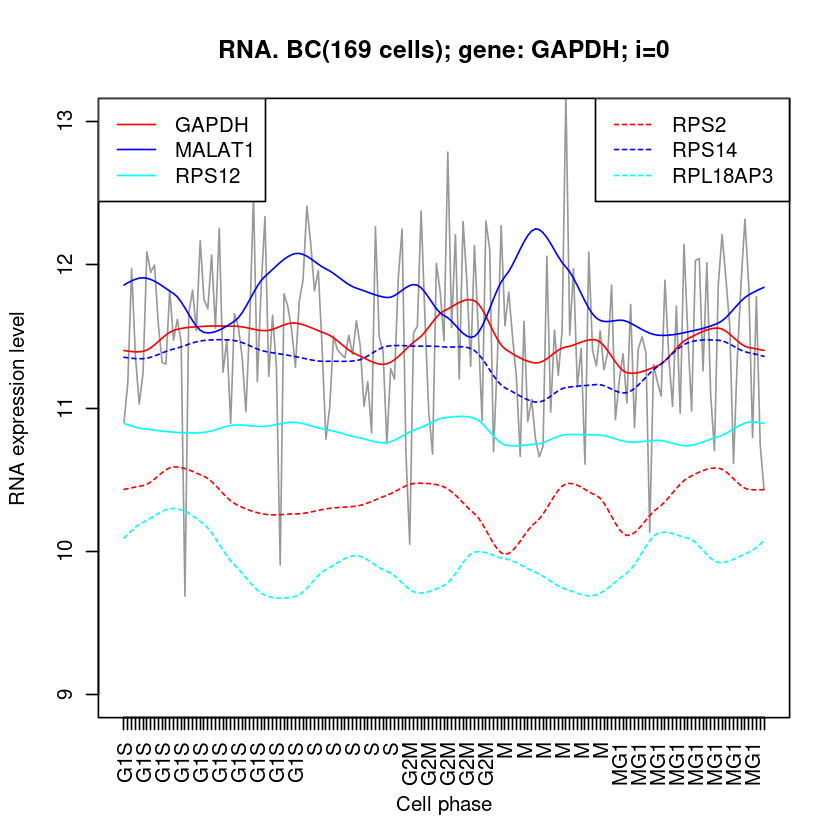

In [1724]:
showCoTranscriptedGenes=function(gene, dt, ylim=c(0,13,1), method="spearman",cellOrder=cellOrder.BC, keyword="BC"){
    dat=getCoTranscriptedGenes(gene, dt,method)
    ph(dat,n=10)
    gene.list=rownames(dat)
    #
    fn8.addLines=show_cc_RNA2(cellOrder, keyword, gene=gene.list[1], ylim=ylim)
    fn8.addLines(gene.list[2], 'red', lty=2)
    #
    fn8.addLines(gene.list[3], 'blue')
    fn8.addLines(gene.list[4], 'blue', lty=2)
    #
    fn8.addLines(gene.list[5], 'cyan')
    fn8.addLines(gene.list[6], 'cyan', lty=2)
    
    legend('topleft',lty=1,col=c('red',"blue",'cyan'),legend=gene.list[c(1,3,5)])
    legend('topright',lty=2,col=c('red',"blue",'cyan'),legend=gene.list[c(2,4,6)])
    return(dat)
}
x=showCoTranscriptedGenes('GAPDH', rnaM.cpm[, cid.BC], ylim=c(9,13,1))

In [1612]:
(function(){
    gene='CCNE2'  #'CCNB1'
    #method="pearson"
    method="spearman"
    cor.t=0.25 #0.4
    #
    CairoPDF( paste0('gene_cor/83_',gene,'_',method,'_show_RNA_alongCycle',cor.t ,'.pdf'), width=5,height=5)
    x=showCoTranscriptedGenes(gene, rnaM.cpm[, cid.BC], ylim=c(0,13,1), method=method)
    dev.off()
    #
    df=x
    df=df[abs(df$cor)> cor.t,]
    df=df[order( -abs(df$cor) ),]
    debug(df)
    writeLines(rownames(df), paste0('gene_cor/83_',gene, '_',method,'_cor_gt',cor.t,'.gene.txt') )
})()
getwd()

              cor   gene
CCNE2   1.0000000  CCNE2
TENT2   0.3670242  TENT2
MCM6    0.3623188   MCM6
TMEM97  0.3294146 TMEM97
MANEAL  0.3152780 MANEAL
PTTG1  -0.3149648  PTTG1
DTL     0.3019726    DTL
E2F1    0.3016619   E2F1
WDR76   0.2947578  WDR76
GCNA    0.2866766   GCNA
[1] 169
[1] 0
[1] 30  2
              cor   gene
CCNE2   1.0000000  CCNE2
TENT2   0.3670242  TENT2
MCM6    0.3623188   MCM6
TMEM97  0.3294146 TMEM97
MANEAL  0.3152780 MANEAL
PTTG1  -0.3149648  PTTG1


[1] "/data/jinwf/wangjl/apa/191111Figure/f3/distalAPA_RNA_5"

              cor    gene
SRSF1   1.0000000   SRSF1
GTF3C1  0.4134656  GTF3C1
CAPRIN1 0.3530990 CAPRIN1
NUDT22  0.3433866  NUDT22
HPCAL1  0.3260857  HPCAL1
MPG     0.3225923     MPG
BUD31   0.3119877   BUD31
MEF2A   0.3099340   MEF2A
FTSJ3   0.3076614   FTSJ3
ABHD5   0.3067688   ABHD5
[1] 169
[1] 0


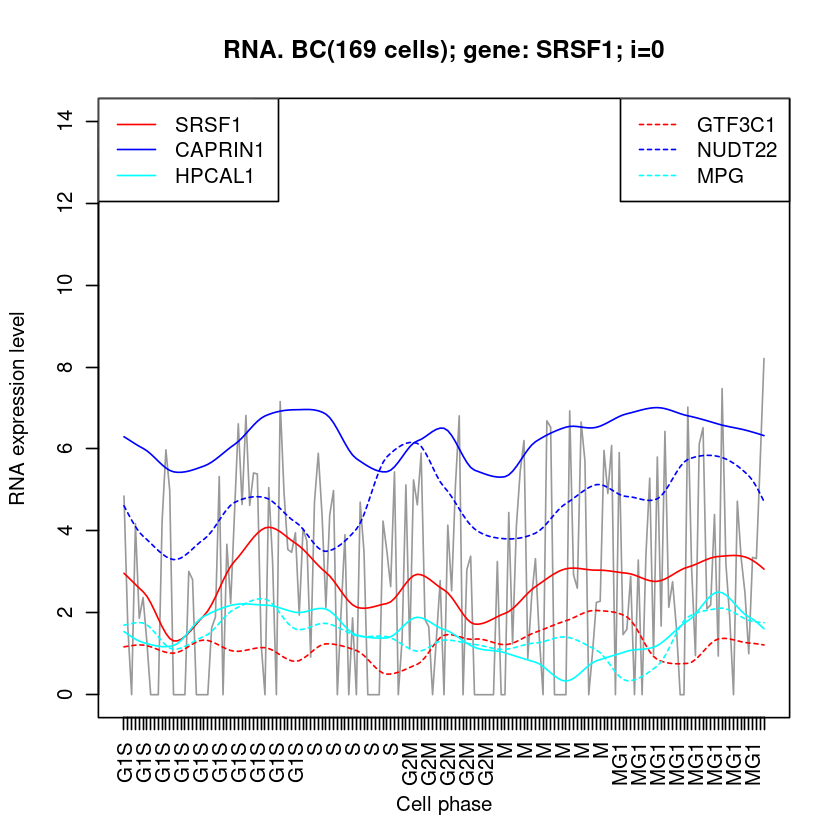

In [1267]:
# 类似表达
x=showCoTranscriptedGenes('SRSF1', rnaM.cpm[, cid.BC], ylim=c(0,14,1))

In [1564]:
getwd()

[1] "/data/jinwf/wangjl/apa/191111Figure/f3/distalAPA_RNA_5"

[1] 169
[1] 0


png 
  2

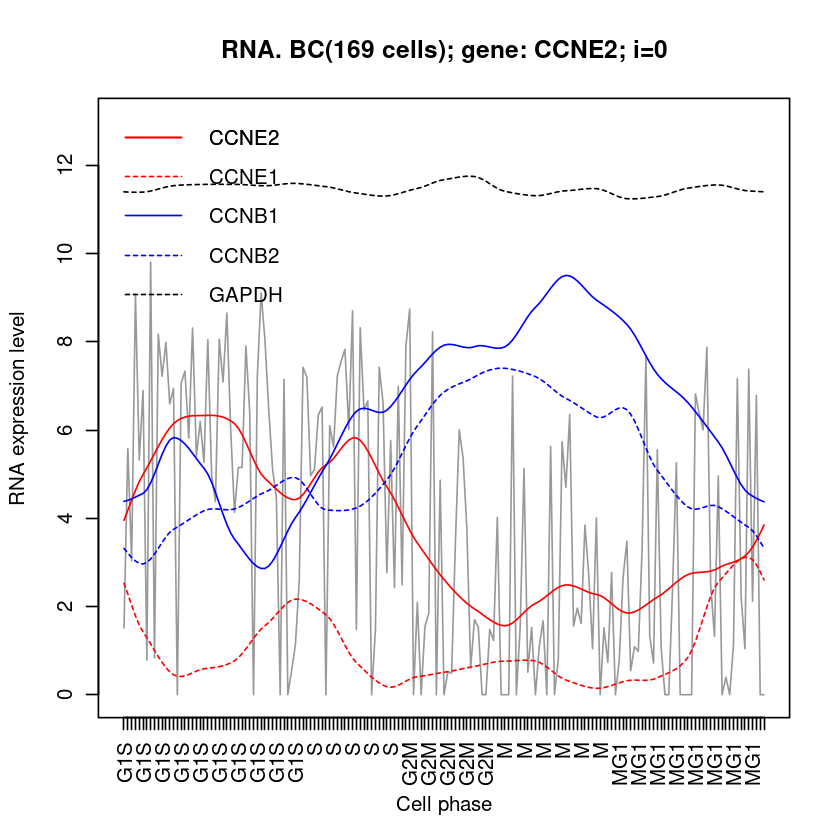

In [1578]:
CairoPDF('83_show_RNA_in_BC_alongCycle.pdf', width=5,height=5)
#G1S
fn8.addLines=show_cc_RNA2(cellOrder.BC, 'BC', gene='CCNE2', ylim=c(0,13)) #G1 S entry
fn8.addLines("CCNE1", 'red', lty=2)

fn8.addLines('CCNB1', 'blue')
fn8.addLines('CCNB2', 'blue', lty=2)
#
fn8.addLines('GAPDH', 'black', lty=2)

legend('topleft', lty=c(1,2,1,2,2),col=c('red','red','blue','blue','black'), bty='n',
      legend=c('CCNE2', 'CCNE1', 'CCNB1', 'CCNB2','GAPDH'))
dev.off()

### G1S

[1] 169
[1] 0


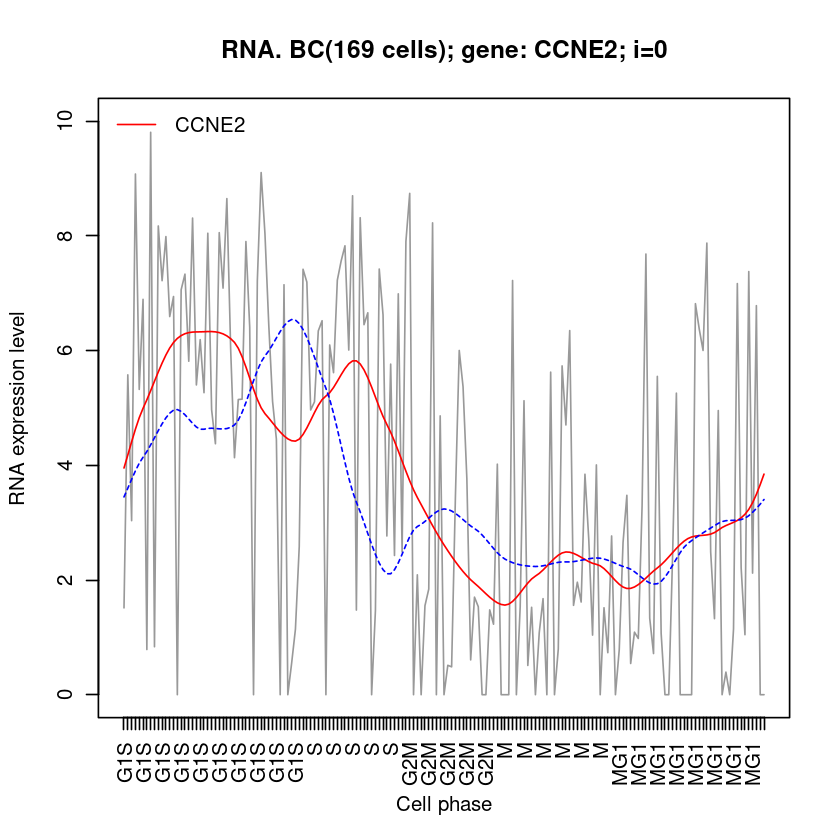

In [1965]:
fn8.addLines=show_cc_RNA2(cellOrder.BC, 'BC', gene='CCNE2')
fn8.addLines('CDC6', 'blue',lty=2)

[1] 169
[1] 0


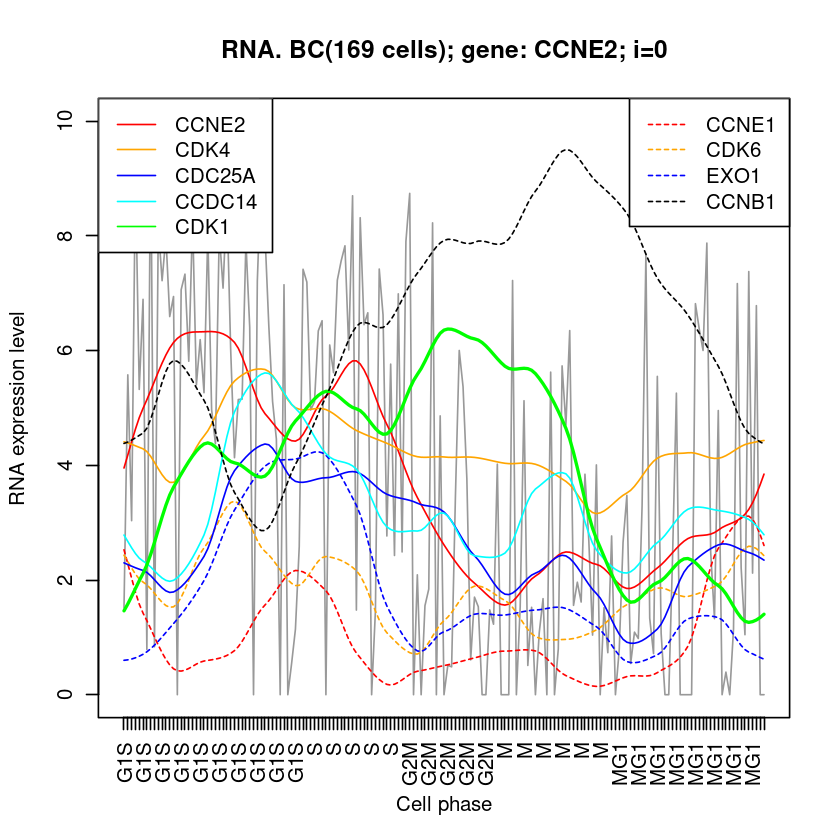

In [1074]:
#G1S
fn8.addLines=show_cc_RNA2(cellOrder.BC, 'BC', gene='CCNE2') #G1 S entry
fn8.addLines("CCNE1", 'red', lty=2)
#
fn8.addLines("CDK4", 'orange') #G1 S entry
fn8.addLines("CDK6", 'orange', lty=2) #G1 S entry
#
fn8.addLines('CDC25A','blue',lty=1) #G1 to S
fn8.addLines('EXO1','blue',lty=2) # 核酸外切酶，DNA复制
#
fn8.addLines('CCDC14','cyan') #中心体定位，G1S to S

fn8.addLines('CDK1','green', lwd=2)
## promotes G2-M transition, and regulates G1 progress and G1-S transition via association with multiple interphase cyclins.


#
fn8.addLines("CCNB1", 'black', lty=2)

legend('topleft',lty=1, 
       col=c('red','orange','blue','cyan', 'green'), 
       legend=c('CCNE2','CDK4','CDC25A','CCDC14', 'CDK1') )
#
legend('topright',lty=2, 
       col=c('red','orange','blue','black'), 
       legend=c('CCNE1','CDK6','EXO1','CCNB1') )

              cor   gene
CCNE2   1.0000000  CCNE2
TENT2   0.3670242  TENT2
MCM6    0.3623188   MCM6
TMEM97  0.3294146 TMEM97
MANEAL  0.3152780 MANEAL
PTTG1  -0.3149648  PTTG1
DTL     0.3019726    DTL
E2F1    0.3016619   E2F1
WDR76   0.2947578  WDR76
GCNA    0.2866766   GCNA
[1] 169
[1] 0


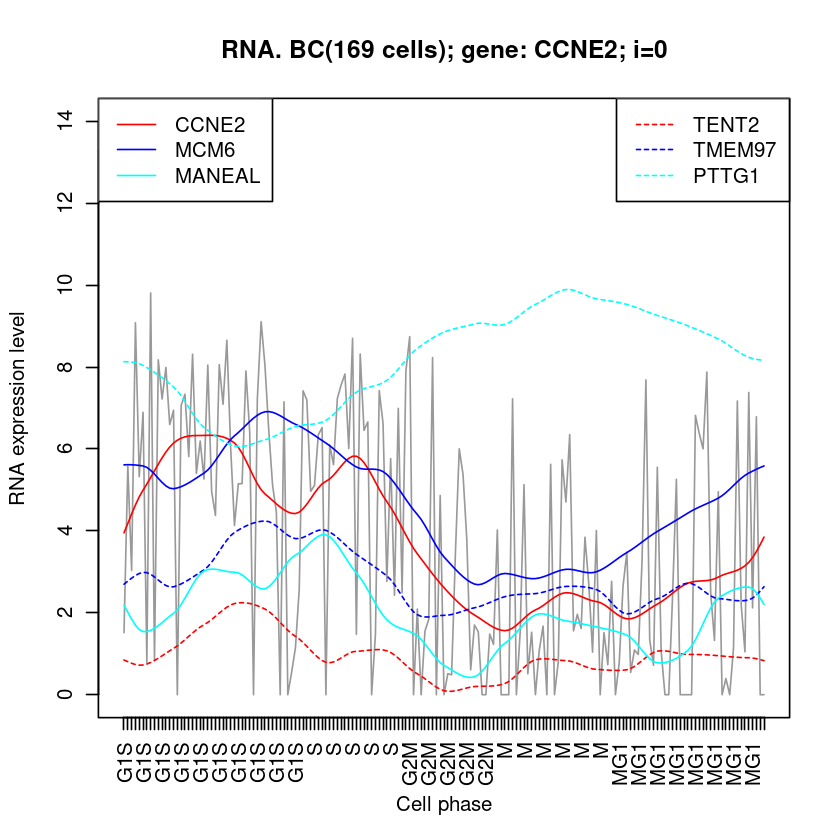

In [1270]:
# 类似表达
x=showCoTranscriptedGenes('CCNE2', rnaM.cpm[, cid.BC], ylim=c(0,14,1))

[1] 169
[1] 0


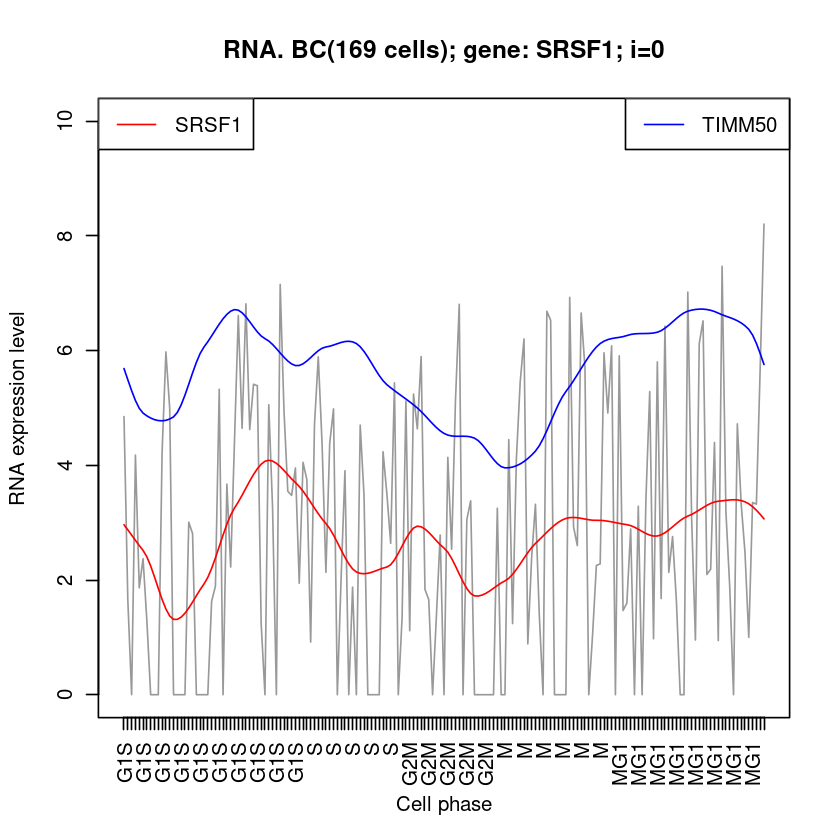

In [1075]:
# G1
fn8.addLines=show_cc_RNA2(cellOrder.BC, 'BC', gene='SRSF1') #late G1, slicing factor
fn8.addLines('TIMM50','blue') #mitochondrial inner membrane translocase
legend('topright', col='blue',lty=1, legend='TIMM50')

              cor    gene
SRSF1   1.0000000   SRSF1
GTF3C1  0.4134656  GTF3C1
CAPRIN1 0.3530990 CAPRIN1
NUDT22  0.3433866  NUDT22
HPCAL1  0.3260857  HPCAL1
MPG     0.3225923     MPG
BUD31   0.3119877   BUD31
MEF2A   0.3099340   MEF2A
FTSJ3   0.3076614   FTSJ3
ABHD5   0.3067688   ABHD5
[1] 169
[1] 0


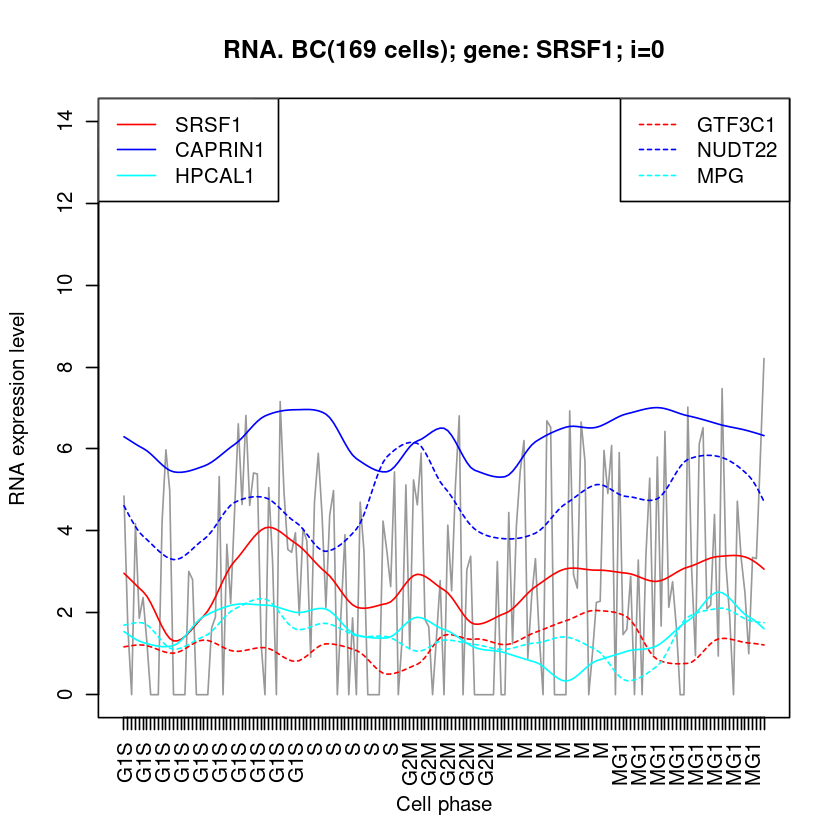

In [1271]:
# 类似表达
x=showCoTranscriptedGenes('SRSF1', rnaM.cpm[, cid.BC], ylim=c(0,14,1))

#### MCMx

[1] 169
[1] 0


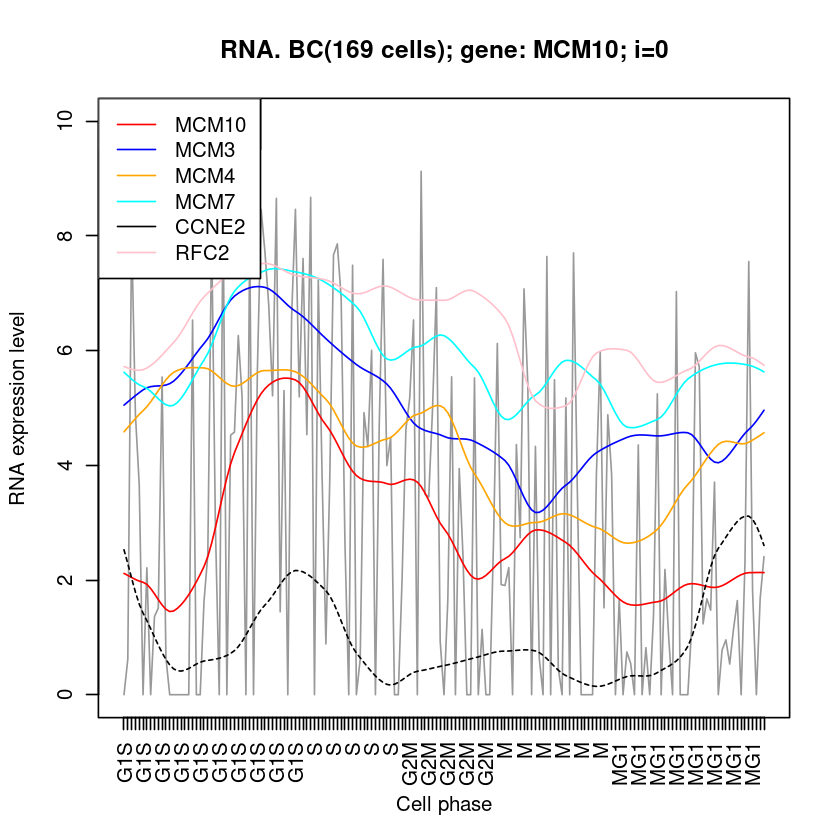

In [1296]:
## MCM3: Acts as component of the MCM2-7 complex (MCM complex) which is the putative replicative helicase 
#   essential for 'once per cell cycle' DNA replication initiation and elongation in eukaryotic cells. 

fn8.addLines=show_cc_RNA2(cellOrder.BC, 'BC', gene='MCM10')
#fn8.addLines('CDC20','blue')
fn8.addLines('MCM3','blue') #MCM3,6,7, 10,
fn8.addLines('MCM4','orange')
fn8.addLines('MCM7','cyan')

fn8.addLines('RFC2', 'pink')
fn8.addLines('CCNE1','black', lty=2)
# drawRNA_DPAU('')
legend('topleft', lty=1,
       col=c('red','blue','orange','cyan','black', 'pink'),
       legend=c('MCM10','MCM3',"MCM4",'MCM7','CCNE2', 'RFC2') )

               cor     gene
MCM10    1.0000000    MCM10
RRM2     0.4878465     RRM2
HIST1H4C 0.4592338 HIST1H4C
EXO1     0.4587418     EXO1
MAD2L1   0.4029892   MAD2L1
RFC3     0.3867730     RFC3
GINS2    0.3798118    GINS2
NUP210   0.3621551   NUP210
PCNA     0.3479805     PCNA
JUN      0.3448474      JUN
[1] 169
[1] 0


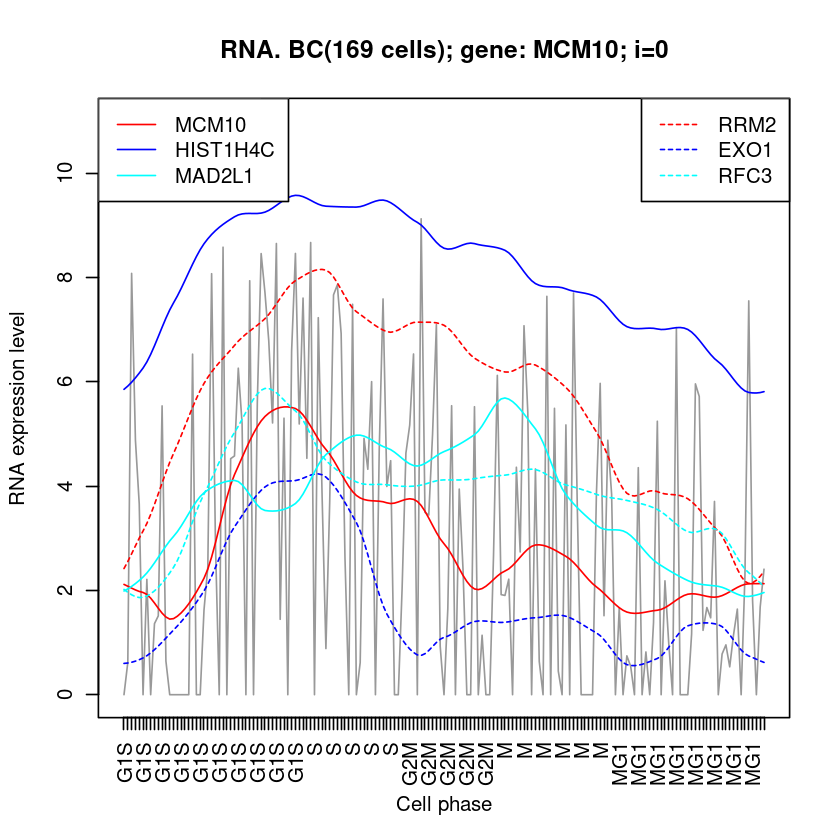

In [1275]:
# 类似表达
x=showCoTranscriptedGenes('MCM10', rnaM.cpm[, cid.BC], ylim=c(0,11,1))

[1] 169
[1] 5.7611


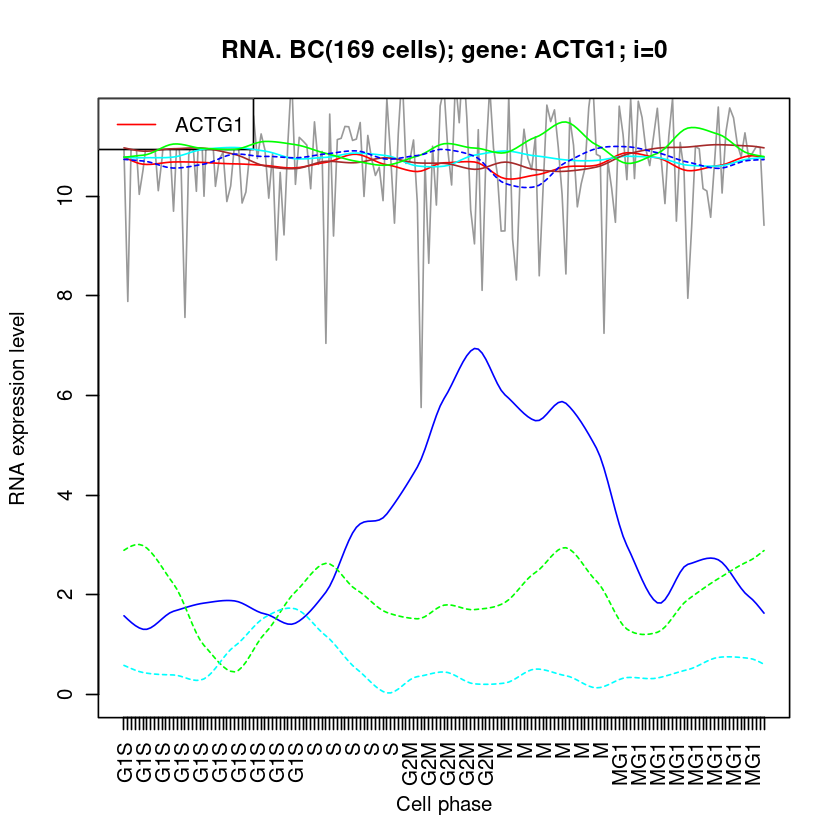

In [1359]:
# RNA high, genes
fn8.addLines=show_cc_RNA2(cellOrder.BC, 'BC', gene='ACTG1', ylim=c(0,11.5,1))
# #ACTG1 #UQCRH #LDHA #RPS4X

fn8.addLines('RPLP1','cyan')
fn8.addLines('RPS6', 'brown')
fn8.addLines('UBB', 'green')
#
fn8.addLines('PLK1', 'blue')
fn8.addLines('HSF1', 'green', lty=2)
fn8.addLines('BTRC', 'cyan', lty=2)
#
fn8.addLines('RPL8','blue', lty=2) #ok

[1] 169
[1] 0


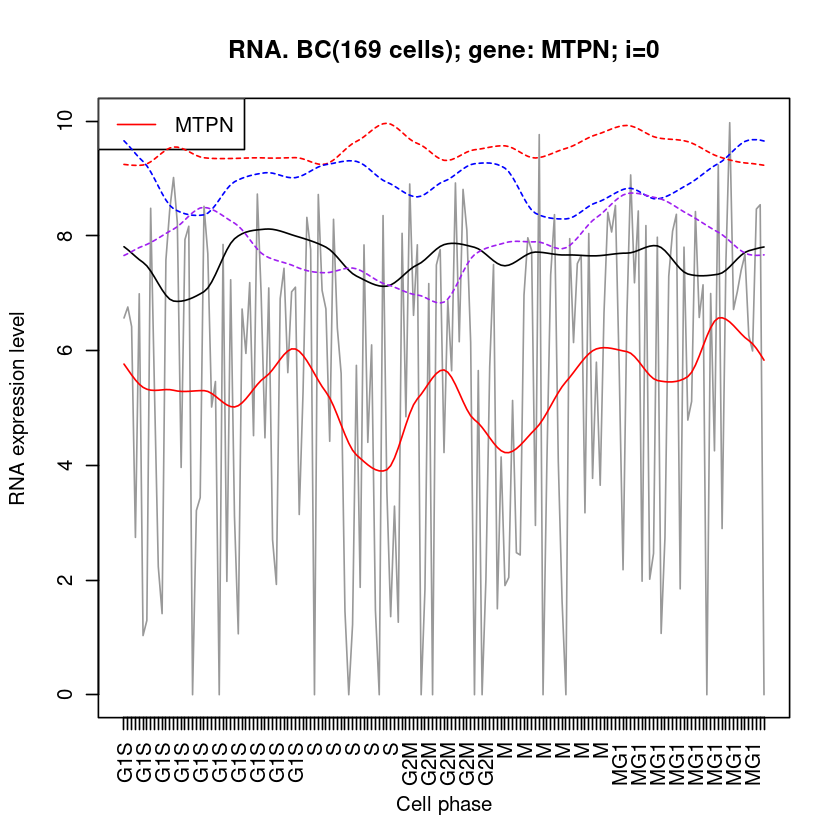

In [1077]:
fn8.addLines=show_cc_RNA2(cellOrder.BC, 'BC', gene='MTPN')
#MTPN: Plays a role in the regulation of the growth of actin filaments. 

fn8.addLines('MT2A', 'red', lty=2) 
#MT2A: bind divalent heavy metal ions, altering the intracellular concentration of heavy metals in the cell.

fn8.addLines('ATP5F1B', 'blue', lty=2)
fn8.addLines('MTCH1', 'black') 

fn8.addLines('S100A4','purple', lty=2)
# S100 proteins are localized in the cytoplasm and/or nucleus of a wide range of cells, 
#  and involved in the regulation of a number of cellular processes 
#  such as cell cycle progression and differentiation.

### S, G2 

[1] 169
[1] 0


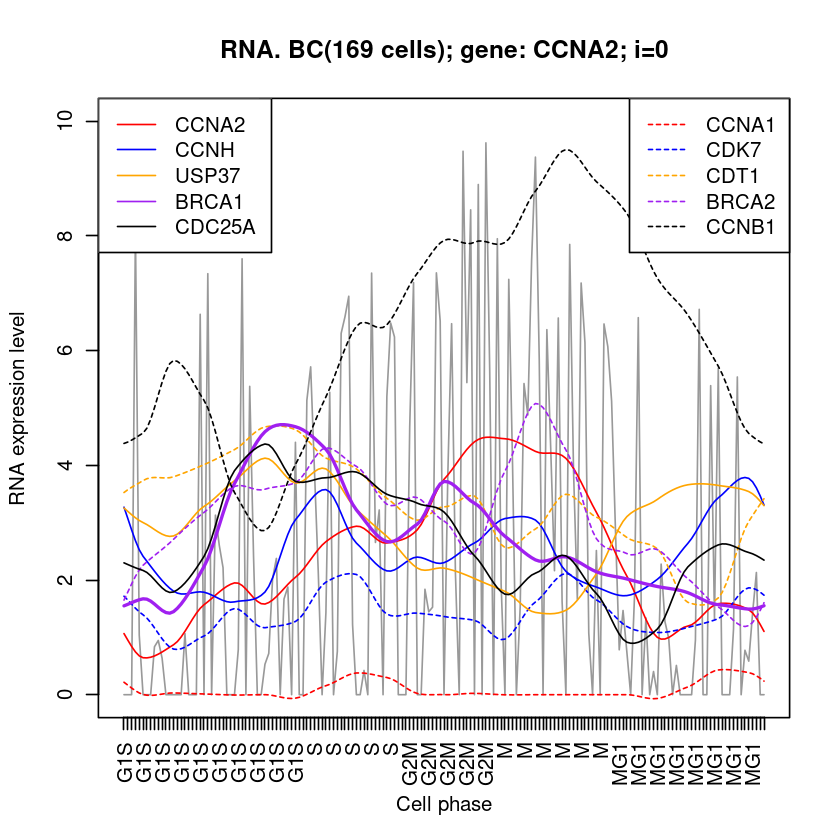

In [1304]:
# S, G2
fn8.addLines=show_cc_RNA2(cellOrder.BC, 'BC', gene='CCNA2') #promotes transition through G1/S and G2/M
# CCNA2: Deubiquitinated and stabilized by USP37 enables entry into S phase.
fn8.addLines('CCNA1','red', lty=2, lwd=1) # in S phase, the other in G2;  G1S start; G2/M transition;
#
fn8.addLines('CCNH','blue') # Regulates CDK7
#CCNH, Associates primarily with CDK7 and MAT1 to form the CAK complex. 
#  CAK can further associate with the core-TFIIH to form the TFIIH basal transcription factor.
fn8.addLines("CDK7", 'blue', lty=2) #transcription initiation, DNA repair;
# 
fn8.addLines("USP37", 'orange') #promoting S phase entry.
fn8.addLines("CDT1", 'orange', lty=2) #USP37, stabilizing licensing factor CDT1 
#

fn8.addLines('BRCA1', 'purple', lwd=2)
fn8.addLines('BRCA2', 'purple', lwd=1, lty=2)

#POLR2A
fn8.addLines('CDC25A', 'black')
fn8.addLines("CCNB1", 'black', lty=2)


legend('topleft', lty=1,
       col=c('red','blue','orange','purple','black'),
       legend=c('CCNA2','CCNH',"USP37",'BRCA1','CDC25A') )
#
legend('topright', lty=2,
       col=c('red','blue','orange','purple','black'),
       legend=c('CCNA1',"CDK7","CDT1",'BRCA2', 'CCNB1') )

[1] 169
[1] 0


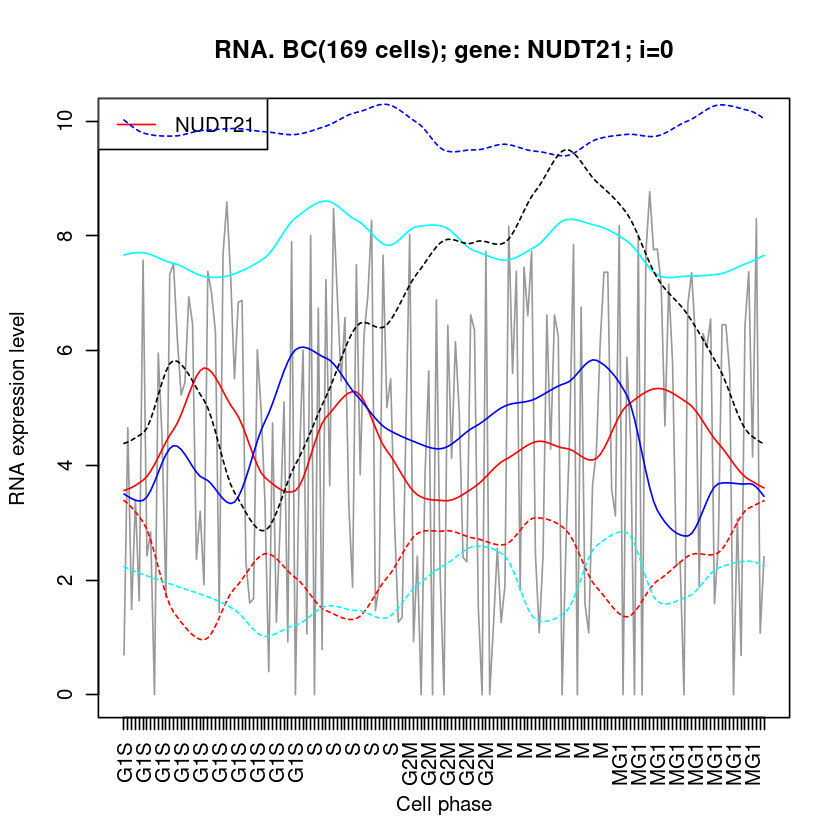

In [1407]:
# protein: CFIm25, Pre-MRNA Cleavage Factor Im 25 KDa Subunit
fn8.addLines=show_cc_RNA2(cellOrder.BC, 'BC', gene='NUDT21') #protein: CFIm25
# https://www.ncbi.nlm.nih.gov/pmc/articles/PMC6831288/
# NUDT21 inhibits bladder cancer progression through ANXA2 and LIMK2 by alternative polyadenylation
fn8.addLines('LIMK2', 'red', lty=2) ##镜像分子！

fn8.addLines('CTCF', 'blue')
fn8.addLines('ANXA2', 'blue', lty=2)


fn8.addLines('RAD21', 'cyan')
#fn8.addLines('NUDT19', 'cyan', lty=2)

fn8.addLines('CCNB1', 'black', lty=2)

              cor    gene
CCNB1   1.0000000   CCNB1
CENPF   0.5955103   CENPF
PTTG1   0.5923926   PTTG1
CDC20   0.5683454   CDC20
CDC20P1 0.5597198 CDC20P1
UBE2S   0.5592958   UBE2S
BIRC5   0.5545932   BIRC5
PLK1    0.5408190    PLK1
BUB1    0.5077824    BUB1
DLGAP5  0.5073094  DLGAP5
[1] 169
[1] 0


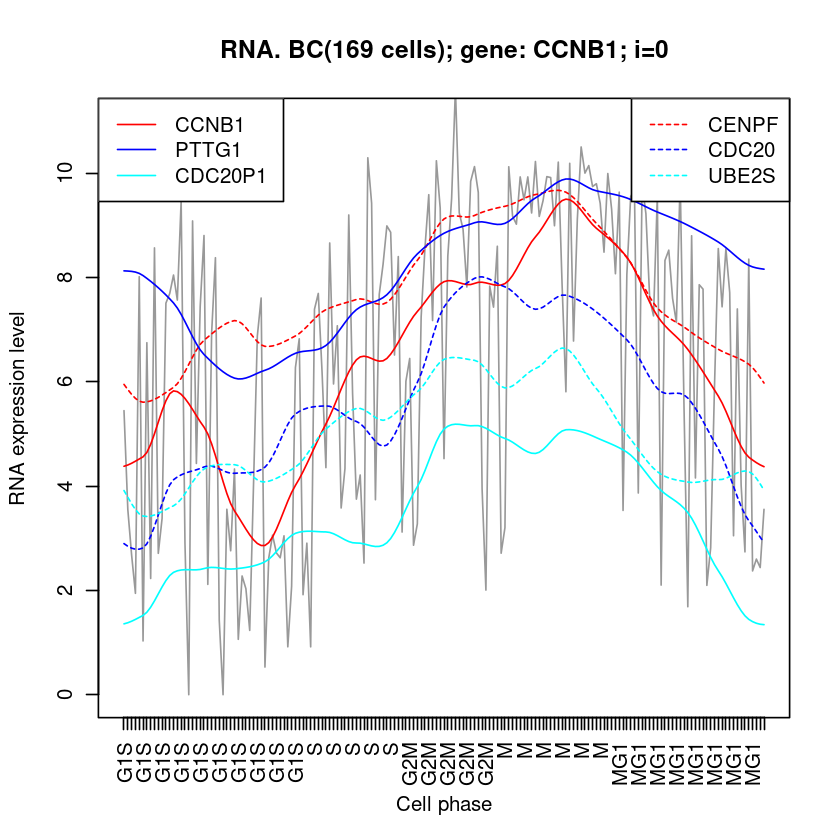

In [1829]:
# 类似表达NUDT21/ CDK1/ PLK1 /
x=showCoTranscriptedGenes('CCNB1', rnaM.log2cpm[, cid.BC], ylim=c(0,11,1), method = 'spearman')

[1] 0.1853291
[1] 29


[1] "CCNB1"   "PTTG1"   "CDC20"   "CDC20P1" "CENPF"   "BUB1"    "BIRC5"  
 [8] "PLK1"    "UBE2S"   "DLGAP5"  "KIF20A"  "CCNB2"   "KIF4A"   "CKS2"   
[15] "HMMR"    "TPX2"    "MKI67"   "DEPDC1"  "SGO2"    "CENPE"   "CDCA3"  
[22] "KIF2C"   "SPC25"   "NDC80"   "ASPM"    "CKAP5"   "ARL6IP1" "RBMX"   
[29] "CEP55"

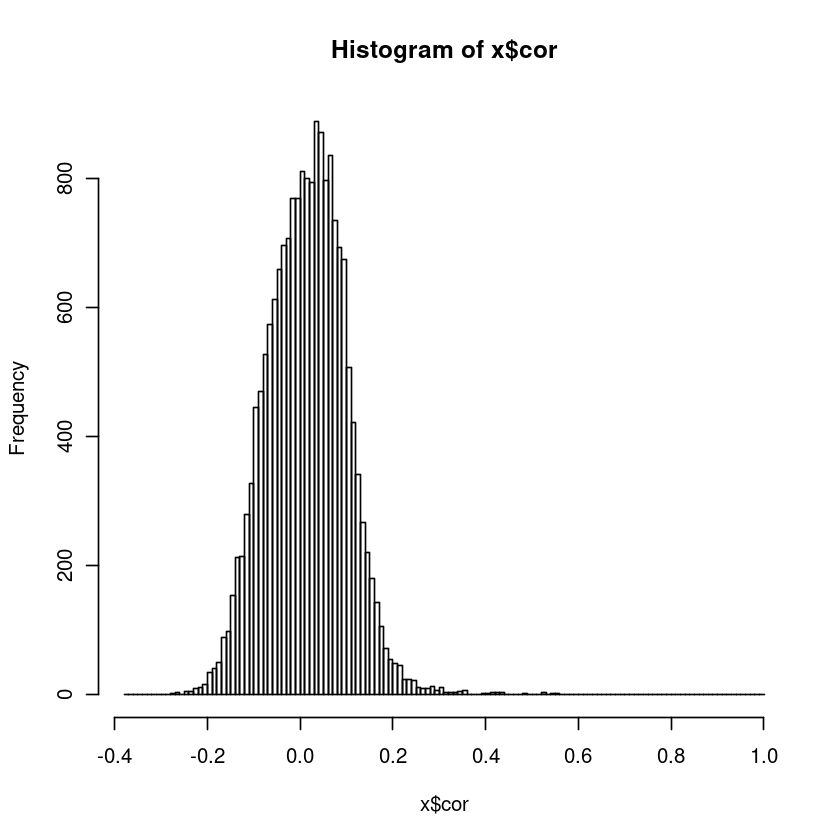

In [1826]:
(function(){
    hist(x$cor, n=100)
    t2=mean(x$cor)+2*sd(x$cor)
    print(t2)
    
    genes=rownames(x[which(x$cor> 0.4),])
    print(length(genes))
    #head(genes, n=100)
    genes
})()

[1] 56
[1] 0


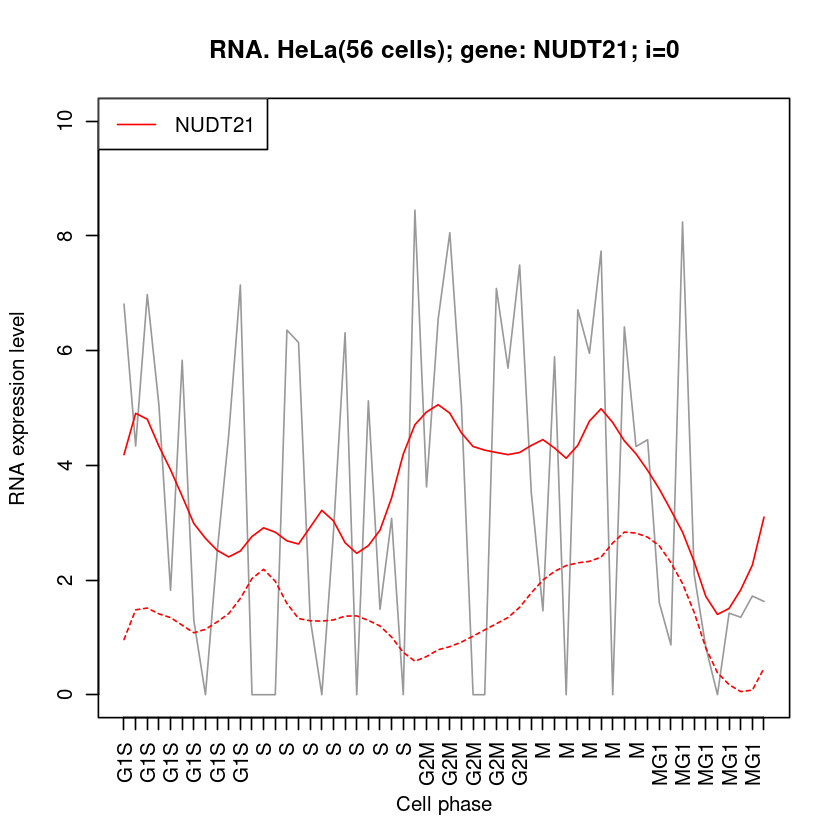

In [1409]:
# HeLa
fn8.addLines=show_cc_RNA2(cellOrder.HeLa, 'HeLa', gene='NUDT21')
fn8.addLines('LIMK2', 'red', lty=2) ##镜像分子！

[1] 169
[1] 0


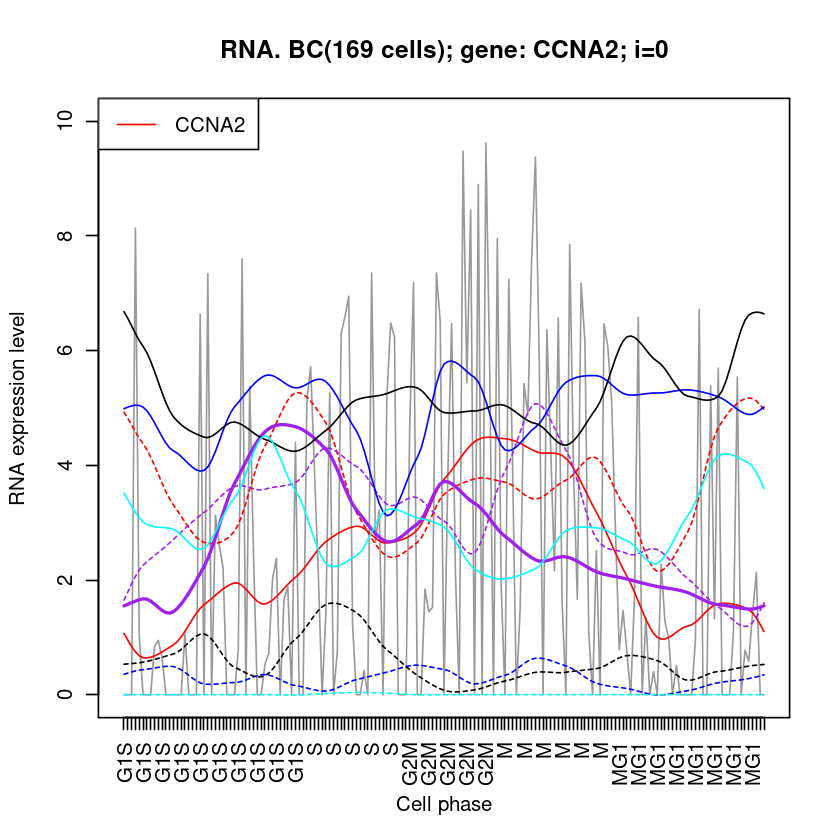

In [1463]:
# BC
fn8.addLines=show_cc_RNA2(cellOrder.BC, 'BC', gene='CCNA2')
fn8.addLines('PTEN', 'red', lty=2)


## https://pubmed.ncbi.nlm.nih.gov/9168997/
# Changes in BRCA2 Expression During Progression of the Cell Cycle
fn8.addLines('BRCA1', 'purple', lwd=2) #S phase cell cycle checkpoint( https://academic.oup.com/nar/article/34/5/1416/1145745)
fn8.addLines('BRCA2', 'purple', lwd=1, lty=2)
# BRCA1和2貌似总量不变，一个S期高峰，一个M期高峰。


fn8.addLines('TP53', 'blue')
fn8.addLines('RB1', 'blue', lty=2) #too low

fn8.addLines('CCND1', 'black')
fn8.addLines('CDKN1A', 'black', lty=2) #p21, peak at S

fn8.addLines('ATM', 'cyan')
fn8.addLines('LAG3', 'cyan', lty=2) #too low

[1] 56
[1] 0


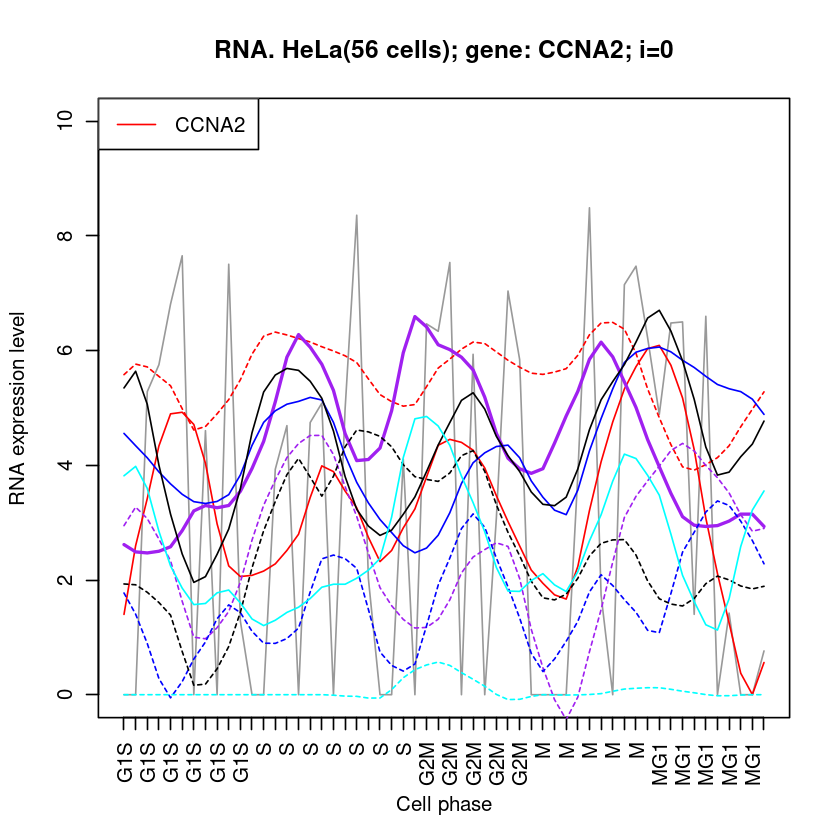

In [1464]:
# HeLa 2步法
fn8.addLines=show_cc_RNA2(cellOrder.HeLa, 'HeLa', gene='CCNA2')
fn8.addLines('PTEN', 'red', lty=2)


## https://pubmed.ncbi.nlm.nih.gov/9168997/
# Changes in BRCA2 Expression During Progression of the Cell Cycle
fn8.addLines('BRCA1', 'purple', lwd=2)
fn8.addLines('BRCA2', 'purple', lwd=1, lty=2)

fn8.addLines('TP53', 'blue')
fn8.addLines('RB1', 'blue', lty=2) #too low

fn8.addLines('CCND1', 'black')
fn8.addLines('CDKN1A', 'black', lty=2) #p21

fn8.addLines('ATM', 'cyan')
fn8.addLines('LAG3', 'cyan', lty=2) #too low

[1] 56
[1] 0


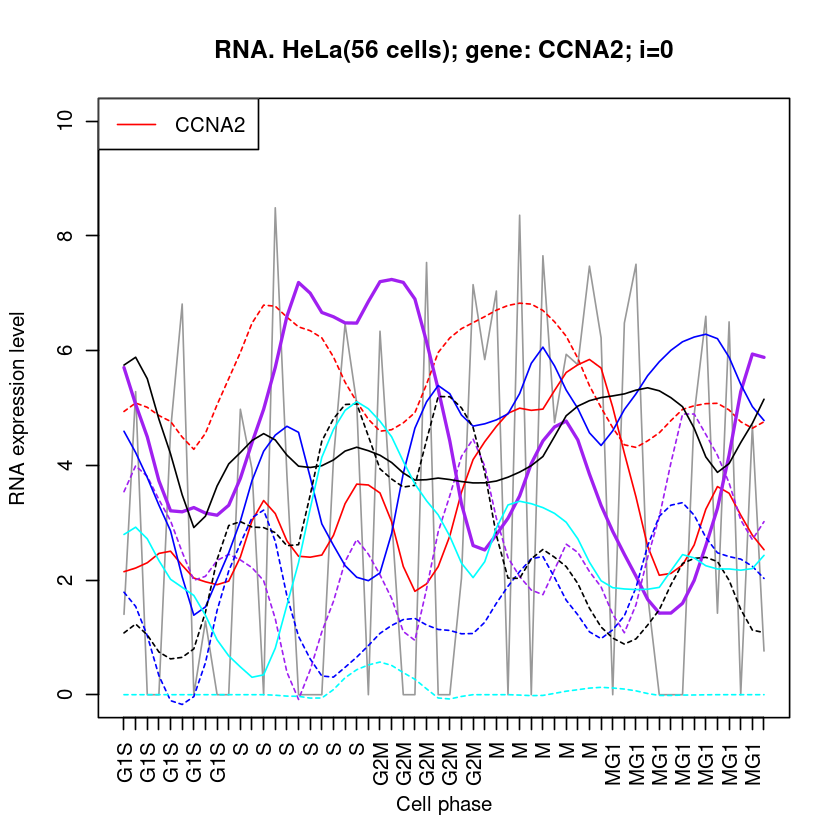

In [1465]:
# HeLa 一步法
fn8.addLines=show_cc_RNA2(cellOrder.HeLa.Uni, 'HeLa', gene='CCNA2')
fn8.addLines('PTEN', 'red', lty=2)


## https://pubmed.ncbi.nlm.nih.gov/9168997/
# Changes in BRCA2 Expression During Progression of the Cell Cycle
fn8.addLines('BRCA1', 'purple', lwd=2)
fn8.addLines('BRCA2', 'purple', lwd=1, lty=2)

fn8.addLines('TP53', 'blue')
fn8.addLines('RB1', 'blue', lty=2) #too low

fn8.addLines('CCND1', 'black')
fn8.addLines('CDKN1A', 'black', lty=2) #p21

fn8.addLines('ATM', 'cyan')
fn8.addLines('LAG3', 'cyan', lty=2) #too low

              cor    gene
CCNA2   1.0000000   CCNA2
SPC25   0.4531417   SPC25
TPX2    0.4092638    TPX2
ANLN    0.3921595    ANLN
ARL6IP1 0.3898311 ARL6IP1
GTSE1   0.3886253   GTSE1
TOP2A   0.3868178   TOP2A
CDC20   0.3864281   CDC20
CDCA8   0.3825135   CDCA8
CENPF   0.3813396   CENPF
[1] 169
[1] 0


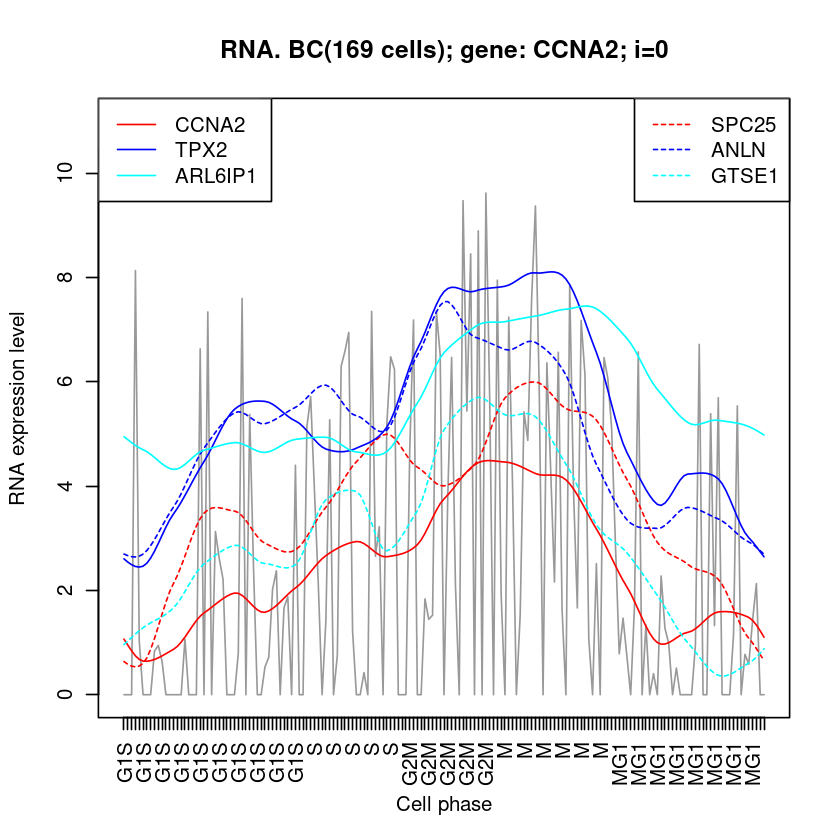

In [1277]:
# 类似表达
x=showCoTranscriptedGenes('CCNA2', rnaM.cpm[, cid.BC], ylim=c(0,11,1))

               cor     gene
BRCA1    1.0000000    BRCA1
SLC25A15 0.3686287 SLC25A15
BCL11B   0.3442266   BCL11B
SPAG16   0.3253943   SPAG16
RFC3     0.3248957     RFC3
CTDSPL   0.3135205   CTDSPL
RIC8A    0.3116122    RIC8A
PRRG4    0.3086018    PRRG4
TMEM245  0.3077032  TMEM245
SMC4     0.3025808     SMC4
[1] 169
[1] 0


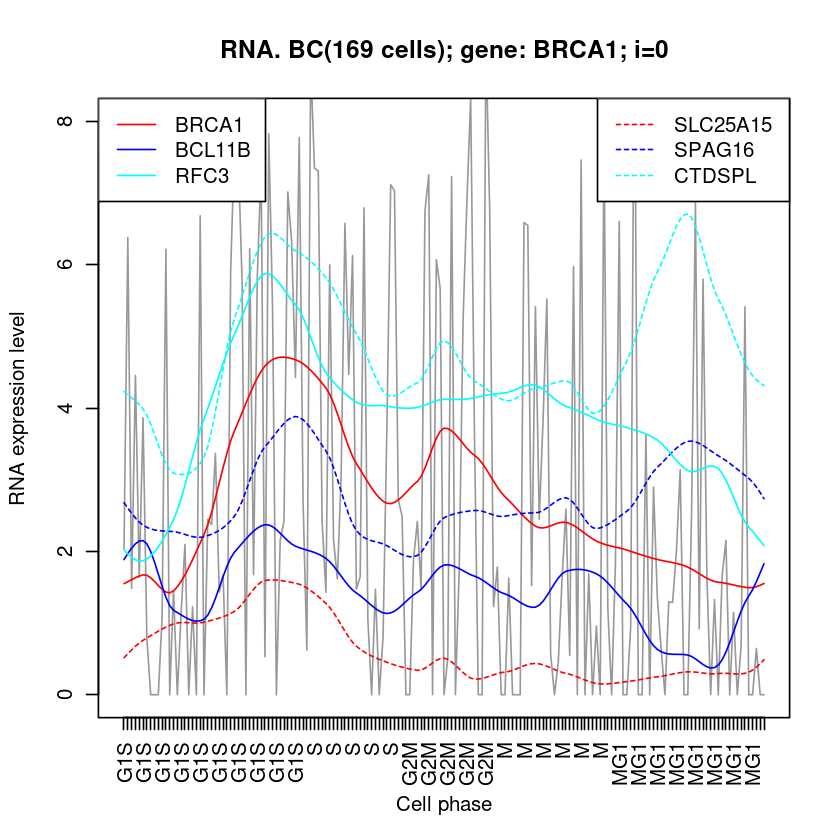

In [1467]:
# 类似表达
x=showCoTranscriptedGenes('BRCA1', rnaM.cpm[, cid.BC], ylim=c(0,8,1))

              cor    gene
BRCA2   1.0000000   BRCA2
GAS2L3  0.4271662  GAS2L3
RPS6KA3 0.3751814 RPS6KA3
MAP4K5  0.3687911  MAP4K5
EIF2AK4 0.3657775 EIF2AK4
PLEKHA1 0.3634479 PLEKHA1
MAD2L1  0.3610528  MAD2L1
DIAPH3  0.3562691  DIAPH3
RBMXL1  0.3557395  RBMXL1
COG2    0.3492637    COG2
[1] 169
[1] 0


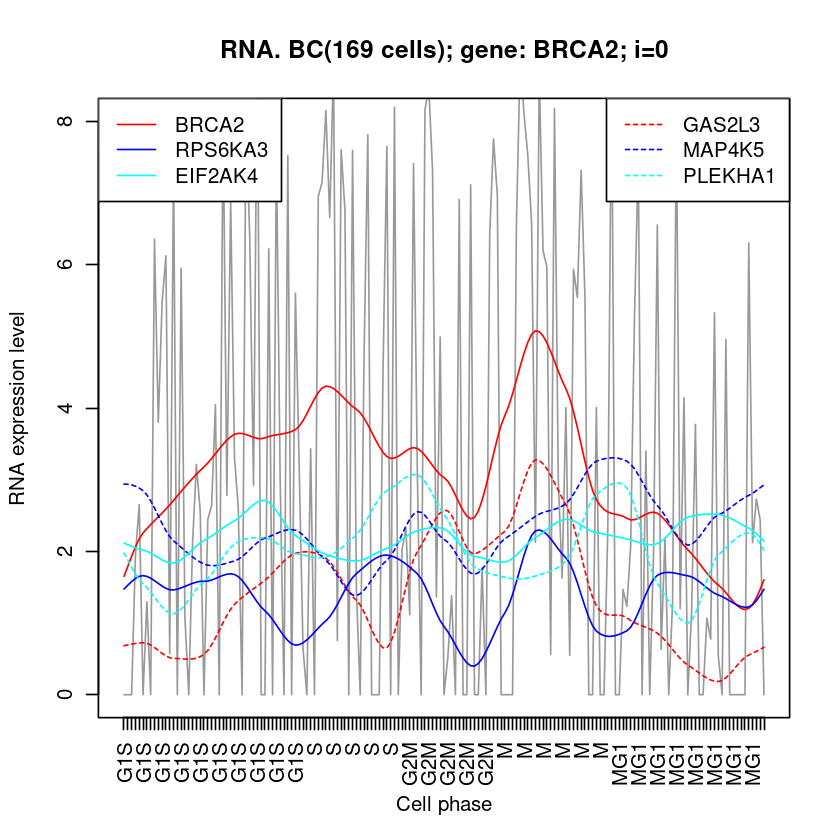

In [1468]:
# 类似表达
x=showCoTranscriptedGenes('BRCA2', rnaM.cpm[, cid.BC], ylim=c(0,8,1))

[1] 169
[1] 0


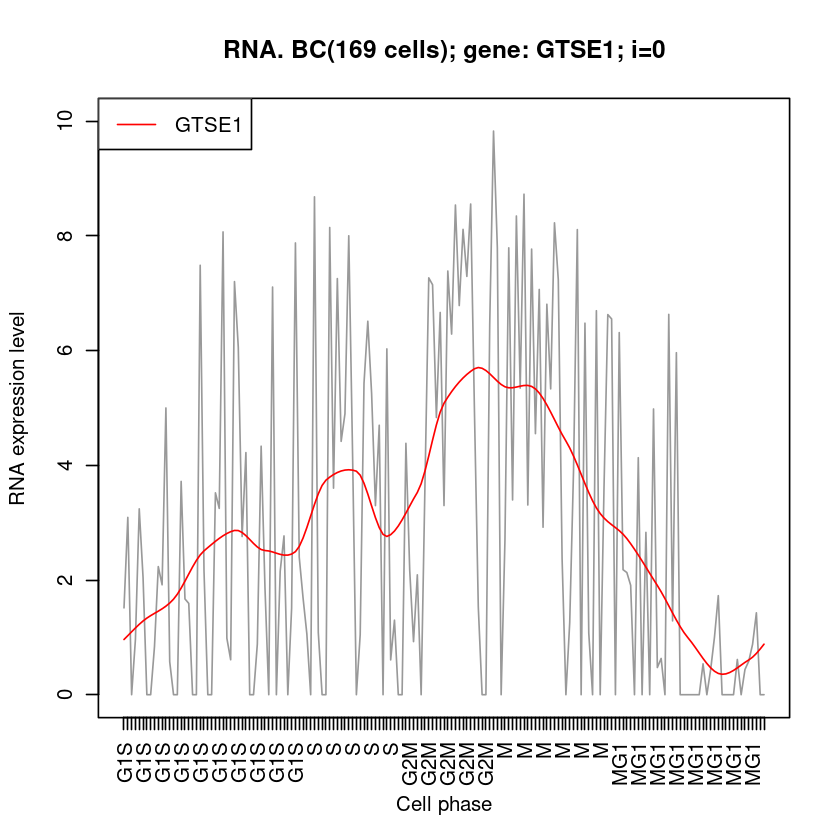

In [1079]:
#GTSE1: G2 And S-Phase Expressed 1
#May be involved in p53-induced cell cycle arrest in G2/M phase by interfering with microtubule 
#  rearrangements that are required to enter mitosis. Overexpression delays G2/M phase progression
fn8.addLines=show_cc_RNA2(cellOrder.BC, 'BC', gene='GTSE1') 

                 cor      gene
RPA2       1.0000000      RPA2
SRM        0.3349627       SRM
SMIM12     0.3239254    SMIM12
NUBP2      0.3116638     NUBP2
LINC00667  0.3093347 LINC00667
CHEK2      0.2843746     CHEK2
CUTA       0.2843497      CUTA
BRCA1      0.2836500     BRCA1
PI4K2B     0.2769011    PI4K2B
SECISBP2  -0.2714571  SECISBP2
[1] 169
[1] 0


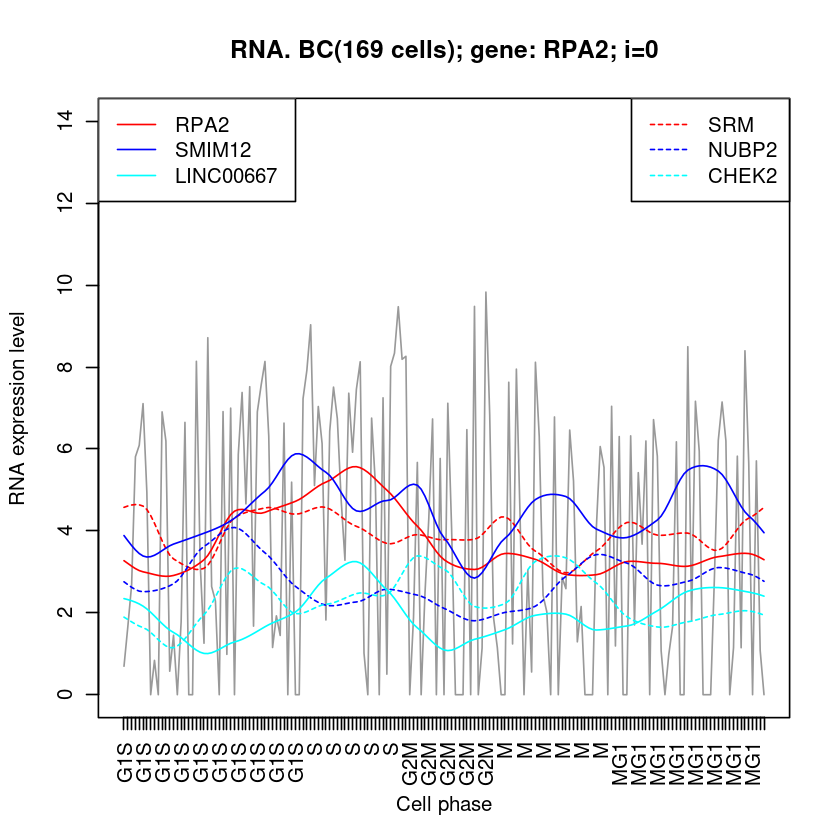

In [1283]:
# 类似表达
x=showCoTranscriptedGenes('RPA2', rnaM.cpm[, cid.BC], ylim=c(0,14,1))

               cor    gene
TP53     1.0000000    TP53
MT-TT   -0.3821764   MT-TT
TNS3     0.3305154    TNS3
CUTC     0.3128263    CUTC
CAPN2    0.3070726   CAPN2
ROCK2    0.3069668   ROCK2
PTPA     0.3065267    PTPA
RBBP7    0.3046577   RBBP7
RPS6KA5  0.3022187 RPS6KA5
SRPK2    0.2949175   SRPK2
[1] 169
[1] 0


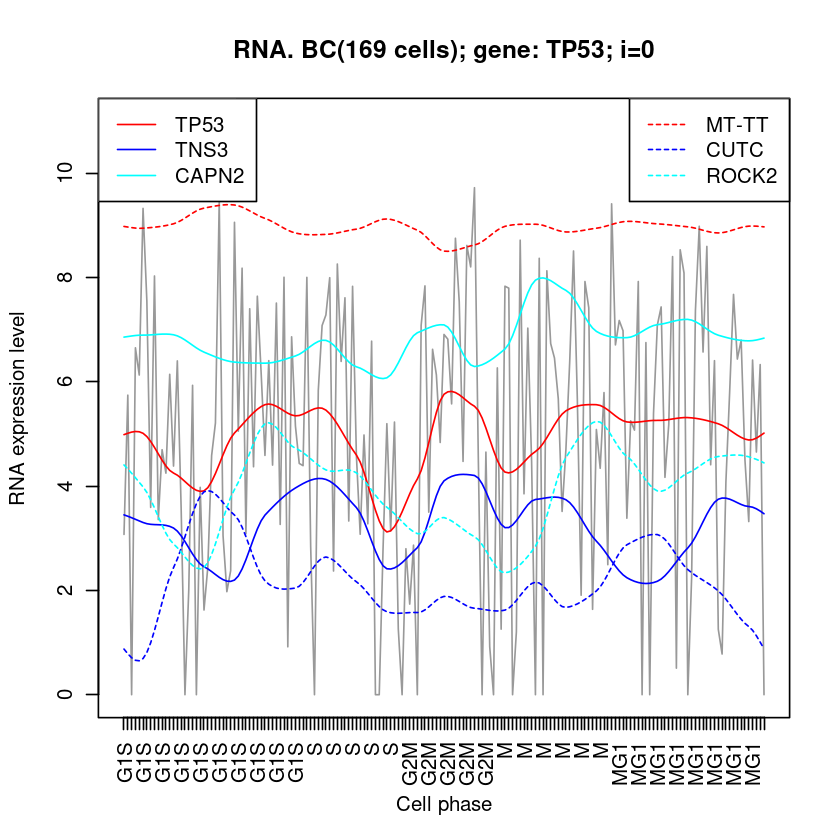

In [1279]:
# 类似表达
x=showCoTranscriptedGenes('TP53', rnaM.cpm[, cid.BC], ylim=c(0,11,1))

### G2/M transition, M

[1] 169
[1] 0


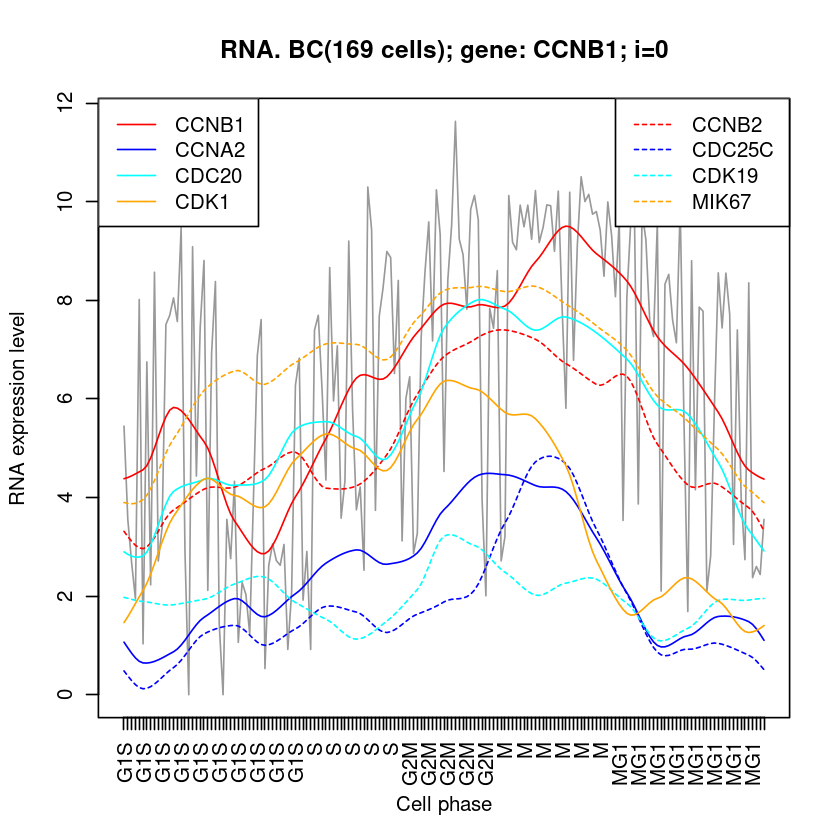

In [1619]:
#G2/M transition, M
fn8.addLines=show_cc_RNA2(cellOrder.BC, 'BC', gene='CCNB1') #M
fn8.addLines('CCNB2','red', lty=2)

#
fn8.addLines('CCNA2','blue') #G2
fn8.addLines('CDC25C','blue', lty=2) #
#CDC25C, highly effective in activating G2 cells into prophase. Directly dephosphorylates CDK1 and activates its kinase activity. 
#
#fn8.addLines('CDC25B','blue', lwd=2) #Required for G2/M phases of the cell cycle progression 
#CDC25B shuttles between the nucleus and the cytoplasm due to nuclear localization and nuclear export signals. 
#  The protein is nuclear in the M and G1 phases of the cell cycle and moves to the cytoplasm during S and G2. 

#
fn8.addLines('CDC20','cyan') # before chr separation
fn8.addLines("CDK19", 'cyan', lty=2) #high G2M??? 转录RNA起始复合物组分
#This gene encodes a protein that is one of the components of the Mediator co-activator complex. 
#   The Mediator complex is a multi-protein complex required for transcriptional activation by 
#   DNA binding transcription factors of genes transcribed by RNA polymerase II. 

fn8.addLines('CDK1','orange')
## promotes G2-M transition, and regulates G1 progress and G1-S transition via association with multiple interphase cyclins.
fn8.addLines('MKI67','orange', lty=2)
#
legend('topleft', lty=1, 
       col=c('red', 'blue','cyan', 'orange'), 
       legend=c('CCNB1','CCNA2','CDC20', 'CDK1') )
#
legend('topright', lty=2, 
       col=c('red','blue','cyan','orange'), 
       legend=c('CCNB2','CDC25C','CDK19', 'MIK67') )

              cor    gene
CCNB1   1.0000000   CCNB1
CENPF   0.5955103   CENPF
PTTG1   0.5923926   PTTG1
CDC20   0.5683454   CDC20
CDC20P1 0.5597198 CDC20P1
UBE2S   0.5592958   UBE2S
BIRC5   0.5545932   BIRC5
PLK1    0.5408190    PLK1
BUB1    0.5077824    BUB1
DLGAP5  0.5073094  DLGAP5
[1] 169
[1] 0


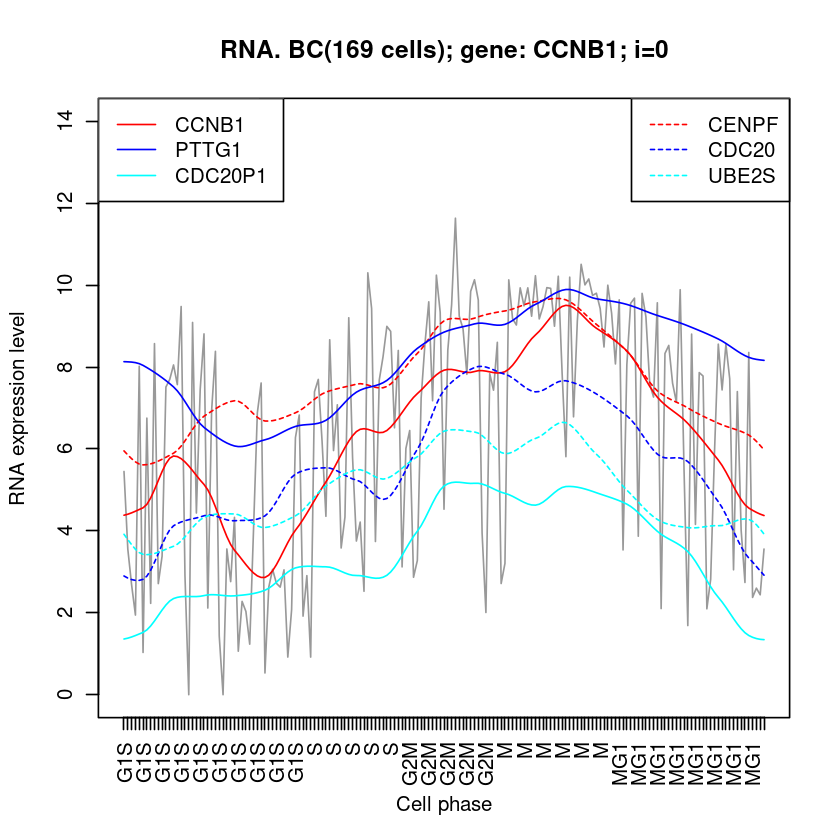

In [1280]:
# 类似表达
x=showCoTranscriptedGenes('CCNB1', rnaM.cpm[, cid.BC], ylim=c(0,14,1))

                cor      gene
EDEM3     1.0000000     EDEM3
PRR15L    0.3994212    PRR15L
LINC01697 0.3389872 LINC01697
ZFC3H1    0.3303918    ZFC3H1
CMTM3     0.3215915     CMTM3
ITCH      0.3208639      ITCH
POTEE     0.3190554     POTEE
TNC       0.3180513       TNC
ZNF286B   0.3180365   ZNF286B
MELTF     0.3163710     MELTF
[1] 169
[1] 0


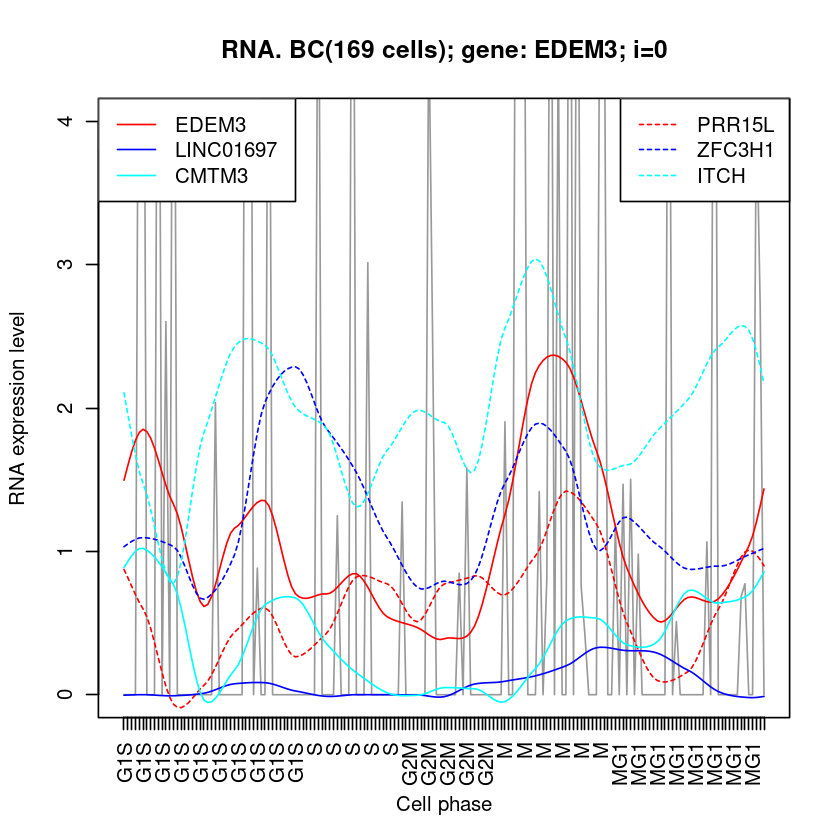

In [1420]:
x=showCoTranscriptedGenes('EDEM3', rnaM.cpm[, cid.BC], ylim=c(0,4,1))

[1] 169
[1] 0


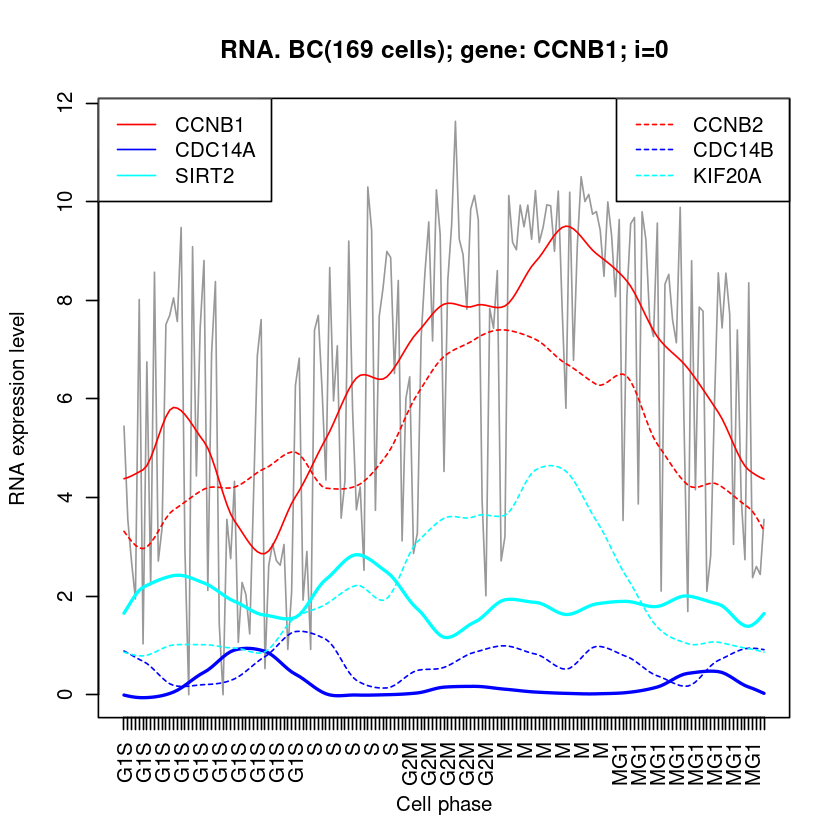

In [840]:
# G2M, M
fn8.addLines=show_cc_RNA2(cellOrder.BC, 'BC', gene='CCNB1')
fn8.addLines('CCNB2','red', lty=2)
#
fn8.addLines('CDC14A','blue', lwd=2)
# CDC14A: Dual-specificity phosphatase. Required for centrosome separation and productive cytokinesis during cell division. 
# Dephosphorylates SIRT2 around early anaphase.
#   Interacts with KIF20A, which is required to localize CDC14 to the midzone of the mitotic spindle.
fn8.addLines('CDC14B','blue', lty=2)
#Dual-specificity phosphatase involved in DNA damage response. 
# Essential regulator of the G2 DNA damage checkpoint: following DNA damage, 
#  translocates to the nucleus and dephosphorylates FZR1/CDH1, a key activator of the anaphase 
#  promoting complex/cyclosome (APC/C). Dephosphorylates SIRT2 around early anaphase.
fn8.addLines('SIRT2','cyan', lwd=2)
fn8.addLines('KIF20A','cyan', lty=2) # 纺锤体
#
legend('topleft', lty=1, 
       col=c('red', 'blue', 'cyan'), 
       legend=c('CCNB1','CDC14A','SIRT2') )
#
legend('topright', lty=2, 
       col=c('red','blue','cyan'), 
       legend=c('CCNB2','CDC14B','KIF20A') )

[1] 169
[1] 0


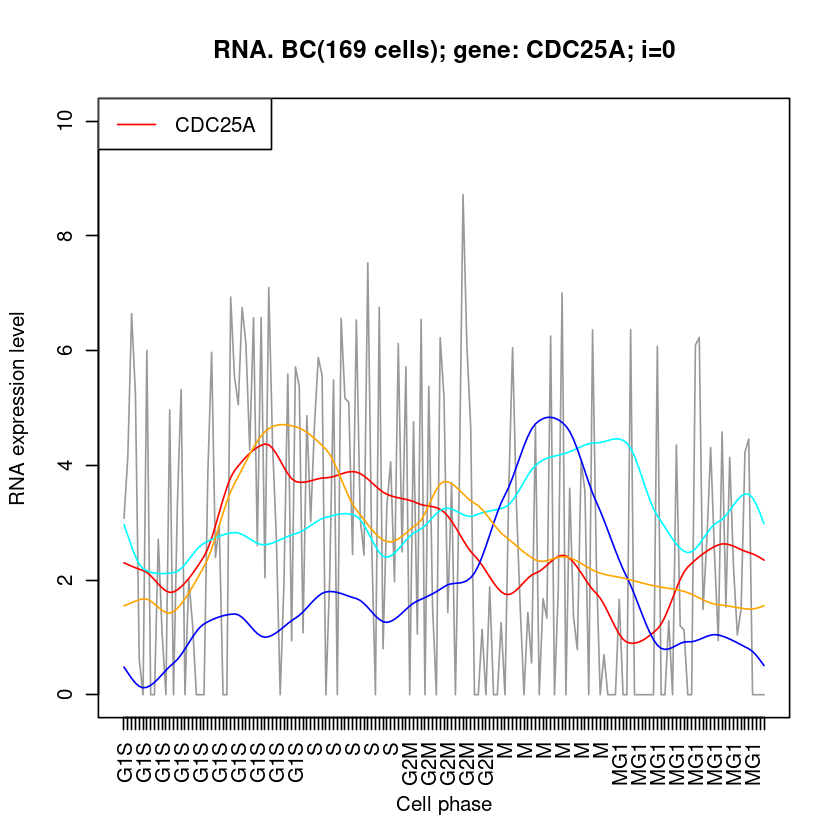

In [1297]:
# CDC25
fn8.addLines=show_cc_RNA2(cellOrder.BC, 'BC', gene='CDC25A') #G1 S

fn8.addLines('CDC25B','cyan')
fn8.addLines('CDC25C','blue') #G2 M

fn8.addLines('BRCA1', 'orange')

             cor   gene
CDC25C 1.0000000 CDC25C
CENPF  0.4343999  CENPF
BUB1   0.3954178   BUB1
PLK1   0.3727945   PLK1
DLGAP5 0.3662861 DLGAP5
TOP2A  0.3653586  TOP2A
HMMR   0.3510690   HMMR
GTSE1  0.3498186  GTSE1
F11R   0.3437839   F11R
CCNB1  0.3393105  CCNB1
[1] 169
[1] 0


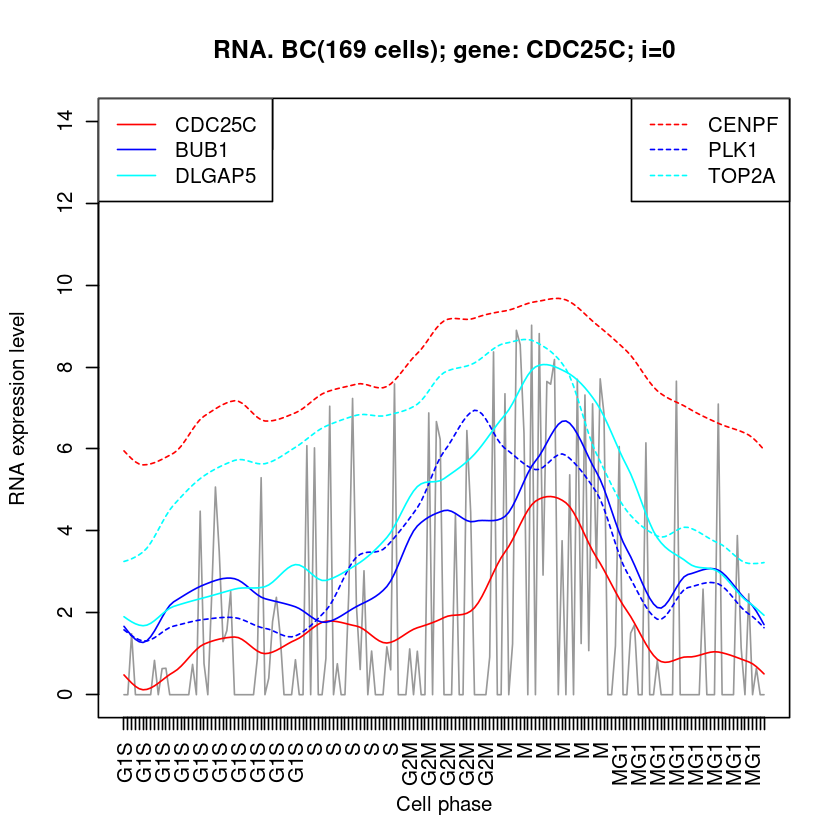

In [1281]:
# 类似表达
x=showCoTranscriptedGenes('CDC25C', rnaM.cpm[, cid.BC], ylim=c(0,14,1))

[1] 169
[1] 0


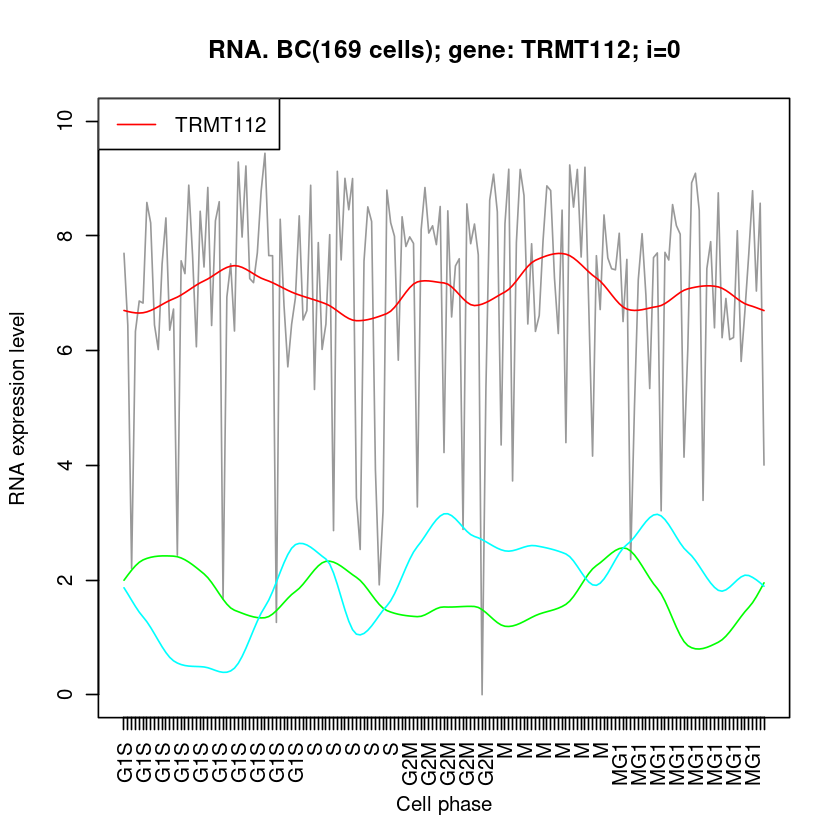

In [1386]:
fn8.addLines=show_cc_RNA2(cellOrder.BC, 'BC', gene='TRMT112')
fn8.addLines('ID1','green')
fn8.addLines('HOTAIR', 'cyan')

In [1041]:
rownames(rnaM)[grep('PLK', rownames(rnaM))]
#Polo-like kinases (PLKs) are a family of four serine/threonine protein kinases that 
# are critical regulators of cell cycle progression, mitosis, cytokinesis, and the DNA damage response. 
#PLK1, -2 and -3 are ubiquitously expressed, whereas PLK4 is restricted to a few tissues.

[1] "MPLKIP" "PLK1"   "PLK2"   "PLK3"   "PLK4"

[1] 169
[1] 0


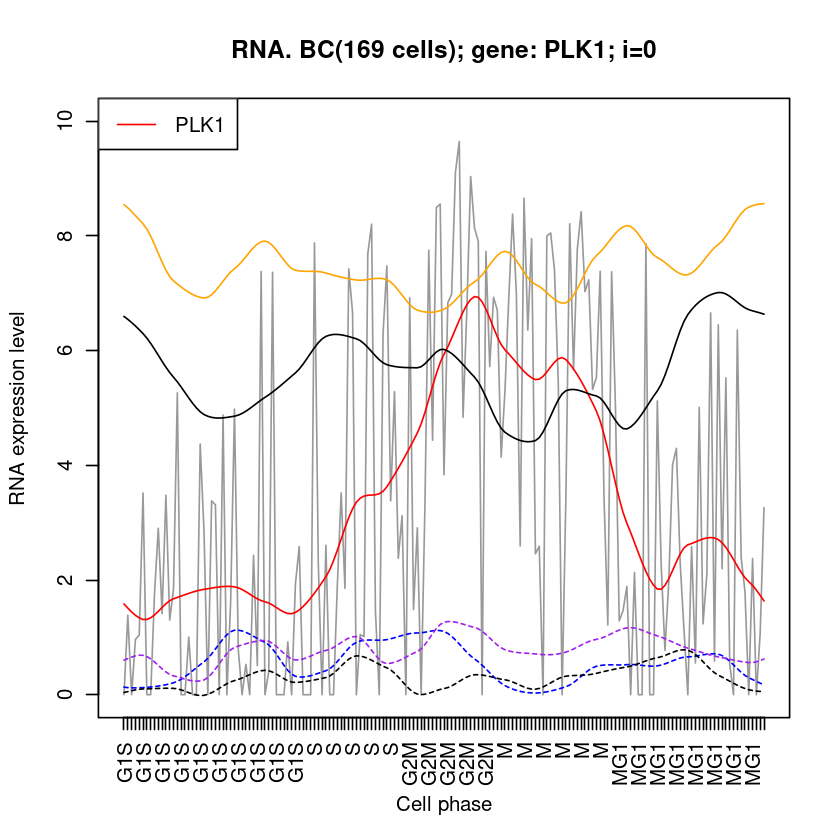

In [1046]:
fn8.addLines=show_cc_RNA2(cellOrder.BC, 'BC', gene='PLK1')#
fn8.addLines("MPLKIP", 'black')
fn8.addLines("PLK2", 'orange')
#
fn8.addLines("PLK3", 'blue', lty=2)
fn8.addLines("PLK4", 'purple', lty=2)
fn8.addLines('BORA', 'black', lty=2)

             cor   gene
PLK1   1.0000000   PLK1
DLGAP5 0.5620620 DLGAP5
CENPF  0.5518512  CENPF
CCNB1  0.5408190  CCNB1
TOP2A  0.5372138  TOP2A
UBE2S  0.5340270  UBE2S
TPX2   0.5272566   TPX2
CDKN2D 0.5167547 CDKN2D
CDC20  0.5155805  CDC20
SGO2   0.5073498   SGO2
[1] 169
[1] 0


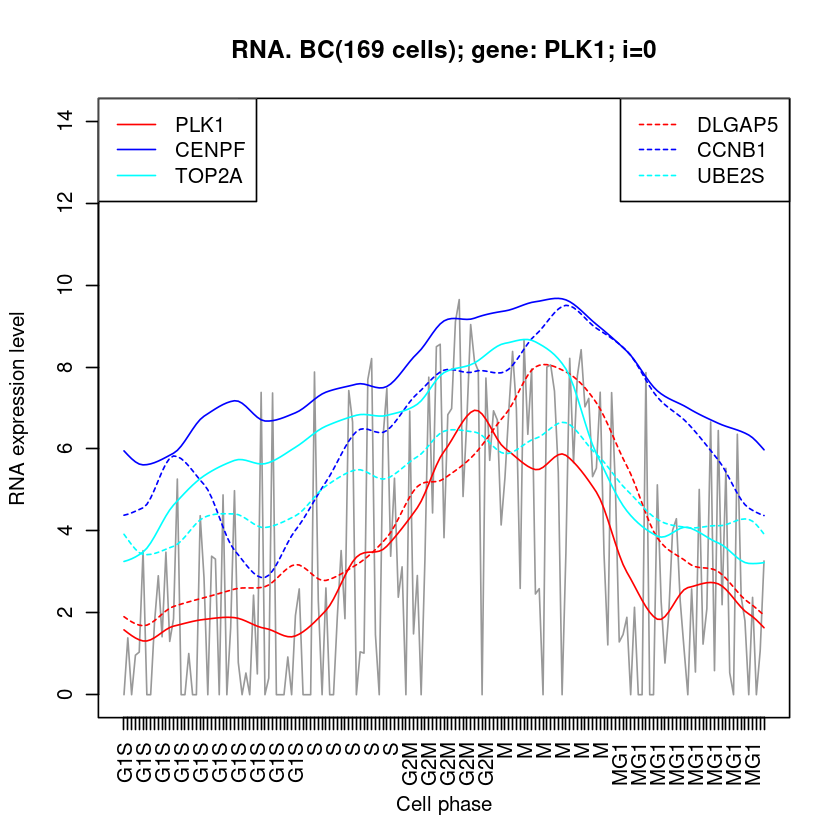

In [1282]:
# 类似表达
x=showCoTranscriptedGenes('PLK1', rnaM.cpm[, cid.BC], ylim=c(0,14,1))

[1] 56
[1] 0


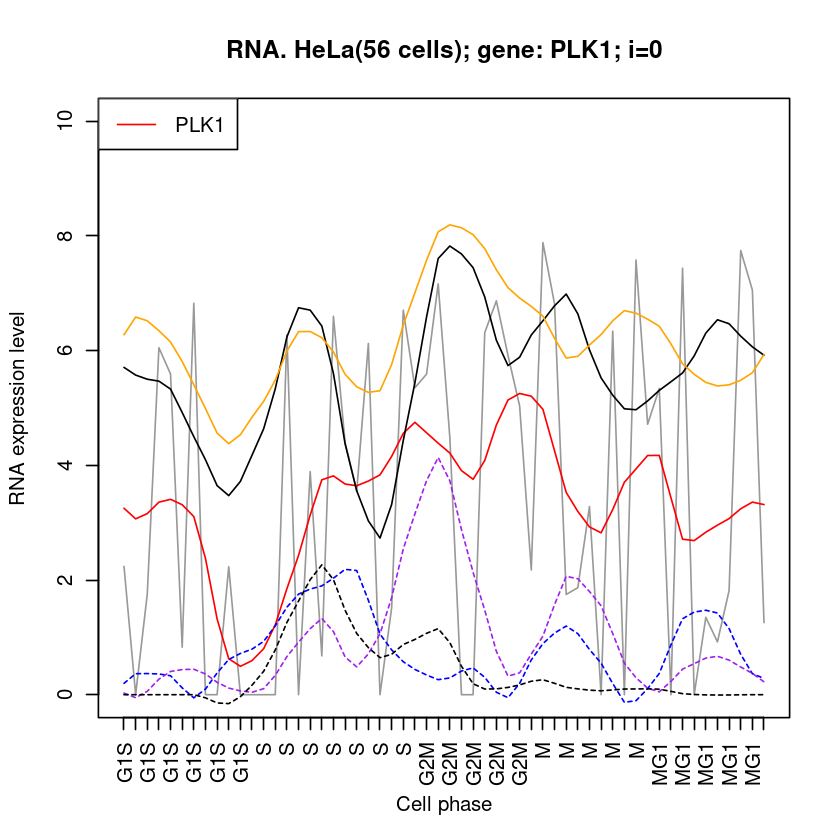

In [1047]:
## PLK in HeLa
fn8.addLines=show_cc_RNA2(cellOrder.HeLa, 'HeLa', gene='PLK1')#
fn8.addLines("MPLKIP", 'black')
fn8.addLines("PLK2", 'orange')
#
fn8.addLines("PLK3", 'blue', lty=2)
fn8.addLines("PLK4", 'purple', lty=2)
fn8.addLines('BORA', 'black', lty=2)

[1] 169
[1] 0


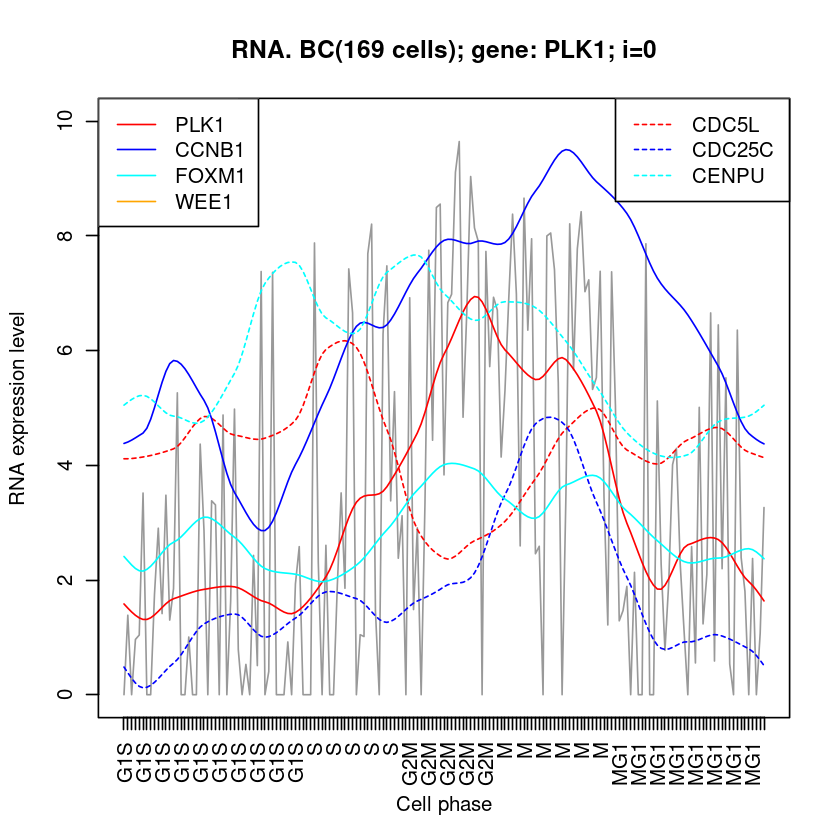

In [1042]:
# PLK1   # https://www.genecards.org/cgi-bin/carddisp.pl?gene=PLK1&keywords=PLK1

fn8.addLines=show_cc_RNA2(cellOrder.BC, 'BC', gene='PLK1')#
#PLK1: the Ser/Thr protein kinase encoded by this gene belongs to the CDC5/Polo subfamily. 
# It is highly expressed during mitosis and elevated levels are found in many different types of cancer.
fn8.addLines("CDC5L", 'red', lty=2)

#
fn8.addLines('CCNB1','blue') 
fn8.addLines('CDC25C','blue', lty=2)

# #
fn8.addLines('FOXM1','cyan') 
fn8.addLines("CENPU", 'cyan', lty=2) 


#fn8.addLines('WEE1','orange')

#
legend('topleft', lty=1, 
       col=c('red', 'blue','cyan', 'orange'), 
       legend=c('PLK1','CCNB1','FOXM1', 'WEE1') )
#
legend('topright', lty=2, 
       col=c('red','blue','cyan'), 
       legend=c('CDC5L','CDC25C','CENPU') )

### pathways

[1] 169
[1] 0


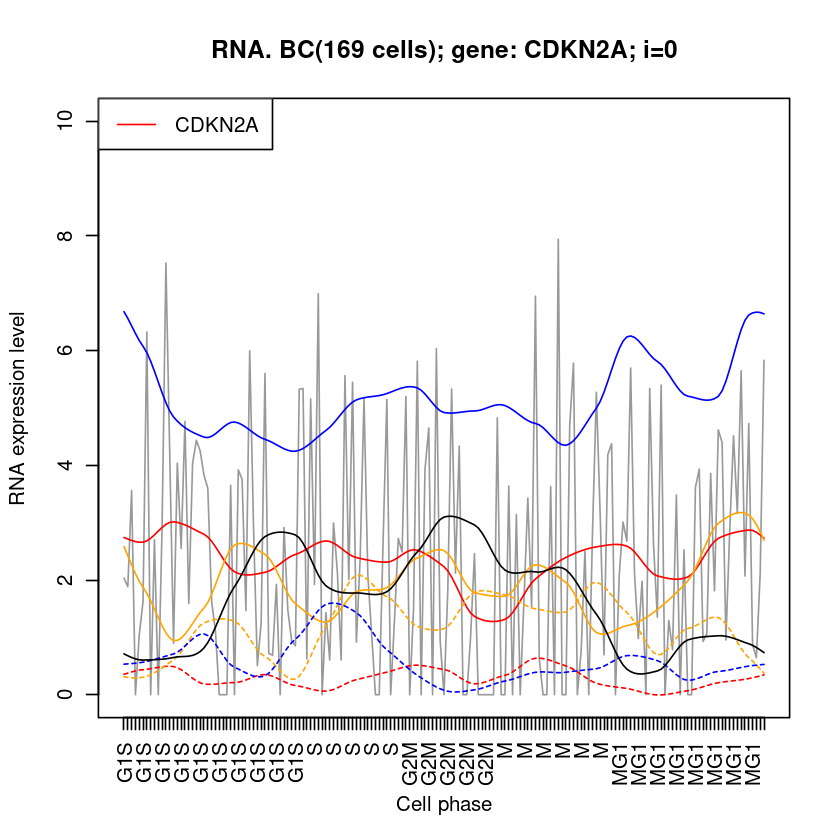

In [1368]:
#
fn8.addLines=show_cc_RNA2(cellOrder.BC, 'BC', gene='CDKN2A')
fn8.addLines('RB1', 'red', lty=2)
#
fn8.addLines('CDK12', 'orange')
fn8.addLines('CDKN1B', 'orange', lty=2)
#
fn8.addLines('CCND1', 'blue')
fn8.addLines('CDKN1A', 'blue', lty=2)
fn8.addLines('CDKN2C', 'black')

#### APA factor

[1] "CPSF1"  "CPSF2"  "CPSF3"  "CPSF4"  "CPSF4L" "CPSF6"  "CPSF7" 
[1] 169
[1] 0


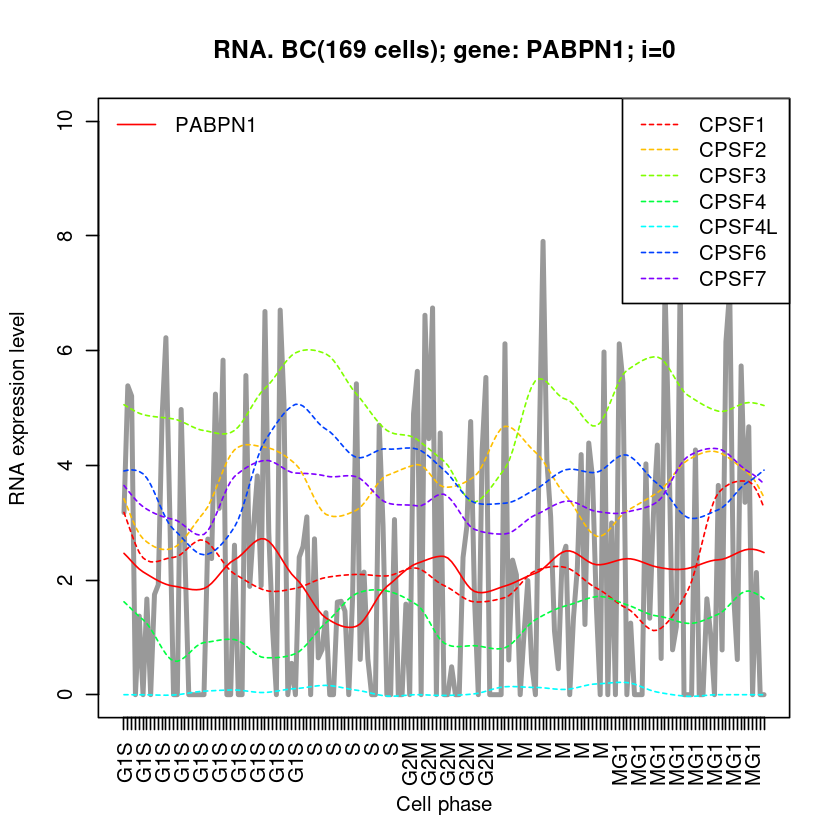

In [1867]:
(function(){
    genes=rownames(rnaM.log2cpm)
    genes2=genes[grep('CPSF', genes)] #"CPSF1"  "CPSF2"  "CPSF3"  "CPSF4"  "CPSF4L" "CPSF6"  "CPSF7" 
    print(genes2)
    
    fn8.addLines=show_cc_RNA2(cellOrder.BC, 'BC', gene='PABPN1', lwd=3)
    draw001=function(geneSet){
        n=length(geneSet)
        colors=rainbow(n*1.2)
        for( i in 1:n ){
            gene=geneSet[i]
            fn8.addLines(gene,colors[i], lty=2)
        }
        legend('topright', lty=2, col=colors[1:n], legend=geneSet)
    }
    draw001(genes2)
})()

[1] "CSTF1"  "CSTF2"  "CSTF2T" "CSTF3" 
[1] 169
[1] 0


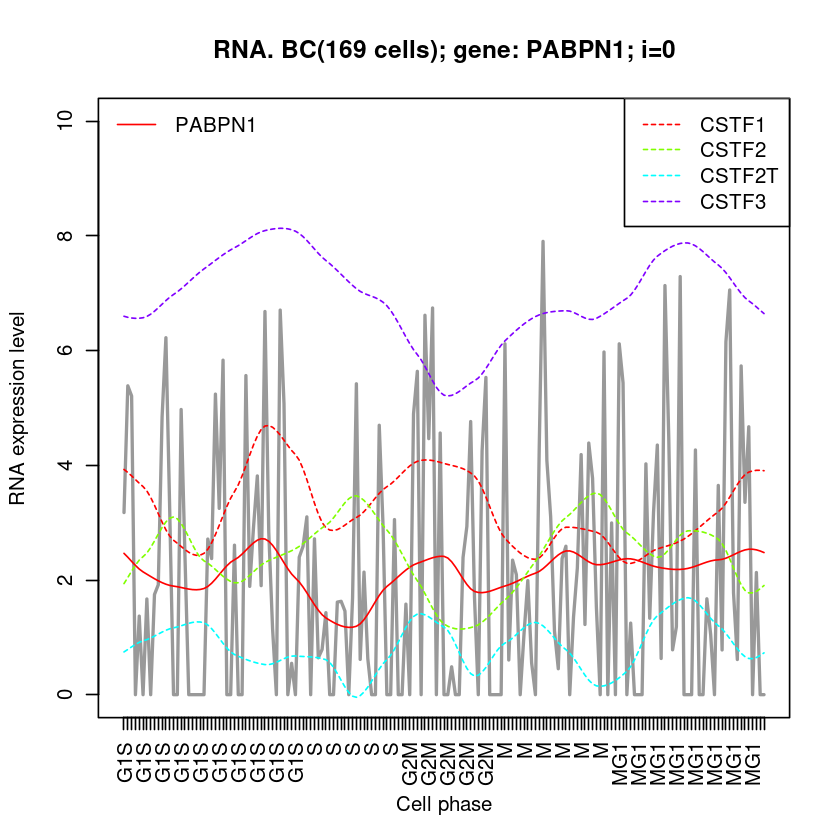

In [1866]:
(function(){
    genes=rownames(rnaM.log2cpm)
    genes2=genes[grep('CSTF', genes)] #"CSTF1"  "CSTF2"  "CSTF2T" "CSTF3" 
    print(genes2)
    
    fn8.addLines=show_cc_RNA2(cellOrder.BC, 'BC', gene='PABPN1', lwd=2)
    draw001=function(geneSet){
        n=length(geneSet)
        colors=rainbow(n*1.2)
        for( i in 1:n ){
            gene=geneSet[i]
            fn8.addLines(gene,colors[i], lty=2)
        }
        legend('topright', lty=2, col=colors[1:n], legend=geneSet)
    }
    draw001(genes2)
})()

 [1] "PABPC1"     "PABPC1L"    "PABPC1P1"   "PABPC1P2"   "PABPC1P3"  
 [6] "PABPC1P4"   "PABPC3"     "PABPC4"     "PABPC4-AS1" "PABPC4L"   
[11] "PABPN1"    
[1] 169
[1] 0


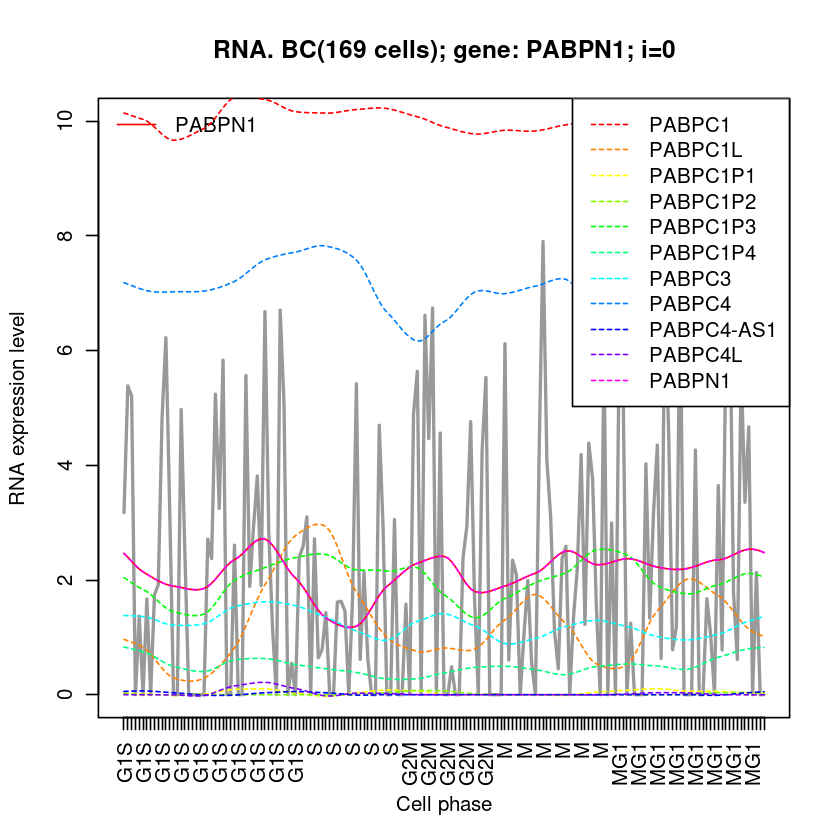

In [1872]:
(function(){
    genes=rownames(rnaM.log2cpm)
    genes2=genes[grep('^PABP', genes)] #"CSTF1"  "CSTF2"  "CSTF2T" "CSTF3" 
    print(genes2)
    
    fn8.addLines=show_cc_RNA2(cellOrder.BC, 'BC', gene='PABPN1', lwd=2, ylim=c(0,10))
    draw001=function(geneSet){
        n=length(geneSet)
        colors=rainbow(n*1.1)
        for( i in 1:n ){
            gene=geneSet[i]
            fn8.addLines(gene,colors[i], lty=2)
        }
        legend('topright', lty=2, col=colors[1:n], legend=geneSet)
    }
    draw001(genes2)
})()

[1] 169
[1] 0


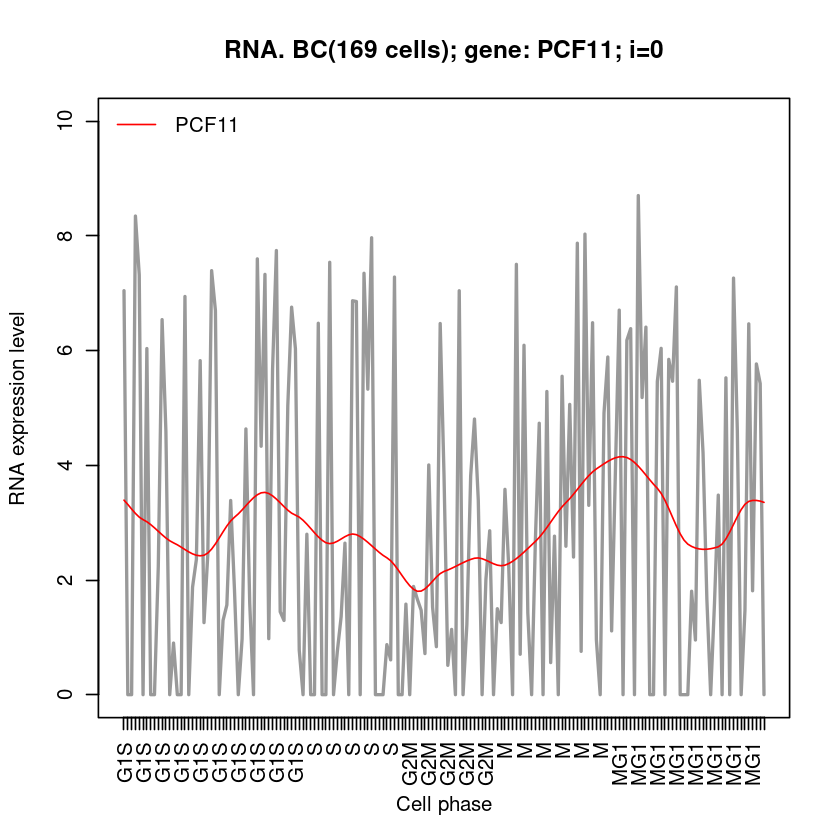

In [1894]:
fn8.addLines=show_cc_RNA2(cellOrder.BC, 'BC', gene='PCF11', lwd=2, ylim=c(0,10))

[1] 25
[1]  25 169


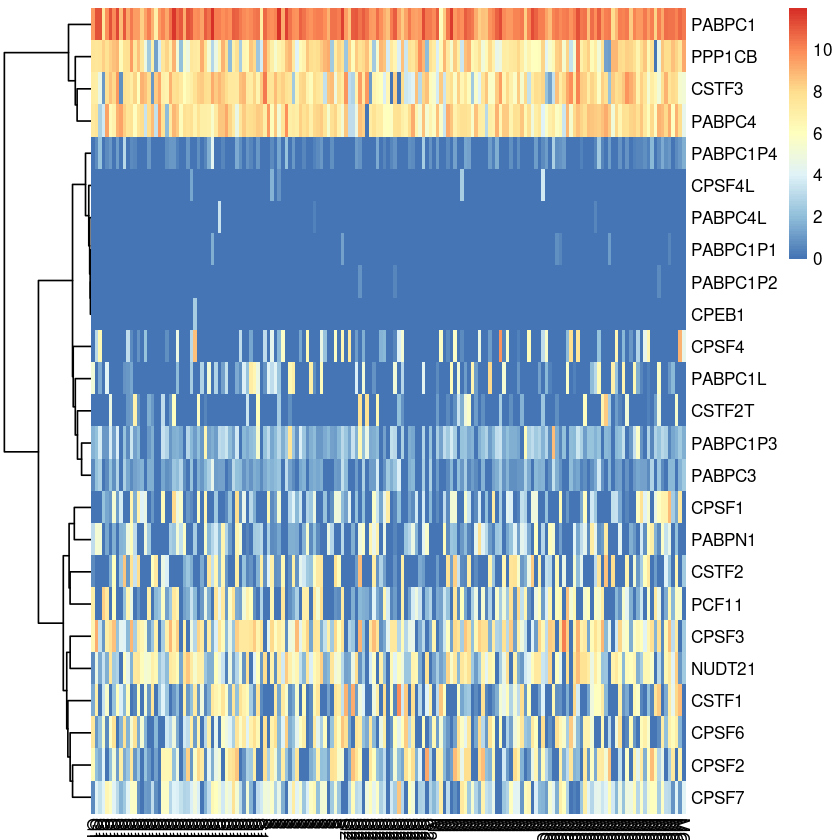

In [1933]:
(function(){
    newOrder=newOrder.BC
    #ph(newOrder)
    info=cellOrder.BC[,c(1,3,5,7,9,12)]
    #ph(info)
    #
    genes=rownames(rnaM.log2cpm)
    genes1=genes[grep('CPSF', genes)] #"CPSF1"  "CPSF2"  "CPSF3"  "CPSF4"  "CPSF4L" "CPSF6"  "CPSF7" 
    genes2=genes[grep('CSTF', genes)] #"CSTF1"  "CSTF2"  "CSTF2T" "CSTF3" 
    genes3=genes[grep('^PABP', genes)] #"CSTF1"  "CSTF2"  "CSTF2T" "CSTF3" 
    genes4=c('PPP1CB', 'NUDT21', 'PCF11', 'CPEB1')
    #
    geneSet=c(genes1,genes2,genes3,genes4)
    geneSet=unique(geneSet)
    geneSet=geneSet[!(1:length(geneSet) %in% grep('\\-', geneSet) ) ]; # filter out -
    pl(geneSet) #26
    #
    df=rnaM.log2cpm[geneSet, rownames(info)]
    pd(df) #26 169
    pheatmap(df, border_color=NA, #scale="row",
             #cluster_rows = F, 
             clustering_method = "ward.D2",
             cluster_cols = F,
             labels_col =info$assignedPhase
            )
    
})()

[1] 25
[1] 25 56


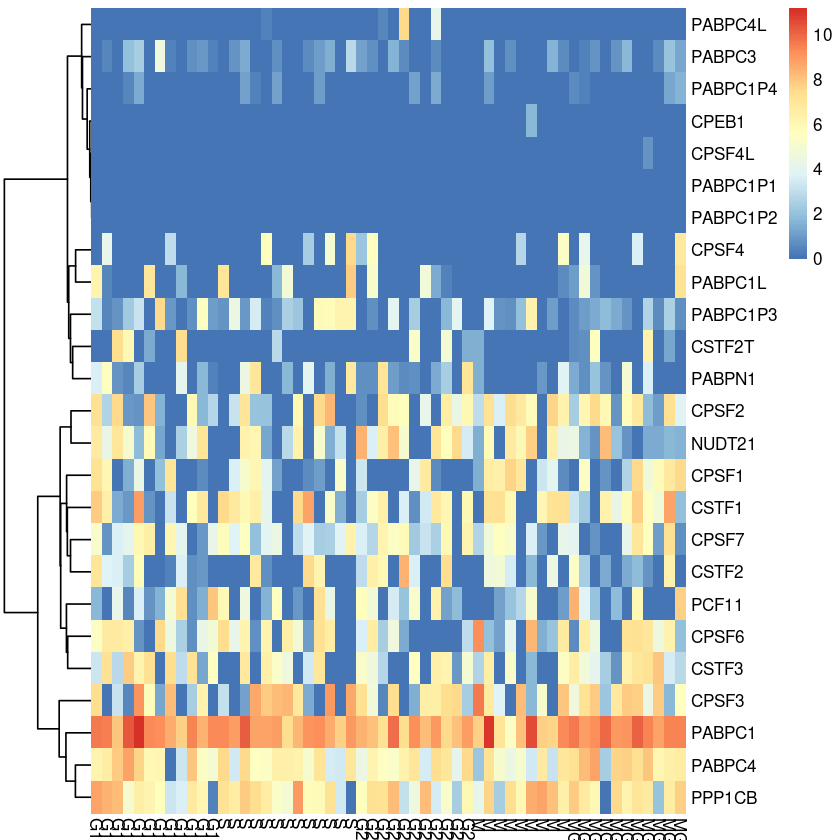

In [1932]:
(function(){
    newOrder=newOrder.HeLa
    #ph(newOrder)
    info=cellOrder.HeLa[,c(1,3,5,7,9,12)]
    #ph(info)
    #
    genes=rownames(rnaM.log2cpm)
    genes1=genes[grep('CPSF', genes)] #"CPSF1"  "CPSF2"  "CPSF3"  "CPSF4"  "CPSF4L" "CPSF6"  "CPSF7" 
    genes2=genes[grep('CSTF', genes)] #"CSTF1"  "CSTF2"  "CSTF2T" "CSTF3" 
    genes3=genes[grep('^PABP', genes)] #"CSTF1"  "CSTF2"  "CSTF2T" "CSTF3" 
    genes4=c('PPP1CB', 'NUDT21', 'PCF11', 'CPEB1')
    #
    geneSet=c(genes1,genes2,genes3,genes4)
    geneSet=unique(geneSet)
    geneSet=geneSet[!(1:length(geneSet) %in% grep('\\-', geneSet) ) ]; # filter out -
    pl(geneSet) #26
    #
    df=rnaM.log2cpm[geneSet, rownames(info)]
    pd(df) #26 169
    pheatmap(df, border_color=NA, #scale="row",
             #cluster_rows = F, 
             clustering_method = "ward.D2",
             cluster_cols = F,
             labels_col =info$assignedPhase
            )
    
})()

#### stemness

[1] 169
[1] 0


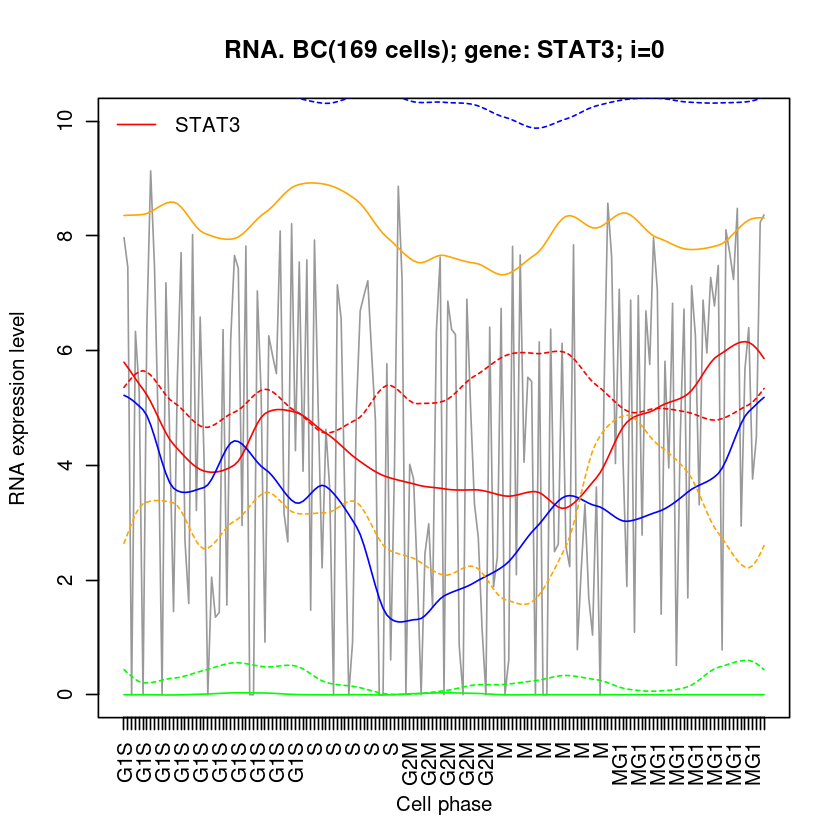

In [1892]:
#
fn8.addLines=show_cc_RNA2(cellOrder.BC, 'BC', gene='STAT3')
fn8.addLines('STAT1','red', lty=2)

fn8.addLines('CNOT4', 'blue')
fn8.addLines('CD44', 'blue', lty=2) #ITGA6  RUNX2

fn8.addLines('EPCAM', 'orange')
fn8.addLines('SOX9','orange',lty=2)

fn8.addLines('GJA1', 'green')
fn8.addLines('ABCG2', 'green', lty=2)

[1] 56
[1] 0


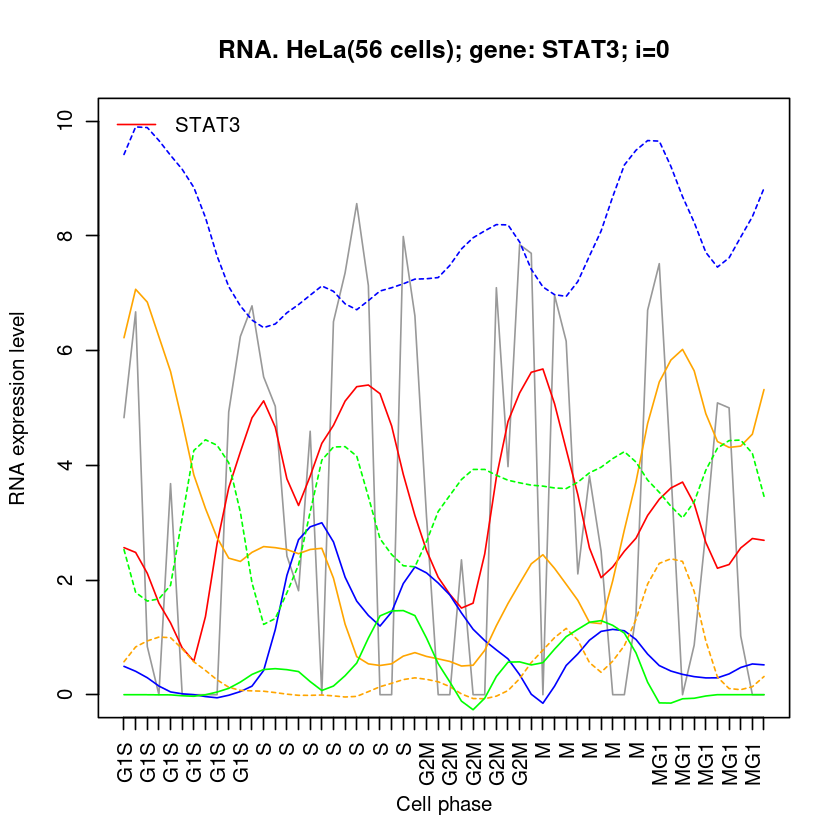

In [1891]:
fn8.addLines=show_cc_RNA2(cellOrder.HeLa, 'HeLa', gene='STAT3')

fn8.addLines('RUNX2', 'blue')
fn8.addLines('CD44', 'blue', lty=2)

fn8.addLines('EPCAM', 'orange')
fn8.addLines('SOX9','orange',lty=2)

fn8.addLines('GJA1', 'green')
fn8.addLines('ABCG2', 'green', lty=2)

#### TP53

[1] 169
[1] 0


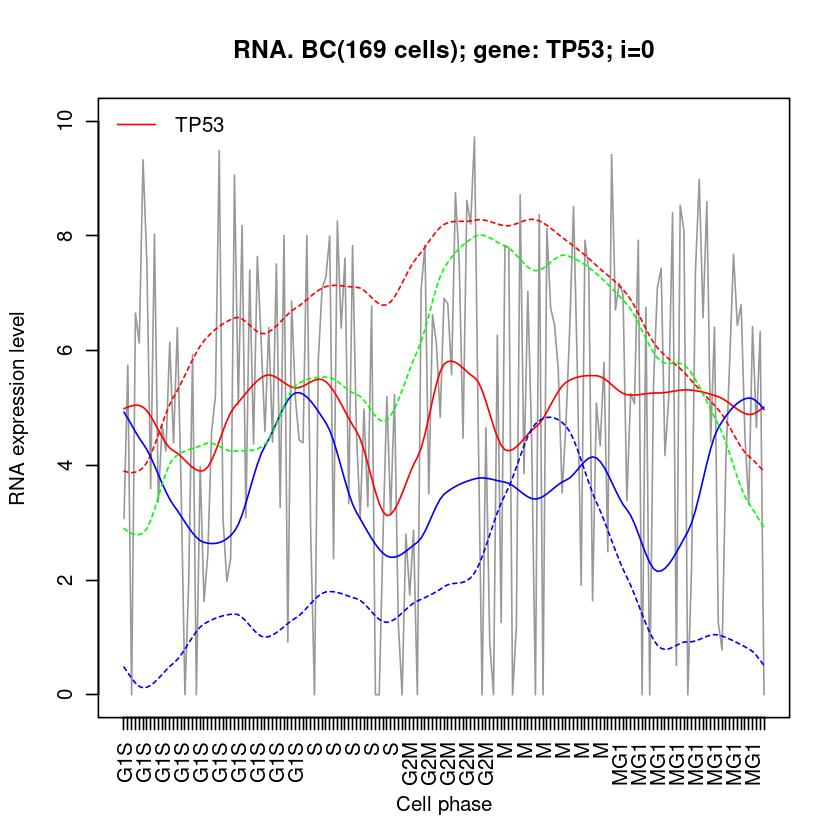

In [1712]:
fn8.addLines=show_cc_RNA2(cellOrder.BC, 'BC', gene='TP53')
fn8.addLines('MKI67','red',lty=2)

fn8.addLines('PTEN','blue')
fn8.addLines('CDC25C','blue',lty=2)

fn8.addLines('CDC20', 'green', lty=2) 

[1] 56
[1] 0


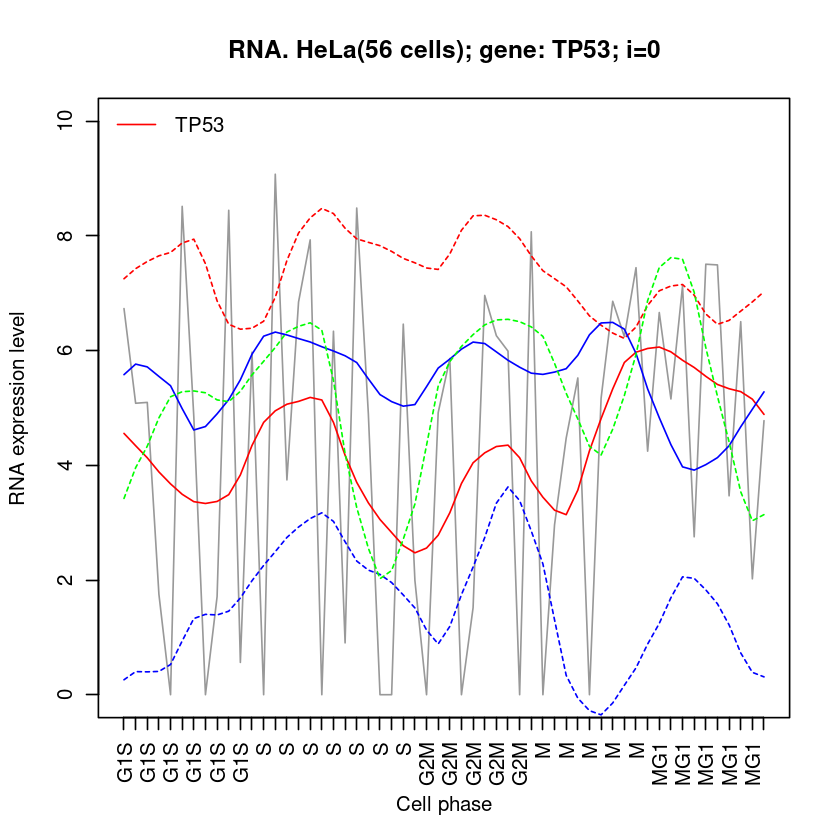

In [1642]:
fn8.addLines=show_cc_RNA2(cellOrder.HeLa, 'HeLa', gene='TP53')
fn8.addLines('MKI67','red',lty=2)

fn8.addLines('PTEN','blue')
fn8.addLines('CDC25C','blue',lty=2)

fn8.addLines('CDC20', 'green', lty=2) 

#### immune

[1] 169
[1] 0


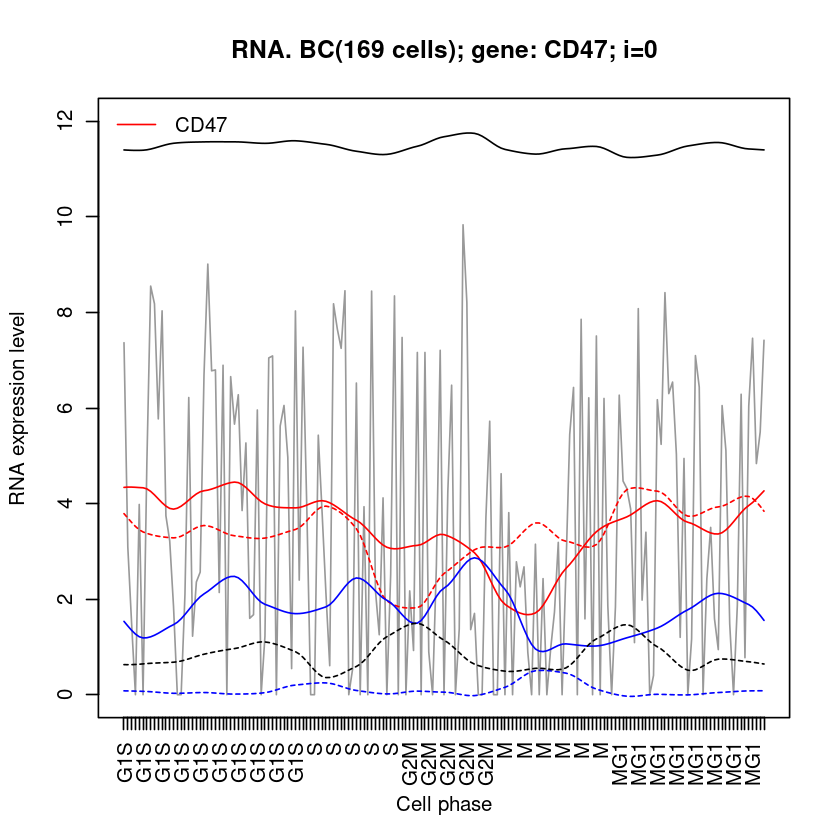

In [1729]:
fn8.addLines=show_cc_RNA2(cellOrder.BC, 'BC', gene='CD47',ylim=c(0,12))
fn8.addLines('HHLA3', 'red', lty=2) #no HHLA2

fn8.addLines('BST2', 'blue')
fn8.addLines('CD274', 'blue',lty=2)# low: CD274

fn8.addLines('GAPDH','black')
fn8.addLines('IFIT3','black',lty=2)

[1] 56
[1] 0


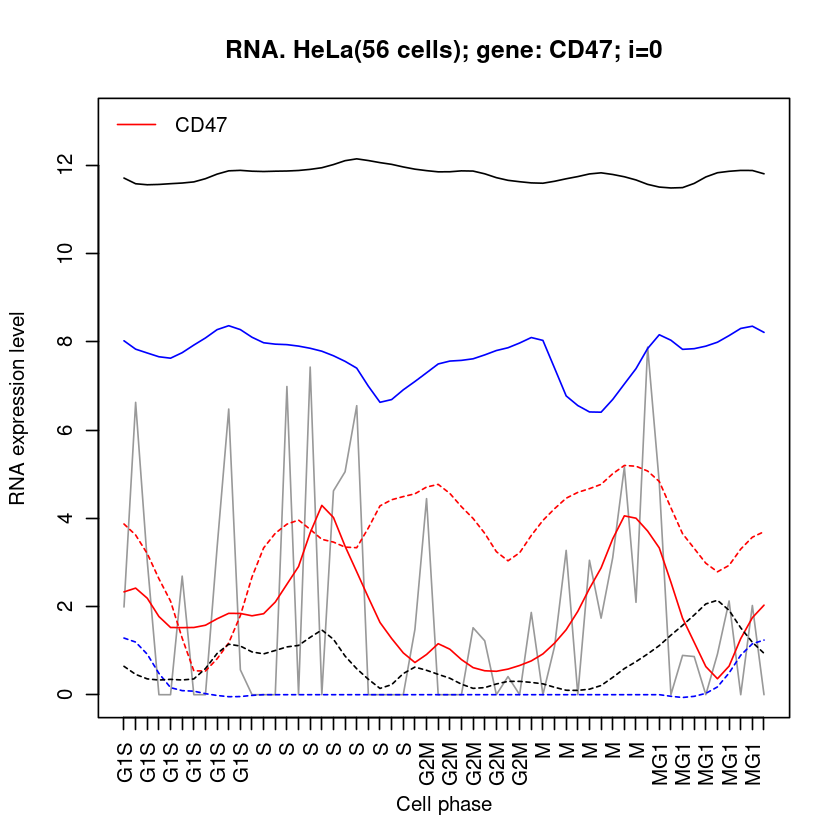

In [1730]:
fn8.addLines=show_cc_RNA2(cellOrder.HeLa, 'HeLa', gene='CD47',ylim=c(0,13))
fn8.addLines('HHLA3', 'red', lty=2) #no HHLA2

fn8.addLines('BST2', 'blue')
fn8.addLines('CD274', 'blue',lty=2)# low: CD274

fn8.addLines('GAPDH','black')
fn8.addLines('IFIT3','black',lty=2)

                cor     gene
BST2      1.0000000     BST2
LGALS3BP  0.5117567 LGALS3BP
IFNAR2    0.4725204   IFNAR2
HMGN5     0.4548386    HMGN5
FASN      0.4487550     FASN
FTL       0.4466165      FTL
MLLT6    -0.4415796    MLLT6
NDUFA11   0.4367054  NDUFA11
YTHDC2   -0.4339674   YTHDC2
HYKK     -0.4320989     HYKK
[1] 56
[1] 0


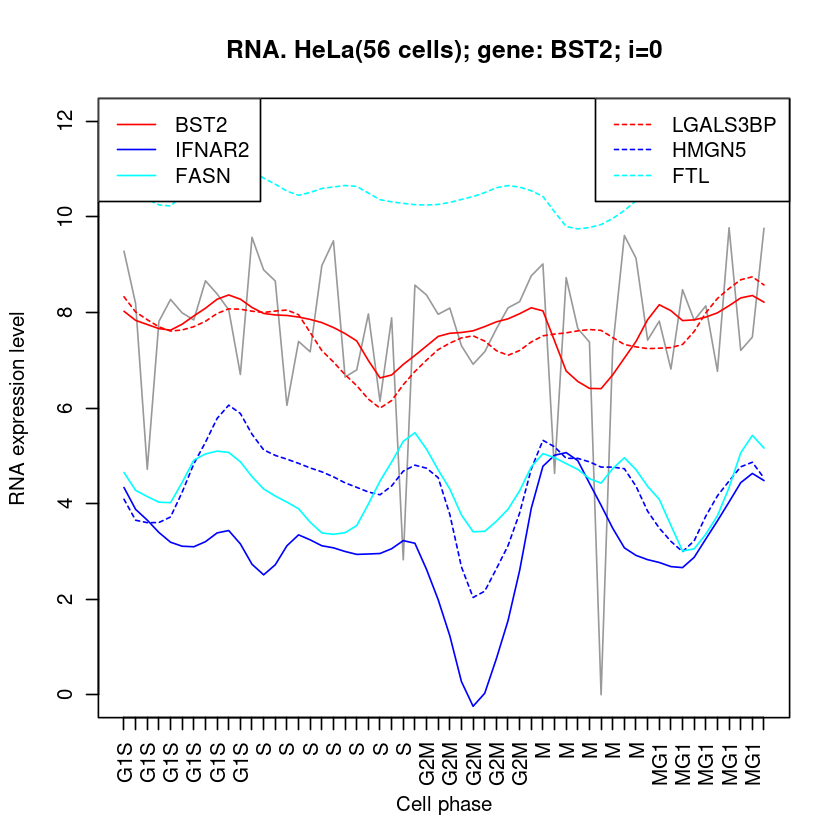

In [1727]:
# 类似表达
x=showCoTranscriptedGenes('BST2', rnaM.cpm[, cid.HeLa], ylim=c(0,12,1), cellOrder=cellOrder.HeLa, keyword='HeLa')

               cor    gene
BST2     1.0000000    BST2
FAM98A   0.3424405  FAM98A
MTIF3    0.3136192   MTIF3
ADNP     0.2980053    ADNP
NDUFA12  0.2878146 NDUFA12
ACOT13   0.2849727  ACOT13
CYSTM1   0.2821849  CYSTM1
WDR53   -0.2751391   WDR53
CLMP     0.2719258    CLMP
SMARCA4  0.2698276 SMARCA4
[1] 169
[1] 0


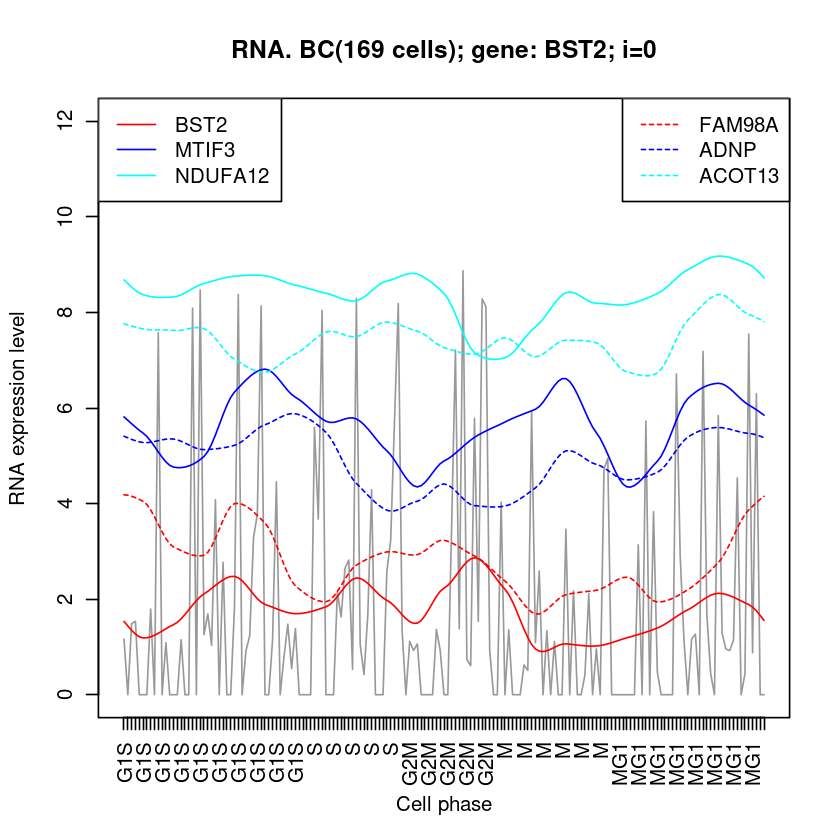

In [1736]:
# 类似表达
x=showCoTranscriptedGenes('BST2', rnaM.cpm[, cid.BC], ylim=c(0,12,1), method = 'spearman')

In [1737]:
rownames(x[x$cor>0.2,])

[1] "BST2"      "FAM98A"    "MTIF3"     "ADNP"      "NDUFA12"   "ACOT13"   
  [7] "CYSTM1"    "CLMP"      "SMARCA4"   "HSP90AA1"  "KIF21B"    "CNPY4"    
 [13] "PARVB"     "BRCA1"     "CEP57L1"   "PCYOX1"    "ZFP28"     "DMAC2"    
 [19] "SLC26A11"  "APOO"      "MED13"     "RIMS3"     "ITGAV"     "MRPS30-DT"
 [25] "CENPB"     "RDH11"     "TCTA"      "NECAP1"    "HM13"      "ATP5PF"   
 [31] "FKBP5"     "APOL2"     "NACA3P"    "NNMT"      "KRBA2"     "SGK1"     
 [37] "SMIM15"    "TTL"       "RIDA"      "C15orf62"  "CBWD3"     "FAF1"     
 [43] "EXOSC1"    "MTDH"      "PURPL"     "SEC22B"    "PANK4"     "DIS3L2"   
 [49] "AGAP1"     "PPP1CC"    "ATP2A2"    "TBC1D17"   "AP2M1"     "GAB1"     
 [55] "IPO4"      "TERF1"     "DGCR6L"    "MED24"     "LCMT2"     "NDUFS6"   
 [61] "ZNF83"     "SETD3"     "RPS27AP2"  "MVP"       "GAPDH"     "RTN3"     
 [67] "NUP133"    "ZER1"      "CEP57L1P1" "ZNF778"    "ATXN7L3"   "LSM3"     
 [73] "PLEKHJ1"   "RABGGTB"   "BAG3"      "MBNL2"     "DNAH2"     "COLCA1"   
 [79] "C5AR1"     "ORMDL2"    "LIMD2"     "RAB6A"     "CNOT3"     "NBAS"     
 [85] "PPARGC1B"  "ALS2CL"    "ATP5ME"    "SH3GLB1"   "STK10"     "CEP152"   
 [91] "ADGRG3"    "ATMIN"     "RBFOX2"    "OAZ1"      "COQ9"      "DDX55"    
 [97] "PAPPA"     "BCL2L2"    "DAG1"      "TRAPPC1"   "ATP5MGP3"  "ATP5MC1"  
[103] "DPY19L1"   "FLOT2"     "MAGEA3"    "MFSD11"    "KIF1B"     "CUL3"     
[109] "ATRAID"    "PDCD2"     "MMGT1"     "REEP4"     "FAM149B1"  "RBM25"    
[115] "PGAP1"     "LRP4-AS1"  "TAF5"      "CNFN"      "HRC"       "TMPRSS12" 
[121] "DHCR24"    "TPRG1"     "ZNF28"     "UBE2L5"    "SH3RF1"    "ITPRIP"   
[127] "ZMIZ2"     "CTDSP1"    "GUCY1B1"   "ZNF536"    "CBLC"      "GLB1"     
[133] "F2RL1"     "PLAC8L1"   "HSBP1"     "XPO7"      "NMT1"      "MAPKAPK3" 
[139] "C1QBP"     "THAP1"     "POLR3GL"

              cor    gene
CD47    1.0000000    CD47
DIAPH1  0.3852034  DIAPH1
NAB1    0.3296805    NAB1
GALNT11 0.3232655 GALNT11
MRTFA   0.3133133   MRTFA
PAK4    0.3121544    PAK4
PER3    0.3083057    PER3
KMO     0.3065572     KMO
IL6ST   0.3058670   IL6ST
MBNL2   0.3057198   MBNL2
[1] 169
[1] 0


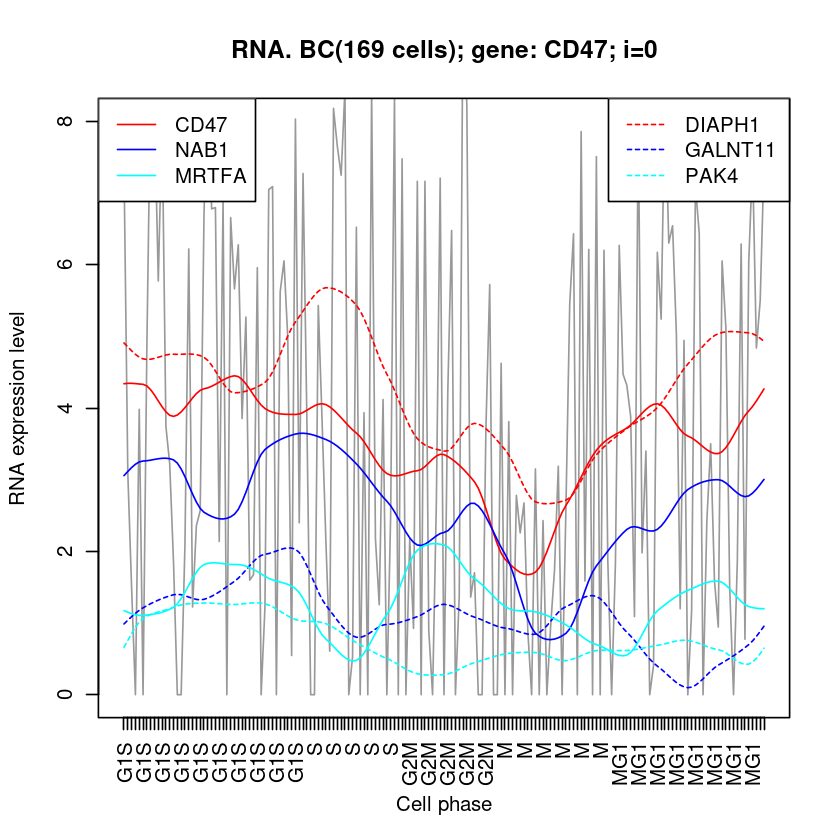

In [1845]:
# 类似表达
x=showCoTranscriptedGenes('CD47', rnaM.log2cpm[, cid.BC], ylim=c(0,8,1))

              cor    gene
HHLA3   1.0000000   HHLA3
HBP1    0.3599849    HBP1
PHLDB2  0.3388053  PHLDB2
RABGAP1 0.3282774 RABGAP1
SLC35D2 0.3282668 SLC35D2
SMARCA5 0.3230514 SMARCA5
PAM     0.3147355     PAM
EGFR    0.3084412    EGFR
DHX57   0.3043200   DHX57
COG5    0.3023239    COG5
[1] 169
[1] 0


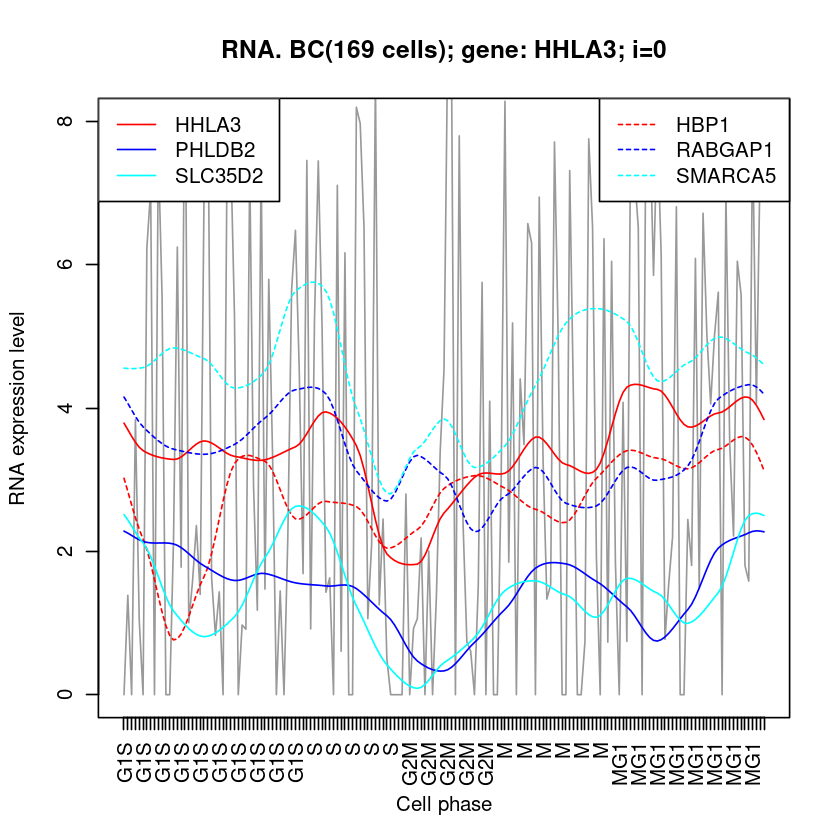

In [1846]:
# 类似表达
x=showCoTranscriptedGenes('HHLA3', rnaM.log2cpm[, cid.BC], ylim=c(0,8,1))

#### TF

[1] 169
[1] 0


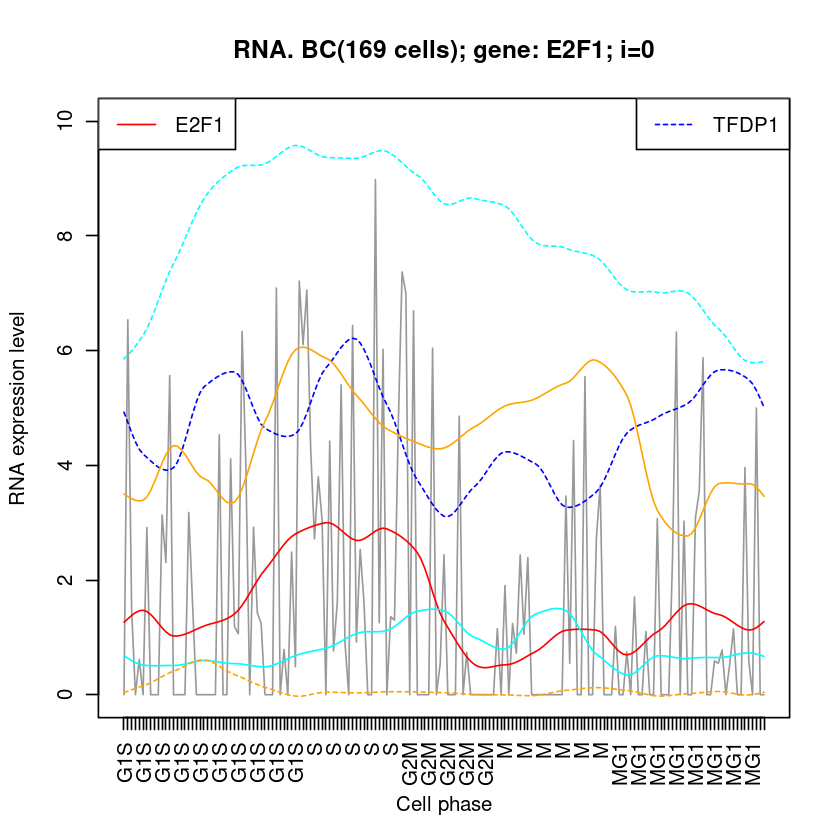

In [1485]:
fn8.addLines=show_cc_RNA2(cellOrder.BC, 'BC', gene='E2F1')
fn8.addLines('TFDP1', 'blue', lty=2)
legend('topright', lty=2, col='blue', legend="TFDP1")
#
fn8.addLines('H2AFX', 'cyan') #组蛋白
fn8.addLines('HIST1H4C', 'cyan', lty=2) #组蛋白

fn8.addLines('CTCF', 'orange')
fn8.addLines('GATA2', 'orange', lty=2)

[1] 56
[1] 0


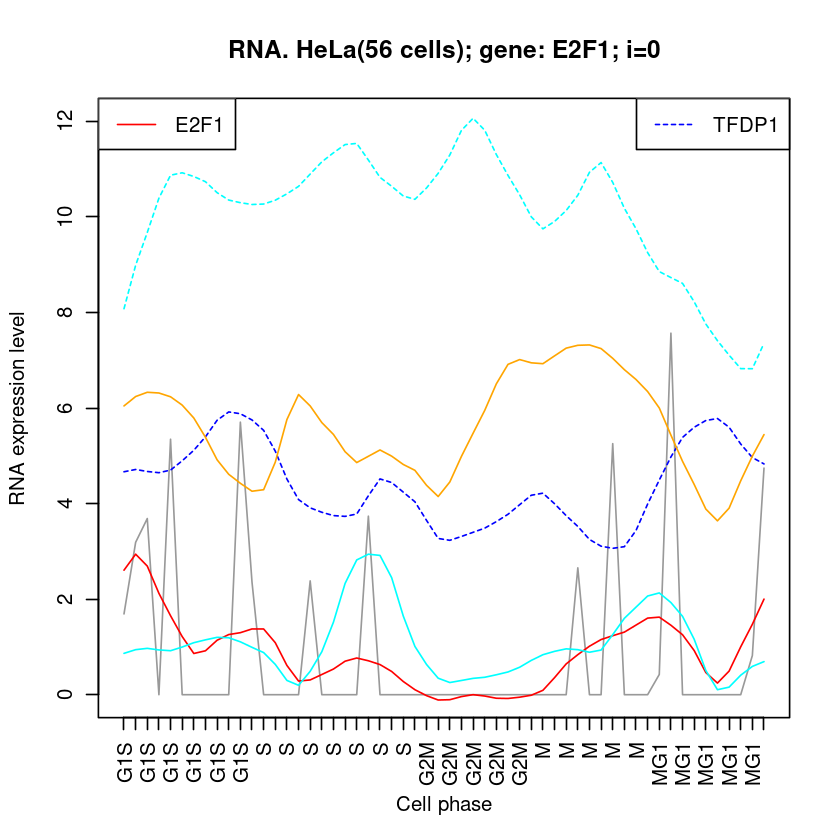

In [1444]:
# HeLa
fn8.addLines=show_cc_RNA2(cellOrder.HeLa, 'HeLa', gene='E2F1', ylim=c(0,12,1))
fn8.addLines('TFDP1', 'blue', lty=2)
legend('topright', lty=2, col='blue', legend="TFDP1")
#
fn8.addLines('H2AFX', 'cyan') #组蛋白
fn8.addLines('HIST1H4C', 'cyan', lty=2) #组蛋白

fn8.addLines('CTCF', 'orange')

[1] 56
[1] 0


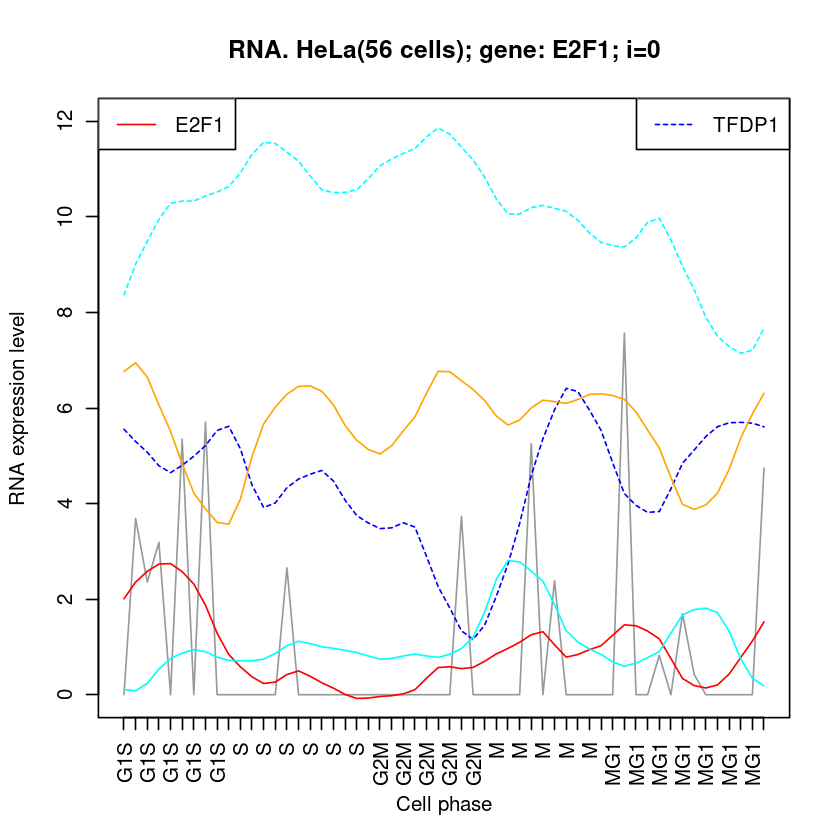

In [1486]:
# HeLa
fn8.addLines=show_cc_RNA2(cellOrder.HeLa.Uni, 'HeLa', gene='E2F1', ylim=c(0,12,1))
fn8.addLines('TFDP1', 'blue', lty=2)
legend('topright', lty=2, col='blue', legend="TFDP1")
#
fn8.addLines('H2AFX', 'cyan') #组蛋白
fn8.addLines('HIST1H4C', 'cyan', lty=2) #组蛋白

fn8.addLines('CTCF', 'orange')

[1] 169
[1] 169
[1] 0


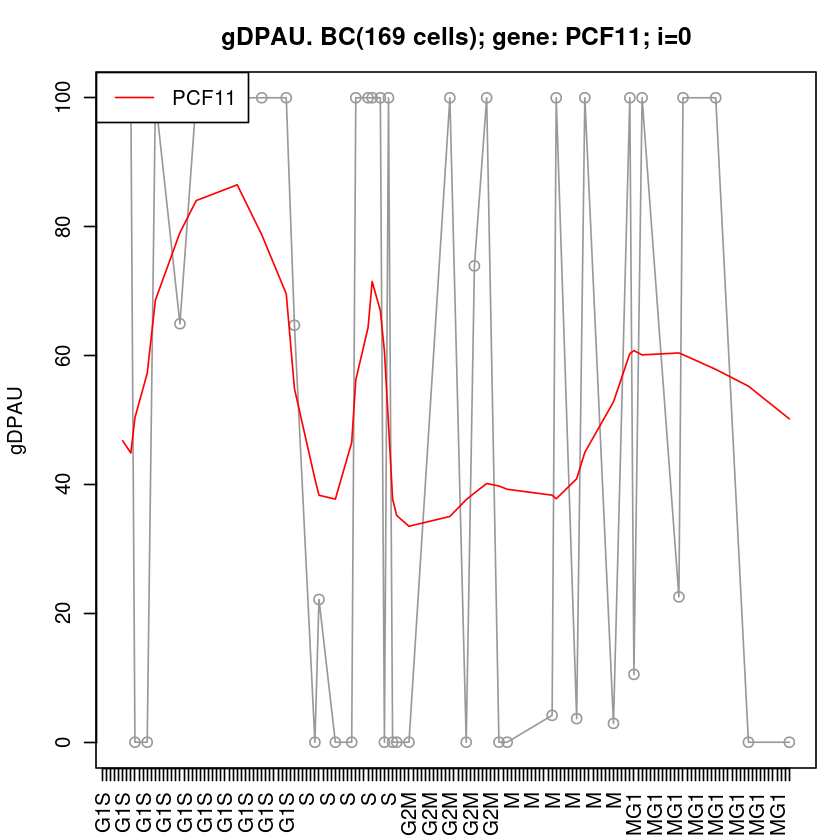

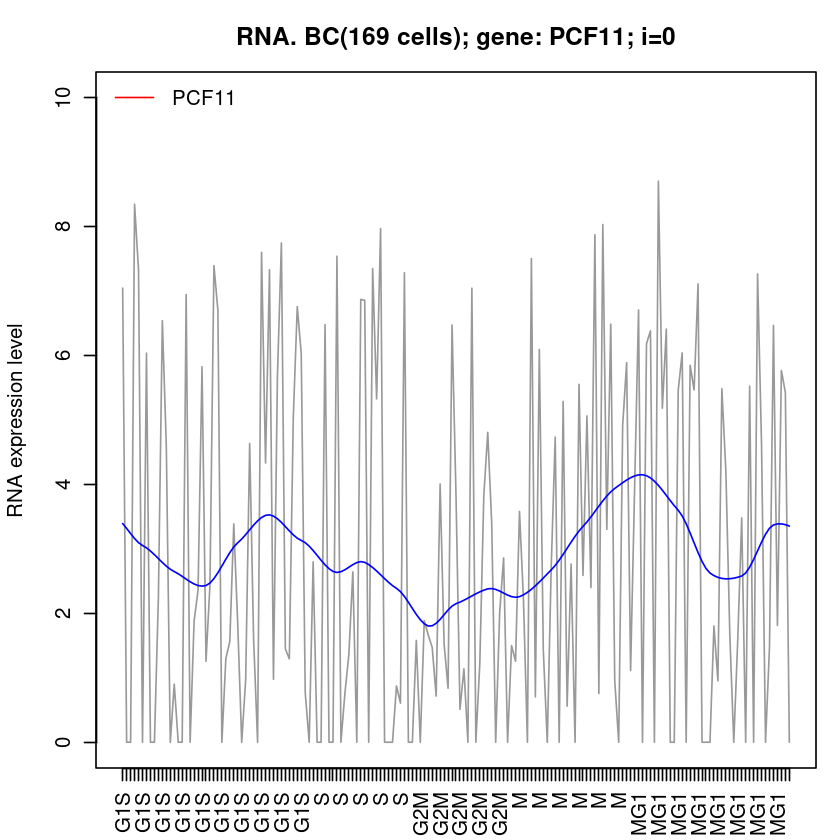

In [1664]:
drawRNA_gDPAU('PCF11')

#### Slit/Robo pathway

In [1014]:
# https://www.ncbi.nlm.nih.gov/pmc/articles/PMC4445861/
rownames(rnaM)[grep('AKT', rownames(rnaM))]

[1] "AKT1"   "AKT1S1" "AKT2"   "AKT3"   "AKTIP"

[1] 169
[1] 0


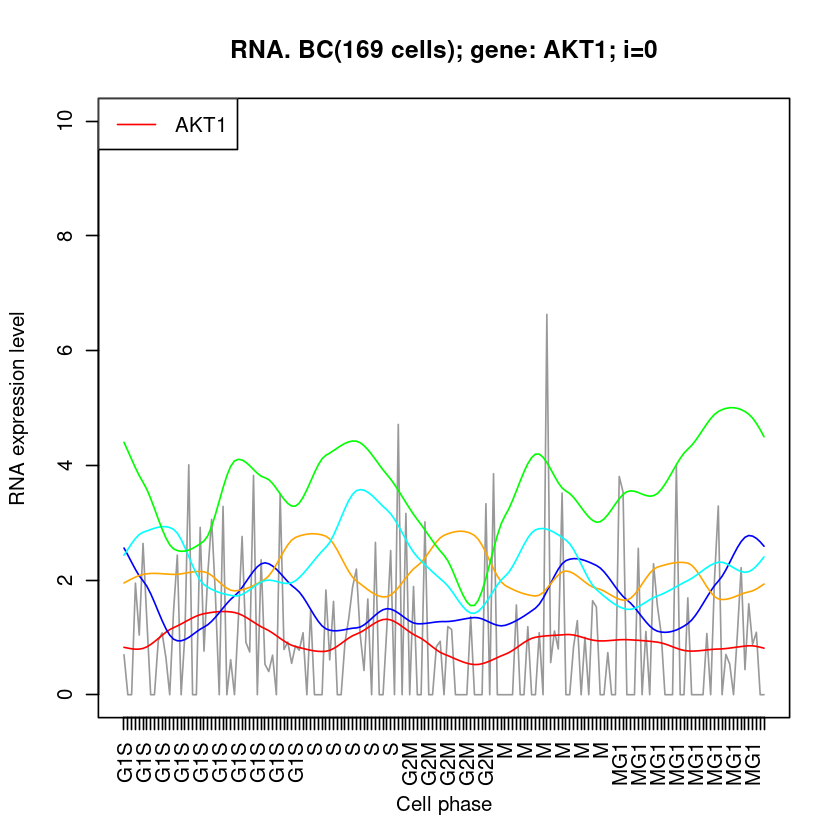

In [1122]:
fn8.addLines=show_cc_RNA2(cellOrder.BC, 'BC', gene='AKT1')
fn8.addLines('AKT1S1', 'blue')
fn8.addLines('AKT2', 'orange')
fn8.addLines('AKT3', 'cyan')
fn8.addLines('AKTIP', 'green')

[1] 169
[1] 0


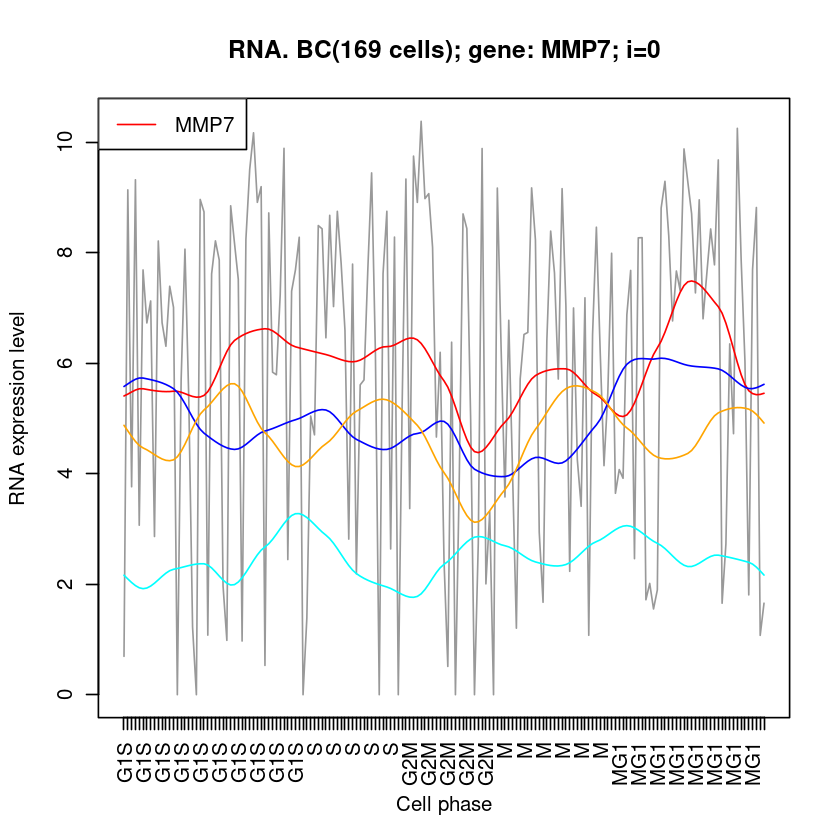

In [1017]:
fn8.addLines=show_cc_RNA2(cellOrder.BC, 'BC', gene='MMP7') #MMP7
fn8.addLines('CDC42', 'blue')
fn8.addLines('GRB2', 'orange')
fn8.addLines('KRAS','cyan')


                 cor      gene
MMP7       1.0000000      MMP7
SLC16A1    0.3128077   SLC16A1
CDPF1      0.3004334     CDPF1
NUP58      0.2930905     NUP58
MUC20-OT1  0.2866439 MUC20-OT1
NDUFA13   -0.2809965   NDUFA13
BCAR3      0.2793236     BCAR3
CRIM1-DT   0.2748876  CRIM1-DT
NUP37      0.2730452     NUP37
SLC1A1     0.2724998    SLC1A1
[1] 169
[1] 0


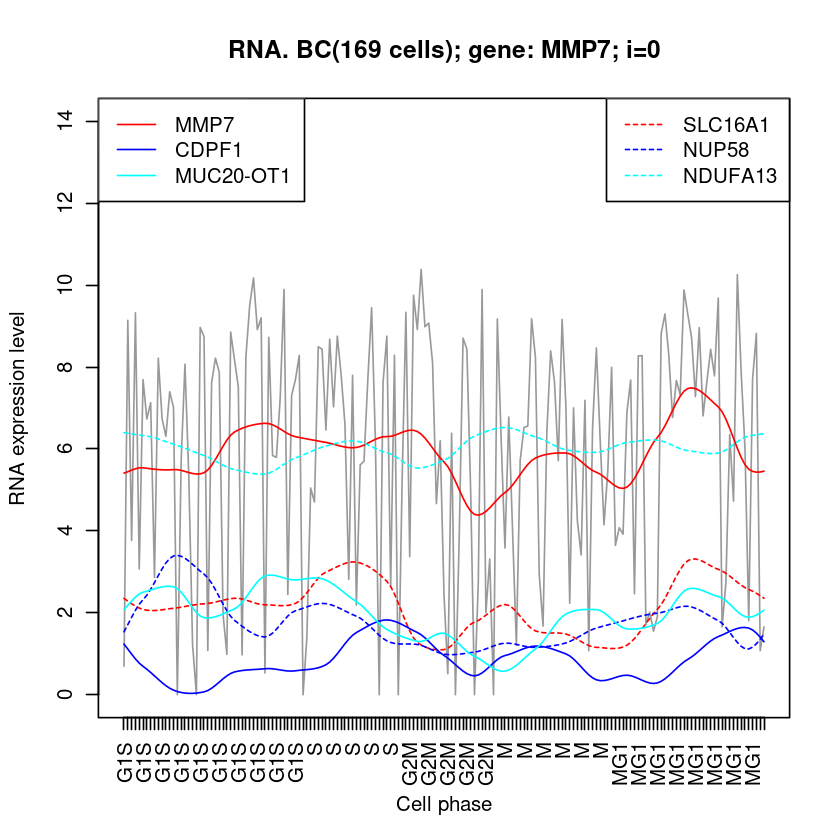

In [1284]:
# 类似表达
x=showCoTranscriptedGenes('MMP7', rnaM.cpm[, cid.BC], ylim=c(0,14,1))

[1] 169
[1] 0


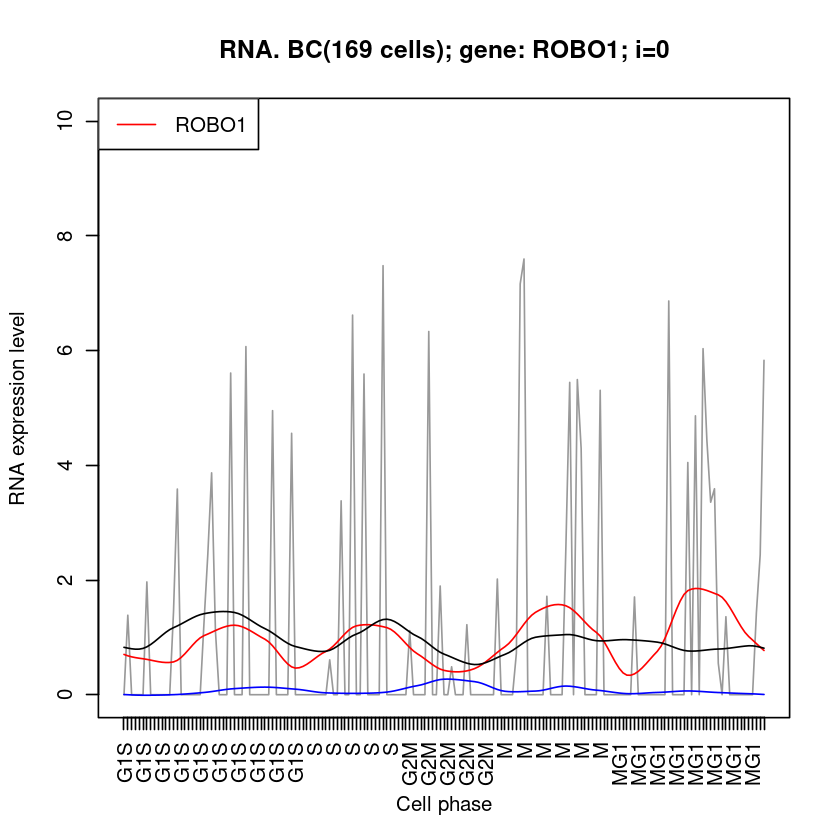

In [1015]:
fn8.addLines=show_cc_RNA2(cellOrder.BC, 'BC', gene='ROBO1')
fn8.addLines('SLIT3','blue') #2 3
fn8.addLines('AKT1','black')

#### ubiquitin 

In [1091]:
rownames(rnaM)[grep('^UB', rownames(rnaM))]

[1] "UBA1"       "UBA2"       "UBA3"       "UBA5"       "UBA52"     
  [6] "UBA52P3"    "UBA52P5"    "UBA52P7"    "UBA52P8"    "UBA6"      
 [11] "UBA6-AS1"   "UBA7"       "UBAC1"      "UBAC2"      "UBAC2-AS1" 
 [16] "UBALD1"     "UBALD2"     "UBAP1"      "UBAP1L"     "UBAP2"     
 [21] "UBAP2L"     "UBASH3A"    "UBASH3B"    "UBB"        "UBBP1"     
 [26] "UBBP2"      "UBBP3"      "UBBP4"      "UBBP5"      "UBC"       
 [31] "UBE2A"      "UBE2B"      "UBE2C"      "UBE2CP1"    "UBE2CP3"   
 [36] "UBE2D1"     "UBE2D2"     "UBE2D3"     "UBE2D3-AS1" "UBE2D3P1"  
 [41] "UBE2D3P2"   "UBE2D4"     "UBE2E1"     "UBE2E2"     "UBE2E3"    
 [46] "UBE2F"      "UBE2G1"     "UBE2G2"     "UBE2H"      "UBE2HP1"   
 [51] "UBE2I"      "UBE2J1"     "UBE2J2"     "UBE2K"      "UBE2L3"    
 [56] "UBE2L4"     "UBE2L5"     "UBE2L6"     "UBE2M"      "UBE2MP1"   
 [61] "UBE2N"      "UBE2NL"     "UBE2NP1"    "UBE2O"      "UBE2Q1"    
 [66] "UBE2Q2"     "UBE2Q2P1"   "UBE2Q2P2"   "UBE2R2"     "UBE2S"     
 [71] "UBE2SP1"    "UBE2SP2"    "UBE2T"      "UBE2V1"     "UBE2V1P1"  
 [76] "UBE2V1P14"  "UBE2V1P2"   "UBE2V2"     "UBE2V2P1"   "UBE2V2P3"  
 [81] "UBE2V2P4"   "UBE2W"      "UBE2WP1"    "UBE2Z"      "UBE3A"     
 [86] "UBE3AP2"    "UBE3B"      "UBE3C"      "UBE3D"      "UBE4A"     
 [91] "UBE4B"      "UBFD1"      "UBIAD1"     "UBL3"       "UBL4A"     
 [96] "UBL4B"      "UBL5"       "UBL5P1"     "UBL5P2"     "UBL5P3"    
[101] "UBL5P4"     "UBL7"       "UBL7-AS1"   "UBLCP1"     "UBN1"      
[106] "UBN2"       "UBOX5"      "UBP1"       "UBQLN1"     "UBQLN2"    
[111] "UBQLN4"     "UBR1"       "UBR2"       "UBR3"       "UBR4"      
[116] "UBR5"       "UBR5-AS1"   "UBR7"       "UBTD1"      "UBTD2"     
[121] "UBTF"       "UBTFL8"     "UBTFL9"     "UBXN1"      "UBXN11"    
[126] "UBXN2A"     "UBXN2B"     "UBXN4"      "UBXN6"      "UBXN7"     
[131] "UBXN8"

In [1102]:
# order by sd(RNA)
(function(){
    dtM=rnaM.log2cpm;
    genes=rownames(rnaM)[grep('^UB', rownames(rnaM))];
    
    df=dtM[genes, cid.BC]
    
    df2=as.data.frame(apply(df, 1, sd))
    colnames(df2)=c('sd')
    df2$gene=rownames(df2)
    #order
    df2=df2[order(-df2$sd),]
    head(df2)
    #
})()

,sd,gene
,<dbl>,<chr>
UBE2C,3.210631,UBE2C
UBLCP1,2.963087,UBLCP1
UBE2F,2.944850,UBE2F
UBAC2,2.942561,UBAC2
UBE2Z,2.927832,UBE2Z
UBE2G1,2.925850,UBE2G1


[1] 169
[1] 0


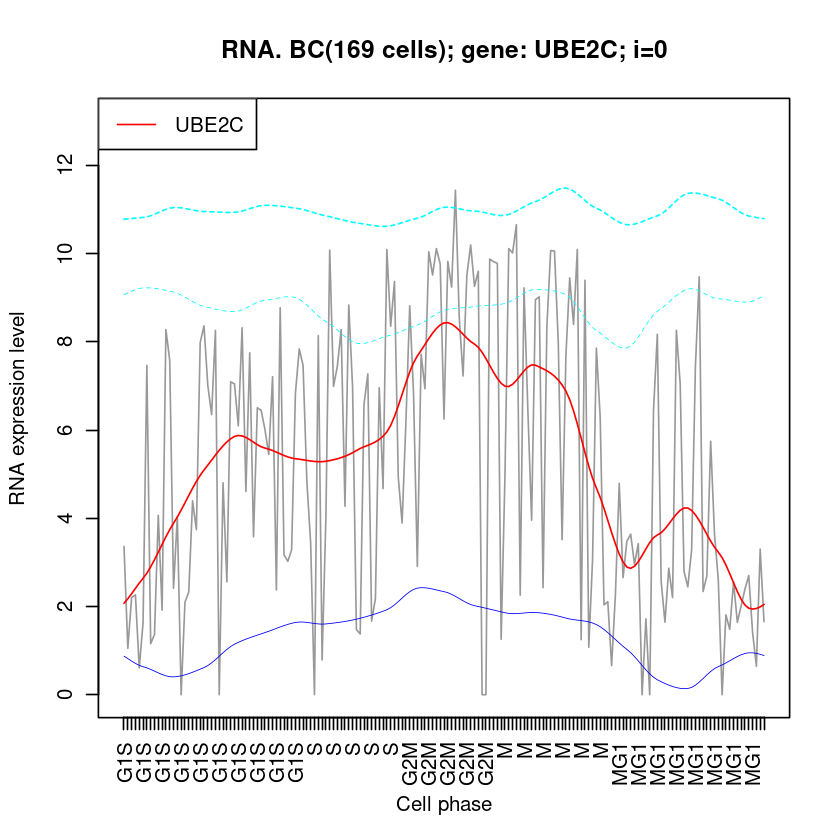

In [1117]:
fn8.addLines=show_cc_RNA2(cellOrder.BC, 'BC', gene='UBE2C', ylim=c(0,13,1))
#UBE2C: Acts as an essential factor of the anaphase promoting complex/cyclosome (APC/C), 
# a cell cycle-regulated ubiquitin ligase that controls progression through mitosis.
#  promoting mitotic exit.

#fn8.addLines('UBE2G1', 'red',lty=2)

fn8.addLines('UBB','cyan', lty=2)
fn8.addLines('UBC','cyan', lty=2, lwd=0.5)
#
fn8.addLines('BUB1B', 'blue', lwd=0.5)
# The BUBR1 protein helps ensure that each sister chromatid is attached to a spindle microtubule. 
#  If any chromatids remain unattached, the protein prevents cell division.

#fn8.addLines('FOXM1','blue')
#fn8.addLines('STAG2','black', lty=2)

             cor   gene
UBE2C  1.0000000  UBE2C
CDK1   0.6882973   CDK1
TOP2A  0.6632359  TOP2A
ANLN   0.6253205   ANLN
NDC80  0.5966238  NDC80
HJURP  0.5961073  HJURP
RRM2   0.5874076   RRM2
NUSAP1 0.5837472 NUSAP1
KPNA2  0.5589498  KPNA2
CENPF  0.5517903  CENPF
[1] 169
[1] 0


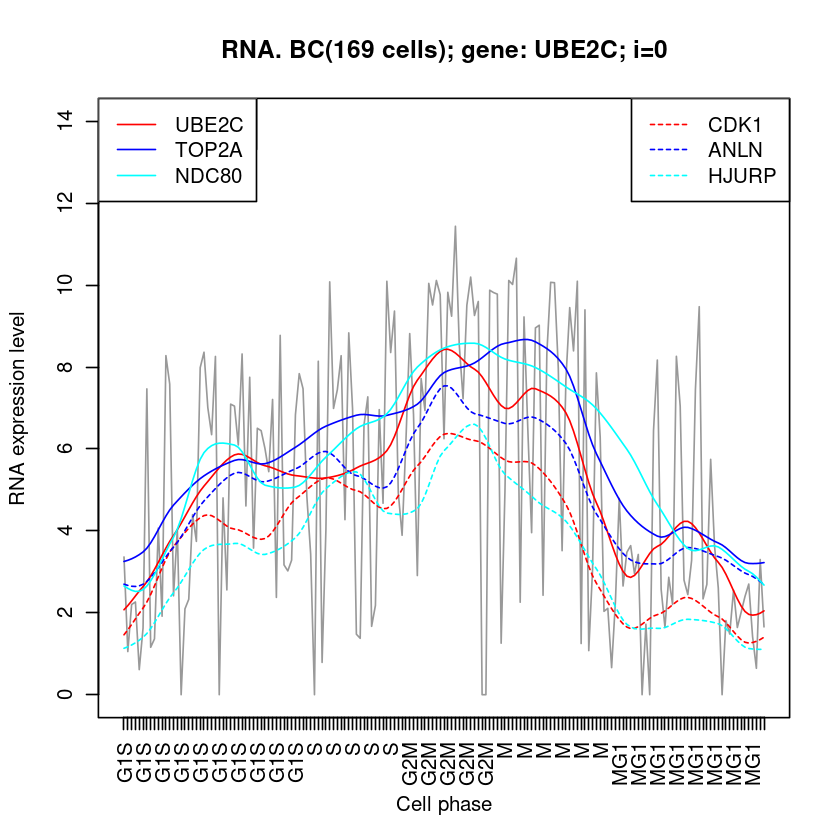

In [1285]:
# 类似表达
x=showCoTranscriptedGenes('UBE2C', rnaM.cpm[, cid.BC], ylim=c(0,14,1))

#### RPS(Ribosomal Protein Sxx)

In [1126]:
# order by sd(RNA)
(function(){
    dtM=rnaM.log2cpm;
    genes=rownames(rnaM)[grep('^RP', rownames(rnaM))];
    
    df=dtM[genes, cid.BC]
    
    df2=as.data.frame(apply(df, 1, sd))
    colnames(df2)=c('sd')
    df2$gene=rownames(df2)
    #order
    df2=df2[order(-df2$sd),]
    head(df2)
    #
})()

,sd,gene
,<dbl>,<chr>
RPA2,3.131834,RPA2
RPUSD3,3.041929,RPUSD3
RPAP2,2.970693,RPAP2
RPP30,2.950164,RPP30
RPP25L,2.889109,RPP25L
RPF1,2.886848,RPF1


[1] 169
[1] 0


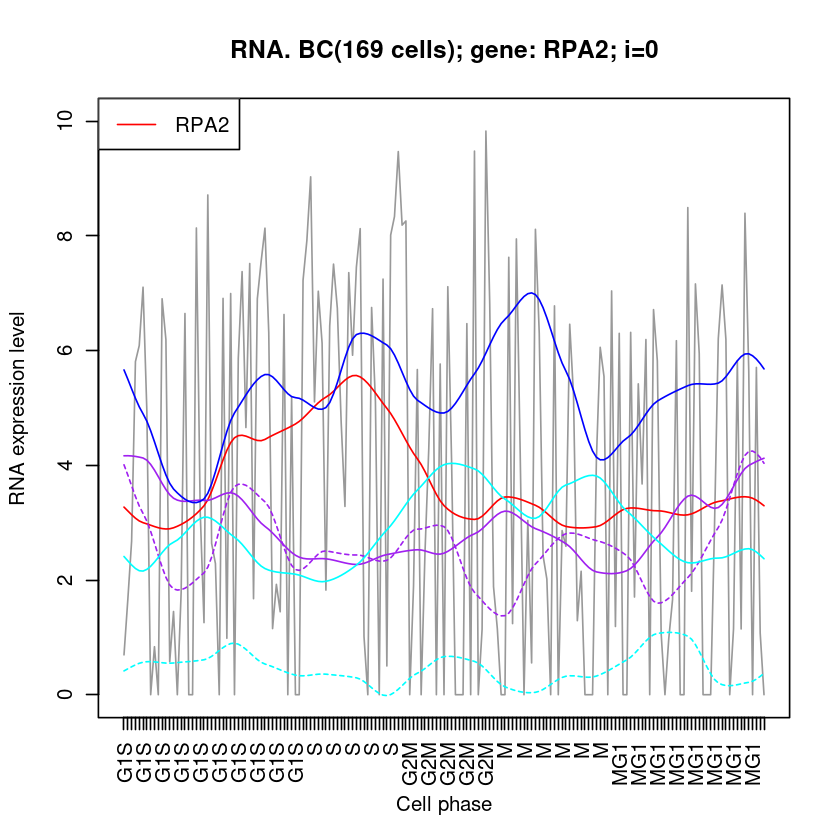

In [1136]:
fn8.addLines=show_cc_RNA2(cellOrder.BC, 'BC', gene='RPA2', ylim=c(0,10,1))
# Replication Protein A2: becoming phosphorylated at the G1-S transition and dephosphorylated in late mitosis.

fn8.addLines('RPUSD3','purple')
fn8.addLines('RPAP2','purple', lty=2)
#
fn8.addLines('RPP30', 'blue')
#RPP30: generates mature tRNA molecules by cleaving their 5'-ends 
#  Also a component of the MRP ribonuclease complex, which cleaves pre-rRNA sequences 

fn8.addLines('FOXM1', 'cyan')
# Transcriptional factor regulating the expression of cell cycle genes essential 
#  for DNA replication and mitosis. Plays a role in the control of cell proliferation. 
#  Plays also a role in DNA breaks repair participating in the DNA damage checkpoint response.

fn8.addLines('FOXO1', 'cyan', lty=2)

####  (NMD)nonsense-mediated mRNA decay 

[1] 169
[1] 0


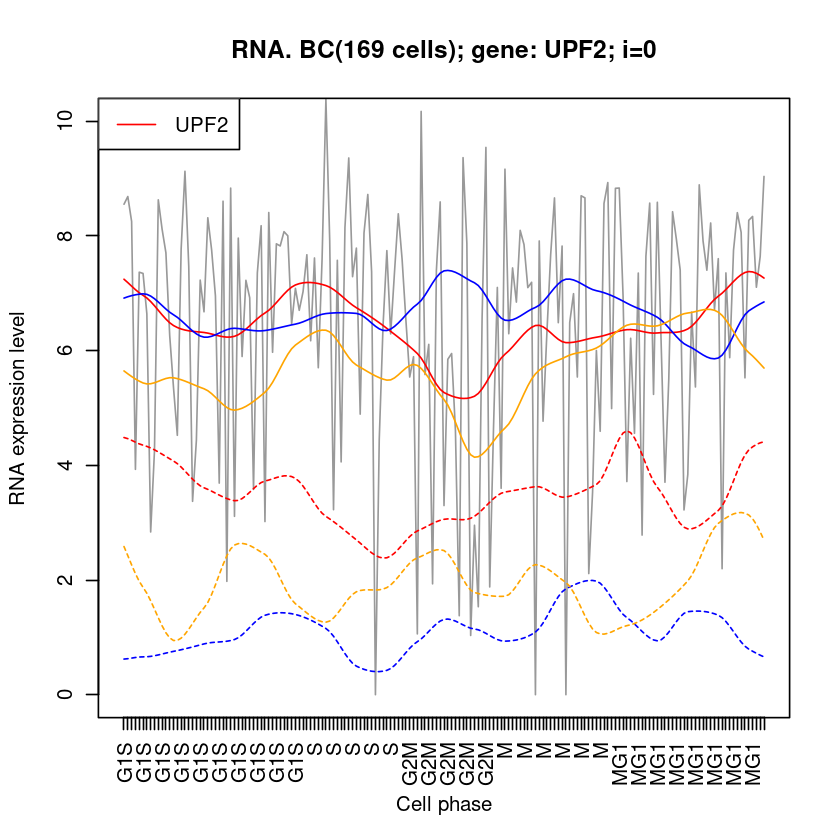

In [1396]:
# 
fn8.addLines=show_cc_RNA2(cellOrder.BC, 'BC', gene='UPF2', ylim=c(0,10,1))
fn8.addLines('UPF1', 'red', lty=2)

fn8.addLines('PTBP1', 'blue')
fn8.addLines('AGGF1', 'blue', lty=2)

fn8.addLines('CDK13', 'orange')
fn8.addLines('CDK12', 'orange', lty=2)

[1] 56
[1] 0


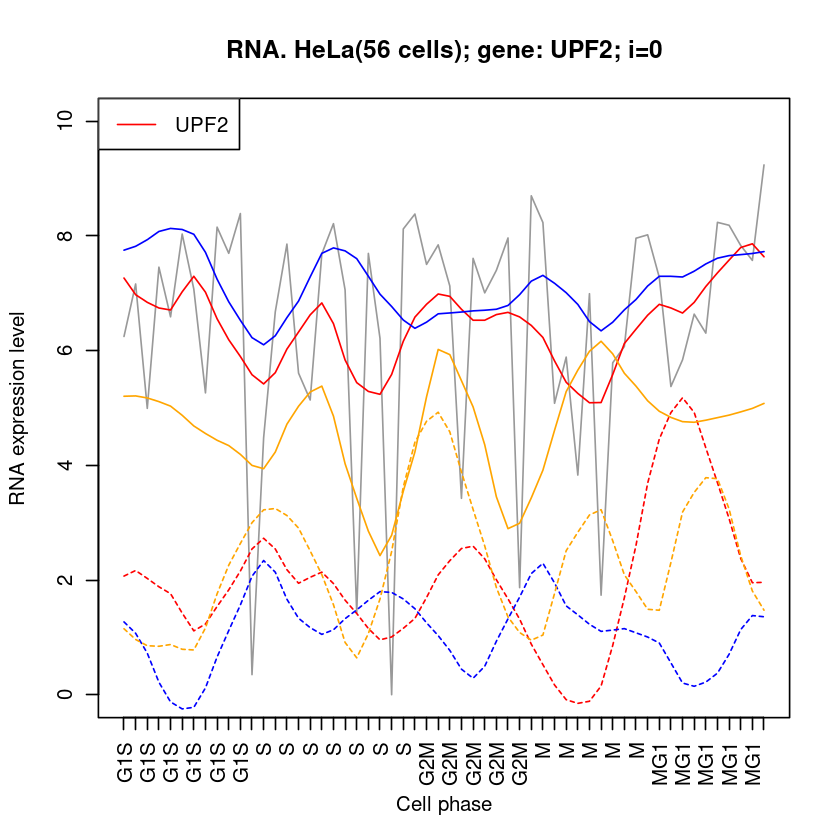

In [1397]:
# in HeLa
fn8.addLines=show_cc_RNA2(cellOrder.HeLa, 'HeLa', gene='UPF2', ylim=c(0,10,1))
fn8.addLines('UPF1', 'red', lty=2)

fn8.addLines('PTBP1', 'blue')
fn8.addLines('AGGF1', 'blue', lty=2)

fn8.addLines('CDK13', 'orange')
fn8.addLines('CDK12', 'orange', lty=2)

#### max CV genes

,cv,gene,mean
,<dbl>,<chr>,<dbl>
KBTBD6,2.238298,KBTBD6,1.013453
ARMCX5,2.191212,ARMCX5,1.057972
EDEM3,2.148976,EDEM3,1.046536
FAM92A,2.143678,FAM92A,1.033236
ANXA9,2.138889,ANXA9,1.014661
TMTC4,2.123074,TMTC4,1.032098


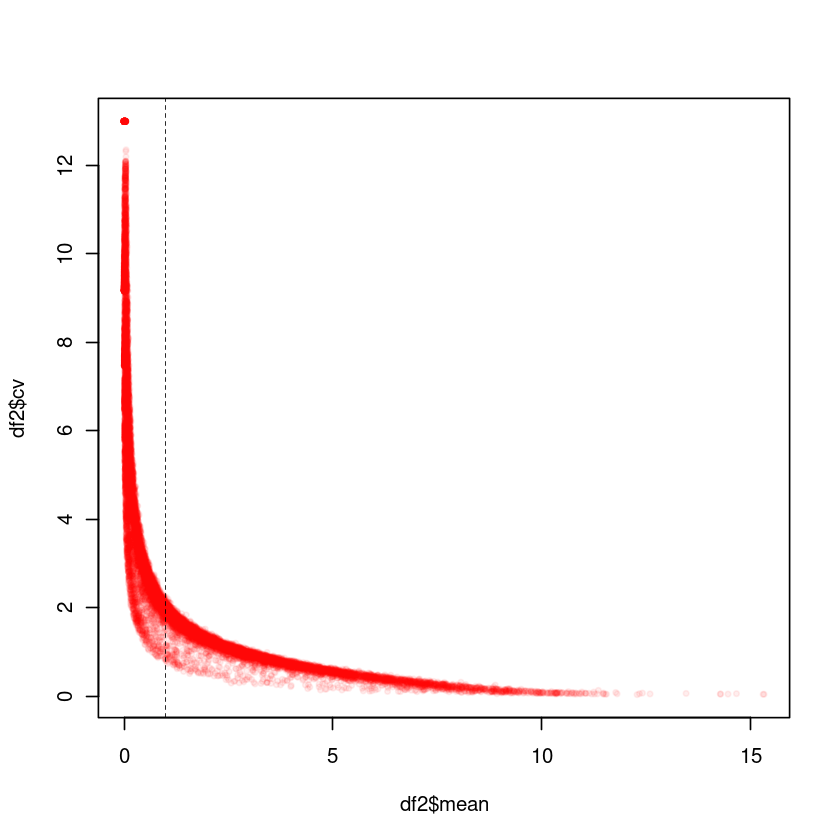

In [1346]:
# order by cv(RNA)
(function(){
    dtM=rnaM.log2cpm;
    genes=rownames(rnaM) # [grep('^RP', rownames(rnaM))];
    
    df=dtM[genes, cid.BC]
    
    df2=as.data.frame(apply(df, 1, function(x){
        sd(x)/mean(x)
    }))
    
    df3=as.data.frame(apply(df, 1, function(x){
        mean(x)
    }))
    
    colnames(df2)=c('cv')
    df2$gene=rownames(df2)
    df2$mean=df3[,1]
    #order
    df2=df2[order(-df2$cv),]
    head(df2, n=20)
    #ggplot(df2, aes(mean, cv))+geom_point()
    plot(df2$mean, df2$cv, pch=19, cex=0.5, col='#FF000011')
    abline(v=1,lty=2, col="black",lwd=0.5)
    #
    head(df2[which(df2$mean>1),])
})()

[1] 169
[1] 0


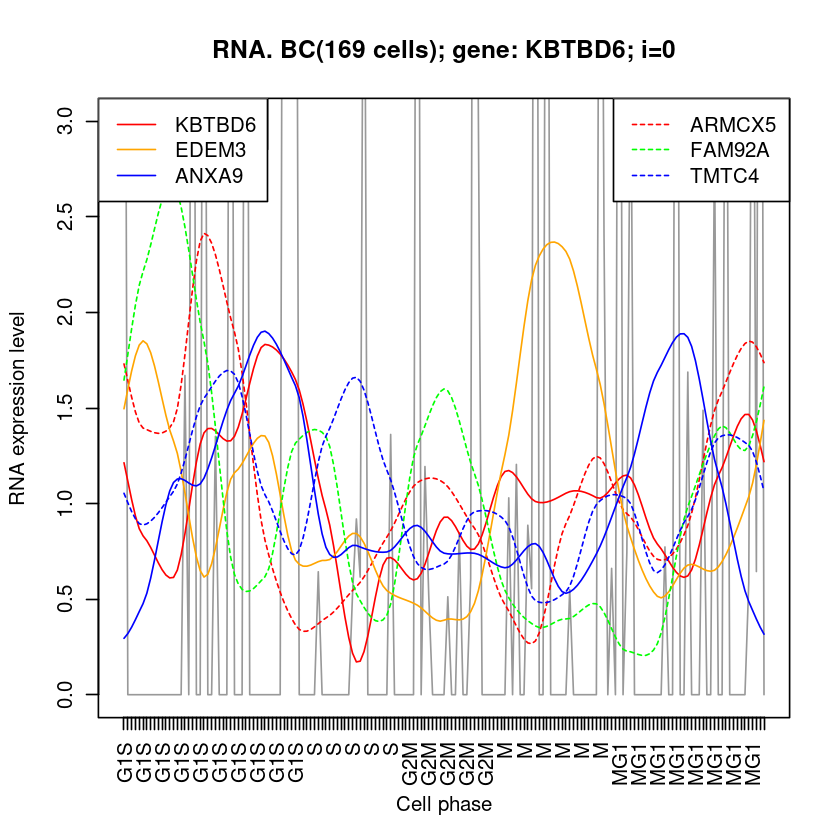

In [1418]:
fn8.addLines=show_cc_RNA2(cellOrder.BC, 'BC', gene='KBTBD6', ylim=c(0,3,1)) #G1S
fn8.addLines('ARMCX5','red', lty=2) #G1S
#
fn8.addLines('EDEM3','orange') #M
fn8.addLines('FAM92A','green', lty=2) #G1S
#
fn8.addLines('ANXA9','blue') #G1S, MG1
fn8.addLines('TMTC4','blue', lty=2) #S
#
legend('topleft', lty=1, col=c('red', 'orange', 'blue'), legend=c('KBTBD6','EDEM3','ANXA9'))
legend('topright', lty=2, col=c('red', 'green', 'blue'), legend=c('ARMCX5','FAM92A','TMTC4'))

#### max log10(max/min) genes

        dynamics    gene     mean
NEAT1   1.166588   NEAT1 7.078121
KRT17   1.155822   KRT17 7.870537
PPM1G   1.127120   PPM1G 7.329347
ID3     1.124690     ID3 6.646459
DMKN    1.121586    DMKN 6.610251
DNAJB1  1.115047  DNAJB1 7.089755
PCBP1   1.114793   PCBP1 6.653716
CTSD    1.113446    CTSD 5.885822
KLK10   1.113235   KLK10 3.556933
TRAM1   1.110610   TRAM1 5.805559
SEPT7   1.110012   SEPT7 8.434606
TXNL4A  1.109384  TXNL4A 6.901638
TUFM    1.109195    TUFM 6.317073
ATF1    1.106401    ATF1 3.030712
PSMD14  1.106257  PSMD14 7.520360
STOML2  1.105673  STOML2 8.501287
PLA2G16 1.105480 PLA2G16 6.732428
NUCKS1  1.105381  NUCKS1 7.011423
HOXC9   1.105038   HOXC9 1.411440
RFC4    1.102975    RFC4 4.782526
[1] 502   3
[1] 3757    3


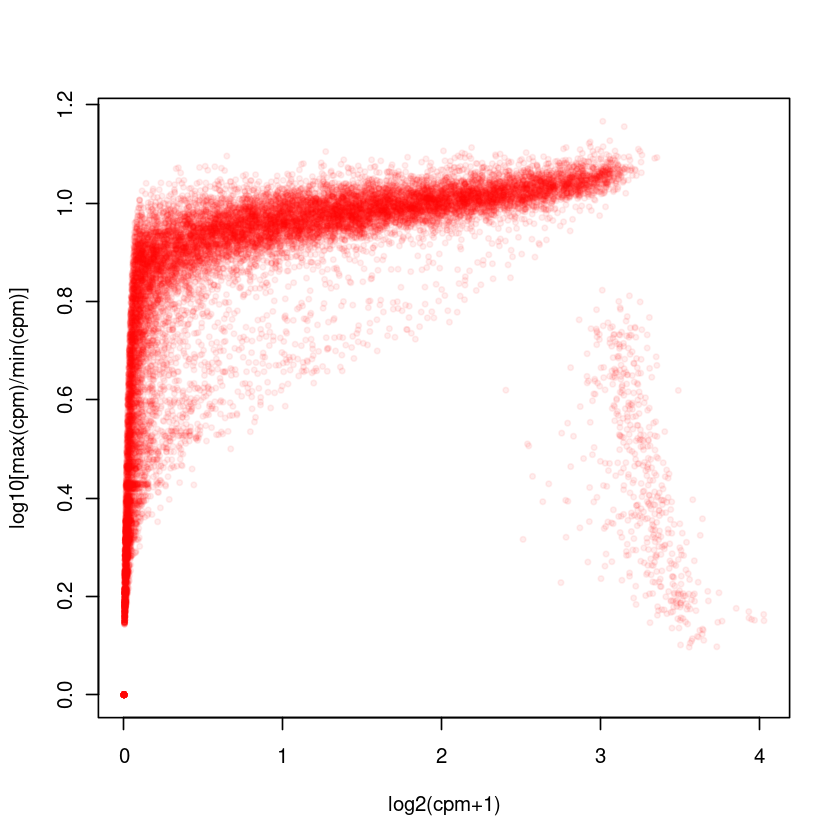

In [1451]:
# order by log10(max/min)
(function(){
    dtM=rnaM.log2cpm;
    genes=rownames(rnaM) # [grep('^RP', rownames(rnaM))];
    
    df=dtM[genes, cid.BC]
    
    df2=as.data.frame(apply(df, 1, function(x){
        log10( (1+max(x))/(1+min(x)) )
    }))
    
    df3=as.data.frame(apply(df, 1, function(x){
        mean(x)
    }))
    
    colnames(df2)=c('dynamics')
    df2$gene=rownames(df2)
    df2$mean=df3[,1]
    #order
    df2=df2[order(-df2$dynamics),]
    ph(df2, n=20)
    #ggplot(df2, aes(mean, cv))+geom_point()
    plot(log2(1+df2$mean), df2$dynamics, pch=19, cex=0.5, col='#FF000011', 
         xlab="log2(cpm+1)", ylab="log10[max(cpm)/min(cpm)]")
    #abline(v=1,lty=2, col="black",lwd=0.5)
    #
    
    ##############
    dt0=df2[which(df2$dynamics<0.8 & log2(1+df2$mean)>2.5),]
    #head(df2[which( log2(1+df2$mean)>3.5),])
    pd(dt0)
    head(dt0)
    #
    writeLines(rownames(dt0), 'RNAhigh_lowDynamic.logMax_min.gene')
    
    ##############
    dt0=df2[which(df2$dynamics>1 & log2(1+df2$mean)>1),]
    #head(df2[which( log2(1+df2$mean)>3.5),])
    pd(dt0)
    head(dt0)
    #
    writeLines(rownames(dt0)[1:200], 'RNAhigh_highDynamic.logMax_min.gene')
})()

In [1448]:
getwd()

[1] "/data/jinwf/wangjl/apa/191111Figure/f3/distalAPA_RNA_5"

[1] 169
[1] 4.441636


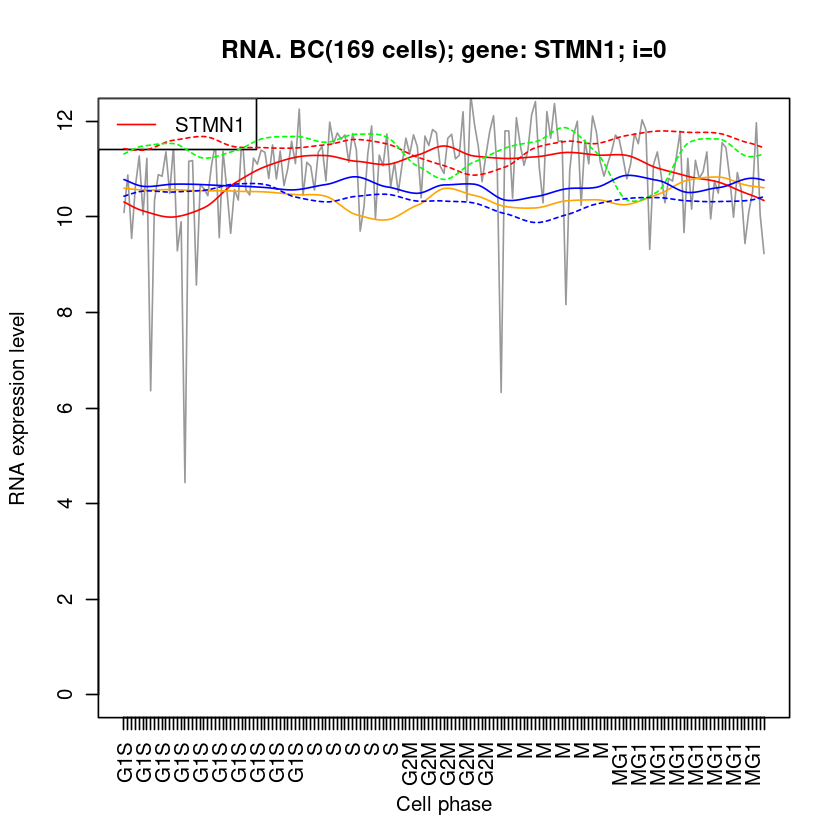

In [1442]:
fn8.addLines=show_cc_RNA2(cellOrder.BC, 'BC', gene='STMN1', 
                          #ylim=c(9.5, 12, 1)
                          ylim=c(0, 12, 1)
                         )
fn8.addLines('SEC61G','red', lty=2)
#
fn8.addLines('KRT18','orange')
fn8.addLines('MGP','green', lty=2)
#
fn8.addLines('ACTG1','blue')
fn8.addLines('CD44','blue', lty=2)
# #
# fn8.addLines('PCBP1', 'cyan') #S
# #
# legend('topleft', lty=1, col=c('red', 'orange', 'blue'), legend=c('NEAT1','PPM1G','DMKN'))
# legend('topright', lty=2, col=c('red', 'green', 'blue'), legend=c('KRT17','ID3','DNAJB1'))

[1] 169
[1] 0


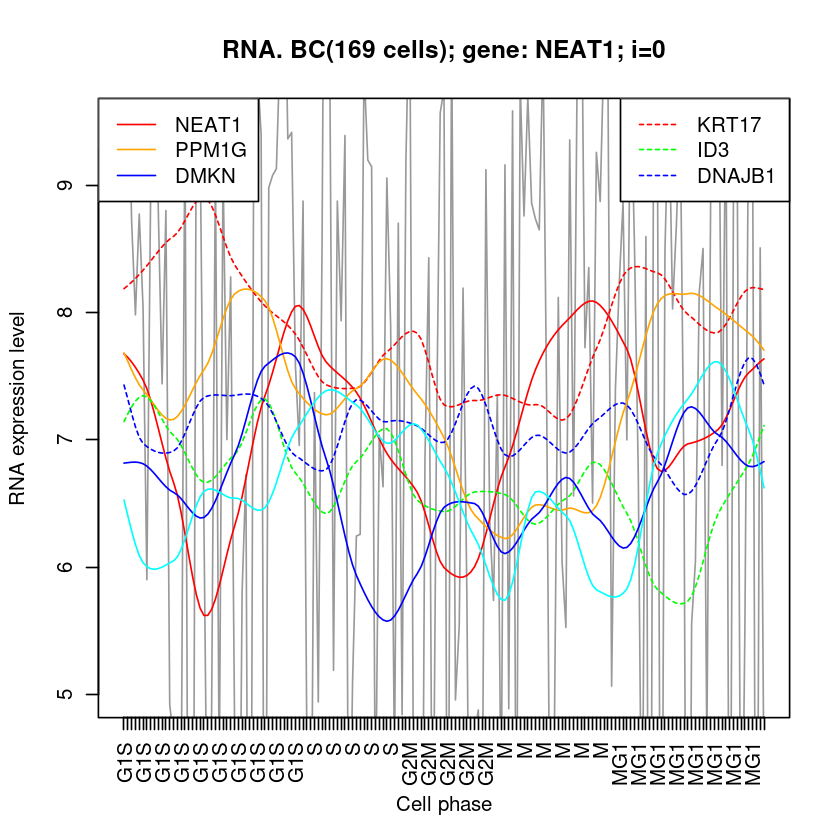

In [1431]:
fn8.addLines=show_cc_RNA2(cellOrder.BC, 'BC', gene='NEAT1', ylim=c(5,9.5,1)) #G1S, M
fn8.addLines('KRT17','red', lty=2) #G1S
#
fn8.addLines('PPM1G','orange') #
fn8.addLines('ID3','green', lty=2) #
#
fn8.addLines('DMKN','blue') #G1S
fn8.addLines('DNAJB1','blue', lty=2)
#
fn8.addLines('PCBP1', 'cyan') #S
#
legend('topleft', lty=1, col=c('red', 'orange', 'blue'), legend=c('NEAT1','PPM1G','DMKN'))
legend('topright', lty=2, col=c('red', 'green', 'blue'), legend=c('KRT17','ID3','DNAJB1'))

#### max sd genes

              sd    gene     mean
LY6D    3.387705    LY6D 3.425550
WRB     3.312288     WRB 3.842286
TMEM219 3.278688 TMEM219 5.319577
FAM111B 3.270828 FAM111B 4.286320
KIF4A   3.265651   KIF4A 4.066371
CDCA8   3.263493   CDCA8 3.772952
DLGAP5  3.259856  DLGAP5 4.175983
ENC1    3.259676    ENC1 3.580746
NUSAP1  3.257483  NUSAP1 4.387980
THUMPD2 3.253564 THUMPD2 3.084658
BARD1   3.252809   BARD1 4.358932
BPGM    3.239759    BPGM 4.667897
CEP70   3.232021   CEP70 3.730888
ACTR6   3.231493   ACTR6 4.071046
TAF9B   3.226947   TAF9B 3.236522
TMEM45A 3.225562 TMEM45A 4.117744
POLD3   3.225184   POLD3 4.535422
CHURC1  3.223417  CHURC1 3.706553
ARID4A  3.220980  ARID4A 4.018212
MAD2L1  3.217863  MAD2L1 3.713715


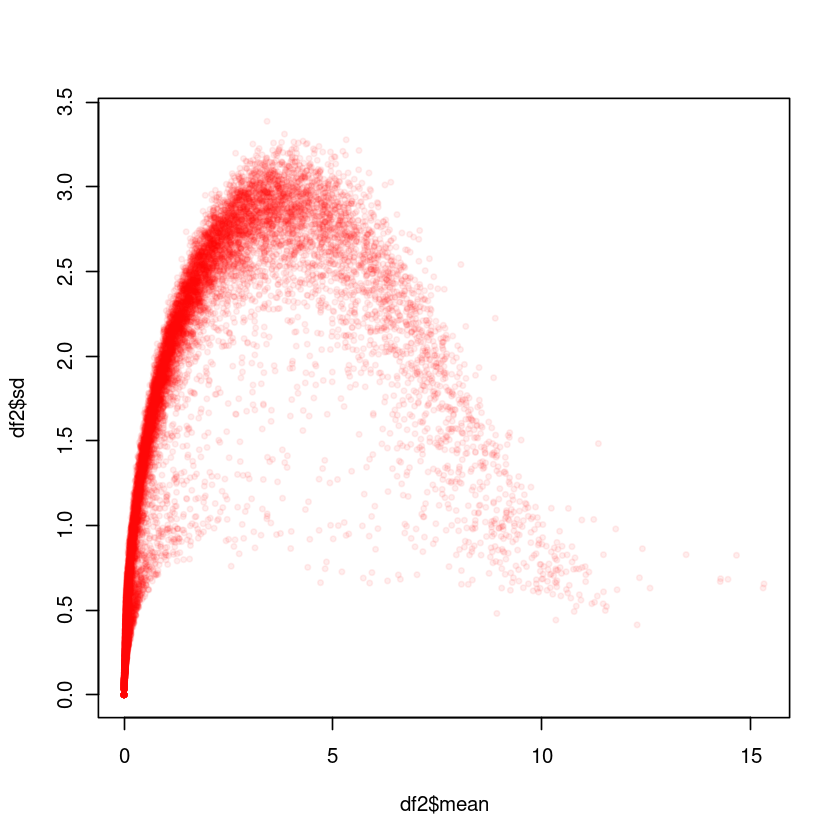

In [1452]:
# order by sd(RNA)
(function(){
    dtM=rnaM.log2cpm;
    genes=rownames(rnaM) # [grep('^RP', rownames(rnaM))];
    
    df=dtM[genes, cid.BC]
    
    df2=as.data.frame(apply(df, 1, sd))
    
    df3=as.data.frame(apply(df, 1, mean))
    colnames(df3)=c('mean')
    
    colnames(df2)=c('sd')
    df2$gene=rownames(df2)
    df2$mean=df3$mean;
    #order
    df2=df2[order(-df2$sd),]
    ph(df2, n=20)
    
    #
    plot(df2$mean, df2$sd, pch=19, cex=0.5, col='#FF000011')
    #abline(v=1,lty=2, col="black",lwd=0.5)
    #
})()

[1] 169
[1] 0


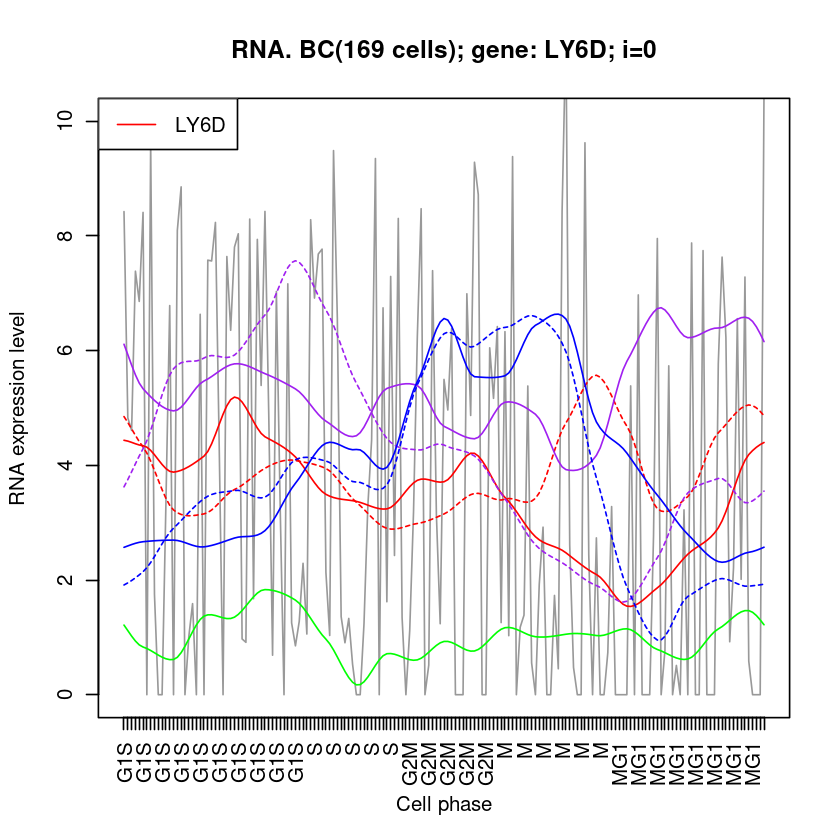

In [1350]:
fn8.addLines=show_cc_RNA2(cellOrder.BC, 'BC', gene='LY6D', ylim=c(0,10,1))
fn8.addLines('WRB','red', lty=2)

fn8.addLines('TMEM219','purple')
# fn8.addLines('IGFBP3', 'black')
fn8.addLines('FAM111B','purple', lty=2)

fn8.addLines('KIF4A','blue')
fn8.addLines('CDCA8','blue', lty=2)

fn8.addLines('KBTBD6', 'green')

               cor     gene
FAM111B  1.0000000  FAM111B
CLSPN    0.3949654    CLSPN
MCM3     0.3881248     MCM3
MCM4     0.3868900     MCM4
E2F1     0.3837461     E2F1
GMNN     0.3730760     GMNN
DTL      0.3653553      DTL
SNX7     0.3344684     SNX7
STIL     0.3329995     STIL
HIST1H4C 0.3290797 HIST1H4C
[1] 169
[1] 0


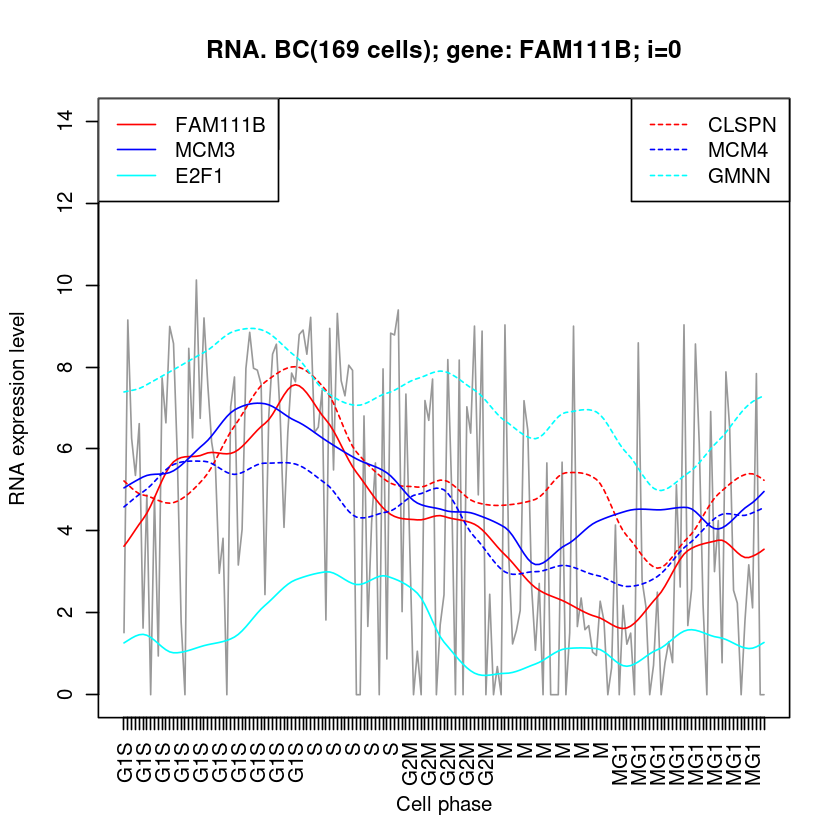

In [1286]:
#fn8.addLines=show_cc_RNA2(cellOrder.BC, 'BC', gene='FAM111B', ylim=c(0,10,1))
# 类似表达
x=showCoTranscriptedGenes('FAM111B', rnaM.cpm[, cid.BC], ylim=c(0,14,1))

             cor   gene
CDCA8  1.0000000  CDCA8
TOP2A  0.5438732  TOP2A
KIF4A  0.5389969  KIF4A
ANLN   0.5224885   ANLN
CDK1   0.5188386   CDK1
UBE2C  0.4738904  UBE2C
KPNA2  0.4522913  KPNA2
CKAP2L 0.4469771 CKAP2L
ECT2   0.4458685   ECT2
HJURP  0.4390180  HJURP
[1] 169
[1] 0


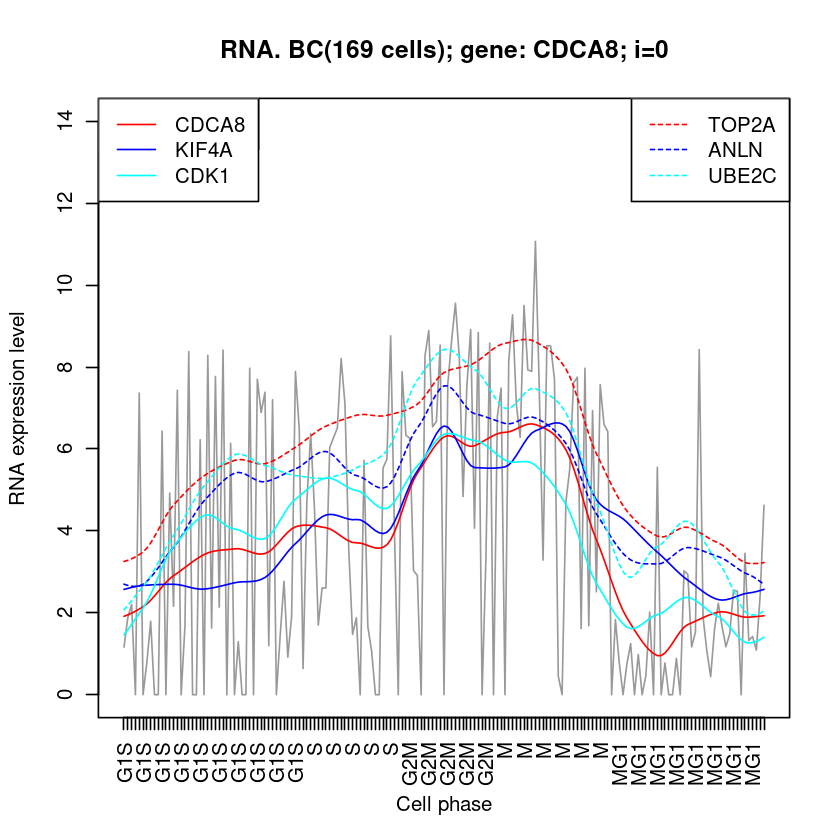

In [1288]:
# 类似表达
x=showCoTranscriptedGenes('CDCA8', rnaM.cpm[, cid.BC], ylim=c(0,14,1))

[1] 169
[1] 0


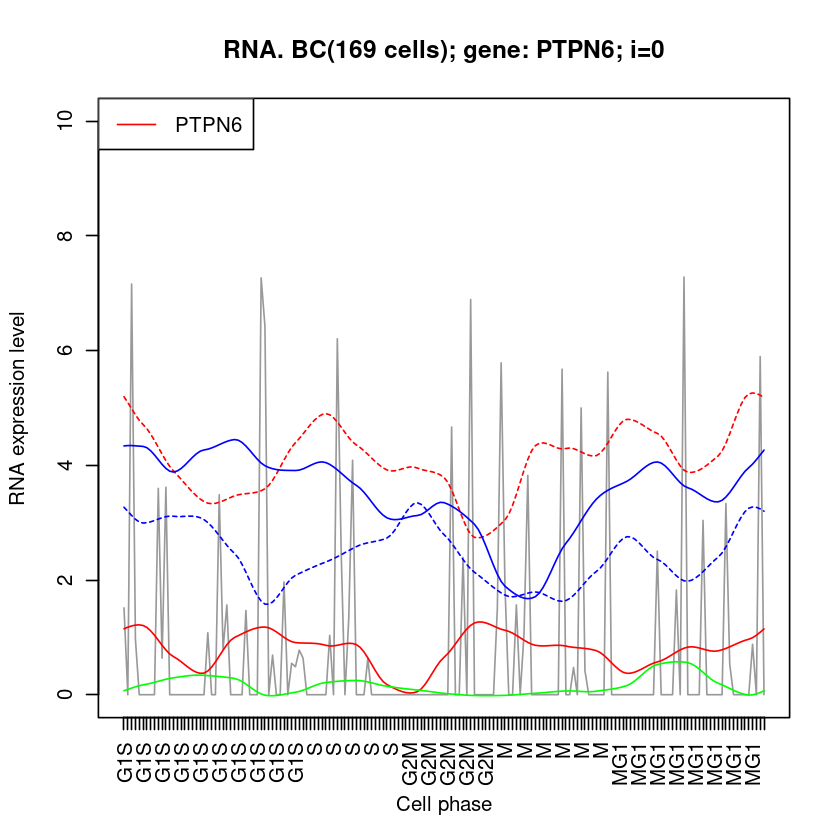

In [1473]:
fn8.addLines=show_cc_RNA2(cellOrder.BC, 'BC', gene='PTPN6',to1=F, ylim=c(0,10,1))
fn8.addLines('PTPN11','red', lty=2)

fn8.addLines('VSIR','blue', lty=2)

#微量 CD274

fn8.addLines('CD47','blue')
fn8.addLines('SIRPA','green')

              cor    gene
CD47    1.0000000    CD47
DIAPH1  0.3852034  DIAPH1
NAB1    0.3296805    NAB1
GALNT11 0.3232655 GALNT11
MRTFA   0.3133133   MRTFA
PAK4    0.3121544    PAK4
PER3    0.3083057    PER3
KMO     0.3065572     KMO
IL6ST   0.3058670   IL6ST
MBNL2   0.3057198   MBNL2
[1] 169
[1] 0


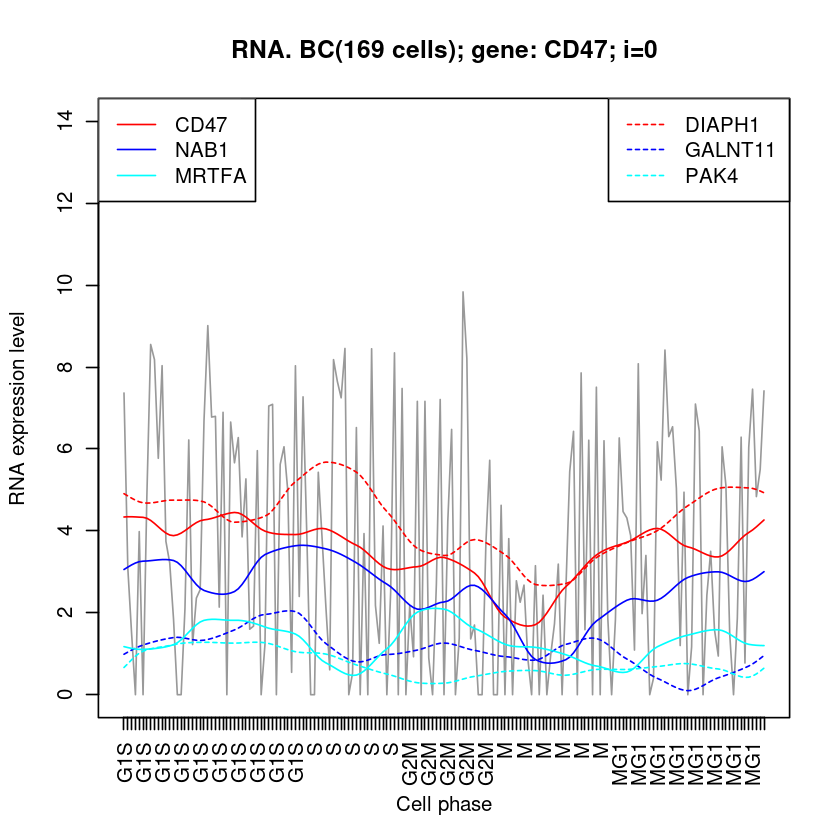

In [1287]:
# 类似表达
x=showCoTranscriptedGenes('CD47', rnaM.cpm[, cid.BC], ylim=c(0,14,1))

In [1384]:
rownames(rnaM)[grep('AIR', rownames(rnaM))]

[1] "HOTAIR"   "HOTAIRM1" "LAIR1"

[1] 169
[1] 0


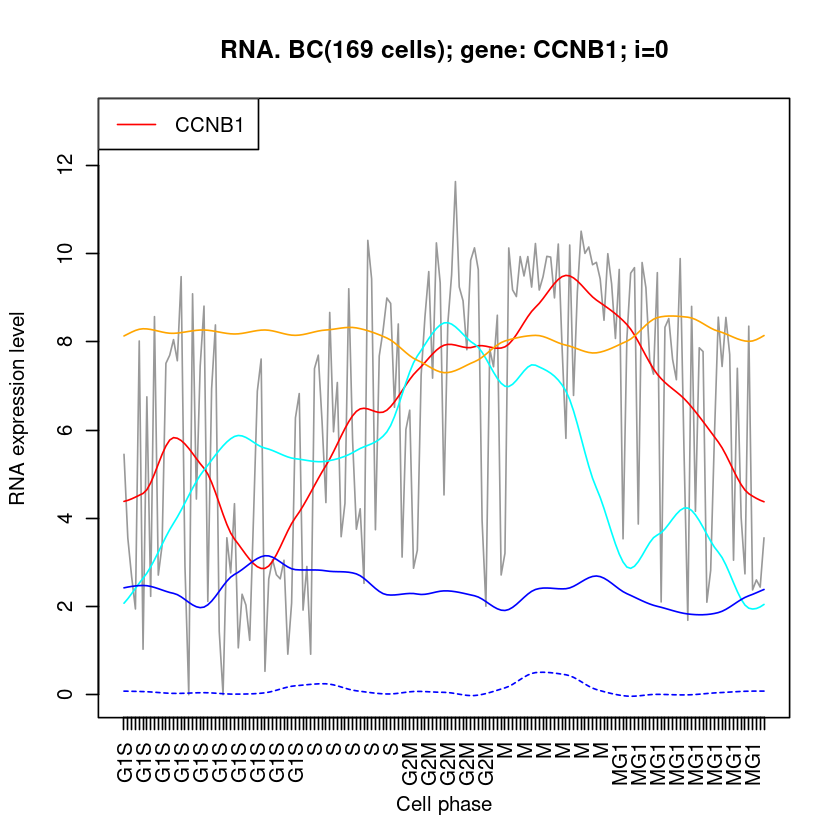

In [1175]:
fn8.addLines=show_cc_RNA2(cellOrder.BC, 'BC', gene='CCNB1',to1=F, ylim=c(0,13,1))
#fn8.addLines=show_cc_RNA2(cellOrder.BC, 'BC', gene='PDCD10',to1=F, ylim=c(0,13,1))
fn8.addLines('UBE2C','cyan')

fn8.addLines('CD274','blue', lty=2)

fn8.addLines('PDCD11','blue')
fn8.addLines('PDCD5', 'orange')

[1] 169
[1] 0


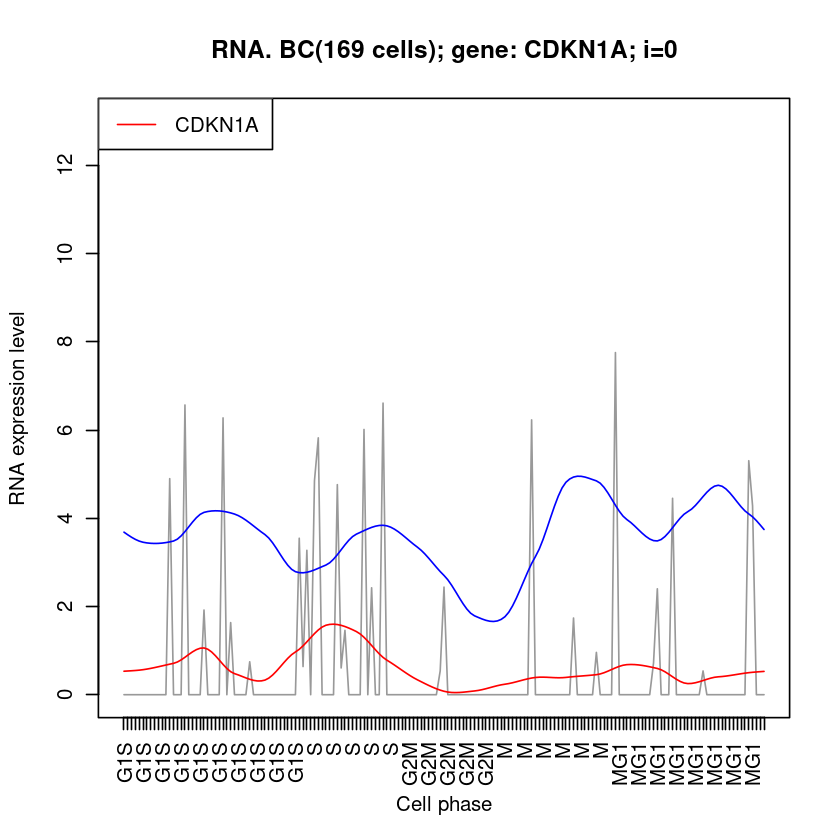

In [1410]:
# p21 蛋白
fn8.addLines=show_cc_RNA2(cellOrder.BC, 'BC', gene='CDKN1A', to1=F, ylim=c(0,13,1))
fn8.addLines('HIF1A', 'blue')

#fn8.addLines('HOTAIR', 'cyan')

[1] 56
[1] 0


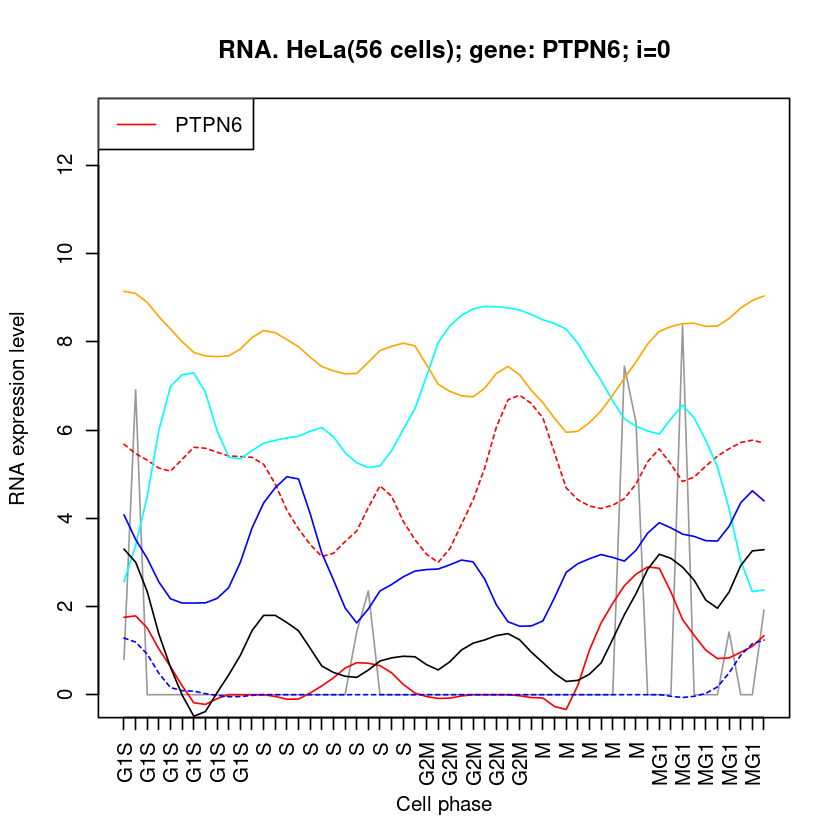

In [1363]:
## in HeLa
fn8.addLines=show_cc_RNA2(cellOrder.HeLa, 'HeLa', gene='PTPN6',to1=F, ylim=c(0,13,1))
fn8.addLines('PTPN11','red', lty=2)

fn8.addLines('UBE2C','cyan')
fn8.addLines('CD274','blue', lty=2)

fn8.addLines('PDCD11','blue')
fn8.addLines('PDCD5', 'orange')
fn8.addLines('CASP3', 'black')

### HeLa compare BC

[1] 56
[1] 0
[1] 169
[1] 0


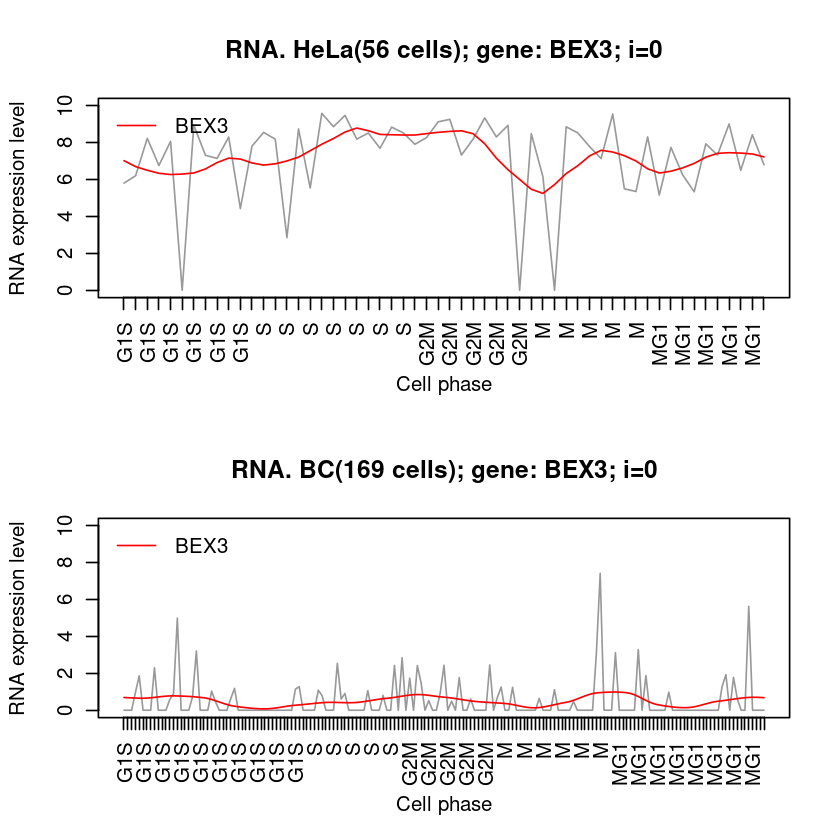

In [1739]:
#
draw_RNA_by_group=function(gene, keyword, to1=F, ylim=c(-2,-1),...){
    par(mfrow=c(2,1))
    show_cc_RNA2(cellOrder.HeLa, 'HeLa', gene=gene,to1=F, ylim=ylim, ...)
    show_cc_RNA2(cellOrder.BC, 'BC', gene=gene,to1=F, ylim=ylim, ...)
}

x=draw_RNA_by_group('BEX3', "HeLa vs BC")

[1] 56
[1] 0
[1] 169
[1] 0


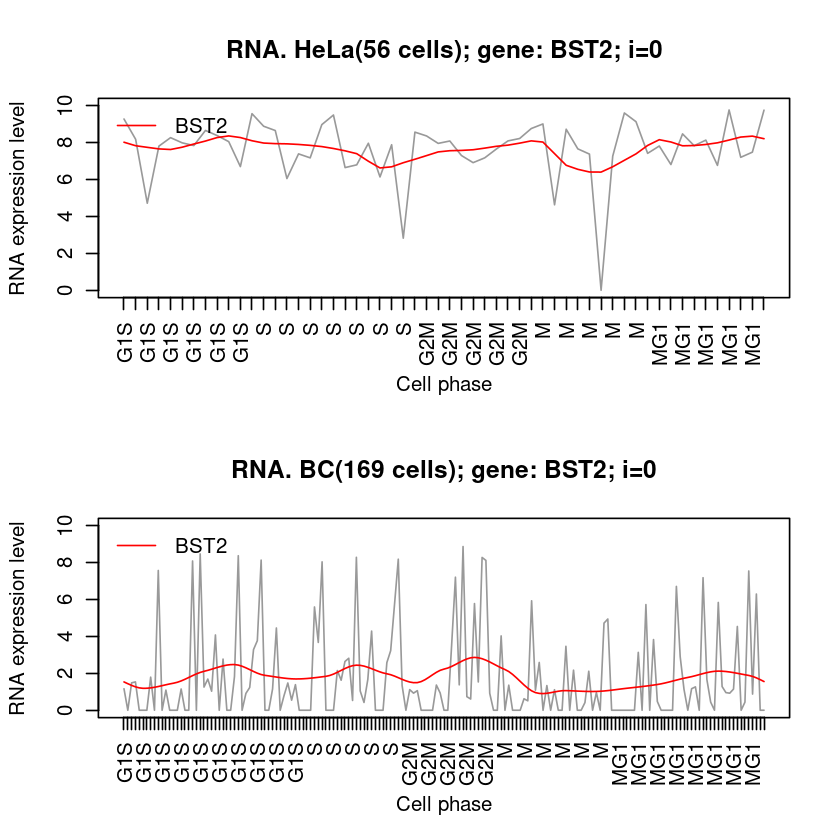

In [1742]:
x=draw_RNA_by_group('BST2', "HeLa vs BC")

[1] 56
[1] 0
[1] 169
[1] 0


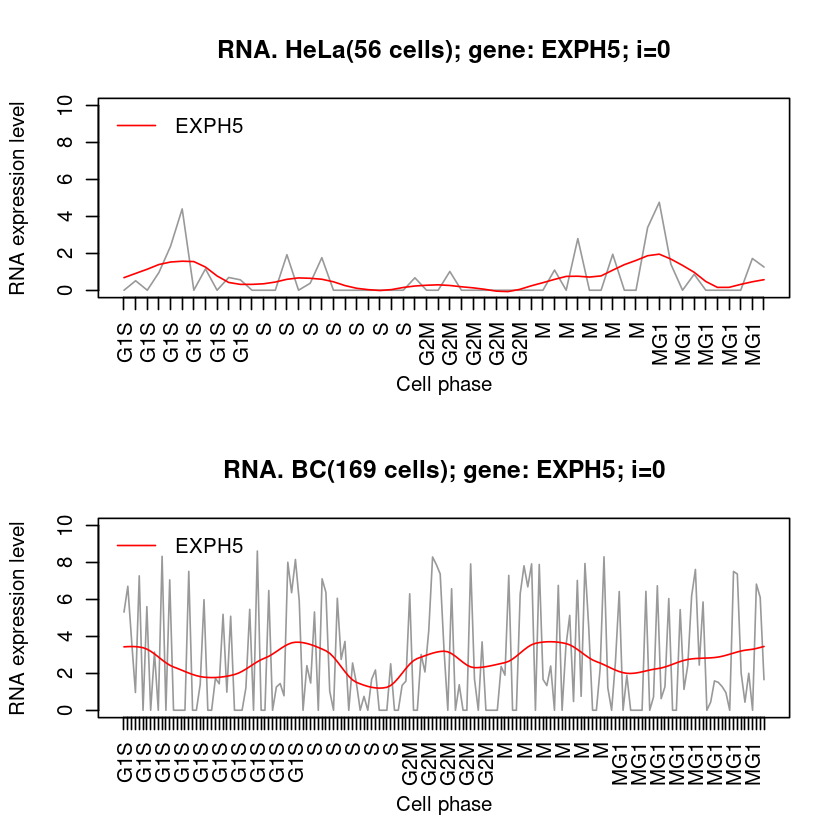

In [1794]:
x=draw_RNA_by_group('EXPH5', "HeLa vs BC")

### CO-transcript

In [1314]:
getData_835=function(){
    dt0=rnaM.log2cpm[,cid.order]
    keep=apply(dt0, 1,sum)>0
    dt=dt0[keep,]
    # correlation matrix
    dt.cor=cor(t( dt ), method = 'spearman')
    as.data.frame(dt.cor)
}

dt.BC=getData_835()

In [1361]:
## consume a lot of time: more than 20 min?
dt.cluster <- kmeans(dt.BC, centers = 3,
                  iter.max = 10,
                  nstart = 25)

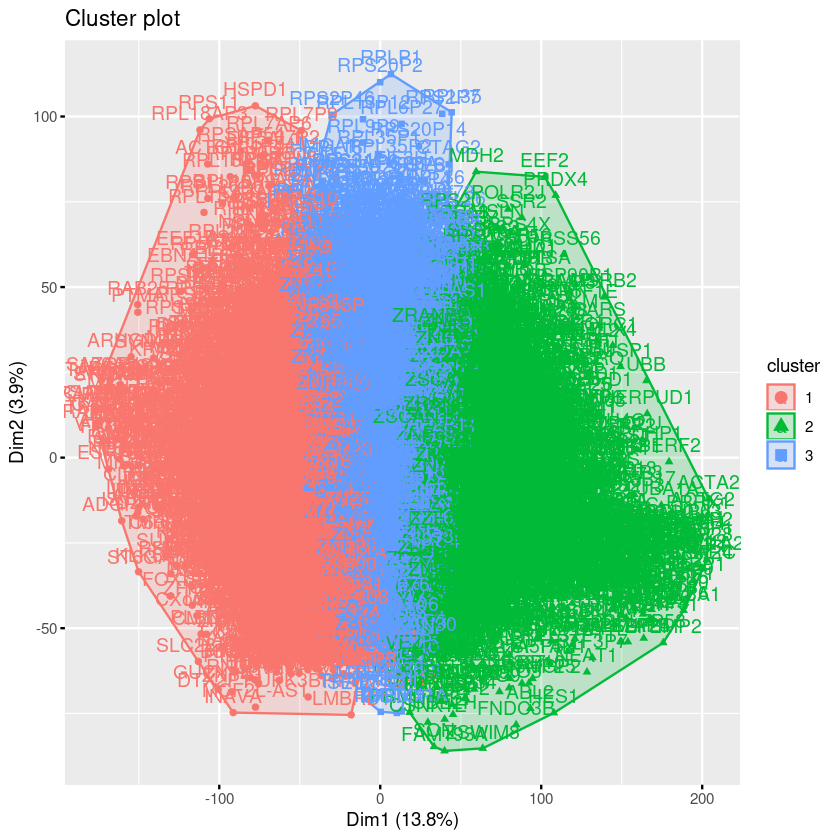

In [1362]:
# divide RNA by spearman correlation
# consuming one day!!!
(function(){
    dt.cor=dt.BC
    #
    library(factoextra)
    #fviz_cluster(dt.cluster, data = dt.cor)
    
#     pheatmap(dt, scale='row',
#          clustering_method = 'ward.D2',
#          #
#          cluster_cols =F,
#          clustering_distance_rows='correlation',
#          clustering_distance_cols='correlation',
#         main="BC, RNA")
})()

[1] 16938 16938

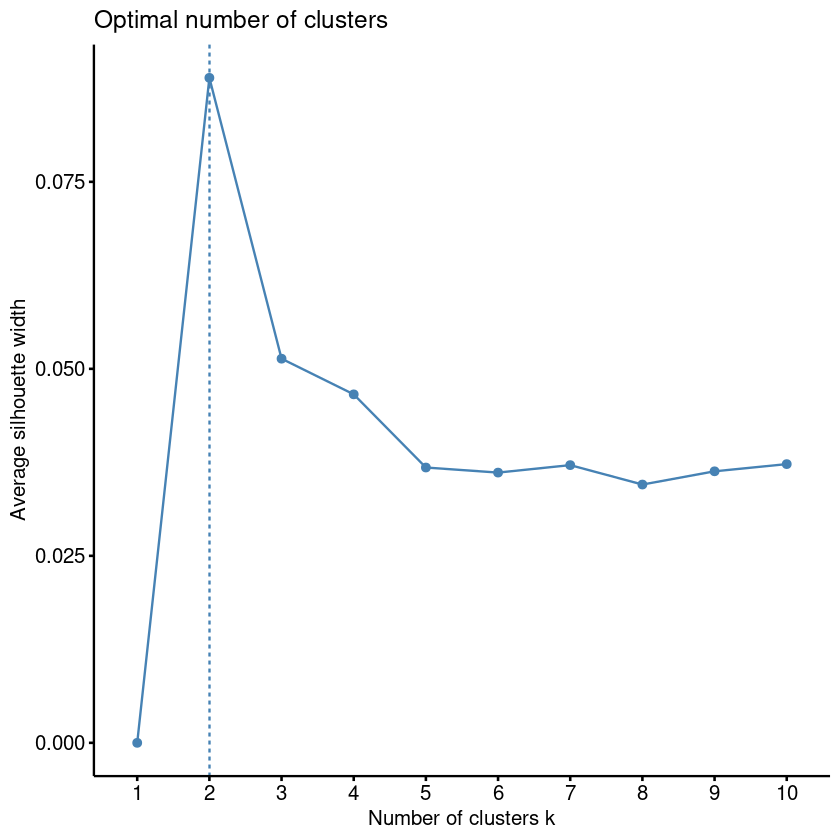

In [1373]:
library("factoextra") #超级慢！！！2天还没结果。
dim(dt.BC) #11 32
fviz_nbclust( dt.BC[1:2000,1:2000], FUNcluster=kmeans, method="silhouette")

[1] 16938 16938

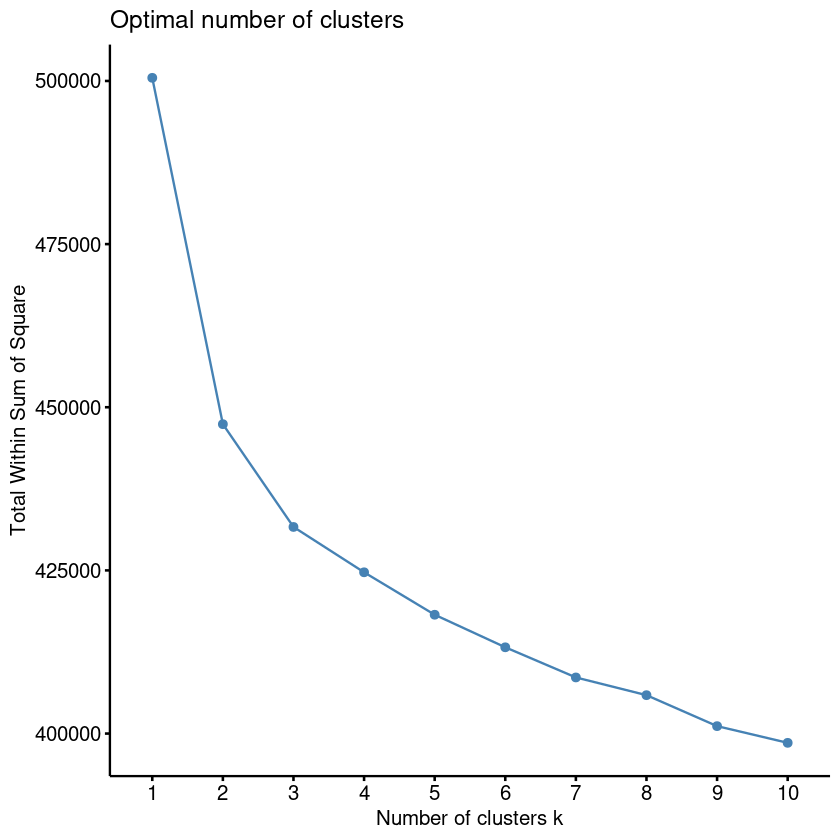

In [1381]:
library("factoextra")
dim(dt.BC) #16938  16938
#fviz_nbclust( dt, FUNcluster=kmeans, method="silhouette")
n=5000
fviz_nbclust( dt.BC[1:n,1:n], FUNcluster=kmeans, method="wss")
#fviz_nbclust( dt.BC, FUNcluster=kmeans, method="gap_stat")
# method = c("silhouette", "wss", "gap_stat")

## DPAU across cells

[1] 169
[1] 169


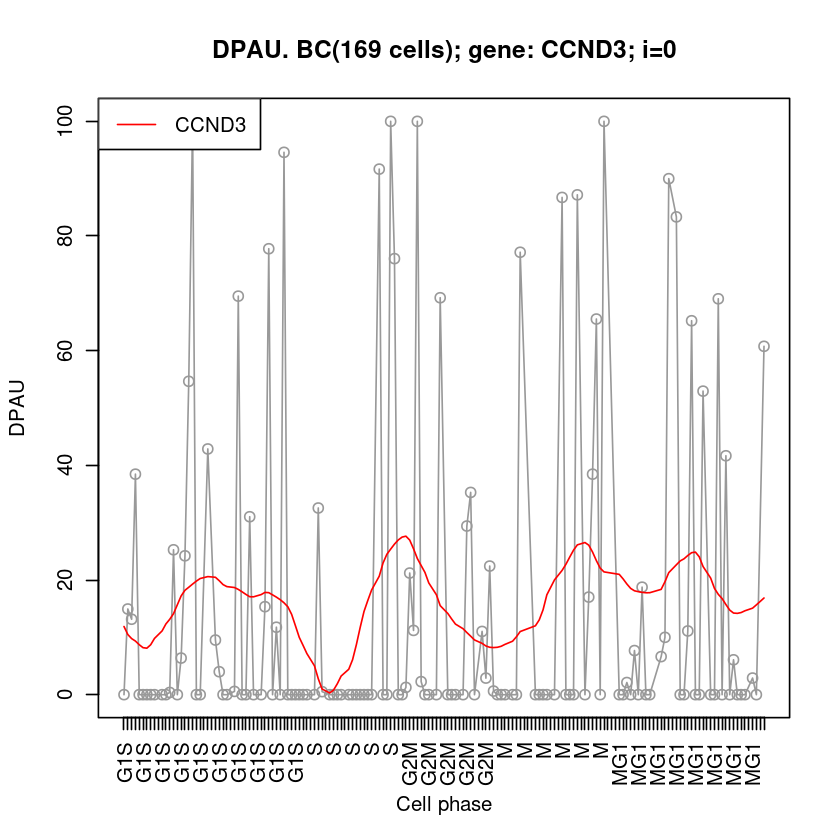

[1] 169


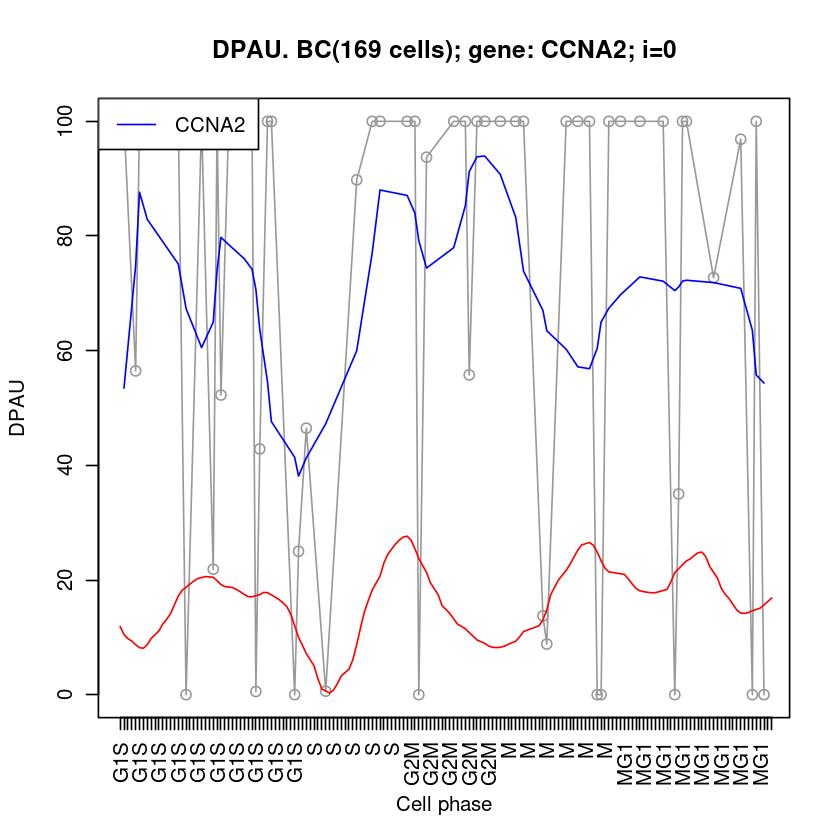

[1] 169
[1] 0


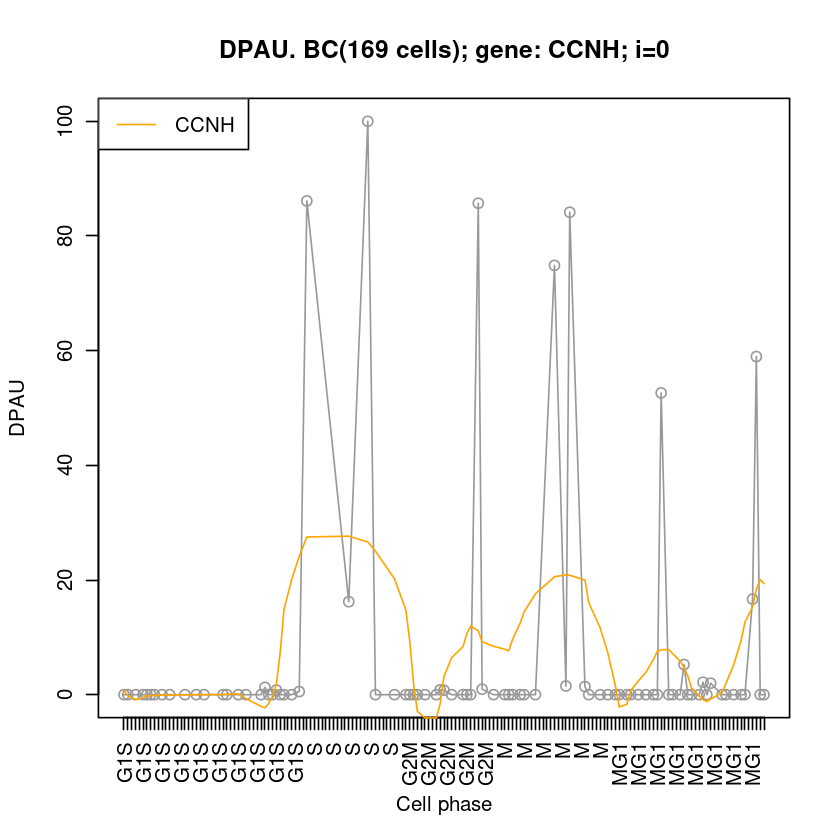

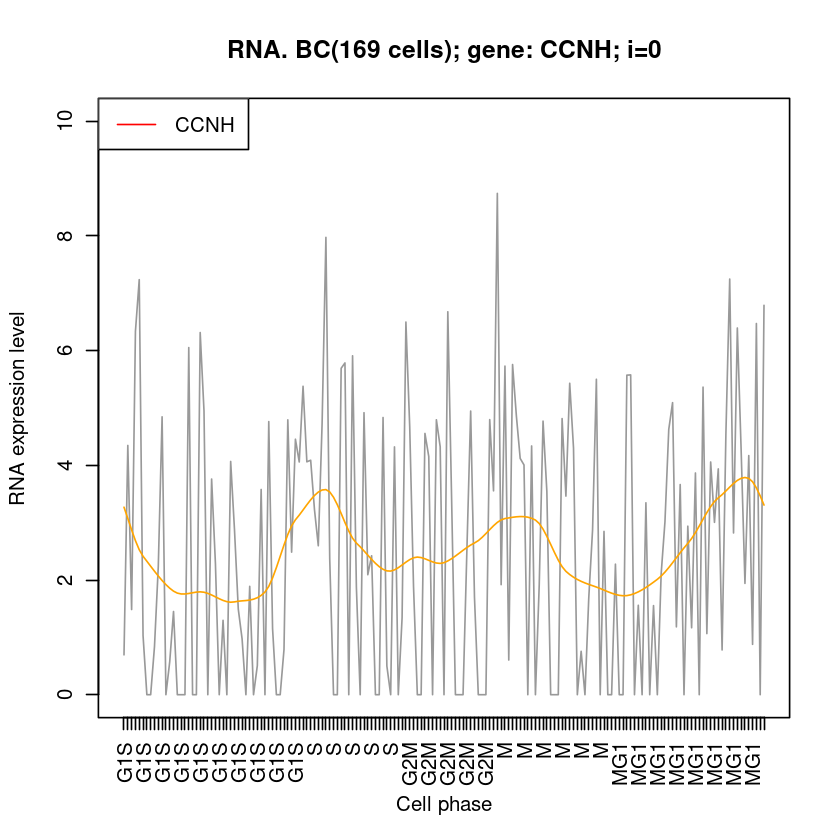

In [848]:
show_cc_APA2=function(cellOrder, keyword, gene, color1='red', index=0, ...){
    cid.order=rownames(cellOrder)
    cycleNames=as.character(cellOrder$assignedPhase)
    pl(cid.order)
    #
    dt0=DPAU[, cid.order]; #order cells
    
    x=1:length(cid.order);
    getRNA=function(gene){
        
        if(!(gene %in% rownames(DPAU))){
            stop('gene not found!')
        }
        
        y=DPAU[gene,];
        keep=!is.na(y[1,])

        x2=x[keep]
        y2=as.numeric(y[,keep])

        return(list(x2,y2))
    }
    #
    dt=getRNA(gene)
    #title="(normalization each gene to [0,1])"
    plot( dt[[1]], dt[[2]], type="o", xaxt="n", col='#999999', ylim=c(0,100),
         xlab='Cell phase', ylab="DPAU", 
         main=paste0('DPAU. ',keyword,'(', nrow(cellOrder),' cells); gene: ', gene,"; i=",index) )
    axis(1,at=(1:length(cycleNames)),labels=cycleNames,col.axis="black",las=2)
    legend('topleft', lty=1, col=color1, legend=gene)
    
    # 
    addLines=function(dt, color,...){
        x0=dt[[1]]; y0=dt[[2]]
        #
        n=length(y0); keep=(n+1): (2*n)        
        x=c(x0,x0,x0); y=c(y0,y0,y0)
        # print(y)
        
        model2=loess(y ~ seq(1,n*3), span=0.07)
        y2=predict( model2 )
        lines(x0, y2[ keep ], type="l", col=color,...)
        #lines(x0, y2[seq(1,n)], type="l", col=color,...)
    }
    addLines(dt, color1) #B in M
    return(function(geneName, color,...){
        addLines(getRNA(geneName), color,...)
    })
}
fn8.addLines=show_cc_APA2(cellOrder.BC, "BC", gene='CCND3', 'red')
fn8.addLines=show_cc_APA2(cellOrder.BC, "BC", gene='CCNA2', 'blue')
fn8.addLines('CCND3','red')

fn8.addLines=show_cc_APA2(cellOrder.BC, "BC", gene='CCNH', 'orange')
fn8.addLines=show_cc_RNA2(cellOrder.BC, "BC", gene='CCNH', 'orange')

[1] 169


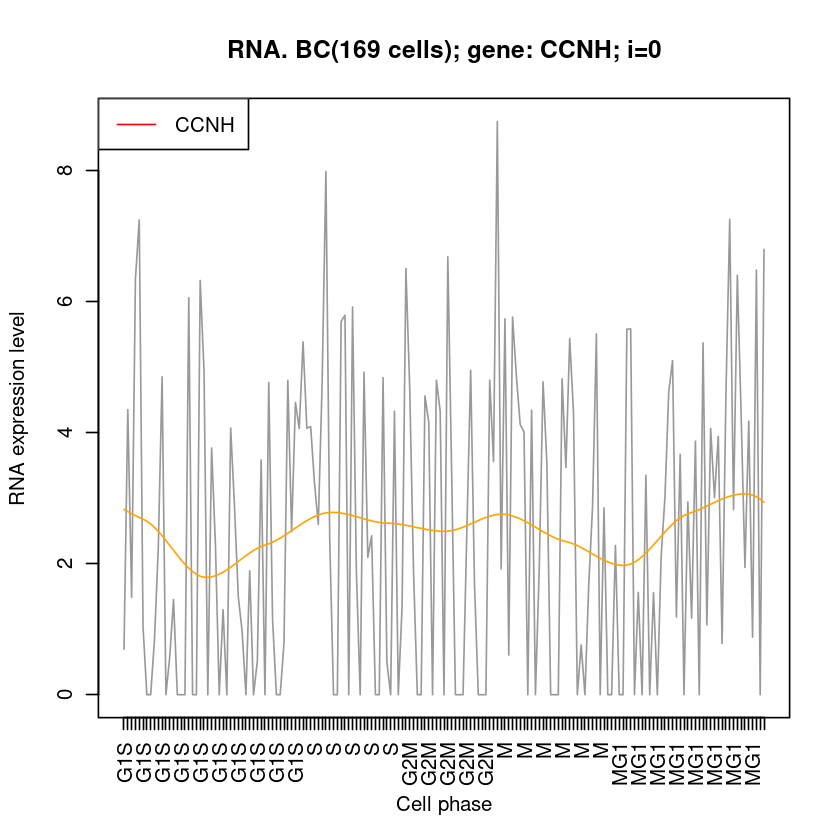

In [665]:
## RNA
fn8.addLines=show_cc_RNA2(cellOrder.BC, "BC", gene='CCNH', 'orange')

### drawRNA_DPAU() in one

[1] 169


Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“k-d tree limited by memory. ncmax= 204”


[1] 169
[1] 0


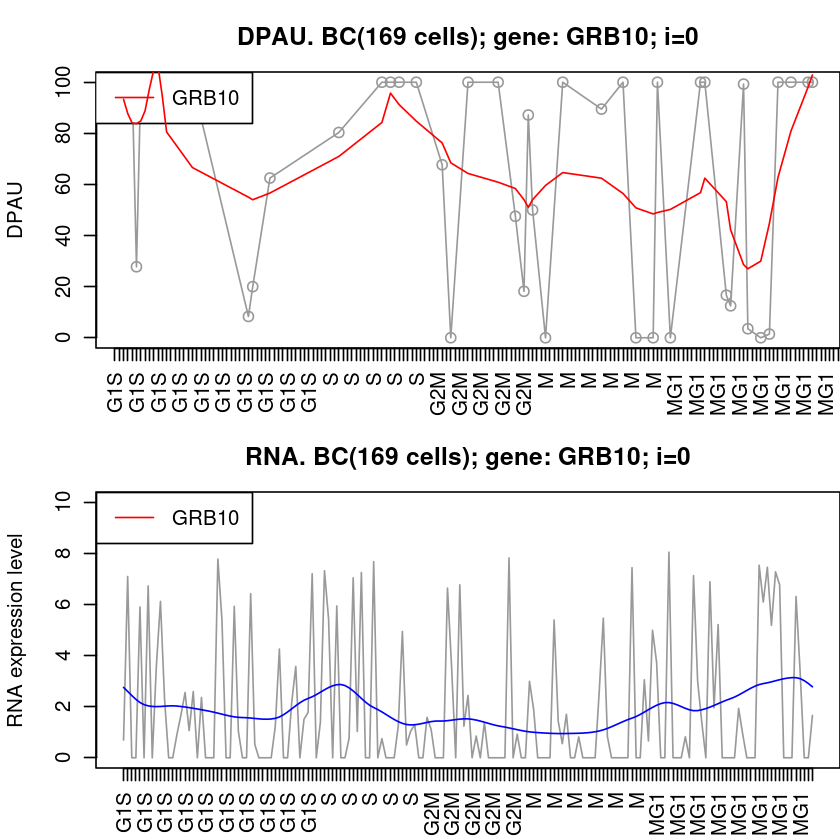

In [851]:
drawRNA_DPAU=function(gene){
    par(mfrow=c(2,1), mar=c(3,4,3,0))
    fn8.addLines=show_cc_APA2(cellOrder.BC, "BC", gene=gene, 'red')
    fn8.addLines=show_cc_RNA2(cellOrder.BC, "BC", gene=gene, 'blue')
}

drawRNA_DPAU('GRB10')

[1] 169
[1] 169
[1] 0


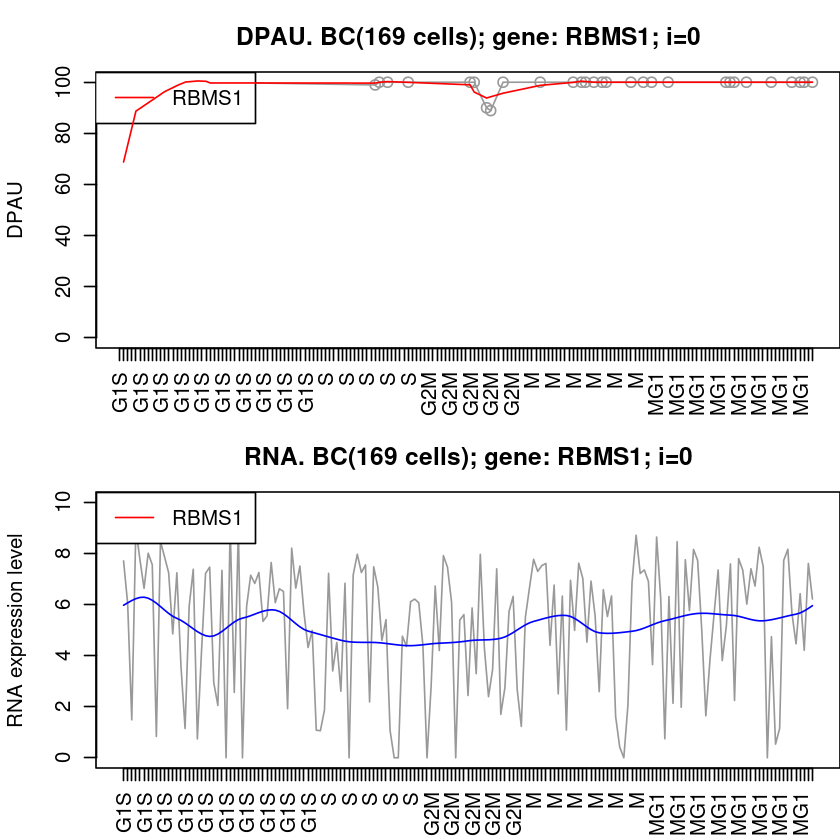

In [852]:
drawRNA_DPAU('RBMS1')
#fn8.addLines=show_cc_APA2(cellOrder.BC, "BC", gene='RBMS1', 'red')
#fn8.addLines=show_cc_RNA2(cellOrder.BC, "BC", gene='RBMS1', 'blue')

[1] 169
[1] 169
[1] 0


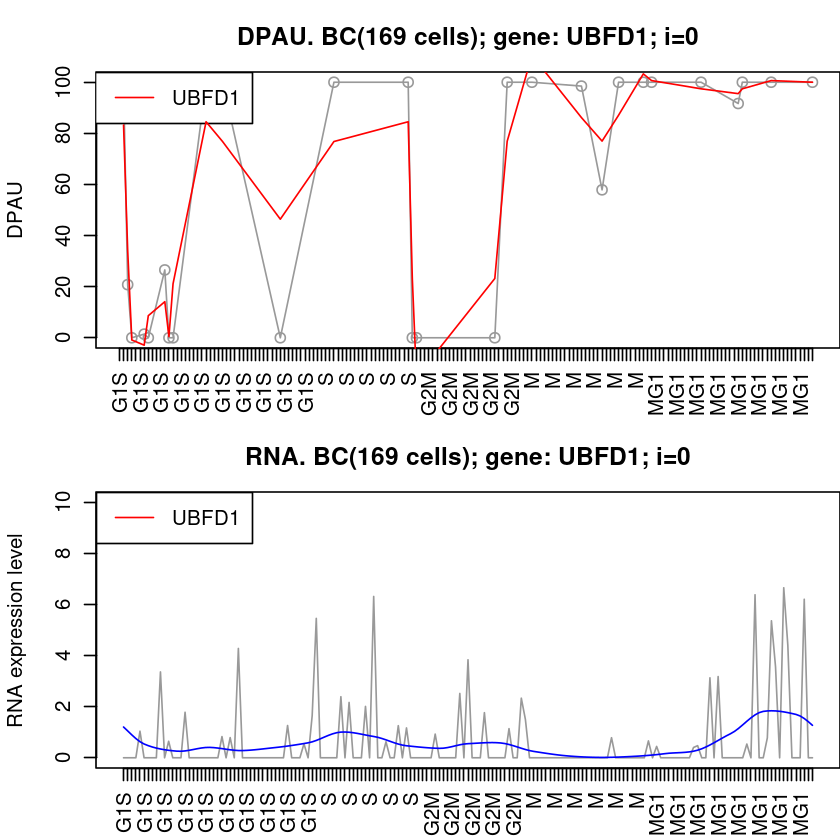

In [853]:
drawRNA_DPAU('UBFD1')
#fn8.addLines=show_cc_APA2(cellOrder.BC, "BC", gene='UBFD1', 'red')

[1] 169
[1] 169
[1] 0


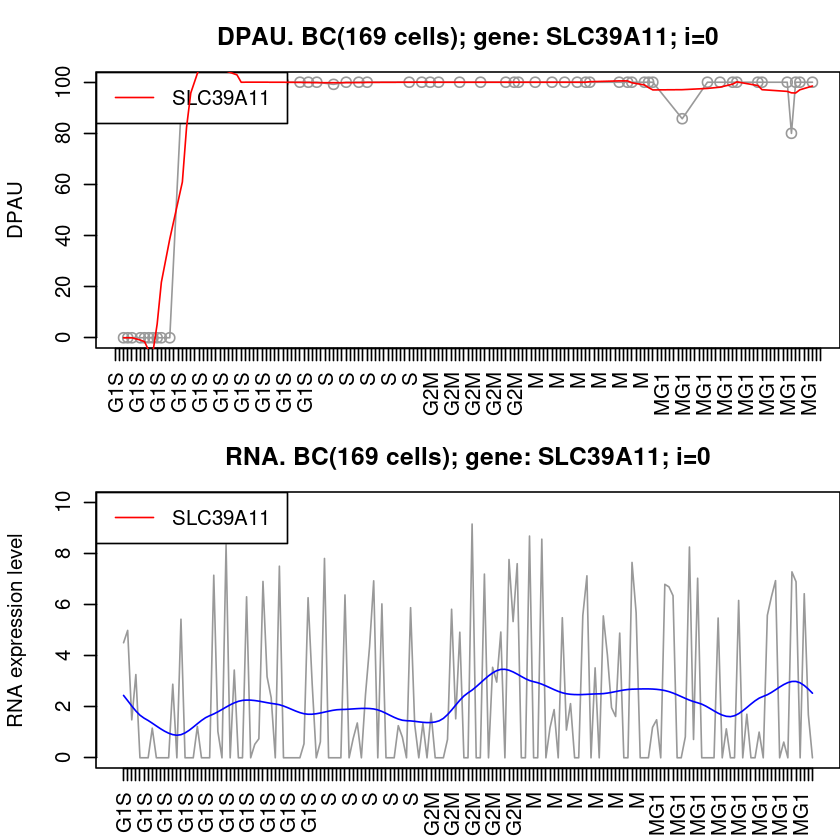

In [854]:
#fn8.addLines=show_cc_APA2(cellOrder.BC, "BC", gene='SLC39A11', 'red')
drawRNA_DPAU('SLC39A11')

[1] 169
[1] 169
[1] 0


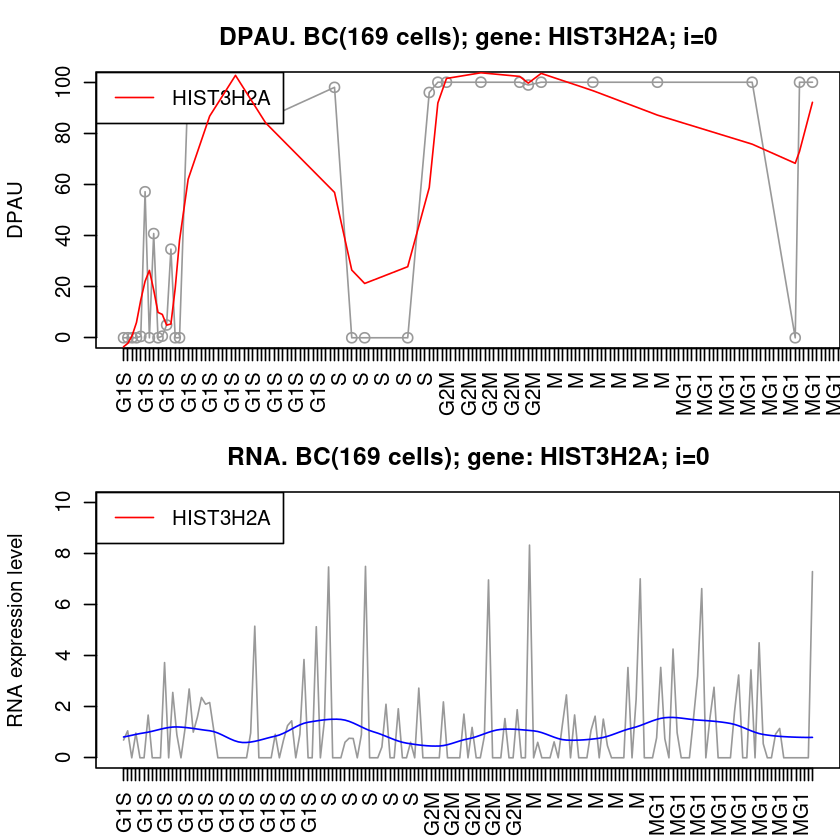

In [855]:
#fn8.addLines=show_cc_APA2(cellOrder.BC, "BC", gene='HIST3H2A', 'red')
drawRNA_DPAU('HIST3H2A')

[1] 169
[1] 169
[1] 0


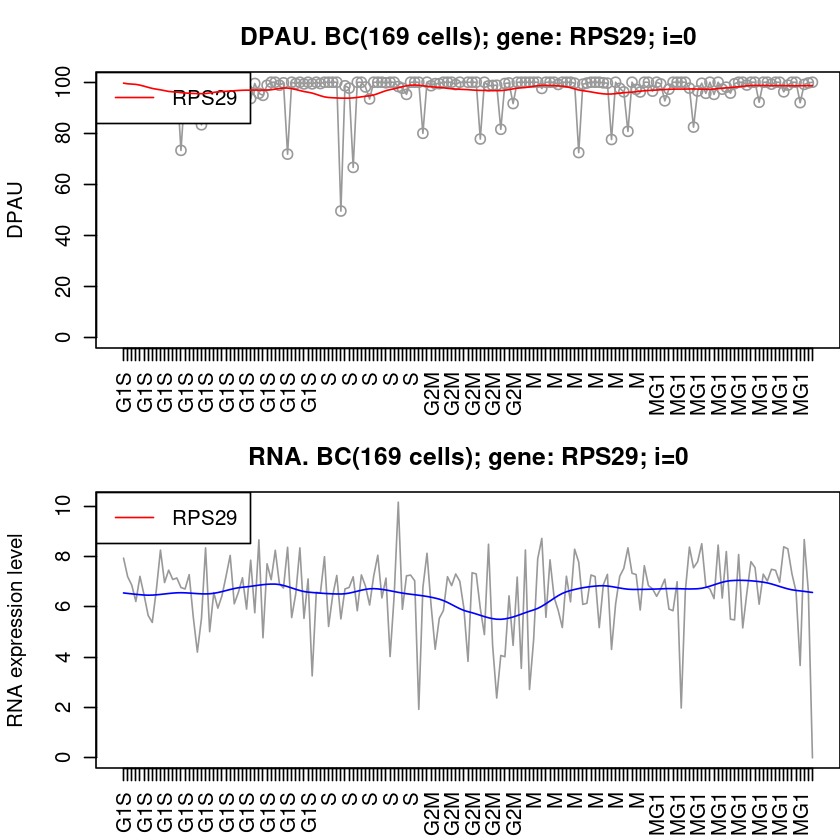

In [856]:
#fn8.addLines=show_cc_APA2(cellOrder.BC, "BC", gene='RPS29', 'red')
drawRNA_DPAU('RPS29')

[1] 169


Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“k-d tree limited by memory. ncmax= 200”


[1] 169
[1] 0


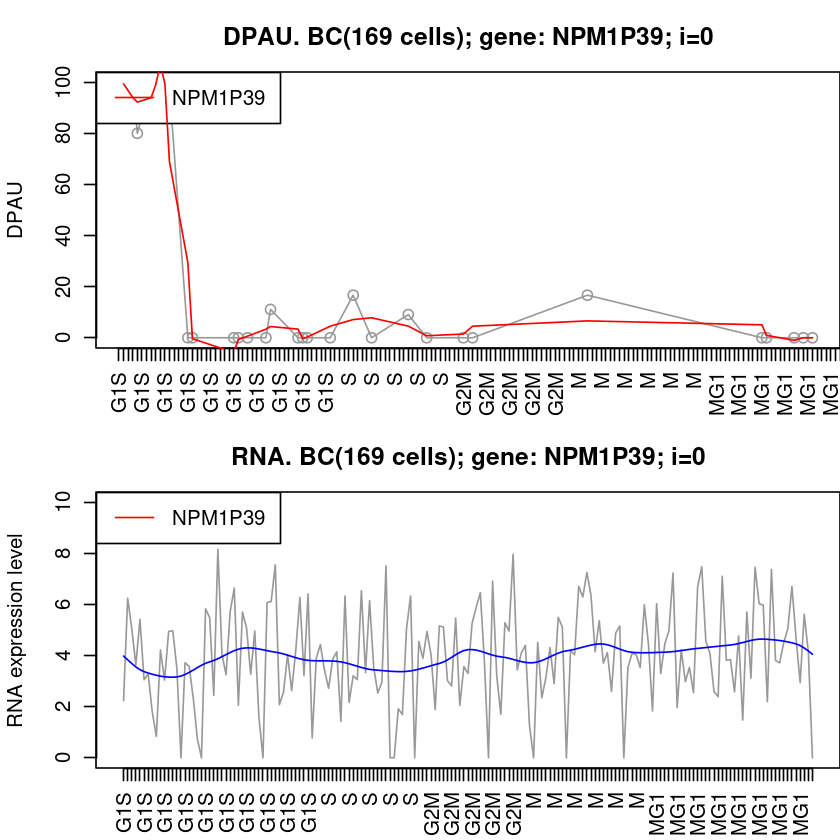

In [857]:
#fn8.addLines=show_cc_APA2(cellOrder.BC, "BC", gene='NPM1P39', 'red')
drawRNA_DPAU('NPM1P39')

[1] 169


Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“k-d tree limited by memory. ncmax= 200”


[1] 169
[1] 0


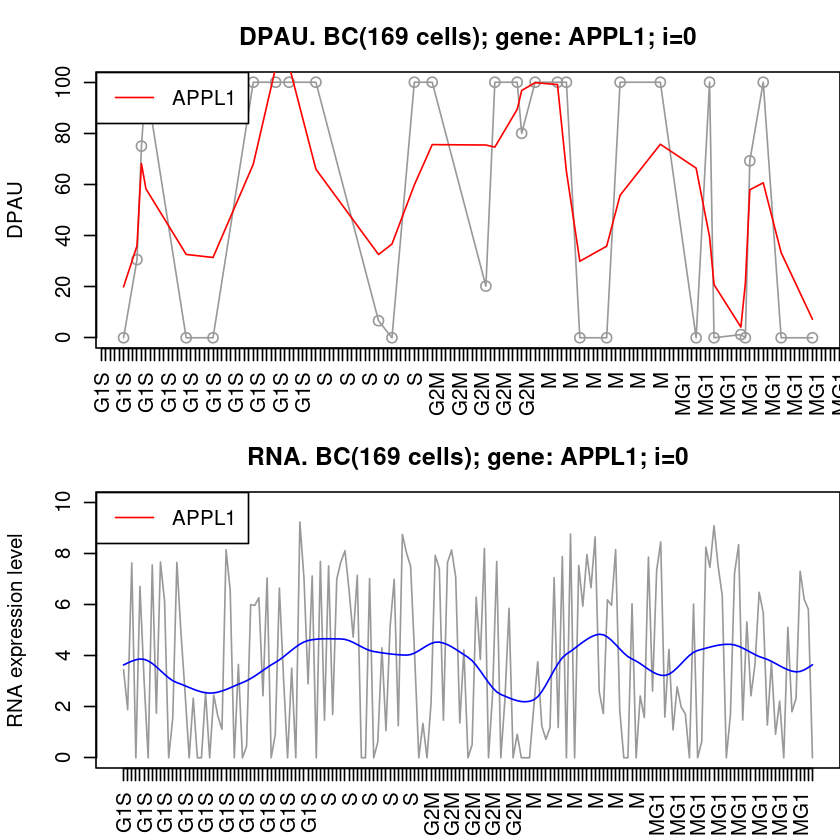

In [858]:
#fn8.addLines=show_cc_APA2(cellOrder.BC, "BC", gene='APPL1', 'red')
drawRNA_DPAU('APPL1')

[1] 169
[1] 169
[1] 4.048771


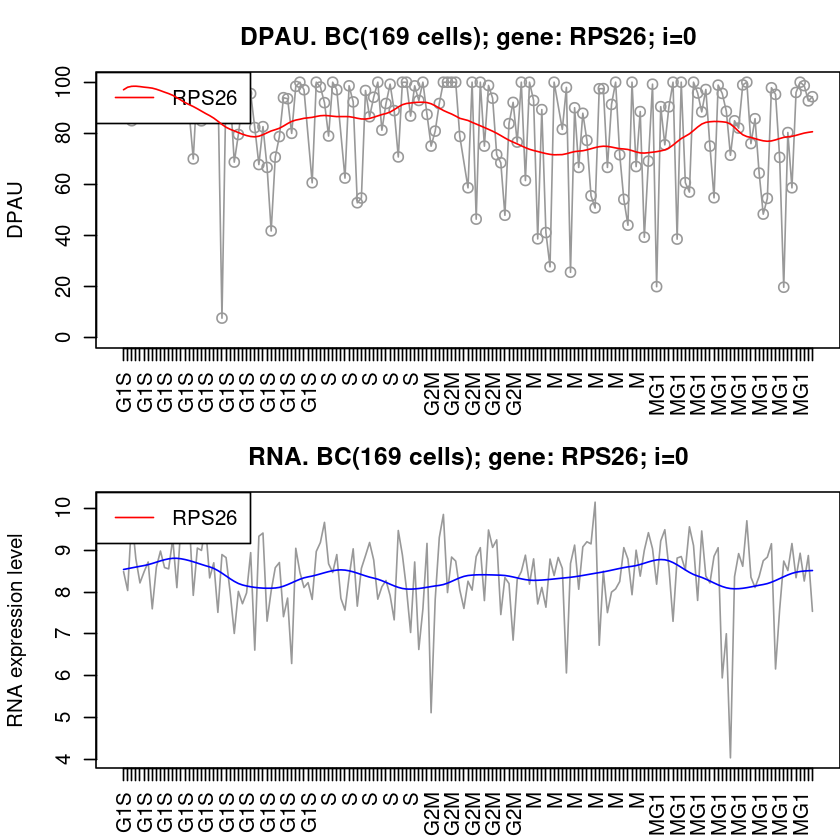

In [1244]:
drawRNA_DPAU('RPS26')

[1] 169
[1] 169
[1] 3.555387


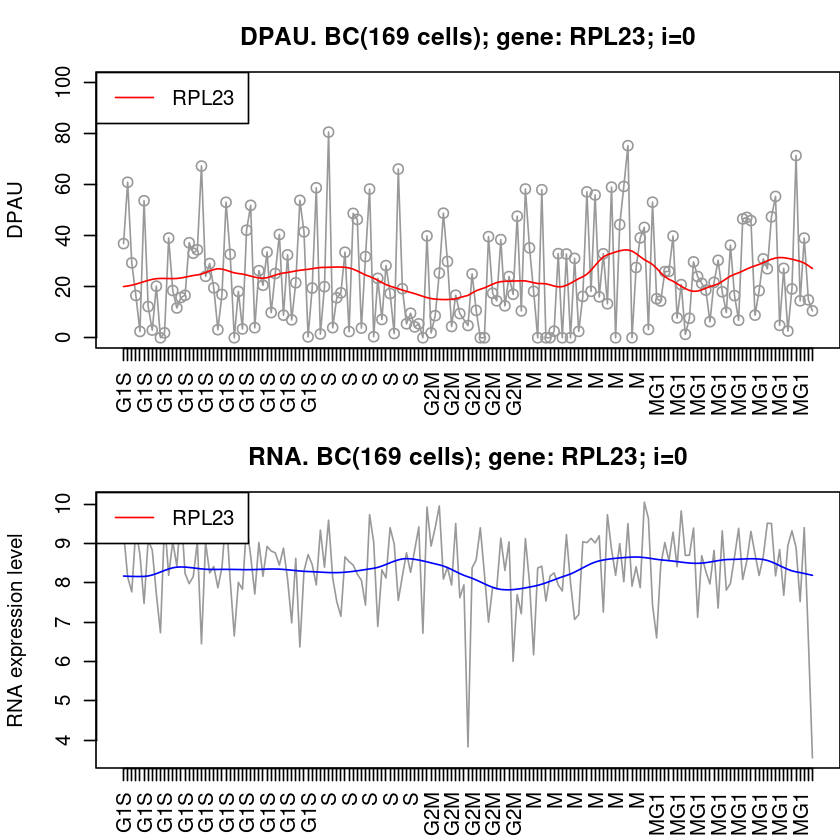

In [1245]:
drawRNA_DPAU('RPL23')

[1] 169
[1] 169
[1] 0


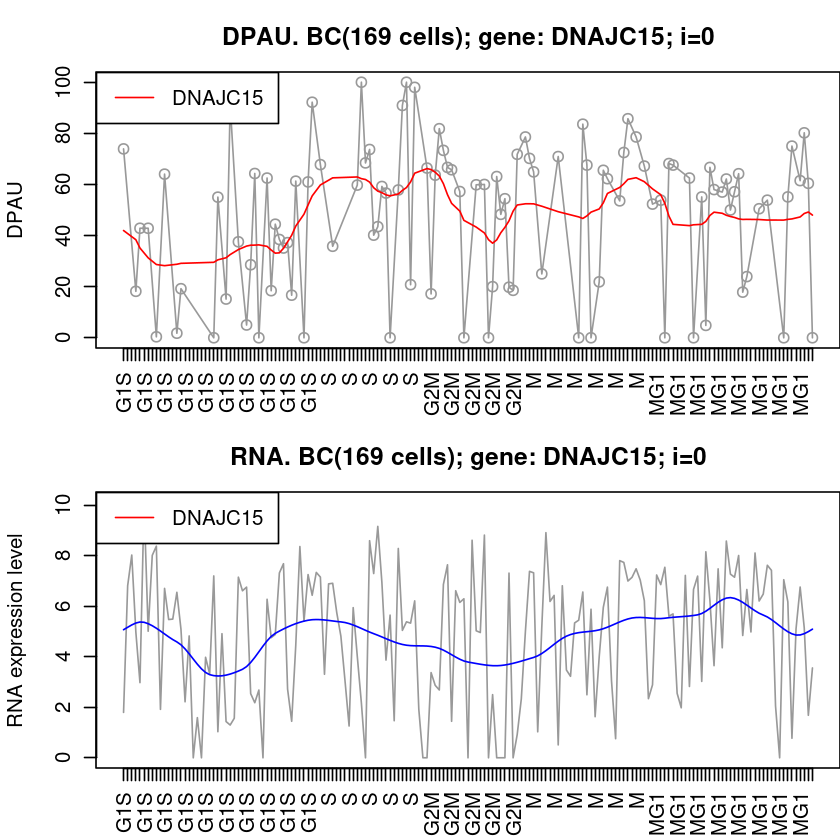

In [1246]:
drawRNA_DPAU('DNAJC15')

[1] 169
[1] 169
[1] 0


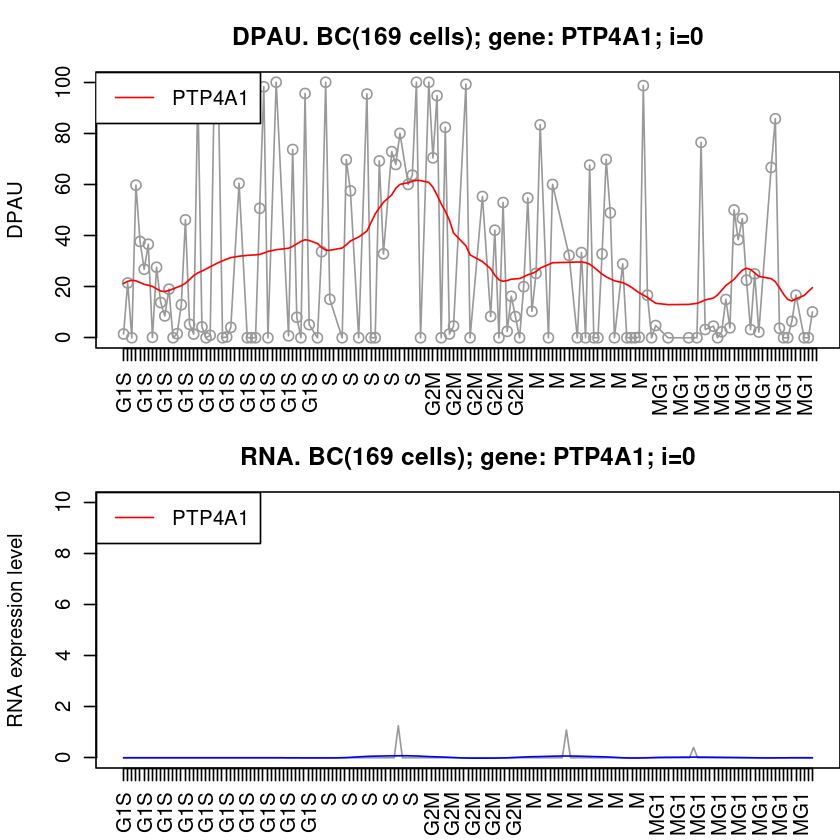

In [1247]:
drawRNA_DPAU('PTP4A1')

## gDPAU across cells

In [1488]:
(function(){
    getwd() #'/data/jinwf/wangjl/apa/191111Figure/f3/distalAPA_RNA_5'
    df=read.table('../gDPAU_gPPAU/gDPAU_BC/00_gDPAU.BC.df.txt');
    df[1:10,1:10]
})()

,c12ROW02,c12ROW03,c12ROW04,c12ROW05,c12ROW06,c12ROW07,c12ROW08,c12ROW11,c12ROW12,c12ROW15
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
PTMA,40.834192,55.213547,59.736419,65.368158,71.453653,87.886534,55.16092,69.44954,67.793540,73.80247
MALAT1,53.773691,18.710301,76.256066,18.995992,29.598075,64.289488,10.67540,41.76597,32.617011,38.13521
FTH1,37.212885,73.103862,40.012113,43.070416,56.963527,37.595067,41.64731,57.88425,42.960909,78.87077
RPS11,93.337464,91.439752,71.920430,95.449719,97.118004,86.757269,95.21314,67.45090,94.868591,85.24510
MGP,97.625920,99.375518,97.911941,87.716450,98.634436,98.793591,89.10002,97.79823,98.363973,65.22582
GAPDH,99.631208,98.116200,98.040880,98.291654,100.000000,99.114004,99.39925,72.29728,98.275565,99.02114
RPS27A,63.060150,43.987594,53.565567,51.215132,31.003642,52.464592,53.36583,53.14123,46.075871,57.70495
RPS14,29.169834,29.169834,29.461298,33.347476,28.541760,29.328418,29.53168,29.95950,29.399732,28.93591
RPS19,7.703332,7.658145,8.346068,6.681088,8.147223,8.147223,23.67610,33.84119,8.147223,10.11236


In [1531]:
(function(){
    df=read.table('../gDPAU_gPPAU/gDPAU_BC/00_gDPAU.BC.df.txt');
    df[20:30, 1:4]
})()

,c12ROW02,c12ROW03,c12ROW04,c12ROW05
,<dbl>,<dbl>,<dbl>,<dbl>
RPLP1,79.17890,81.167244,93.02026,82.55687
RPS6,61.09345,82.823117,66.86650,75.68037
UBL5,59.13963,57.861841,52.79319,81.11207
STMN1,46.79270,52.471258,48.70593,53.67628
RACK1,100.00000,100.000000,59.37557,100.00000
NPM1,81.69467,71.489206,59.91372,61.57737
RPL7A,94.07667,88.674358,73.23316,69.93246
CCT6A,39.11341,36.847688,35.46896,37.58743
H2AFZ,35.75084,9.734797,35.75084,35.75084


In [1700]:
(function(){
    table(cellInfo$cellType)
})()


       BC_0        BC_1 HeLa_normal   HeLa_sync 
         87          82          29          27 

[1] 169
[1] 169


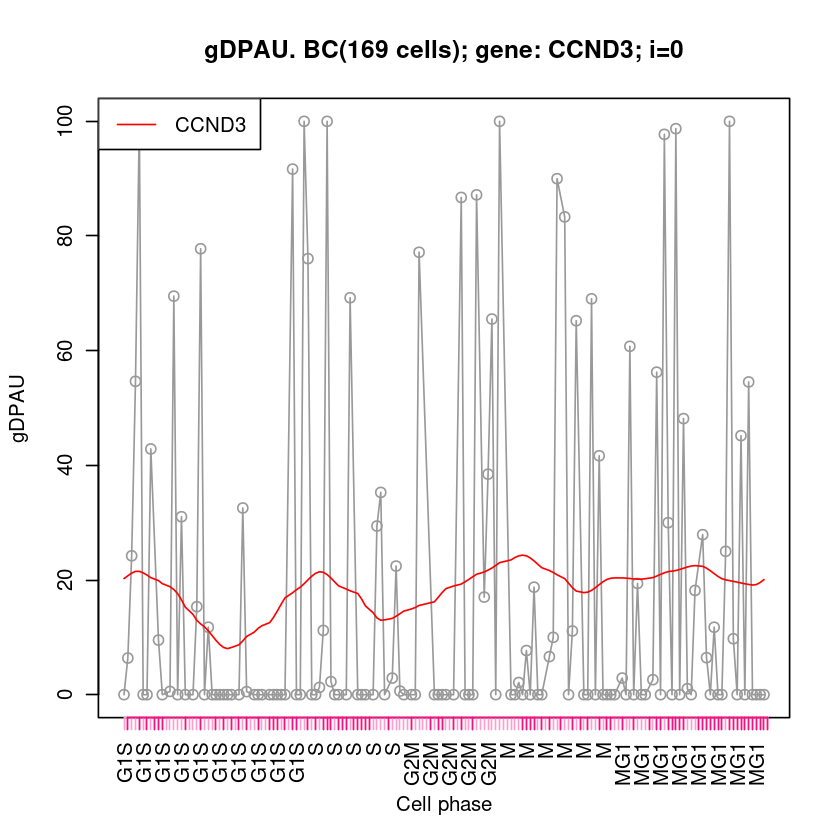

[1] 169


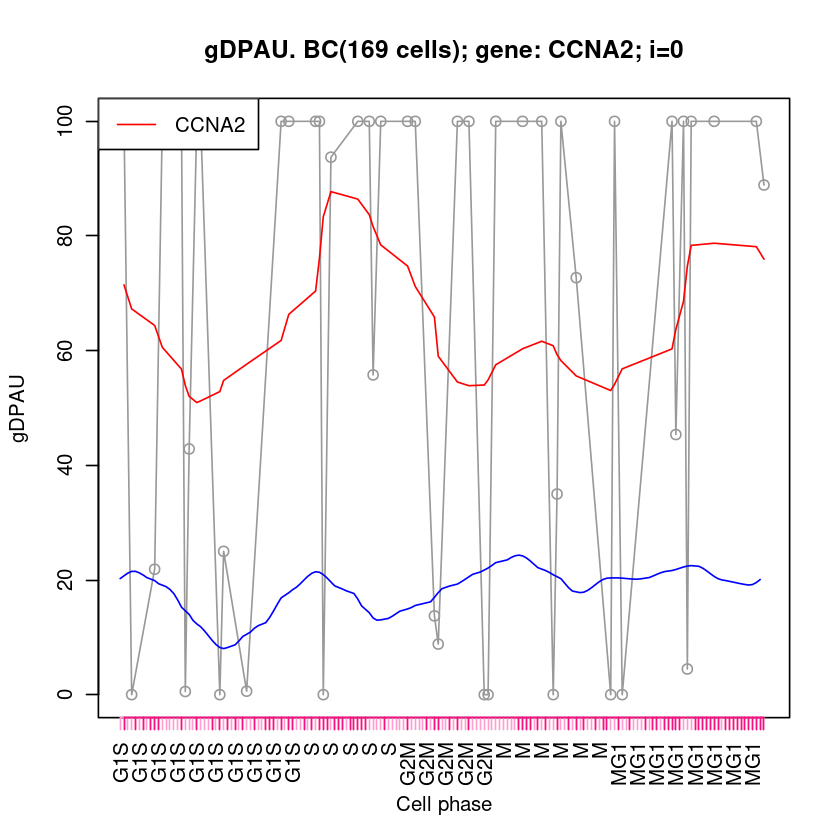

[1] 169


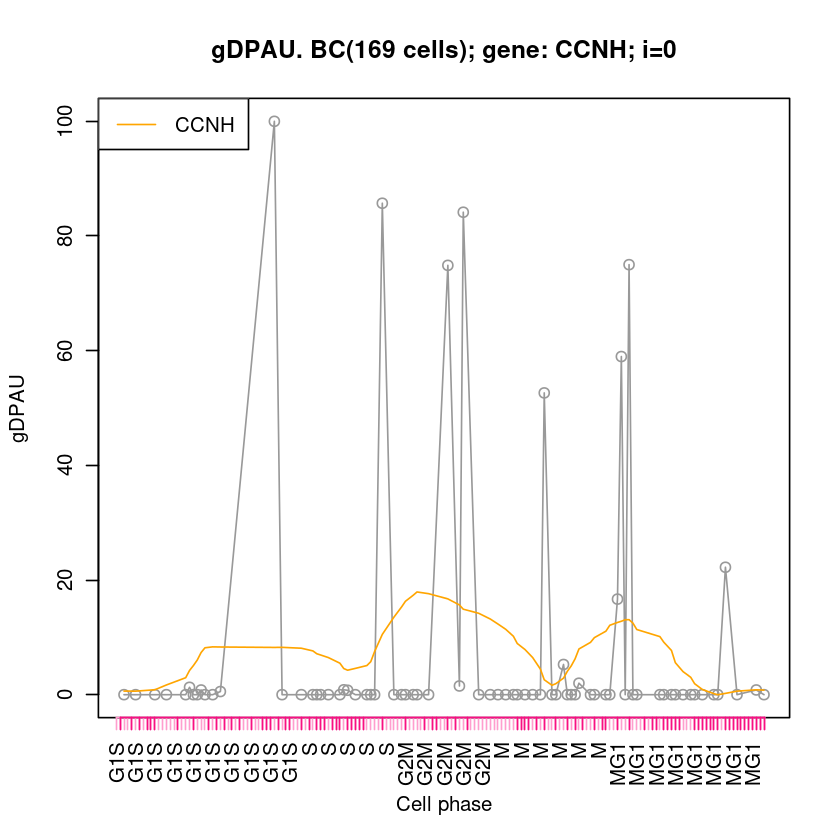

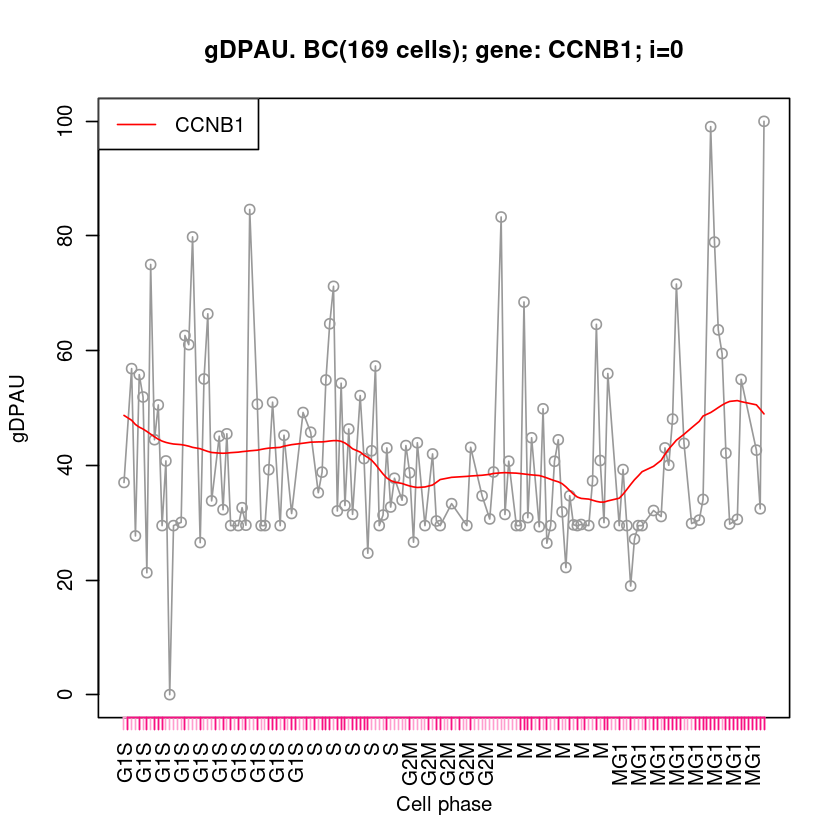

In [1708]:
show_cc_APA_gDPAU=function(cellOrder, keyword, gene, color1='red', index=0, ...){
    if( !(keyword %in% c("BC", "HeLa") ) ){
        stop('Error: keyword must in c("BC", "HeLa")')
    }
    n=nrow(cellOrder) # cell number
    #
    cid.order=rownames(cellOrder)
    cycleNames=as.character(cellOrder$assignedPhase)
    pl(cid.order)
        
    #
    if(keyword=='BC'){
        DPAU=read.table('../gDPAU_gPPAU/gDPAU_BC/00_gDPAU.BC.df.txt');
        Xcolors="#FF9ECE";
        Xcolors2="#F81082"
        
        atPos2=seq(1,n)[which(cid.order %in% rownames(  cellInfo[cellInfo$cellType=="BC_1",] ) )]
    }else{
        DPAU=read.table('../gDPAU_gPPAU/gDPAU_HeLa/00_gDPAU.HeLa.df.txt');
        Xcolors='#003A9C' #"#005FFF";
        Xcolors2='#CBDFFF' #"#98BEFD"
        
        atPos2=seq(1,n)[which(cid.order %in% rownames(  cellInfo[cellInfo$cellType=="HeLa_sync",] ) )]
    }
    #print(Xcolors)
    dt0=DPAU[, cid.order]; #order cells
    
    x=1:length(cid.order);
    getRNA=function(gene){
        
        if(!(gene %in% rownames(DPAU))){
            stop('gene not found!')
        }
        #remove NA
        y=DPAU[gene,];
        keep=!is.na(y[1,])
        x=x[keep]
        y=as.numeric(y[,keep])

        return(list(x,y))
    }
    #
    dt=getRNA(gene)
    #title="(normalization each gene to [0,1])"
    plot( dt[[1]], dt[[2]], type="o", xaxt="n", col='#999999', ylim=c(0,100),
         xlab='Cell phase', ylab="gDPAU", 
         main=paste0('gDPAU. ',keyword,'(', nrow(cellOrder),' cells); gene: ', gene,"; i=",index) )    
    axis(1,at=(1:n ),labels=cycleNames, col.axis="black",las=2,col=Xcolors )
    axis(1,at=atPos2,labels=NULL, col.axis="#00000000", las=2,col=Xcolors2 )
    legend('topleft', lty=1, col=color1, legend=gene)
    
    # 
    addLines=function(dt, color,...){
        x0=dt[[1]]; y0=dt[[2]]
        #
        n=length(y0); keep=(n+1): (2*n)        
        x=c(x0,x0,x0); y=c(y0,y0,y0)
        # print(y)
        
        model2=loess(y ~ seq(1,n*3), span=0.15) #0.07
        y2=predict( model2 )
        lines(x0, y2[ keep ], type="l", col=color,...)
        #lines(x0, y2[seq(1,n)], type="l", col=color,...)
    }
    addLines(dt, color1) #B in M
    return(function(geneName, color,...){
        addLines(getRNA(geneName), color,...)
    })
}
fn8.addLines=show_cc_APA_gDPAU(cellOrder.BC, "BC", gene='CCND3', 'red')
fn8.addLines=show_cc_APA_gDPAU(cellOrder.BC, "BC", gene='CCNA2', 'red')
fn8.addLines('CCND3','blue')

fn8.addLines=show_cc_APA_gDPAU(cellOrder.BC, "BC", gene='CCNH', 'orange')
fn8.addLines=show_cc_APA_gDPAU(cellOrder.BC, "BC", gene='CCNB1', 'red')

### drawRNA_gDPAU

[1] 169
[1] 169
[1] 0


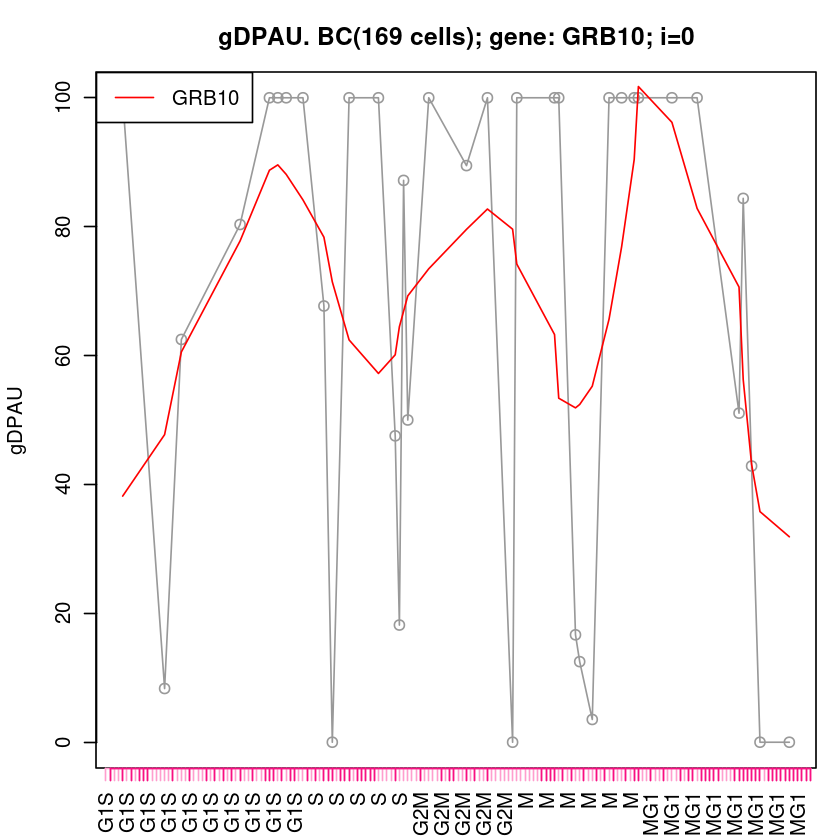

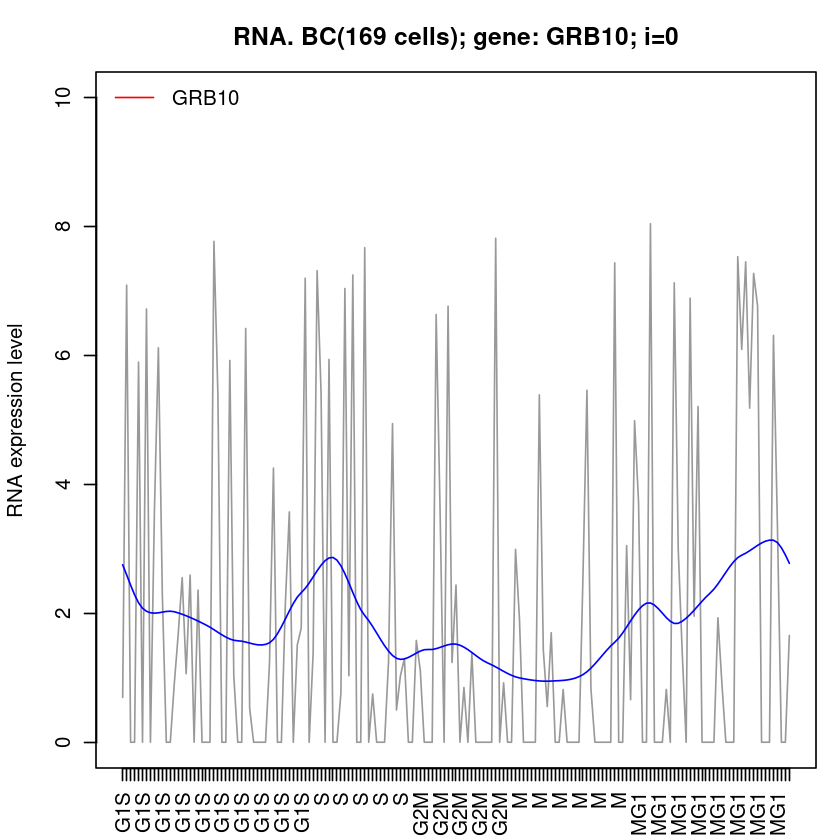

In [1702]:
drawRNA_gDPAU=function(gene, is_mfrow=T, cellOrder=cellOrder.BC, keyword="BC"){
    par(mar=c(3,4,3,1))
    if(is_mfrow){mfrow=c(2, 1)}
    fn8.addLines=show_cc_APA_gDPAU(cellOrder, keyword, gene=gene, 'red')
    fn8.addLines=show_cc_RNA2(cellOrder, keyword, gene=gene, 'blue')
}
drawRNA_gDPAU('GRB10')

[1] 56
[1] 56
[1] 0


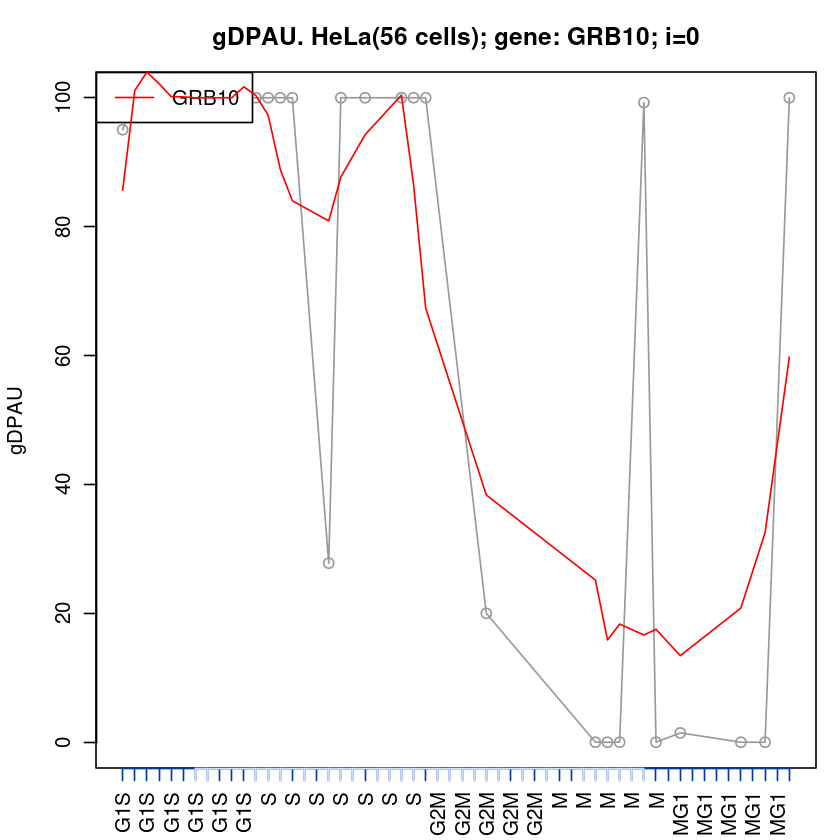

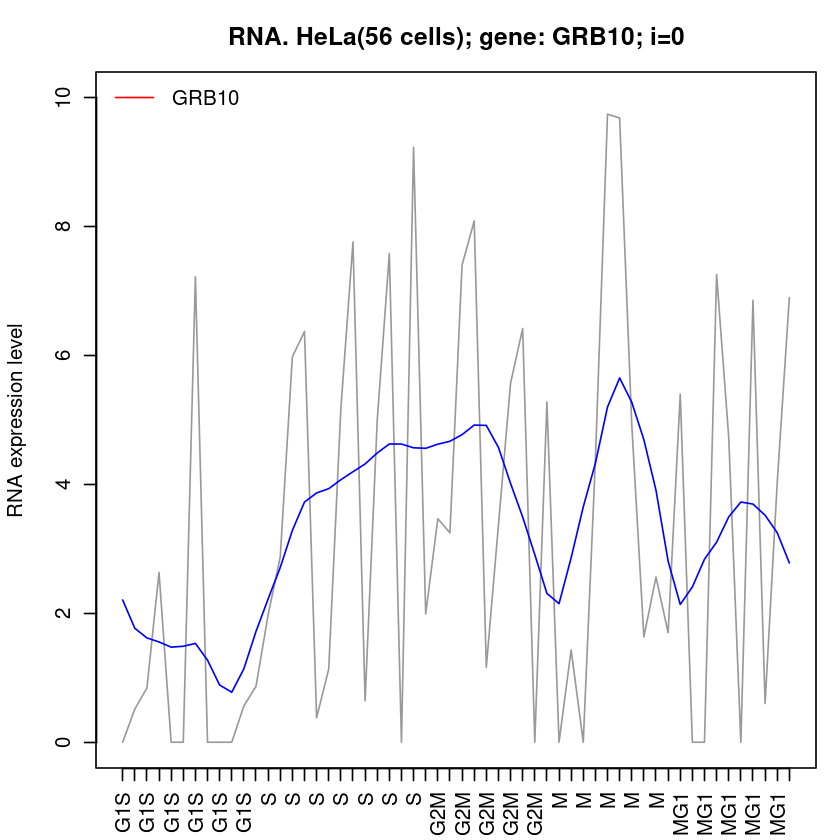

In [1709]:
drawRNA_gDPAU('GRB10', cellOrder=cellOrder.HeLa,keyword='HeLa')

[1] 169
[1] 169
[1] 9.687824


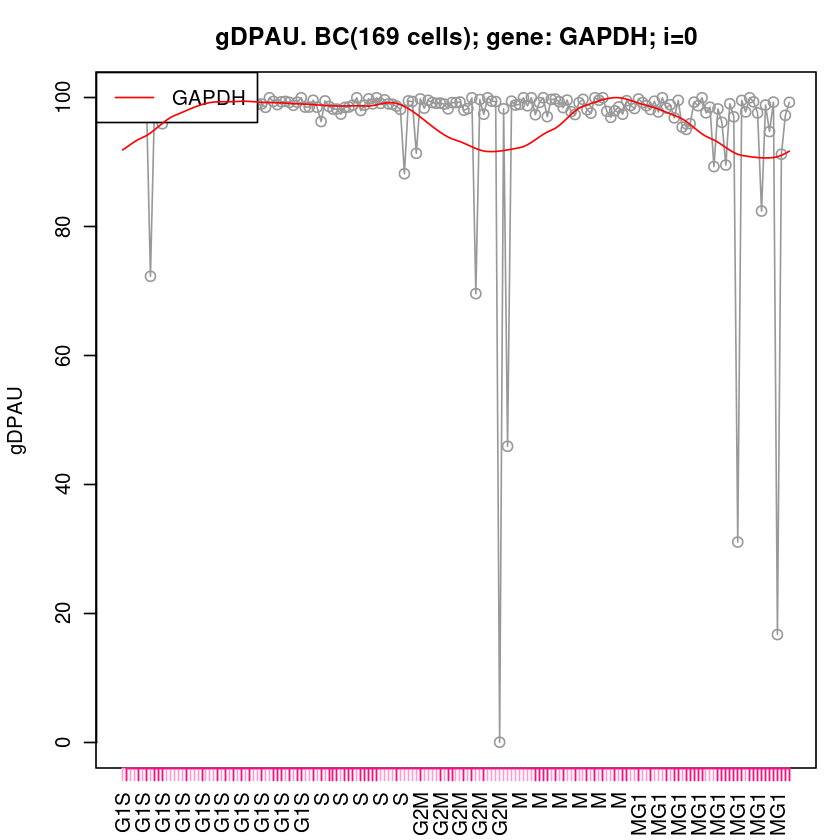

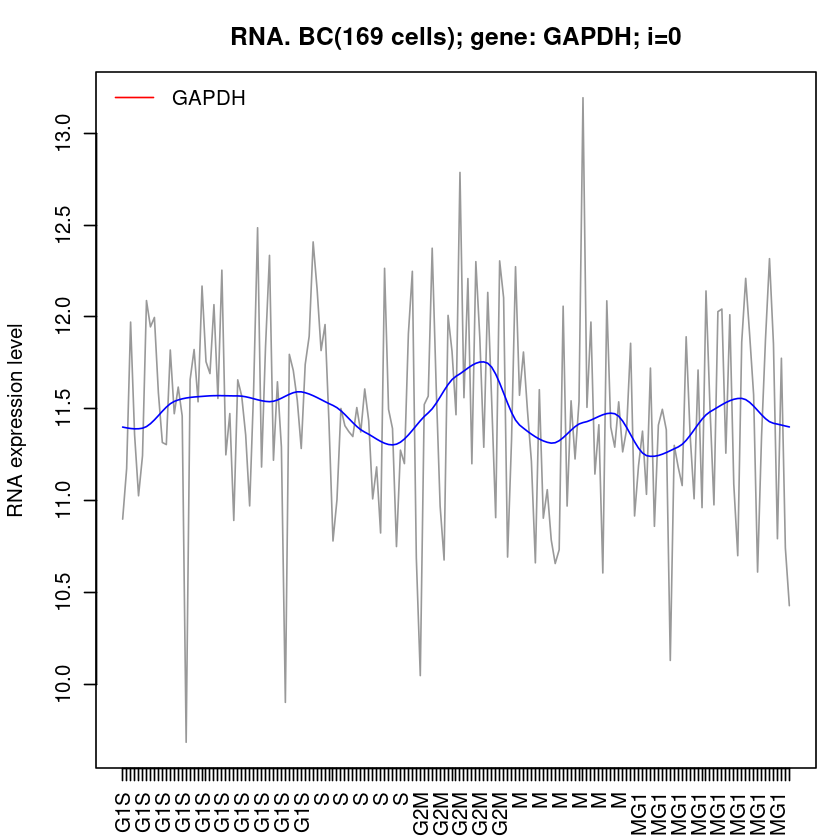

In [1710]:
drawRNA_gDPAU('GAPDH') #表达量最高的时候没来得及加上tail?

[1] 169
[1] 169
[1] 0


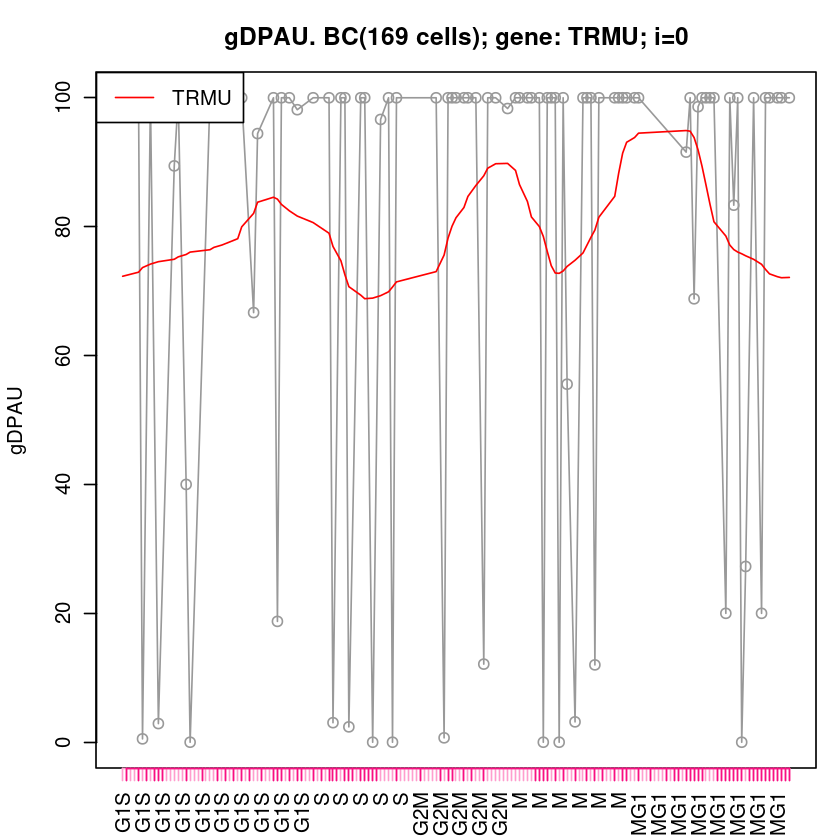

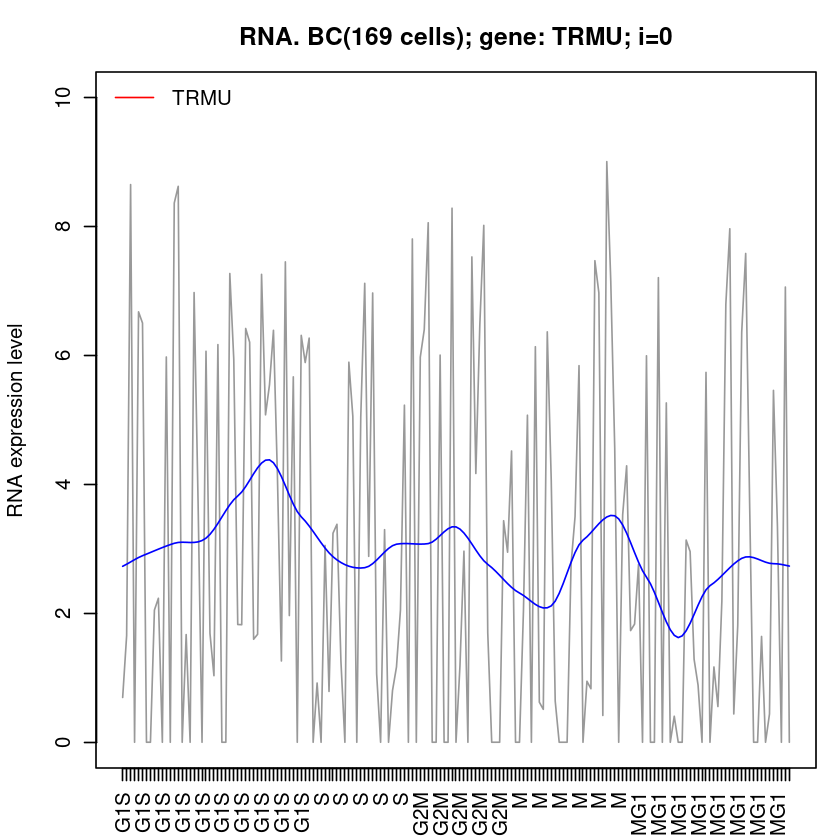

In [1711]:
drawRNA_gDPAU('TRMU')

[1] 169
[1] 169
[1] 0


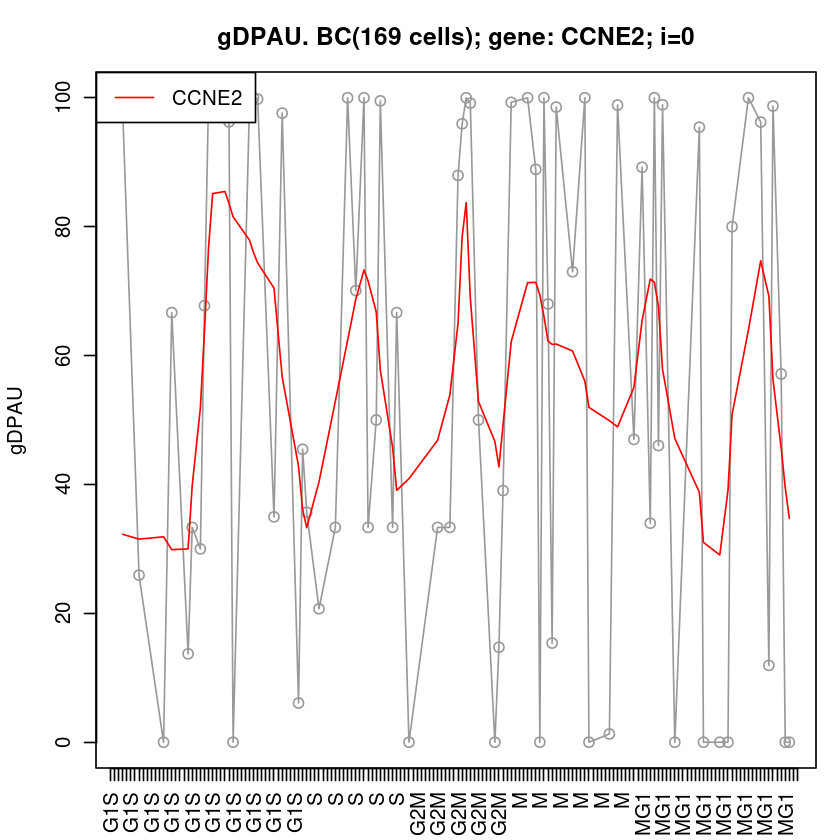

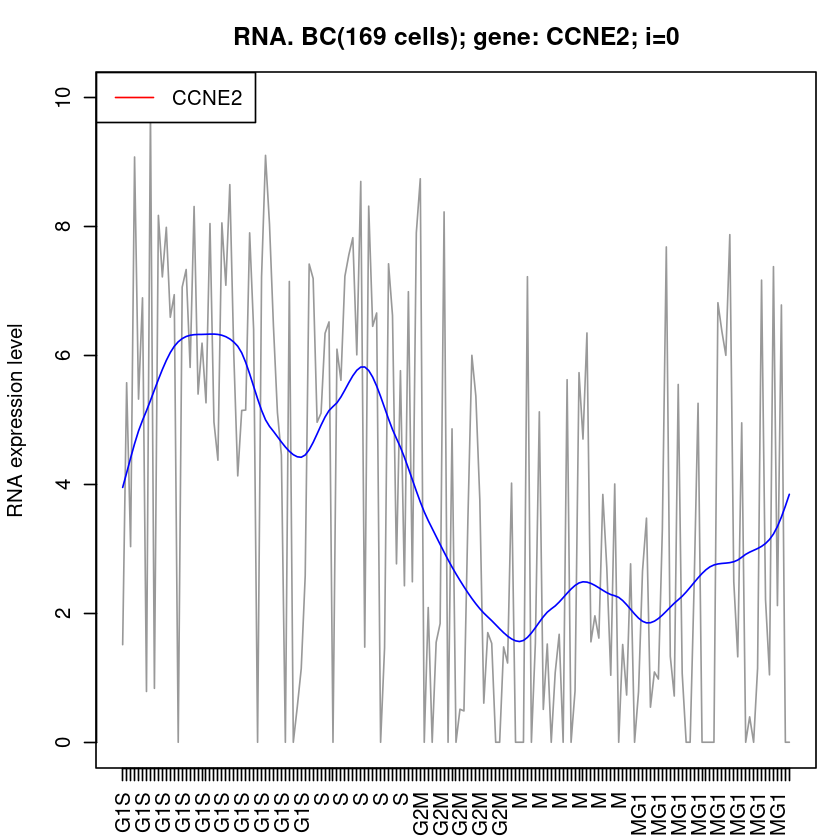

In [1548]:
drawRNA_gDPAU('CCNE2')

[1] 169
[1] 169
[1] 0


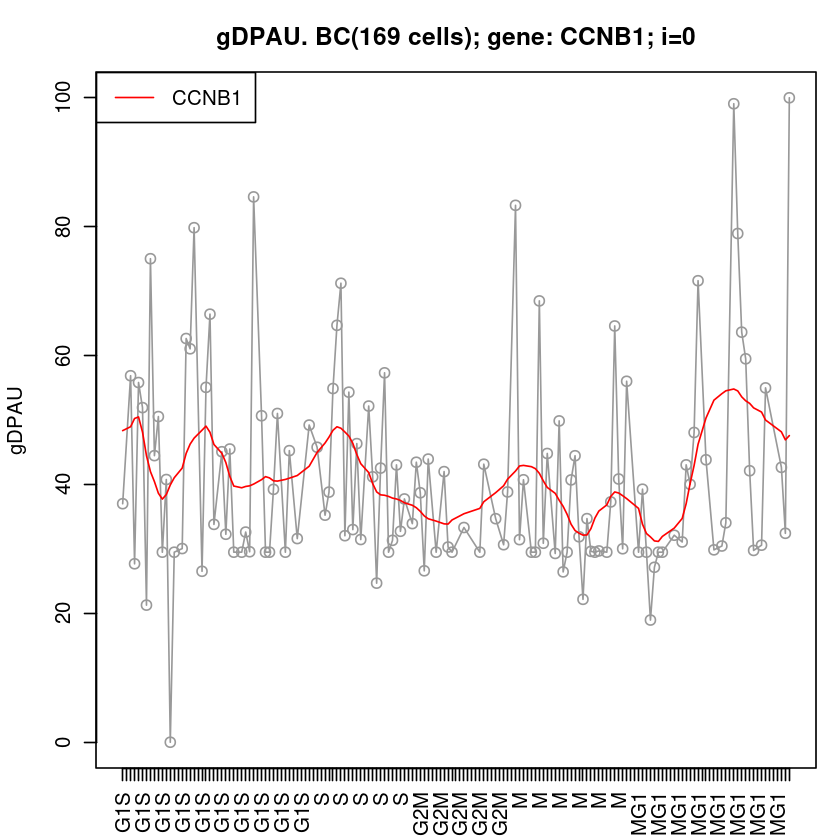

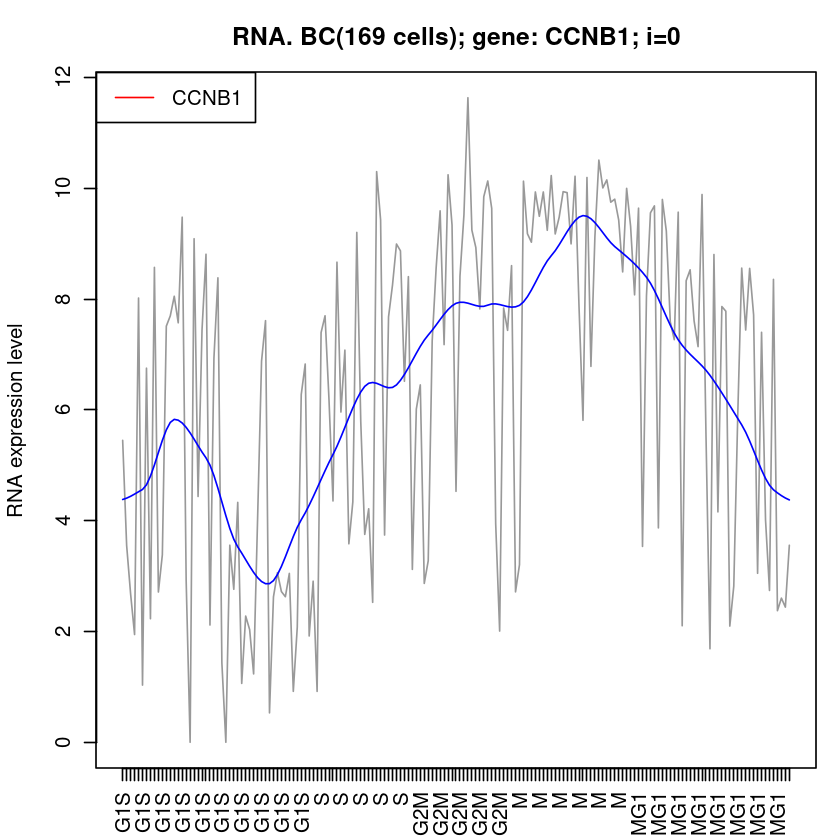

In [1549]:
drawRNA_gDPAU('CCNB1')

[1] 169
[1] 169
[1] 0


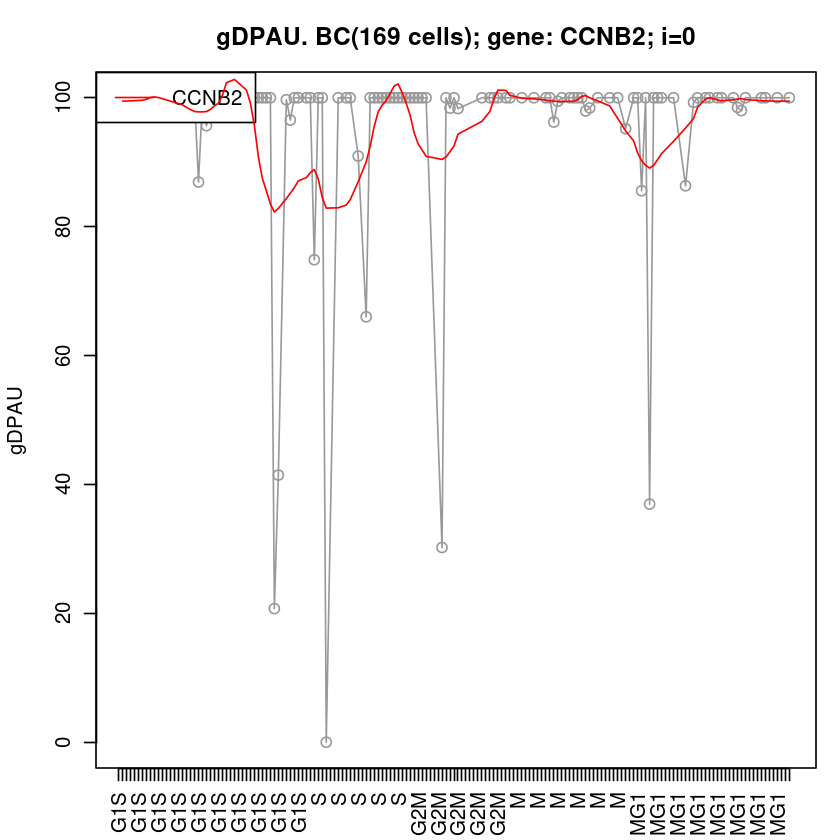

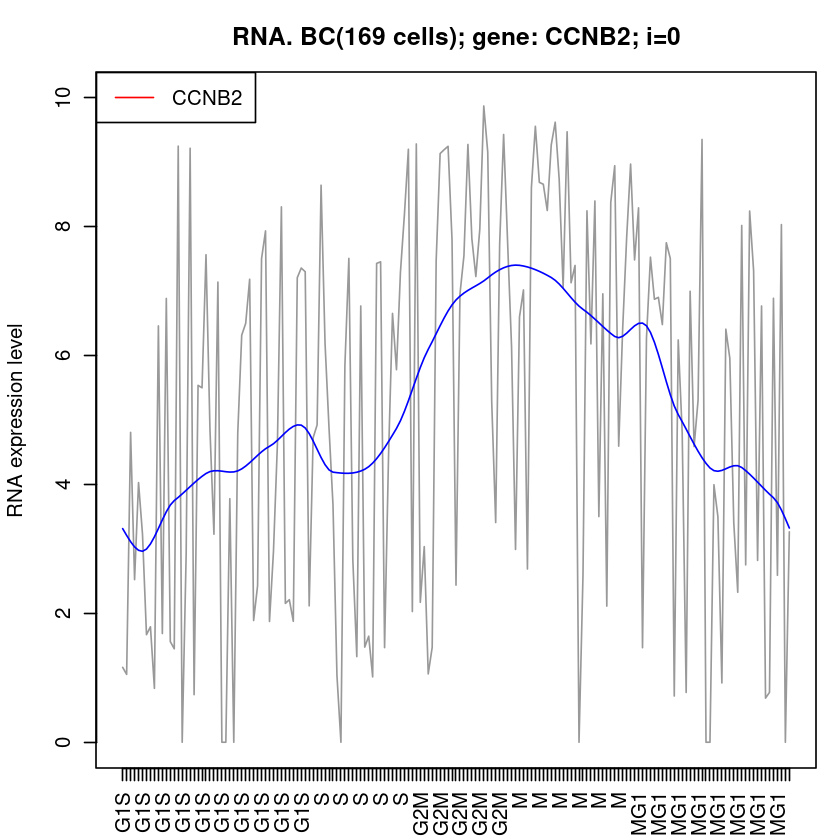

In [1550]:
drawRNA_gDPAU('CCNB2')

[1] 169
[1] 169
[1] 0


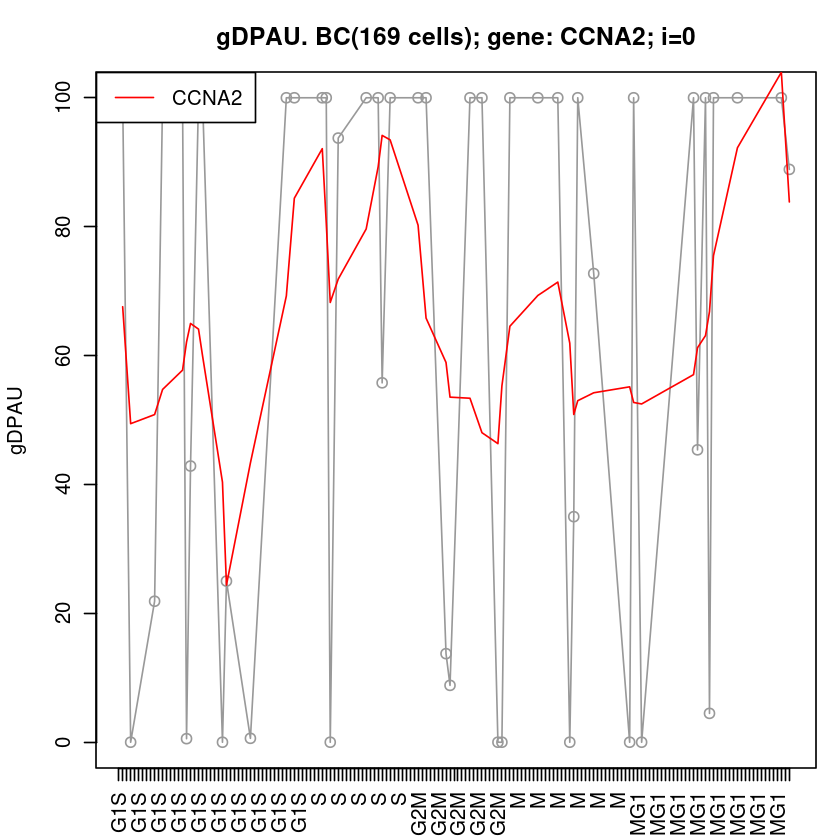

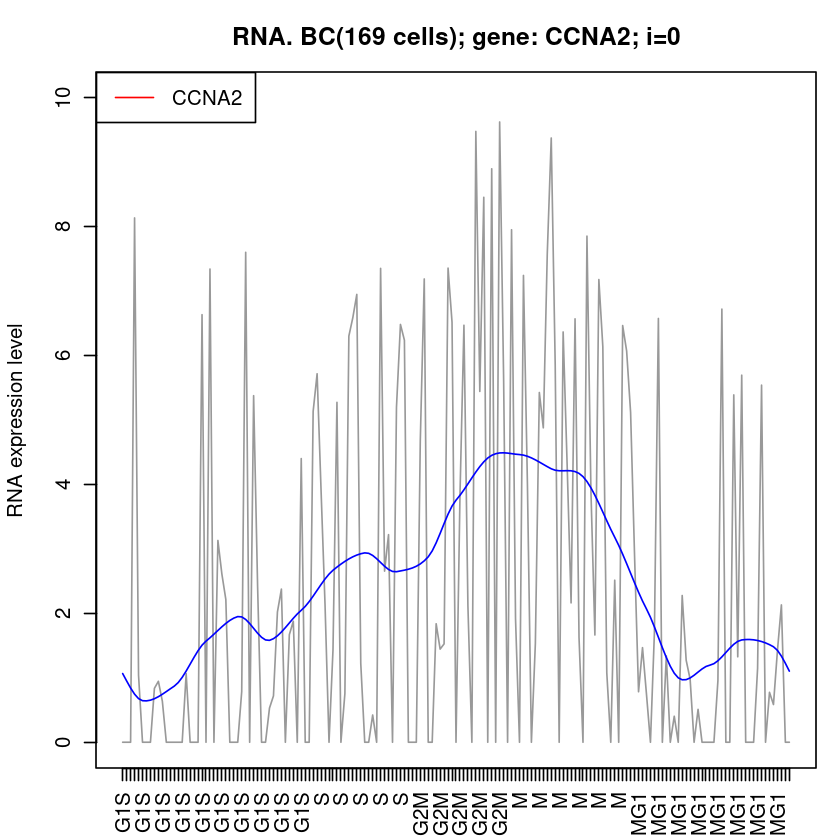

In [1552]:
drawRNA_gDPAU('CCNA2')

[1] 169
[1] 169
[1] 0


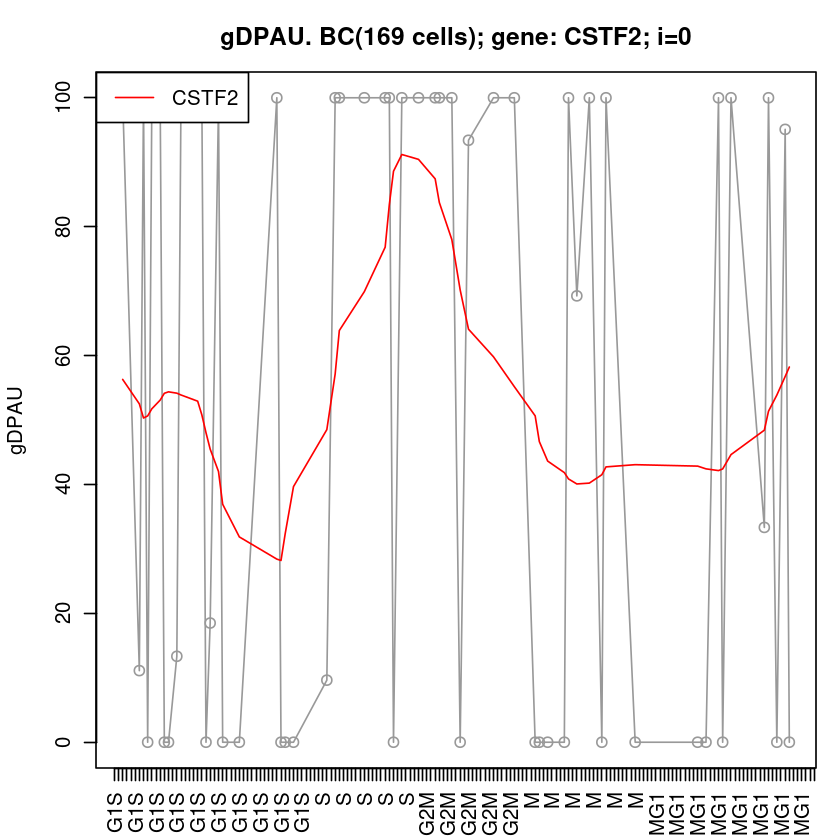

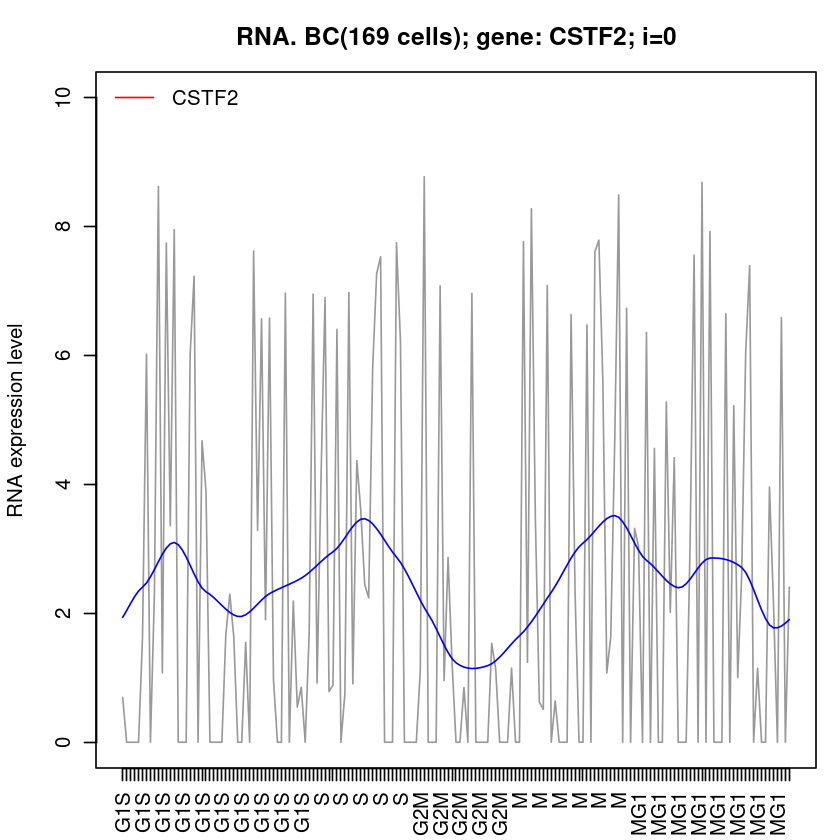

In [1581]:
drawRNA_gDPAU('CSTF2')

[1] 169


Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“k-d tree limited by memory. ncmax= 200”


[1] 169
[1] 0


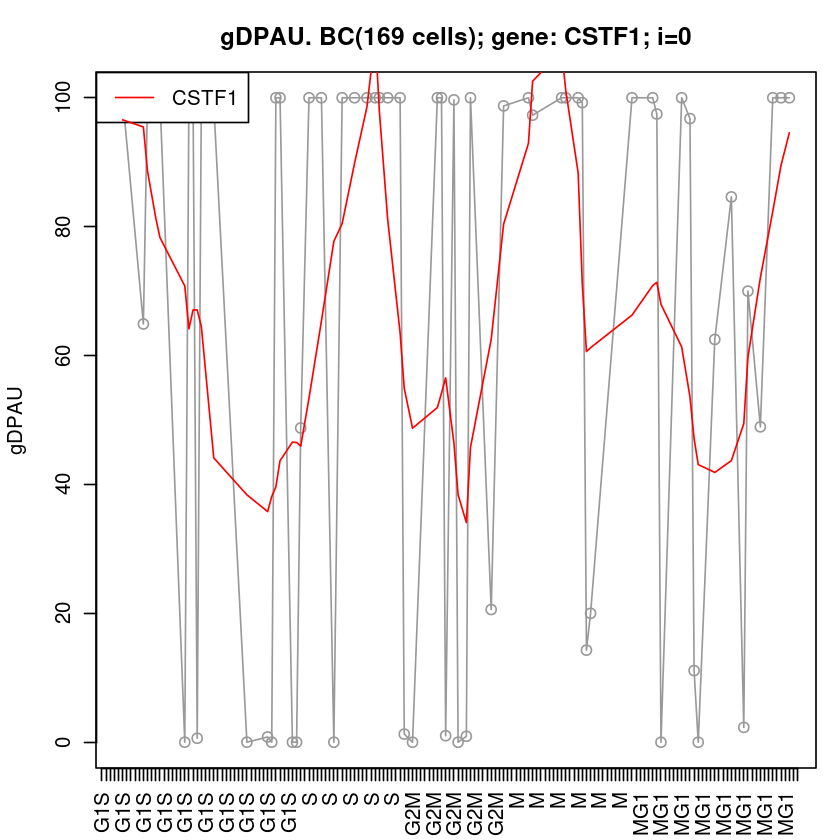

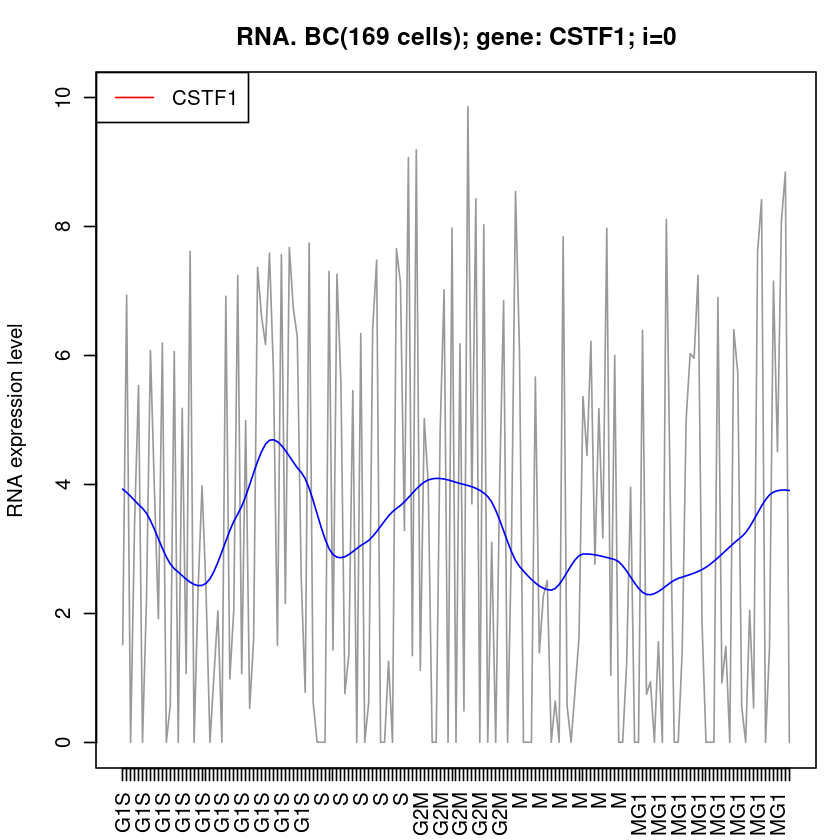

In [1555]:
drawRNA_gDPAU('CSTF1')

[1] 169


Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“k-d tree limited by memory. ncmax= 200”


[1] 169
[1] 0


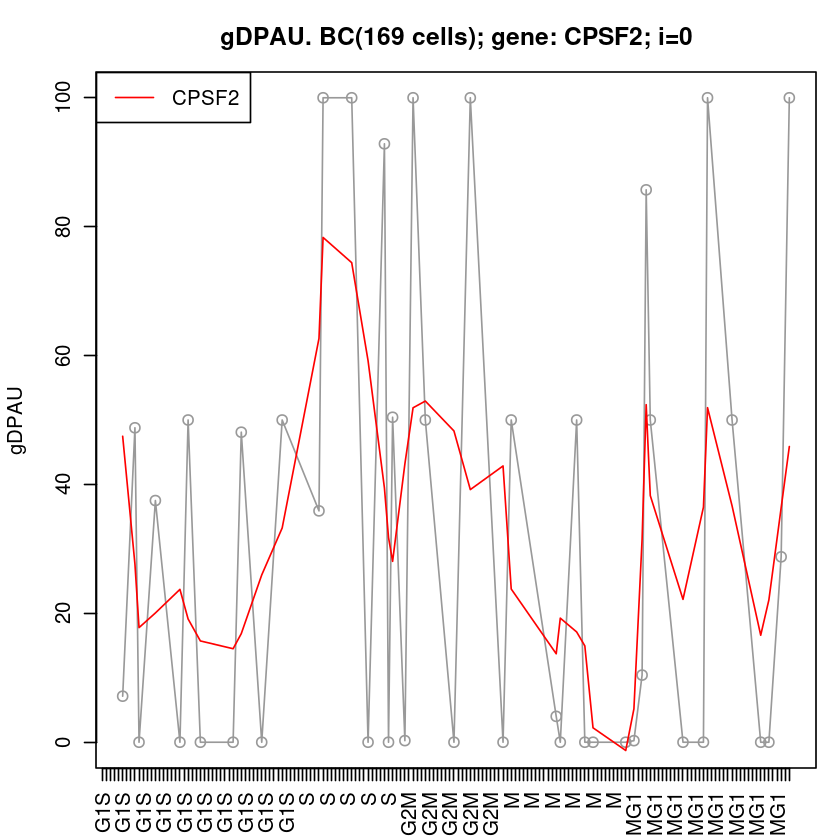

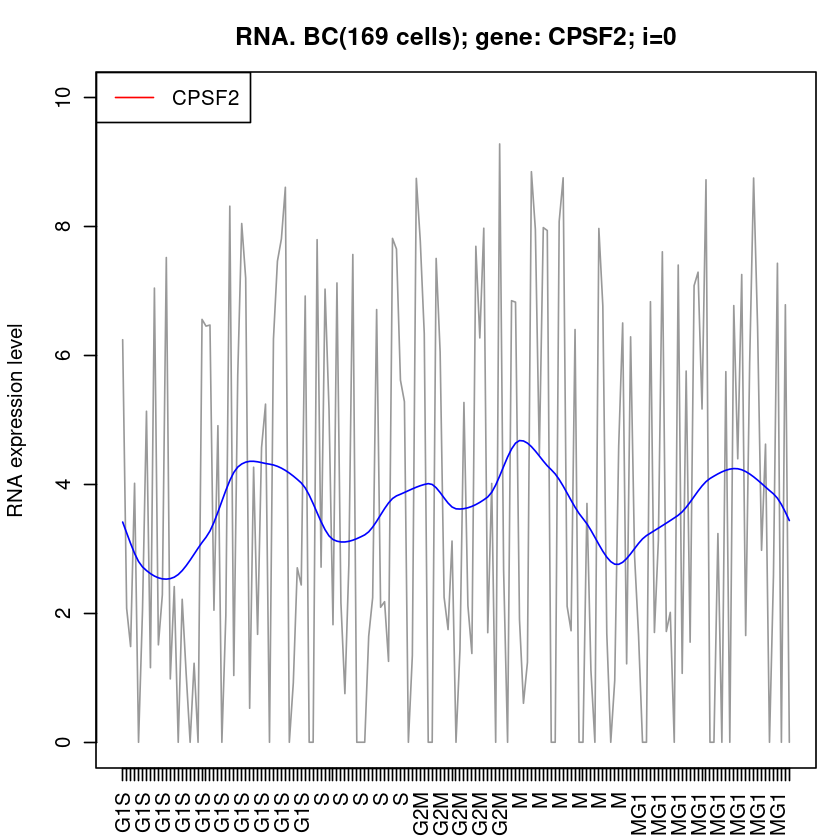

In [1557]:
drawRNA_gDPAU('CPSF2')

In [ ]:
drawRNA_gDPAU('CPSF2')

In [1559]:
(function(){
    genes=readLines('../gDPAU_gPPAU/tmp.genes.txt')
    CairoPDF('../gDPAU_gPPAU/tmp.gene.BC.gDPAU_RNA_stringent.plot.pdf', width=6, height=5)
    par(mfrow=c(2,1))
    for(i in 1:length(genes) ){
        #if(i>6)break;
        gene=genes[i]
        message(gene)
        drawRNA_gDPAU(gene, F)
    }
    dev.off()
    pP('==end==', i)
})()

SPATA33



[1] 169


Warning message in sqrt(sum.squares/one.delta):
“NaNs produced”


[1] 169
[1] 0


AGPS



[1] 169


Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“k-d tree limited by memory. ncmax= 200”


[1] 169
[1] 0


ATF2



[1] 169


Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“k-d tree limited by memory. ncmax= 200”


[1] 169
[1] 0


ANTXR1



[1] 169


Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”
Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“pseudoinverse used at 0.765”
Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.235”
Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”
Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.9952”


[1] 169
[1] 0
[1] "==end== 4"


## batch draw for each cycle regulated genes

In [281]:
(function(){
    phases=c('G1S','S','G2M','M','MG1')
    for(phase in phases){
        print(paste('==========', phase))
        geneSet=readLines( paste0("/home/wangjl/data/apa/190530Mix/cell_cycle/result/BC_CycleRelatedGene_RNA_",phase,".txt") )
        geneSet
        print(length(geneSet))
        #
        CairoPDF( paste0('RNA_cycleGene/BC_RNA_',phase,'.pdf'), width=20,height=12)

        par(mfrow=c(3,5), mar=c(3,2,1,1))
        for(i in 1:length(geneSet)){
            fn=show_cc_RNA2(cellOrder.BC, 'BC', gene=geneSet[i], index=i)
        }
        dev.off()
    }
})()
print('==end==')

[1] "========== G1S"
[1] 45
[1] 169
[1] 169
[1] 169
[1] 169
[1] 169
[1] 169
[1] 169
[1] 169
[1] 169
[1] 169
[1] 169
[1] 169
[1] 169
[1] 169
[1] 169
[1] 169
[1] 169
[1] 169
[1] 169
[1] 169
[1] 169
[1] 169
[1] 169
[1] 169
[1] 169
[1] 169
[1] 169
[1] 169
[1] 169
[1] 169
[1] 169
[1] 169
[1] 169
[1] 169
[1] 169
[1] 169
[1] 169
[1] 169
[1] 169
[1] 169
[1] 169
[1] 169
[1] 169
[1] 169
[1] 169
[1] "========== S"
[1] 58
[1] 169
[1] 169
[1] 169
[1] 169
[1] 169
[1] 169
[1] 169
[1] 169
[1] 169
[1] 169
[1] 169
[1] 169
[1] 169
[1] 169
[1] 169
[1] 169
[1] 169
[1] 169
[1] 169
[1] 169
[1] 169
[1] 169
[1] 169
[1] 169
[1] 169
[1] 169
[1] 169
[1] 169
[1] 169
[1] 169
[1] 169
[1] 169
[1] 169
[1] 169
[1] 169
[1] 169
[1] 169
[1] 169
[1] 169
[1] 169
[1] 169
[1] 169
[1] 169
[1] 169
[1] 169
[1] 169
[1] 169
[1] 169
[1] 169
[1] 169
[1] 169
[1] 169
[1] 169
[1] 169
[1] 169
[1] 169
[1] 169
[1] 169
[1] "========== G2M"
[1] 63
[1] 169
[1] 169
[1] 169
[1] 169
[1] 169
[1] 169
[1] 169
[1] 169
[1] 169
[1] 169
[1] 169
[1] 16

In [263]:
getwd()

[1] "/data/jinwf/wangjl/apa/191111Figure/f3/distalAPA_RNA_5"

[1] 169
[1] 169
[1] 0


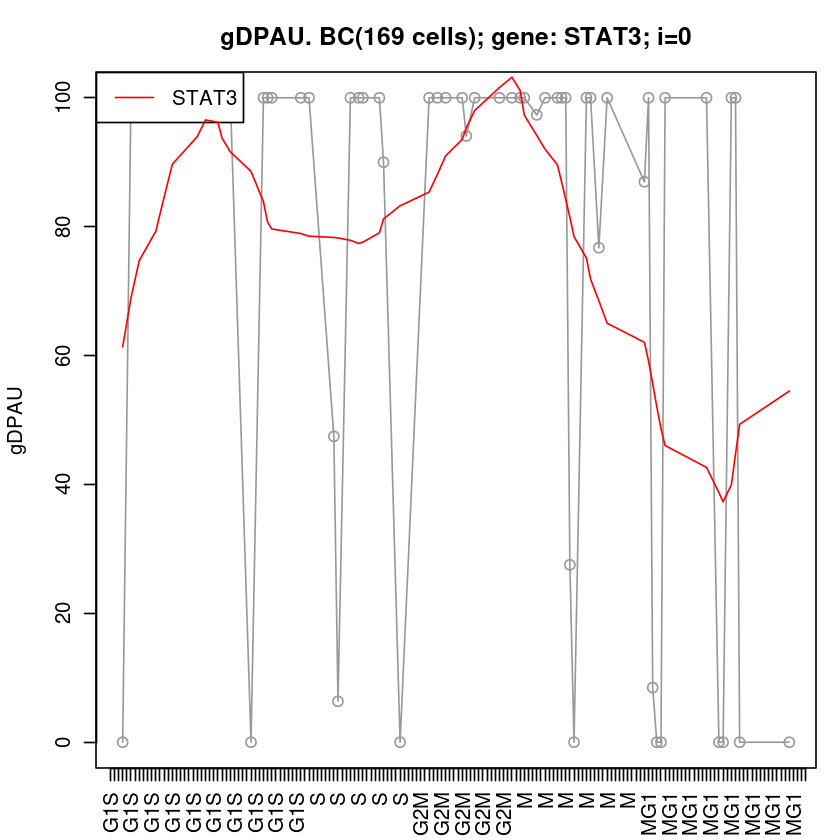

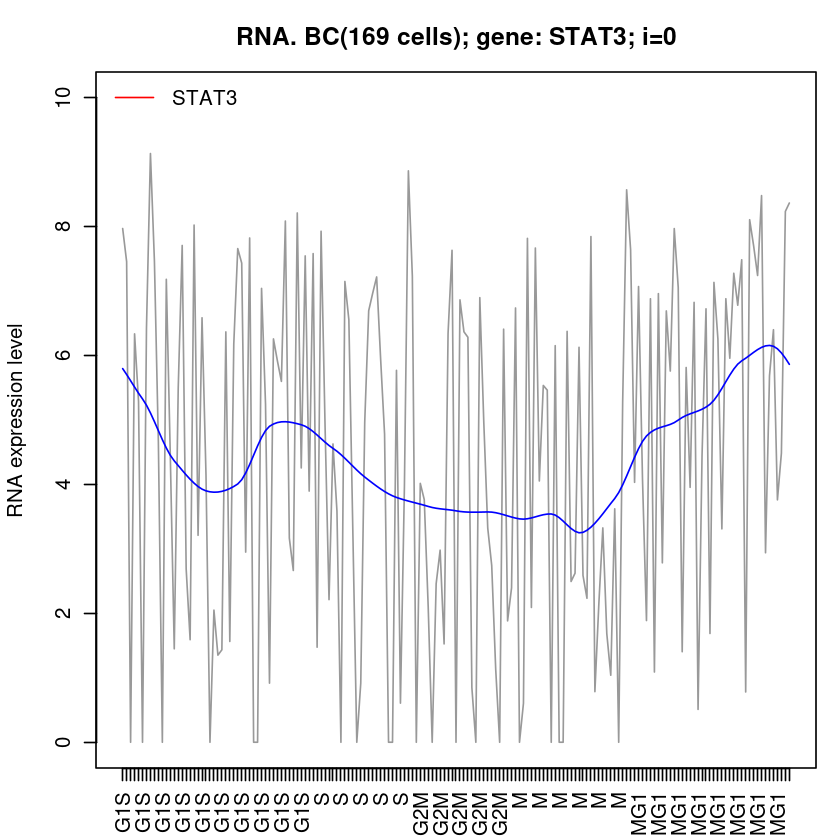

In [1658]:

drawRNA_gDPAU('STAT3')

[1] 169
[1] 169
[1] 0


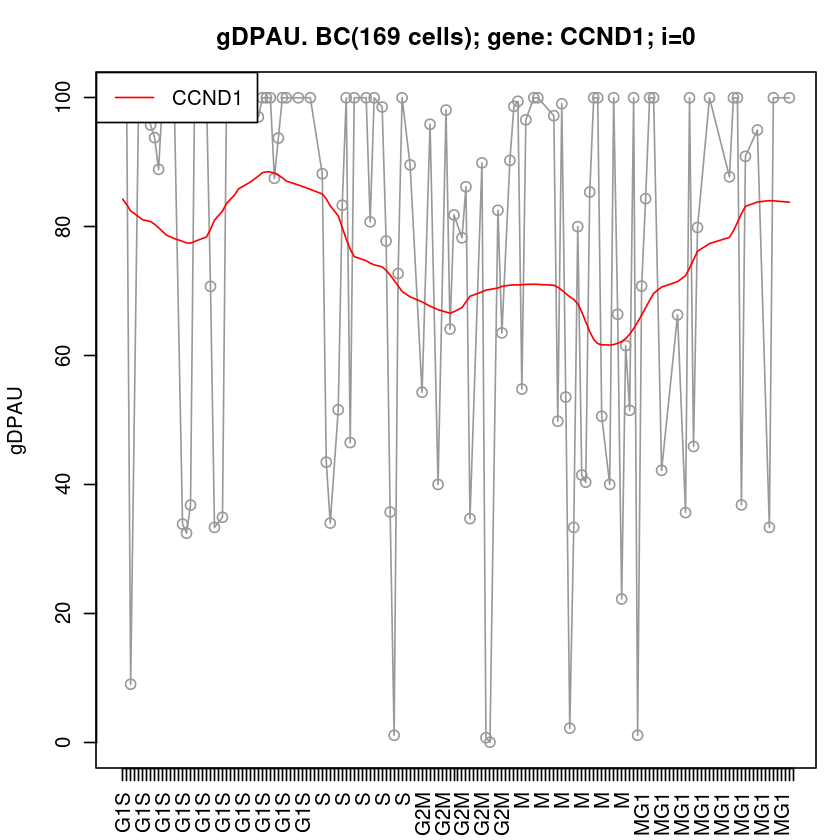

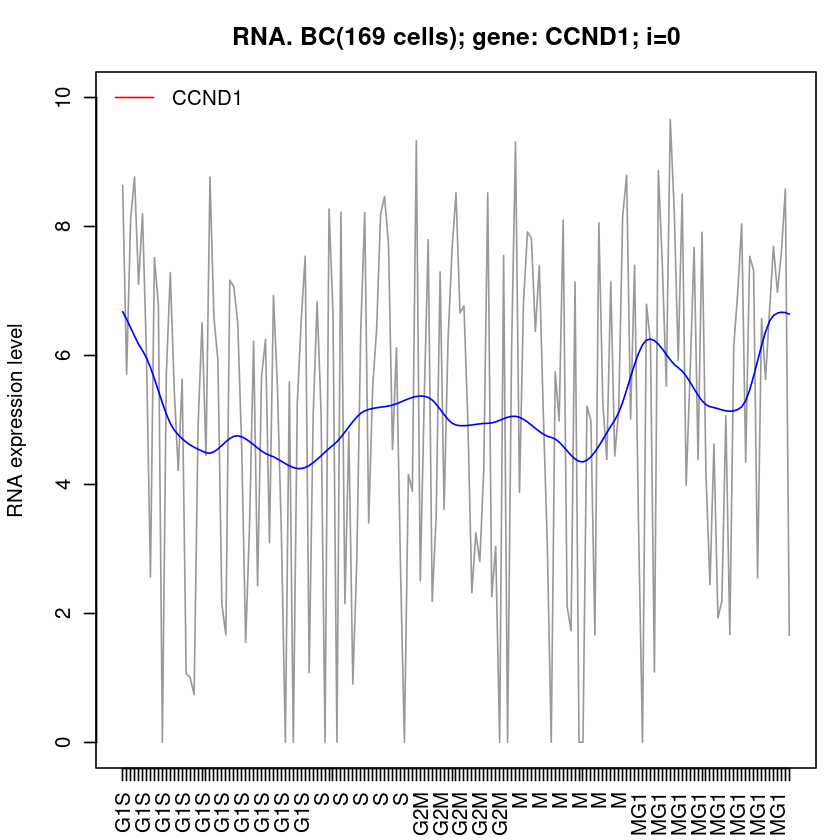

In [1660]:
drawRNA_gDPAU('CCND1')

[1] 169
[1] 169
[1] 0


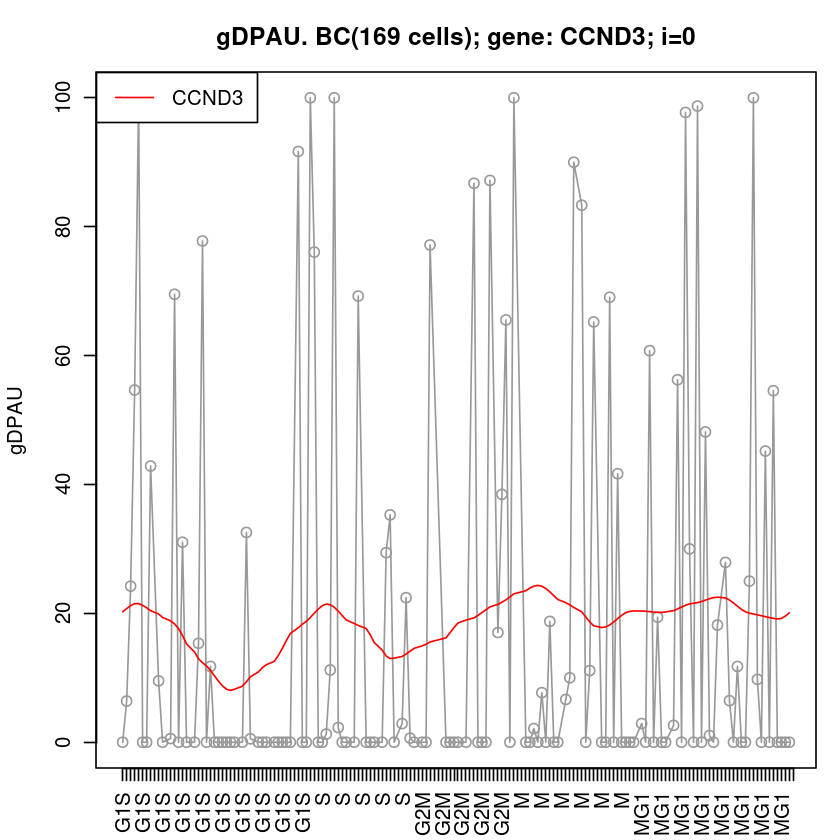

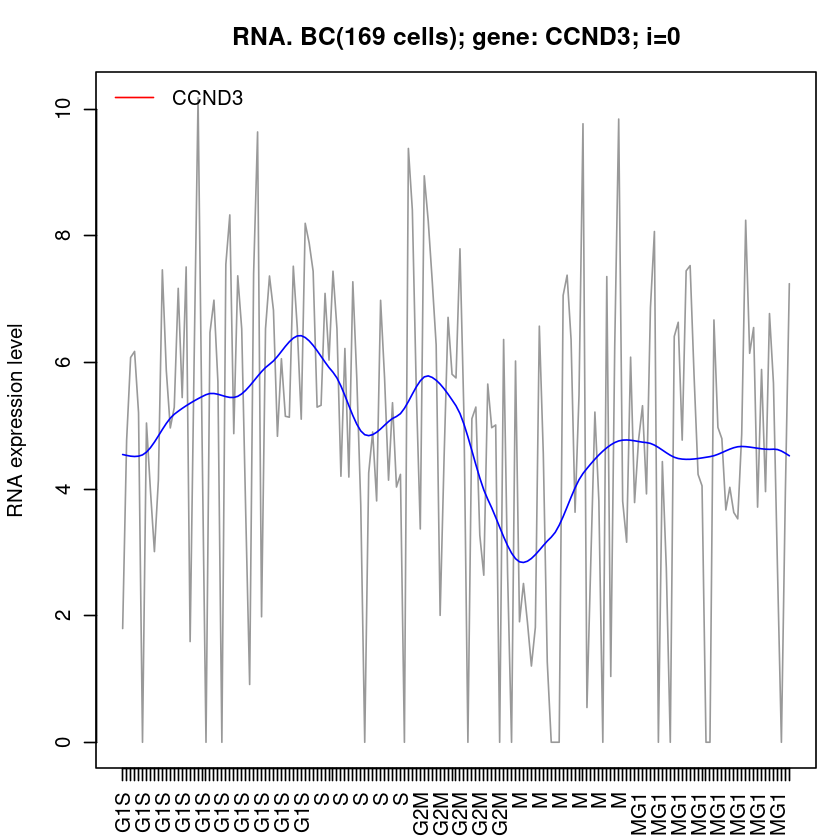

In [1662]:
drawRNA_gDPAU('CCND3')